# Comparing tuned MC and ML models on Test and OOD sets

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import os, cv2
import numpy as np
import pandas as pd
from matplotlib import pyplot as plt
import seaborn as sns
from scipy import stats

import json

import torch
import torch.nn.functional as F

import time
from tqdm import tqdm

from model_utils import ModelWrapper, myDataLoader
from model_utils.braille_utils import num_to_bin_string, bin_to_num, num_to_bin, ml_to_mc, mc_to_ml, bin_to_string, string_to_bin, num_to_cat
from model_utils.metrics import sigmoid_accuracy, bitwise_accuracy, macro_metrics, macro_recall, macro_precision, macro_F1, mean_error_distance, per_class_precision, per_class_recall, per_class_F1
from model_utils.augment import label_balance_resample, class_balance_resample, apply_augmentations
from model_utils.metrics import class_balance, label_correlations, class_frequency, between_label_imbalance, mean_mutual_information

c:\Users\User\OneDrive\Uni\Braille Research\Braille ML\venv\Lib\site-packages\torchvision\io\image.py:13: UserWarning: Failed to load image Python extension: '[WinError 127] The specified procedure could not be found'If you don't plan on using image functionality from `torchvision.io`, you can ignore this warning. Otherwise, there might be something wrong with your environment. Did you have `libjpeg` or `libpng` installed before building `torchvision` from source?
  warn(


In [3]:
from matplotlib.patches import Patch, PathPatch, Rectangle, Shadow, Ellipse
from matplotlib.lines import Line2D
from matplotlib import text as mtext
import matplotlib.transforms as transforms
import matplotlib.ticker as ticker
from matplotlib import legend as mlegend

In [4]:
sns_style1 = "darkgrid"
sns_style2 = "dark"
sns.set_theme(style=sns_style1, font_scale=1.1)

In [5]:
plt_face = sns.axes_style()['figure.facecolor']
ax_face = sns.axes_style()['axes.facecolor']

In [6]:

PAL = sns.color_palette()
DARK_PAL = sns.color_palette('dark')
plt.rcParams["font.family"] = "Times New Roman" # or "Arial"
LBL_SIZE = 20
TICK_SIZE = 18
LBL_LARGE = 22

DATASETS = os.path.join('..', '..', 'Datasets', 'numpy_datasets')
MODEL_PATH = os.path.join('..', 'models')
PLOTS = os.path.join('..', 'plots')
PLOT_EVALS = os.path.join(PLOTS, 'evals')
EVAL = os.path.join('..', 'evals')
ML_LOGS = os.path.join('..', 'opt_logs', 'ml_tuning')
MC_LOGS = os.path.join('..', 'opt_logs', 'mc_tuning')

PAL

[(0.2980392156862745, 0.4470588235294118, 0.6901960784313725),
 (0.8666666666666667, 0.5176470588235295, 0.3215686274509804),
 (0.3333333333333333, 0.6588235294117647, 0.40784313725490196),
 (0.7686274509803922, 0.3058823529411765, 0.3215686274509804),
 (0.5058823529411764, 0.4470588235294118, 0.7019607843137254),
 (0.5764705882352941, 0.47058823529411764, 0.3764705882352941),
 (0.8549019607843137, 0.5450980392156862, 0.7647058823529411),
 (0.5490196078431373, 0.5490196078431373, 0.5490196078431373),
 (0.8, 0.7254901960784313, 0.4549019607843137),
 (0.39215686274509803, 0.7098039215686275, 0.803921568627451)]

### Color Pallets

In [7]:
BLUE = "#1f77b4"
ORANGE = "#ffa35c"
RED = "#e50c3f"
# YELLOW = "#f1c232"
YELLOW = "#FFF55C"
DARK = "#0c343d"
LIGHT = "#efeae6"
GREEN = "#00a060"

BLACK = "#000000"
GREY = "#8F8F8F"
WHITE = "#ffffff"

In [8]:
# CPAL = sns.color_palette([
#     RED,
#     ORANGE,
#     BLUE,
#     GREEN,
#     YELLOW,
#     LIGHT,
#     GREY,
#     DARK
# ])

CPAL = sns.color_palette([
    PAL[3],
    PAL[1],
    PAL[0],
    PAL[2],
    PAL[7],
    PAL[5]
])

SPAL = sns.color_palette([
    PAL[4],
    PAL[8],
    PAL[5],
    PAL[6],
    PAL[9],
    PAL[7]
])

TPAL = sns.color_palette([
    DARK_PAL[4],
    DARK_PAL[8],
    DARK_PAL[5],
    DARK_PAL[6],
    DARK_PAL[9],
    DARK_PAL[3],
    DARK_PAL[1],
    DARK_PAL[0],
    DARK_PAL[2],
    DARK_PAL[7],
])

display(CPAL)
display(SPAL)
display(TPAL)

[(0.7686274509803922, 0.3058823529411765, 0.3215686274509804),
 (0.8666666666666667, 0.5176470588235295, 0.3215686274509804),
 (0.2980392156862745, 0.4470588235294118, 0.6901960784313725),
 (0.3333333333333333, 0.6588235294117647, 0.40784313725490196),
 (0.5490196078431373, 0.5490196078431373, 0.5490196078431373),
 (0.5764705882352941, 0.47058823529411764, 0.3764705882352941)]

[(0.5058823529411764, 0.4470588235294118, 0.7019607843137254),
 (0.8, 0.7254901960784313, 0.4549019607843137),
 (0.5764705882352941, 0.47058823529411764, 0.3764705882352941),
 (0.8549019607843137, 0.5450980392156862, 0.7647058823529411),
 (0.39215686274509803, 0.7098039215686275, 0.803921568627451),
 (0.5490196078431373, 0.5490196078431373, 0.5490196078431373)]

[(0.34901960784313724, 0.11764705882352941, 0.44313725490196076),
 (0.7215686274509804, 0.5215686274509804, 0.0392156862745098),
 (0.34901960784313724, 0.1843137254901961, 0.050980392156862744),
 (0.6352941176470588, 0.20784313725490197, 0.5098039215686274),
 (0.0, 0.38823529411764707, 0.4549019607843137),
 (0.5490196078431373, 0.03137254901960784, 0.0),
 (0.6941176470588235, 0.25098039215686274, 0.050980392156862744),
 (0.0, 0.10980392156862745, 0.4980392156862745),
 (0.07058823529411765, 0.44313725490196076, 0.10980392156862745),
 (0.23529411764705882, 0.23529411764705882, 0.23529411764705882)]

In [9]:
RGB_NUM = 7

RPAL = sns.blend_palette([
    LIGHT,
    CPAL[0],
    DARK
], n_colors=RGB_NUM)

OPAL = sns.blend_palette([
    LIGHT,
    CPAL[1],
    CPAL[0]
], n_colors=RGB_NUM)

BPAL = sns.blend_palette([
    LIGHT,
    CPAL[2],
    DARK
], n_colors=RGB_NUM)

GPAL = sns.blend_palette([
    LIGHT,
    CPAL[3],
    DARK
], n_colors=RGB_NUM)

BWPAL = sns.blend_palette([
    BLACK,
    WHITE
], n_colors=RGB_NUM*2)

PALS = [
    RPAL,
    OPAL,
    BPAL,
    GPAL
]

display(RPAL)
display(OPAL)
display(BPAL)
display(GPAL)
display(BWPAL)

[(0.9372549019607843, 0.9176470588235294, 0.9019607843137255),
 (0.8817070357554787, 0.7161245674740484, 0.7107727797001153),
 (0.8248366013071896, 0.5098039215686274, 0.5150326797385621),
 (0.7657977700884275, 0.3054825067281815, 0.32124567474048443),
 (0.5281045751633987, 0.27189542483660134, 0.29411764705882354),
 (0.2847520184544406, 0.23750865051903114, 0.26634371395617074),
 (0.047058823529411764, 0.20392156862745098, 0.23921568627450981)]

[(0.9372549019607843, 0.9176470588235294, 0.9019607843137255),
 (0.914002306805075, 0.7858823529411765, 0.7107727797001153),
 (0.8901960784313726, 0.6509803921568628, 0.5150326797385621),
 (0.8662821991541715, 0.5168166089965398, 0.3215686274509804),
 (0.8339869281045752, 0.44705882352941184, 0.3215686274509804),
 (0.8009227220299885, 0.37564013840830457, 0.3215686274509804),
 (0.7686274509803922, 0.3058823529411765, 0.3215686274509804)]

[(0.9372549019607843, 0.9176470588235294, 0.9019607843137255),
 (0.7266897347174164, 0.762629757785467, 0.8322029988465974),
 (0.5111111111111112, 0.603921568627451, 0.7607843137254902),
 (0.29705497885428683, 0.44610534409842373, 0.6884275278738946),
 (0.21437908496732028, 0.36601307189542487, 0.5398692810457517),
 (0.12973471741637832, 0.28401384083044984, 0.38777393310265285),
 (0.047058823529411764, 0.20392156862745098, 0.23921568627450981)]

[(0.9372549019607843, 0.9176470588235294, 0.9019607843137255),
 (0.7383160322952711, 0.8323875432525951, 0.73919261822376),
 (0.534640522875817, 0.7450980392156863, 0.5725490196078431),
 (0.33221068819684735, 0.657039600153787, 0.4071818531334102),
 (0.23790849673202613, 0.5071895424836601, 0.35163398692810455),
 (0.141361014994233, 0.35377162629757786, 0.29476355247981545),
 (0.047058823529411764, 0.20392156862745098, 0.23921568627450981)]

[(0.0, 0.0, 0.0),
 (0.07450980392156863, 0.07450980392156863, 0.07450980392156863),
 (0.15294117647058825, 0.15294117647058825, 0.15294117647058825),
 (0.23137254901960785, 0.23137254901960785, 0.23137254901960785),
 (0.3058823529411765, 0.3058823529411765, 0.3058823529411765),
 (0.38431372549019605, 0.38431372549019605, 0.38431372549019605),
 (0.4627450980392157, 0.4627450980392157, 0.4627450980392157),
 (0.5372549019607843, 0.5372549019607843, 0.5372549019607843),
 (0.615686274509804, 0.615686274509804, 0.615686274509804),
 (0.6941176470588235, 0.6941176470588235, 0.6941176470588235),
 (0.7686274509803921, 0.7686274509803921, 0.7686274509803921),
 (0.8470588235294118, 0.8470588235294118, 0.8470588235294118),
 (0.9254901960784314, 0.9254901960784314, 0.9254901960784314),
 (1.0, 1.0, 1.0)]

In [10]:
CONPAL = sns.blend_palette([
    RED,
    BLUE,
    DARK,
    BLUE,
    ORANGE
], n_colors=20)
CONPAL

[(0.8980392156862745, 0.047058823529411764, 0.24705882352941178),
 (0.7397001153402538, 0.13262591311034216, 0.34062283737024224),
 (0.581361014994233, 0.2181930026912726, 0.4341868512110727),
 (0.4108419838523645, 0.31034217608612075, 0.5349480968858131),
 (0.25250288350634376, 0.3959092656670511, 0.6285121107266436),
 (0.11777008842752787, 0.45327181853133414, 0.6820915032679739),
 (0.1025759323337178, 0.3996924259900039, 0.5869281045751634),
 (0.08621299500192234, 0.3419915417147251, 0.48444444444444446),
 (0.07101883890811225, 0.28841214917339486, 0.389281045751634),
 (0.05465590157631679, 0.2307112648981161, 0.28679738562091506),
 (0.0546559015763168, 0.2307112648981161, 0.28679738562091506),
 (0.07101883890811223, 0.28841214917339475, 0.3892810457516338),
 (0.08621299500192234, 0.3419915417147251, 0.48444444444444446),
 (0.1025759323337178, 0.3996924259900039, 0.5869281045751634),
 (0.11777008842752787, 0.45327181853133414, 0.6820915032679739),
 (0.2696962706651288, 0.49576316801230297, 0.6476893502499039),
 (0.44882737408688966, 0.5309496347558631, 0.5773164167627836),
 (0.6417377931564783, 0.5688427527873894, 0.5015301806997309),
 (0.8208688965782391, 0.6040292195309496, 0.43115724721261056),
 (1.0, 0.6392156862745098, 0.3607843137254902)]

In [11]:
DIVPAL = sns.blend_palette([
    RED,
    LIGHT,
    YELLOW
], n_colors=20)
DIVPAL

[(0.8980392156862745, 0.047058823529411764, 0.24705882352941178),
 (0.9020376778162246, 0.1358246828143022, 0.3138331410995771),
 (0.9060361399461746, 0.22459054209919263, 0.38060745866974244),
 (0.9103421760861208, 0.3201845444059977, 0.45251826220684355),
 (0.9143406382160708, 0.4089504036908881, 0.5192925797770088),
 (0.9186466743560169, 0.5045444059976932, 0.5912033833141099),
 (0.9226451364859669, 0.5933102652825837, 0.6579777008842753),
 (0.9269511726259131, 0.6889042675893888, 0.7298885044213764),
 (0.9309496347558631, 0.7776701268742792, 0.7966628219915417),
 (0.9352556708958093, 0.8732641291810841, 0.8685736255286428),
 (0.9404536716647444, 0.9198462129950019, 0.8743713956170703),
 (0.9473433294886582, 0.9245828527489427, 0.8149480968858133),
 (0.9537408688965783, 0.9289811610918877, 0.7597693194925028),
 (0.9606305267204921, 0.9337178008458286, 0.7003460207612456),
 (0.9670280661284122, 0.9381161091887735, 0.6451672433679354),
 (0.973917723952326, 0.9428527489427143, 0.5857439446366781),
 (0.9803152633602461, 0.9472510572856594, 0.5305651672433679),
 (0.9872049211841599, 0.9519876970396002, 0.4711418685121107),
 (0.99360246059208, 0.9563860053825451, 0.41596309111880037),
 (1.0, 0.9607843137254902, 0.3607843137254902)]

## Data processing

In [12]:
angelina = os.path.join(DATASETS, "angelina.npz")
dsbi = os.path.join(DATASETS, "dsbi.npz")
abc = os.path.join(DATASETS, "abc.npz")
bcd = os.path.join(DATASETS, "bcd.npz")
b37 = os.path.join(DATASETS, "b37.npz")

data = np.load(angelina)
ood_dsbi = np.load(dsbi)
ood_abc = np.load(abc)
ood_bcd = np.load(bcd)
ood_b37 = np.load(b37)
print(data['train_x'].shape)
print(ood_dsbi['test_x'].shape)
print(ood_abc['test_x'].shape)
print(ood_bcd['test_x'].shape)
print(ood_b37['test_x'].shape)

(69267, 40, 30, 3)
(45627, 40, 30, 3)
(3168, 40, 30, 3)
(1560, 40, 30, 3)
(30608, 40, 30, 3)


In [13]:
# train_X = data["train_x"] / 255.
train_Y = data["train_y"]


# val_X = data["val_x"] / 255.
val_Y = data["val_y"]

test_X = data["test_x"] / 255.
test_Y = data["test_y"]

# dsbi_X = ood_dsbi['test_x'] / 255.
dsbi_Y = ood_dsbi['test_y']

# abc_X = ood_abc['test_x'] / 255.
abc_Y = ood_abc['test_y']

# bcd_X = ood_bcd['test_x'] / 255.
bcd_Y = ood_bcd['test_y']

# b37_X = ood_b37['test_x'] / 255.
b37_Y = ood_b37['test_y']

N, p = train_Y.shape

In [14]:
train_Y_cat = ml_to_mc(train_Y)
val_Y_cat = ml_to_mc(val_Y)
test_Y_cat = ml_to_mc(test_Y)
test_Y_str = bin_to_string(test_Y)

C = train_Y_cat.shape[1]

In [15]:

dsbi_Y_cat = ml_to_mc(dsbi_Y)
dsbi_Y_str = bin_to_string(dsbi_Y)

abc_Y_cat = ml_to_mc(abc_Y)
abc_Y_str = bin_to_string(abc_Y)

bcd_Y_cat = ml_to_mc(bcd_Y)
bcd_Y_str = bin_to_string(bcd_Y)

b37_Y_cat = ml_to_mc(b37_Y)
b37_Y_str = bin_to_string(b37_Y)

In [16]:
del data, ood_dsbi, ood_abc, ood_bcd, ood_b37

## Model evaluation

In [17]:
param_space = {
    'lr': (0.0001, 0.02),
    'beta_1': (0.85, 0.95),
    'beta_2': (0.99, 0.9999),
    'l2': (0.0001, 0.03),
    'filters': (8, 64),
    'kernel_sz': (2,5),
    'dense_sz': (25, 150),
    'activs': (0, 2),
    'padding': (0, 1),
    'grey': (0, 1),
    'sqr': (0, 1)
}

param_names = [
    'Learning Rate', 'Beta1', 'Beta2', 'L2 Penalty',
    'Num Filters', 'Kernel Size', 'Dense Layer Size',
    'Activation function', 'Padding', 
    'Grey scaling', 'Square Input'
]

activations = {
    0: F.relu,
    1: F.tanh,
    2: F.leaky_relu
}

In [18]:
DEV = 'cpu'

NUM_CLASSES = 64
NUM_LABELS = 6

### Model loading

In [19]:
base_ml_model = ModelWrapper(dev=DEV)
base_ml_model.load(os.path.join(MODEL_PATH, 'base_ml_model_v2'))

base_mc_model = ModelWrapper(dev=DEV)
base_mc_model.load(os.path.join(MODEL_PATH, 'base_mc_model_v2'))

In [20]:
lb_ml_model = ModelWrapper(dev=DEV)
lb_ml_model.load(os.path.join(MODEL_PATH, 'lb_ml_model'))

lb_mc_model = ModelWrapper(dev=DEV)
lb_mc_model.load(os.path.join(MODEL_PATH, 'lb_mc_model'))

In [21]:
cb_ml_model = ModelWrapper(dev=DEV)
cb_ml_model.load(os.path.join(MODEL_PATH, 'cb_ml_model'))

cb_mc_model = ModelWrapper(dev=DEV)
cb_mc_model.load(os.path.join(MODEL_PATH, 'cb_mc_model'))

In [22]:
ab_ml_model = ModelWrapper(dev=DEV)
ab_ml_model.load(os.path.join(MODEL_PATH, 'ab_ml_model'))

ab_mc_model = ModelWrapper(dev=DEV)
ab_mc_model.load(os.path.join(MODEL_PATH, 'ab_mc_model'))

In [23]:
# Model lists and model name lists
models = [base_mc_model, base_ml_model,
          cb_mc_model, cb_ml_model,
          lb_mc_model, lb_ml_model,
          ab_mc_model, ab_ml_model]
model_names = ['Base MC', 'Base ML',
               'CB MC', 'CB ML',
               'LB MC', 'LB ML',
               'AB MC', 'AB ML']


base_ml_model.param_dict

{'in_size': [32, 32, 3],
 'filts': 24,
 'kerns': 5,
 'pad': 1,
 'out_size': 6,
 'activ': 'tanh',
 'dense_sz': 115,
 'beta_2': 0.9999,
 'beta_1': 0.8702337788234192,
 'l2': 0.0005,
 'lr': 0.0006905246895851634,
 'grey_scaled': 0,
 'square_in': 1}

### Recorded Predictions

In [ ]:
id_pred = pd.read_csv(os.path.join(EVAL, 'all_cbr_test_predictions.csv'), dtype=str)
dsbi_pred = pd.read_csv(os.path.join(EVAL, 'all_cbr_ood_predictions.csv'), dtype=str)
abc_pred = pd.read_csv(os.path.join(EVAL, 'all_cbr_abc_ood_predictions.csv'), dtype=str)
bcd_pred = pd.read_csv(os.path.join(EVAL, 'all_cbr_bcd_ood_predictions.csv'), dtype=str)
b37_pred = pd.read_csv(os.path.join(EVAL, 'all_cbr_b37_ood_predictions.csv'), dtype=str)

In [ ]:
display(id_pred.head())
display(dsbi_pred.head())

,true_label,Base MC,Base ML,CB MC,CB ML,LB MC,LB ML,AB MC,AB ML
0,011001,011001,011001,011001,011001,011001,011001,011001,011001
1,101010,101010,101010,101010,101010,101010,101010,101010,101010
2,111010,111010,111010,111010,111010,111010,111010,111010,111010
3,111010,111010,111010,111010,111010,111010,111010,111010,111010
4,011001,011001,011001,011001,011001,011001,011001,011001,001001


,true_label,Base MC,Base ML,CB MC,CB ML,LB MC,LB ML,AB MC,AB ML
0,010100,010100,010100,010100,010100,010100,010100,010100,010100
1,101000,101000,101000,101000,101000,101000,101000,101000,101000
2,001100,101100,001100,001100,001100,001100,001100,001100,001100
3,011000,011100,011000,011000,011000,011000,011000,011000,011000
4,010001,010001,010001,010001,010001,010000,010001,010001,010001


In [ ]:
id_corrects = id_pred.apply(
    lambda row: row == row['true_label'],
    axis=1
).drop(columns='true_label')
id_corrects.head()

,Base MC,Base ML,CB MC,CB ML,LB MC,LB ML,AB MC,AB ML
0,True,True,True,True,True,True,True,True
1,True,True,True,True,True,True,True,True
2,True,True,True,True,True,True,True,True
3,True,True,True,True,True,True,True,True
4,True,True,True,True,True,True,True,False


In [ ]:
dsbi_corrects = dsbi_pred.apply(
    lambda row: row == row['true_label'],
    axis=1
).drop(columns='true_label')
dsbi_corrects.head()

,Base MC,Base ML,CB MC,CB ML,LB MC,LB ML,AB MC,AB ML
0,True,True,True,True,True,True,True,True
1,True,True,True,True,True,True,True,True
2,False,True,True,True,True,True,True,True
3,False,True,True,True,True,True,True,True
4,True,True,True,True,False,True,True,True


In [ ]:
id_all_correct = id_corrects[id_corrects.all(axis=1)].index
id_all_wrong = id_corrects[~id_corrects.any(axis=1)].index

dsbi_all_correct = dsbi_corrects[dsbi_corrects.all(axis=1)].index
dsbi_all_wrong = dsbi_corrects[~dsbi_corrects.any(axis=1)].index

In [ ]:
print(f"{id_all_correct.shape[0]} ID test samples correctly classified by ALL models.")
# display(id_all_correct.tolist()[:5])

print(f"{id_all_wrong.shape[0]} ID test samples correctly classified by NONE of the models.")
# display(id_all_wrong.tolist()[:5])

11109 ID test samples correctly classified by ALL models.
17 ID test samples correctly classified by NONE of the models.


In [ ]:
print(f"{dsbi_all_correct.shape[0]} DSBI test samples correctly classified by ALL models.")
# display(id_all_correct.tolist()[:5])

print(f"{dsbi_all_wrong.shape[0]} DSBI test samples correctly classified by NONE of the models.")
# display(id_all_wrong.tolist()[:5])

29744 DSBI test samples correctly classified by ALL models.
215 DSBI test samples correctly classified by NONE of the models.


In [ ]:
abc_corrects = abc_pred.apply(
    lambda row: row == row['true_label'],
    axis=1
).drop(columns='true_label')
abc_corrects.head()

abc_all_correct = abc_corrects[abc_corrects.all(axis=1)].index
abc_all_wrong = abc_corrects[~abc_corrects.any(axis=1)].index

print(f"{abc_all_correct.shape[0]} ABC test samples correctly classified by ALL models.")

print(f"{abc_all_wrong.shape[0]} ABC test samples correctly classified by NONE of the models.")

386 ABC test samples correctly classified by ALL models.
1198 ABC test samples correctly classified by NONE of the models.


In [ ]:
bcd_corrects = bcd_pred.apply(
    lambda row: row == row['true_label'],
    axis=1
).drop(columns='true_label')
bcd_corrects.head()

bcd_all_correct = bcd_corrects[bcd_corrects.all(axis=1)].index
bcd_all_wrong = bcd_corrects[~bcd_corrects.any(axis=1)].index

print(f"{bcd_all_correct.shape[0]} BCD test samples correctly classified by ALL models.")

print(f"{bcd_all_wrong.shape[0]} BCD test samples correctly classified by NONE of the models.")

44 BCD test samples correctly classified by ALL models.
526 BCD test samples correctly classified by NONE of the models.


In [ ]:
b37_corrects = b37_pred.apply(
    lambda row: row == row['true_label'],
    axis=1
).drop(columns='true_label')
b37_corrects.head()

b37_all_correct = b37_corrects[b37_corrects.all(axis=1)].index
b37_all_wrong = b37_corrects[~b37_corrects.any(axis=1)].index

print(f"{b37_all_correct.shape[0]} Braille37 test samples correctly classified by ALL models.")

print(f"{b37_all_wrong.shape[0]} Braille37 test samples correctly classified by NONE of the models.")

16007 Braille37 test samples correctly classified by ALL models.
380 Braille37 test samples correctly classified by NONE of the models.


### Standard Naming

In [19]:

# names
BASE = 'No Resampling'
CB = 'Class Resampled'
LB = 'Label Resampled'
AB = 'Adaptive Resampled'
MC = 'Multiclass'
ML = 'Multilabel'

ID = 'In-distribution'
OOD = 'Out-of-distribution'
DSBI = 'DSBI'
B37 = 'Braille37'
BCD = 'BCD'
ABC = 'ABC'
BRIGHT = 'Brightness Augmented'
NOISE = 'Noise Augmented'
ROT = 'Rotation Augmented'
BLUR = 'Blur Augmented'

resamplings_abbr = [
    'Base', 
    'CB', 
    'LB', 
    'AB'
]
resamplings = [
    BASE, 
    CB, 
    LB, 
    AB
]
model_names_abbr = ['MC', 'ML']
model_names = [MC, ML]
evaluations = [
    ID,
    DSBI,
    B37,
    BCD,
    ABC,
    BRIGHT,
    NOISE,
    ROT,
    BLUR
]

main_evals = [ID, DSBI]
extra_evals = [B37, BCD, ABC]
exp_evals = [BRIGHT, NOISE, ROT, BLUR]

In [20]:
MODEL_COL = 'Model'
TRAIN_COL = 'Resampling Scenario'
EVAL_COL = 'Evaluation'

MET_COL = 'Metric'
MG_COL = "Metric Type"
VAL_COL = 'Value'

metrics = [
    'Class Accuracy',
    'Label Accuracy',
    'Mean Error',
    'Class Recall',
    'Class Precision',
    'Class F1',
    'Label Recall',
    'Label Precision',
    'Label F1'
]

article_metrics = [f"1 - {met}" if 'Error' not in met else met for met in metrics]

cErr = 'Class error'
lErr = 'Label error'
errDist = 'Error distance'
cRec = '1 - class recall'
cPrec = '1 - class precision'
cF1 = '1 - class F1'
lRec = '1 - label recall'
lPrec = '1 - label precision'
lF1 = '1 - label F1'

article_metric_names = [
    cErr,
    lErr,
    errDist,
    cRec,
    cPrec,
    cF1,
    lRec,
    lPrec,
    lF1,
]

me_rename = 'Error Distance'

metric_order = {
    met: m for m, met in enumerate(article_metric_names)
}
metric_order

{'Class error': 0,
 'Label error': 1,
 'Error distance': 2,
 '1 - class recall': 3,
 '1 - class precision': 4,
 '1 - class F1': 5,
 '1 - label recall': 6,
 '1 - label precision': 7,
 '1 - label F1': 8}

In [21]:
# Metrics groupings
met_groups = {
    1: 'error',
    2: 'class',
    3: 'label',
}

# Metrics groupings
met_group_lists = {
    'error': [cErr, lErr, errDist],
    'class': [cRec, cPrec, cF1],
    'label': [lRec, lPrec, lF1],
}

def in_met_group(df, group_id=None, group_name=None):
    if not group_name:
        if not group_id:
            raise TypeError("Either `group_id` or `group_name` should not be None.")
        group_name = met_groups[group_id]
    metrics = df[MET_COL].str.lower() if group_name == 'error' else df[MET_COL]
    return metrics.str.contains(group_name)

eval_groups = {
    "test": [ID, DSBI],
    "exp": [BRIGHT, NOISE, ROT, BLUR]
}


def in_eval_group(df, group_id=None, group_list=None):
    if not group_list:
        if not group_id:
            raise TypeError("Either `group_id` or `group_list` should not be None.")
        group_list = eval_groups[group_id]
    evals = df[EVAL_COL]
    return evals.isin(group_list)


In [22]:
abbreviations = {
    BASE: "NR",
    CB: "CR",
    LB: "LR",
    AB: "AR",
    MC: "MC",
    ML: "ML",
    ID: "ID",
    DSBI: "OOD",
    B37: "B37",
    BCD: "BCD",
    ABC: "ABC",
    BRIGHT: "BRT",
    NOISE: "NSE",
    ROT: "ROT",
    BLUR: "BLR",
    cErr: "CErr",
    lErr: "LErr",
    errDist: "ErrD",
    cRec: "CRec",
    cPrec: "CPrec",
    cF1: "CF$_1$",
    lRec: "LRec",
    lPrec: "LPrec",
    lF1: "LF$_1$",
}

In [23]:
TPAL

[(0.34901960784313724, 0.11764705882352941, 0.44313725490196076),
 (0.7215686274509804, 0.5215686274509804, 0.0392156862745098),
 (0.34901960784313724, 0.1843137254901961, 0.050980392156862744),
 (0.6352941176470588, 0.20784313725490197, 0.5098039215686274),
 (0.0, 0.38823529411764707, 0.4549019607843137),
 (0.5490196078431373, 0.03137254901960784, 0.0),
 (0.6941176470588235, 0.25098039215686274, 0.050980392156862744),
 (0.0, 0.10980392156862745, 0.4980392156862745),
 (0.07058823529411765, 0.44313725490196076, 0.10980392156862745),
 (0.23529411764705882, 0.23529411764705882, 0.23529411764705882)]

In [24]:
training_color = {
    BASE: 0,
    CB: 1,
    LB: 2,
    AB: 3
}

metric_color = {
    cErr: 0,
    lErr: 1,
    errDist: 2,
    cRec: 3,
    cPrec: 4,
    cF1: 5,
    lRec: 6,
    lPrec: 7,
    lF1: 8,
}

met_group_color = {
    'error': 1,
    'class': 4,
    'label': 7
}

model_style = {
    MC: '-',
    ML: '--'
}
model_style_all = {
    MC: '-',
    ML: '--',
    'All': '-.'
}

reference_lines = [
    # (0, (7, 3)), # long dash
    (0, (4, 2, 4, 2, 1, 2)), # dashdashdotted
    (0, (4, 2, 1, 2, 1, 2, 1, 2)), # densely dashdotdotdotted
    (0, (1, 2)), # denselydotted
    # 'dotted',
    
    
]

# hatches = ['', '\\\\//', '..']
model_hatches = {
    MC: '',
    ML: '\\\\//'
}

head_cols = [EVAL_COL, TRAIN_COL, MODEL_COL]


### Compute results

In [ ]:
def per_class_metric_suite(preds, trues):
    _, classes = preds.shape
    TPs, TNs, FPs, FNs = macro_metrics(preds, trues)
    
    accuracy = []
    recall = []
    precision = []
    f1 = []
    for i in range(classes):
        a = (TPs[i] + TNs[i]) / (TPs[i] + FPs[i] + TNs[i] + FNs[i])
        p = TPs[i] / (TPs[i] + FPs[i])
        r = TPs[i] / (TPs[i] + FNs[i])
        f = 2 * p * r / (p + r)
        
        accuracy.append(a)
        precision.append(p)
        recall.append(r)
        f1.append(f)
    return {
        'Per Class': {
            'Accuracy': accuracy,
            'Recall': recall,
            'Precision': precision,
            'F1': f1
        },
        'Mean': {
            'Accuracy': np.nanmean(accuracy),
            'Recall': np.nanmean(recall),
            'Precision': np.nanmean(precision),
            'F1': np.nanmean(f1)
        }
    }

In [ ]:

y_true = ml_to_mc(string_to_bin(id_pred['true_label']))
y_pred = ml_to_mc(string_to_bin(id_pred[f'Base MC']))
per_class_metric_suite(y_pred, y_true)['Mean']

{'Accuracy': np.float64(0.9985202022303596),
 'Recall': np.float64(0.8308988256963976),
 'Precision': np.float64(0.9309450064061925),
 'F1': np.float64(0.89948804209828)}

In [ ]:
sigmoid_accuracy(y_pred, y_true)

np.float64(0.9526464713715047)

In [ ]:
pred_name = [ID, DSBI, BCD, ABC, B37]
preds = [id_pred, dsbi_pred, bcd_pred, abc_pred, b37_pred]

results = pd.DataFrame(columns=head_cols + metrics)
per_class_results = pd.DataFrame(columns=head_cols + [
    'Class', 'Class Recall', 'Class Precision', 'Class F1'
])

for m_name, m_abbr in zip(model_names, model_names_abbr):
    for r_name, r_abbr in zip(resamplings, resamplings_abbr):
        print('-'*50)
        for p_name, pred in zip(pred_name, preds):
            print(f"{m_name}, {r_name} evaluation on {p_name}")
            y_true = string_to_bin(pred['true_label'])
            y_pred = string_to_bin(pred[f'{r_abbr} {m_abbr}'])

            y_true_mc = ml_to_mc(y_true)
            y_pred_mc = ml_to_mc(y_pred)
            
            metrics = per_class_metric_suite(y_pred, y_true)
            per_label = metrics['Per Class']
            per_label_mean = metrics['Mean']
            
            metrics = per_class_metric_suite(y_pred_mc, y_true_mc)
            per_class = metrics['Per Class']
            per_class_mean = metrics['Mean']
            
            results_dict = {
                EVAL_COL: p_name,
                TRAIN_COL: r_name,
                MODEL_COL: m_name
            }
            results_dict.update({
                'Class Accuracy': sigmoid_accuracy(y_pred, y_true),
                'Label Accuracy': bitwise_accuracy(y_pred, y_true),
                'Mean Error': mean_error_distance(y_pred, y_true)
            })
            results_dict.update({
                f'Class {met}': per_class_mean[met] for met in per_class_mean.keys() if met != 'Accuracy'
            })
            results_dict.update({
                f'Label {met}': per_label_mean[met] for met in per_label_mean.keys() if met != 'Accuracy'
            })
            
            results.loc[results.shape[0]] = results_dict
            
            pc_dict = {
                EVAL_COL: [p_name]*NUM_CLASSES,
                TRAIN_COL: [r_name]*NUM_CLASSES,
                MODEL_COL: [m_name]*NUM_CLASSES,
                'Class': range(NUM_CLASSES)
            }
            pc_dict.update({
                f'Class {met}': per_class[met] for met in per_class.keys() if met != 'Accuracy'
            })
            per_class_results = pd.concat([per_class_results, pd.DataFrame(pc_dict)])
    print('#'*50)
    
            

--------------------------------------------------
Multiclass, No Resampling evaluation on In-distribution
Multiclass, No Resampling evaluation on DSBI
Multiclass, No Resampling evaluation on BCD
Multiclass, No Resampling evaluation on ABC
Multiclass, No Resampling evaluation on Braille37
--------------------------------------------------
Multiclass, Class Resampled evaluation on In-distribution
Multiclass, Class Resampled evaluation on DSBI
Multiclass, Class Resampled evaluation on BCD
Multiclass, Class Resampled evaluation on ABC
Multiclass, Class Resampled evaluation on Braille37
--------------------------------------------------
Multiclass, Label Resampled evaluation on In-distribution
Multiclass, Label Resampled evaluation on DSBI
Multiclass, Label Resampled evaluation on BCD
Multiclass, Label Resampled evaluation on ABC
Multiclass, Label Resampled evaluation on Braille37
--------------------------------------------------
Multiclass, Adaptive Resampled evaluation on In-distributio

In [ ]:
results.to_csv(os.path.join(EVAL, 'all_cbr_metrics_v3.csv'), index=False)
per_class_results.to_csv(os.path.join(EVAL, 'all_cbr_per_class_metrics_v3.csv'), index=False)

### Load results

In [25]:
results = pd.read_csv(os.path.join(EVAL, 'all_cbr_metrics_v3.csv'))
# hamming_dists = pd.read_csv(os.path.join(EVAL, 'all_cbr_test_ood_hamming_dists_v2.csv'))

display(results.head())
# display(hamming_dists.head())

,Evaluation,Resampling Scenario,Model,Class Accuracy,Class Recall,Class Precision,Class F1,Label Accuracy,Label Recall,Label Precision,Label F1,Mean Error
0,In-distribution,No Resampling,Multiclass,0.952646,0.830899,0.930945,0.899488,0.989611,0.980189,0.994570,0.987217,1.316344
1,DSBI,No Resampling,Multiclass,0.720801,0.749416,0.805470,0.727887,0.949759,0.956709,0.935601,0.942384,1.079677
2,BCD,No Resampling,Multiclass,0.531410,0.531410,0.380341,0.582374,0.814103,0.721510,0.882769,0.791894,2.380301
3,ABC,No Resampling,Multiclass,0.280303,0.275334,0.326983,0.327077,0.739110,0.626569,0.858200,0.716857,2.175000
4,Braille37,No Resampling,Multiclass,0.679202,0.659534,0.581241,0.677427,0.920506,0.847582,0.964272,0.893913,1.486811


In [26]:
per_class_results = pd.read_csv(os.path.join(EVAL, 'all_cbr_per_class_metrics_v3.csv'))
# per_label_results = pd.read_csv(os.path.join(EVAL, 'all_cbr_per_label_metrics_v2.csv'))

display(per_class_results.head())
# display(per_label_results.head())

,Evaluation,Resampling Scenario,Model,Class,Class Recall,Class Precision,Class F1
0,In-distribution,No Resampling,Multiclass,0,NaN,NaN,NaN
1,In-distribution,No Resampling,Multiclass,1,0.993534,0.929435,0.960417
2,In-distribution,No Resampling,Multiclass,2,0.908730,0.966245,0.936605
3,In-distribution,No Resampling,Multiclass,3,0.930556,0.905405,0.917808
4,In-distribution,No Resampling,Multiclass,4,1.000000,1.000000,1.000000


In [27]:
per_brightness_all_trials = pd.read_csv(os.path.join(EVAL, "brightness_experiment_trimmed_v3_15_trials.csv"))
per_noise_all_trials = pd.read_csv(os.path.join(EVAL, "noise_experiment_expanded_v3_15_trials.csv"))
per_rotation_all_trials = pd.read_csv(os.path.join(EVAL, "rotation_experiment_expanded_v3_15_trials.csv"))
per_blur_all_trials = pd.read_csv(os.path.join(EVAL, "blur_experiment_v3_15_trials.csv"))
per_rotation_all_trials['Absolute Rotation'] = per_rotation_all_trials.Rotation.abs()


In [28]:
per_brightness_metrics = per_brightness_all_trials.drop(columns='Trial').groupby([TRAIN_COL, MODEL_COL, 'Brightness']).agg('mean').reset_index()
overall_brightness_metrics = pd.read_csv(os.path.join(EVAL, "brightness_experiment_trimmed_v3_15_trials_overall.csv")).groupby([TRAIN_COL, MODEL_COL]).agg('mean').reset_index()
sterr_brightness_metrics = pd.read_csv(os.path.join(EVAL, "brightness_experiment_trimmed_v3_15_trials_overall.csv")).groupby([TRAIN_COL, MODEL_COL]).agg('std').reset_index()

per_rotation_metrics = per_rotation_all_trials.drop(columns='Trial')
per_abs_rotation_metrics = per_rotation_metrics.groupby([TRAIN_COL, MODEL_COL, 'Absolute Rotation']).agg('mean').reset_index()
per_rotation_metrics = per_rotation_metrics.groupby([TRAIN_COL, MODEL_COL, 'Rotation']).agg('mean').reset_index()

overall_rotation_metrics = pd.read_csv(os.path.join(EVAL, "rotation_experiment_expanded_v3_15_trials_overall.csv")).groupby([TRAIN_COL, MODEL_COL]).agg('mean').reset_index()
sterr_rotation_metrics = pd.read_csv(os.path.join(EVAL, "rotation_experiment_expanded_v3_15_trials_overall.csv")).groupby([TRAIN_COL, MODEL_COL]).agg('std').reset_index()

per_noise_metrics = per_noise_all_trials.drop(columns='Trial').groupby([TRAIN_COL, MODEL_COL, 'Noise']).agg('mean').reset_index()
overall_noise_metrics = pd.read_csv(os.path.join(EVAL, "noise_experiment_expanded_v3_15_trials_overall.csv")).groupby([TRAIN_COL, MODEL_COL]).agg('mean').reset_index()
sterr_noise_metrics = pd.read_csv(os.path.join(EVAL, "noise_experiment_expanded_v3_15_trials_overall.csv")).groupby([TRAIN_COL, MODEL_COL]).agg('std').reset_index()

per_blur_metrics = per_blur_all_trials.drop(columns='Trial').groupby([TRAIN_COL, MODEL_COL, 'Blur']).agg('mean').reset_index()
overall_blur_metrics = pd.read_csv(os.path.join(EVAL, "blur_experiment_v3_15_trials_overall.csv")).groupby([TRAIN_COL, MODEL_COL]).agg('mean').reset_index()
sterr_blur_metrics = pd.read_csv(os.path.join(EVAL, "blur_experiment_v3_15_trials_overall.csv")).groupby([TRAIN_COL, MODEL_COL]).agg('std').reset_index()

overall_brightness_metrics[EVAL_COL] = BRIGHT
per_brightness_metrics[EVAL_COL] = BRIGHT
per_brightness_all_trials[EVAL_COL] = BRIGHT

overall_rotation_metrics[EVAL_COL] = ROT
per_rotation_metrics[EVAL_COL] = ROT
per_rotation_all_trials[EVAL_COL] = ROT
per_abs_rotation_metrics[EVAL_COL] = ROT

overall_noise_metrics[EVAL_COL] = NOISE
per_noise_metrics[EVAL_COL] = NOISE
per_noise_all_trials[EVAL_COL] = NOISE

overall_blur_metrics[EVAL_COL] = BLUR
per_blur_metrics[EVAL_COL] = BLUR
per_blur_all_trials[EVAL_COL] = BLUR

display(per_brightness_metrics.head())
display(per_rotation_metrics.head())
display(per_noise_metrics.head())
display(per_blur_metrics.head())

,Resampling Scenario,Model,Brightness,Class Accuracy,Label Accuracy,Mean Error,Class Recall,Class Precision,Class F1,Label Recall,Label Precision,Label F1,Evaluation
0,Adaptive Resampled,Multiclass,1.00,0.987528,0.997337,1.279806,0.980719,0.947926,0.978861,0.997280,0.996882,0.997075,Brightness Augmented
1,Adaptive Resampled,Multiclass,1.02,0.987149,0.997141,1.345922,0.973760,0.943388,0.978205,0.995739,0.997688,0.996705,Brightness Augmented
2,Adaptive Resampled,Multiclass,1.04,0.980824,0.996164,1.192169,0.963864,0.930853,0.971410,0.994935,0.996793,0.995855,Brightness Augmented
3,Adaptive Resampled,Multiclass,1.06,0.980007,0.995906,1.227273,0.968671,0.922167,0.973477,0.994099,0.997181,0.995629,Brightness Augmented
4,Adaptive Resampled,Multiclass,1.08,0.974471,0.994547,1.283165,0.959619,0.899220,0.963873,0.991802,0.996322,0.994041,Brightness Augmented


,Resampling Scenario,Model,Rotation,Class Accuracy,Label Accuracy,Mean Error,Class Recall,Class Precision,Class F1,Label Recall,Label Precision,Label F1,Absolute Rotation,Evaluation
0,Adaptive Resampled,Multiclass,-25.000,0.305404,0.817560,1.575897,0.263474,0.250187,0.319510,0.707749,0.816552,0.749777,25.000,Rotation Augmented
1,Adaptive Resampled,Multiclass,-21.875,0.447688,0.868421,1.429697,0.387757,0.344791,0.434406,0.786692,0.867173,0.819852,21.875,Rotation Augmented
2,Adaptive Resampled,Multiclass,-18.750,0.618523,0.916871,1.307834,0.565975,0.443516,0.582167,0.870098,0.910506,0.886673,18.750,Rotation Augmented
3,Adaptive Resampled,Multiclass,-15.625,0.787213,0.957513,1.198455,0.746825,0.599770,0.746093,0.940736,0.947559,0.942945,15.625,Rotation Augmented
4,Adaptive Resampled,Multiclass,-12.500,0.902609,0.981143,1.163024,0.862475,0.737560,0.871524,0.976375,0.975323,0.975602,12.500,Rotation Augmented


,Resampling Scenario,Model,Noise,Class Accuracy,Label Accuracy,Mean Error,Class Recall,Class Precision,Class F1,Label Recall,Label Precision,Label F1,Evaluation
0,Adaptive Resampled,Multiclass,0.00000,0.988617,0.997682,1.231213,0.987732,0.964234,0.985980,0.997748,0.997153,0.997445,Noise Augmented
1,Adaptive Resampled,Multiclass,0.00625,0.986788,0.997432,1.162101,0.980806,0.952492,0.978193,0.996942,0.997648,0.997290,Noise Augmented
2,Adaptive Resampled,Multiclass,0.01250,0.986957,0.997491,1.150354,0.982847,0.947601,0.979623,0.997447,0.997347,0.997391,Noise Augmented
3,Adaptive Resampled,Multiclass,0.01875,0.986452,0.997320,1.183723,0.976281,0.948111,0.977007,0.996449,0.997299,0.996868,Noise Augmented
4,Adaptive Resampled,Multiclass,0.02500,0.983602,0.996699,1.200279,0.978163,0.946084,0.975634,0.995688,0.997290,0.996478,Noise Augmented


,Resampling Scenario,Model,Blur,Class Accuracy,Label Accuracy,Mean Error,Class Recall,Class Precision,Class F1,Label Recall,Label Precision,Label F1,Evaluation
0,Adaptive Resampled,Multiclass,0.0,0.985315,0.997259,1.126614,0.976763,0.949654,0.977695,0.997074,0.996813,0.996937,Blur Augmented
1,Adaptive Resampled,Multiclass,0.2,0.985390,0.996944,1.305141,0.978606,0.945819,0.978624,0.996478,0.997145,0.996803,Blur Augmented
2,Adaptive Resampled,Multiclass,0.4,0.986890,0.997344,1.185183,0.982538,0.944847,0.980314,0.996860,0.997301,0.997075,Blur Augmented
3,Adaptive Resampled,Multiclass,0.6,0.988508,0.997573,1.246320,0.980085,0.952381,0.982155,0.997453,0.997347,0.997394,Blur Augmented
4,Adaptive Resampled,Multiclass,0.8,0.986233,0.997002,1.295960,0.980268,0.941635,0.978869,0.996491,0.996978,0.996728,Blur Augmented


In [29]:
overall_rotation_metrics

,Resampling Scenario,Model,Class Accuracy,Label Accuracy,Mean Error,Class Recall,Class Precision,Class F1,Label Recall,Label Precision,Label F1,Evaluation
0,Adaptive Resampled,Multiclass,0.760136,0.941504,1.463256,0.724835,0.535814,0.622617,0.910534,0.951320,0.929767,Rotation Augmented
1,Adaptive Resampled,Multilabel,0.685647,0.924281,1.445231,0.675474,0.496786,0.552665,0.868138,0.963841,0.911811,Rotation Augmented
2,Class Resampled,Multiclass,0.771527,0.946171,1.413630,0.726551,0.526736,0.622411,0.918406,0.954080,0.935325,Rotation Augmented
3,Class Resampled,Multilabel,0.740940,0.937663,1.443806,0.715032,0.527473,0.602842,0.885133,0.968689,0.923912,Rotation Augmented
4,Label Resampled,Multiclass,0.728434,0.928951,1.569841,0.693259,0.514732,0.594180,0.895791,0.938531,0.915699,Rotation Augmented
5,Label Resampled,Multilabel,0.770118,0.948697,1.339045,0.739162,0.515170,0.612651,0.930860,0.948334,0.938533,Rotation Augmented
6,No Resampling,Multiclass,0.725710,0.934397,1.435072,0.569788,0.681439,0.627122,0.880246,0.965475,0.917624,Rotation Augmented
7,No Resampling,Multilabel,0.766128,0.951611,1.241444,0.717096,0.585978,0.660170,0.913828,0.975486,0.942134,Rotation Augmented


### Standardise naming

In [30]:
result_cols = results.columns

all_results = pd.concat([results,
                         overall_brightness_metrics[result_cols],
                         overall_rotation_metrics[result_cols],
                         overall_noise_metrics[result_cols],
                         overall_blur_metrics[result_cols]
                         ]).sort_values(
    head_cols
)#.drop(columns='Mean Hamming Distance')
all_results

,Evaluation,Resampling Scenario,Model,Class Accuracy,Class Recall,Class Precision,Class F1,Label Accuracy,Label Recall,Label Precision,Label F1,Mean Error
18,ABC,Adaptive Resampled,Multiclass,0.385101,0.383024,0.379974,0.484597,0.769465,0.721074,0.856859,0.779332,2.249487
38,ABC,Adaptive Resampled,Multilabel,0.351010,0.351254,0.335290,0.448374,0.758891,0.645620,0.908768,0.754552,2.229086
8,ABC,Class Resampled,Multiclass,0.418876,0.418214,0.389235,0.509100,0.782250,0.727328,0.870833,0.791167,2.248235
28,ABC,Class Resampled,Multilabel,0.435290,0.435973,0.349730,0.525503,0.797980,0.709168,0.918133,0.798661,2.146451
13,ABC,Label Resampled,Multiclass,0.318182,0.319485,0.362911,0.389398,0.749527,0.685412,0.838627,0.752383,2.204167
...,...,...,...,...,...,...,...,...,...,...,...,...
3,Rotation Augmented,Class Resampled,Multilabel,0.740940,0.715032,0.527473,0.602842,0.937663,0.885133,0.968689,0.923912,1.443806
4,Rotation Augmented,Label Resampled,Multiclass,0.728434,0.693259,0.514732,0.594180,0.928951,0.895791,0.938531,0.915699,1.569841
5,Rotation Augmented,Label Resampled,Multilabel,0.770118,0.739162,0.515170,0.612651,0.948697,0.930860,0.948334,0.938533,1.339045
6,Rotation Augmented,No Resampling,Multiclass,0.725710,0.569788,0.681439,0.627122,0.934397,0.880246,0.965475,0.917624,1.435072


In [31]:
del results, overall_brightness_metrics, overall_noise_metrics, overall_rotation_metrics, overall_blur_metrics

In [32]:
# Subset for article
# per_class_results = per_class_results[per_class_results[TRAIN_COL] != AB]
# per_brightness_all_trials = per_brightness_all_trials[per_brightness_all_trials[TRAIN_COL] != AB]
# per_rotation_all_trials = per_rotation_all_trials[per_rotation_all_trials[TRAIN_COL] != AB]
# per_rotation_metrics = per_rotation_metrics[per_rotation_metrics[TRAIN_COL] != AB]

# per_noise_all_trials = per_noise_all_trials[per_noise_all_trials[TRAIN_COL] != AB]
# all_results = all_results[all_results[TRAIN_COL] != AB]

# per_brightness_metrics = per_brightness_metrics[per_brightness_metrics[TRAIN_COL] != AB]
# per_noise_metrics = per_noise_metrics[per_noise_metrics[TRAIN_COL] != AB]
# per_abs_rotation_metrics = per_abs_rotation_metrics[per_abs_rotation_metrics[TRAIN_COL] != AB]

In [33]:
# Set Categorical columns ordering
per_class_results[EVAL_COL] = pd.Categorical(
    per_class_results[EVAL_COL], categories=evaluations, ordered=True
)
per_class_results[TRAIN_COL] = pd.Categorical(
    per_class_results[TRAIN_COL], categories=training_color.keys(), ordered=True
)
per_class_results[MODEL_COL] = pd.Categorical(
    per_class_results[MODEL_COL], categories=model_style.keys(), ordered=True
)
per_class_results.sort_values(head_cols, inplace=True)

per_brightness_all_trials[EVAL_COL] = pd.Categorical(
    per_brightness_all_trials[EVAL_COL], categories=evaluations, ordered=True
)
per_brightness_all_trials[TRAIN_COL] = pd.Categorical(
    per_brightness_all_trials[TRAIN_COL], categories=training_color.keys(), ordered=True
)
per_brightness_all_trials[MODEL_COL] = pd.Categorical(
    per_brightness_all_trials[MODEL_COL], categories=model_style.keys(), ordered=True
)
per_brightness_all_trials.sort_values(head_cols, inplace=True)

per_brightness_metrics[EVAL_COL] = pd.Categorical(
    per_brightness_metrics.Evaluation, categories=evaluations, ordered=True
)
per_brightness_metrics[TRAIN_COL] = pd.Categorical(
    per_brightness_metrics[TRAIN_COL], categories=training_color.keys(), ordered=True
)
per_brightness_metrics[MODEL_COL] = pd.Categorical(
    per_brightness_metrics[MODEL_COL], categories=model_style.keys(), ordered=True
)
per_brightness_metrics.sort_values(head_cols, inplace=True)

sterr_brightness_metrics[TRAIN_COL] = pd.Categorical(
    sterr_brightness_metrics[TRAIN_COL], categories=training_color.keys(), ordered=True
)
sterr_brightness_metrics[MODEL_COL] = pd.Categorical(
    sterr_brightness_metrics[MODEL_COL], categories=model_style.keys(), ordered=True
)
sterr_brightness_metrics.sort_values(['Resampling Scenario', 'Model'], inplace=True)

per_rotation_all_trials[EVAL_COL] = pd.Categorical(
    per_rotation_all_trials[EVAL_COL], categories=evaluations, ordered=True
)
per_rotation_all_trials[TRAIN_COL] = pd.Categorical(
    per_rotation_all_trials[TRAIN_COL], categories=training_color.keys(), ordered=True
)
per_rotation_all_trials[MODEL_COL] = pd.Categorical(
    per_rotation_all_trials[MODEL_COL], categories=model_style.keys(), ordered=True
)
per_rotation_all_trials.sort_values(head_cols, inplace=True)

per_rotation_metrics[EVAL_COL] = pd.Categorical(
    per_rotation_metrics[EVAL_COL], categories=evaluations, ordered=True
)
per_rotation_metrics[TRAIN_COL] = pd.Categorical(
    per_rotation_metrics[TRAIN_COL], categories=training_color.keys(), ordered=True
)
per_rotation_metrics[MODEL_COL] = pd.Categorical(
    per_rotation_metrics[MODEL_COL], categories=model_style.keys(), ordered=True
)
per_rotation_metrics.sort_values(head_cols, inplace=True)

per_abs_rotation_metrics[EVAL_COL] = pd.Categorical(
    per_abs_rotation_metrics[EVAL_COL], categories=evaluations, ordered=True
)
per_abs_rotation_metrics[TRAIN_COL] = pd.Categorical(
    per_abs_rotation_metrics[TRAIN_COL], categories=training_color.keys(), ordered=True
)
per_abs_rotation_metrics[MODEL_COL] = pd.Categorical(
    per_abs_rotation_metrics[MODEL_COL], categories=model_style.keys(), ordered=True
)
per_abs_rotation_metrics.sort_values(head_cols, inplace=True)

sterr_rotation_metrics[TRAIN_COL] = pd.Categorical(
    sterr_rotation_metrics[TRAIN_COL], categories=training_color.keys(), ordered=True
)
sterr_rotation_metrics[MODEL_COL] = pd.Categorical(
    sterr_rotation_metrics[MODEL_COL], categories=model_style.keys(), ordered=True
)
sterr_rotation_metrics.sort_values(['Resampling Scenario', 'Model'], inplace=True)

per_noise_all_trials[EVAL_COL] = pd.Categorical(
    per_noise_all_trials[EVAL_COL], categories=evaluations, ordered=True
)
per_noise_all_trials[TRAIN_COL] = pd.Categorical(
    per_noise_all_trials[TRAIN_COL], categories=training_color.keys(), ordered=True
)
per_noise_all_trials[MODEL_COL] = pd.Categorical(
    per_noise_all_trials[MODEL_COL], categories=model_style.keys(), ordered=True
)
per_noise_all_trials.sort_values(head_cols, inplace=True)

per_noise_metrics[EVAL_COL] = pd.Categorical(
    per_noise_metrics[EVAL_COL], categories=evaluations, ordered=True
)
per_noise_metrics[TRAIN_COL] = pd.Categorical(
    per_noise_metrics[TRAIN_COL], categories=training_color.keys(), ordered=True
)
per_noise_metrics[MODEL_COL] = pd.Categorical(
    per_noise_metrics[MODEL_COL], categories=model_style.keys(), ordered=True
)
per_noise_metrics.sort_values(head_cols, inplace=True)

sterr_noise_metrics[TRAIN_COL] = pd.Categorical(
    sterr_noise_metrics[TRAIN_COL], categories=training_color.keys(), ordered=True
)
sterr_noise_metrics[MODEL_COL] = pd.Categorical(
    sterr_noise_metrics[MODEL_COL], categories=model_style.keys(), ordered=True
)
sterr_noise_metrics.sort_values(['Resampling Scenario', 'Model'], inplace=True)

per_blur_all_trials[EVAL_COL] = pd.Categorical(
    per_blur_all_trials[EVAL_COL], categories=evaluations, ordered=True
)
per_blur_all_trials[TRAIN_COL] = pd.Categorical(
    per_blur_all_trials[TRAIN_COL], categories=training_color.keys(), ordered=True
)
per_blur_all_trials[MODEL_COL] = pd.Categorical(
    per_blur_all_trials[MODEL_COL], categories=model_style.keys(), ordered=True
)
per_blur_all_trials.sort_values(head_cols, inplace=True)

per_blur_metrics[EVAL_COL] = pd.Categorical(
    per_blur_metrics[EVAL_COL], categories=evaluations, ordered=True
)
per_blur_metrics[TRAIN_COL] = pd.Categorical(
    per_blur_metrics[TRAIN_COL], categories=training_color.keys(), ordered=True
)
per_blur_metrics[MODEL_COL] = pd.Categorical(
    per_blur_metrics[MODEL_COL], categories=model_style.keys(), ordered=True
)
per_blur_metrics.sort_values(head_cols, inplace=True)

sterr_blur_metrics[TRAIN_COL] = pd.Categorical(
    sterr_blur_metrics[TRAIN_COL], categories=training_color.keys(), ordered=True
)
sterr_blur_metrics[MODEL_COL] = pd.Categorical(
    sterr_blur_metrics[MODEL_COL], categories=model_style.keys(), ordered=True
)
sterr_blur_metrics.sort_values(['Resampling Scenario', 'Model'], inplace=True)


In [34]:
sterr_brightness_metrics[EVAL_COL] = BRIGHT
sterr_rotation_metrics[EVAL_COL] = ROT
sterr_noise_metrics[EVAL_COL] = NOISE
sterr_blur_metrics[EVAL_COL] = BLUR

In [35]:
all_results = all_results[head_cols + metrics]
all_results[EVAL_COL] = pd.Categorical(
    all_results[EVAL_COL], categories=evaluations, ordered=True
)
all_results[TRAIN_COL] = pd.Categorical(
    all_results[TRAIN_COL], categories=resamplings, ordered=True
)
all_results[MODEL_COL] = pd.Categorical(
    all_results[MODEL_COL], categories=model_names, ordered=True
)
all_results.sort_values(head_cols, inplace=True)
all_results.head()

,Evaluation,Resampling Scenario,Model,Class Accuracy,Label Accuracy,Mean Error,Class Recall,Class Precision,Class F1,Label Recall,Label Precision,Label F1
0,In-distribution,No Resampling,Multiclass,0.952646,0.989611,1.316344,0.830899,0.930945,0.899488,0.980189,0.994570,0.987217
20,In-distribution,No Resampling,Multilabel,0.984021,0.996990,1.130208,0.960160,0.852690,0.934529,0.994220,0.998700,0.996451
5,In-distribution,Class Resampled,Multiclass,0.986352,0.997281,1.195122,0.962148,0.892274,0.955979,0.997126,0.996655,0.996889
25,In-distribution,Class Resampled,Multilabel,0.986268,0.997392,1.139394,0.985237,0.823817,0.949579,0.996606,0.997355,0.996978
10,In-distribution,Label Resampled,Multiclass,0.981691,0.996200,1.245455,0.962619,0.875006,0.954738,0.995777,0.995675,0.995723


In [36]:
per_class_results

,Evaluation,Resampling Scenario,Model,Class,Class Recall,Class Precision,Class F1
0,In-distribution,No Resampling,Multiclass,0,NaN,NaN,NaN
1,In-distribution,No Resampling,Multiclass,1,0.993534,0.929435,0.960417
2,In-distribution,No Resampling,Multiclass,2,0.908730,0.966245,0.936605
3,In-distribution,No Resampling,Multiclass,3,0.930556,0.905405,0.917808
4,In-distribution,No Resampling,Multiclass,4,1.000000,1.000000,1.000000
...,...,...,...,...,...,...,...
2491,ABC,Adaptive Resampled,Multilabel,59,NaN,0.000000,NaN
2492,ABC,Adaptive Resampled,Multilabel,60,NaN,0.000000,NaN
2493,ABC,Adaptive Resampled,Multilabel,61,NaN,0.000000,NaN
2494,ABC,Adaptive Resampled,Multilabel,62,0.303030,0.810811,0.441176


In [37]:
sterr_brightness_metrics

,Resampling Scenario,Model,Class Accuracy,Label Accuracy,Mean Error,Class Recall,Class Precision,Class F1,Label Recall,Label Precision,Label F1,Evaluation
6,No Resampling,Multiclass,0.001330,0.000340,0.017098,0.011669,0.013188,0.006627,0.000864,0.000231,0.000485,Brightness Augmented
7,No Resampling,Multilabel,0.001425,0.000356,0.018970,0.014944,0.010325,0.010225,0.000377,0.000828,0.000454,Brightness Augmented
2,Class Resampled,Multiclass,0.003199,0.001148,0.014219,0.015073,0.018105,0.009194,0.002119,0.000957,0.001583,Brightness Augmented
3,Class Resampled,Multilabel,0.002494,0.000790,0.021718,0.016348,0.007796,0.007516,0.001740,0.000145,0.000903,Brightness Augmented
4,Label Resampled,Multiclass,0.002244,0.000829,0.023044,0.013114,0.011538,0.005740,0.000857,0.001616,0.001013,Brightness Augmented
5,Label Resampled,Multilabel,0.000156,0.000026,0.006935,0.001056,0.005468,0.001627,0.000052,0.000061,0.000041,Brightness Augmented
0,Adaptive Resampled,Multiclass,0.001965,0.000602,0.020012,0.011598,0.015195,0.006402,0.001194,0.000715,0.000711,Brightness Augmented
1,Adaptive Resampled,Multilabel,0.000374,0.000070,0.009142,0.011335,0.005751,0.004396,0.000135,0.000073,0.000086,Brightness Augmented


In [38]:
for met, art_met in zip(metrics, article_metric_names):
    if 'Error' in met:
        all_results[art_met] = all_results[met]
        if met in per_class_results.columns:
            per_class_results[art_met] = per_class_results[met]
        per_brightness_all_trials[art_met] = per_brightness_all_trials[met]
        per_brightness_metrics[art_met] = per_brightness_metrics[met]
        per_rotation_all_trials[art_met] = per_rotation_all_trials[met]
        per_rotation_metrics[art_met] = per_rotation_metrics[met]
        per_abs_rotation_metrics[art_met] = per_abs_rotation_metrics[met]
        per_noise_all_trials[art_met] = per_noise_all_trials[met]
        per_noise_metrics[art_met] = per_noise_metrics[met]
        per_blur_all_trials[art_met] = per_blur_all_trials[met]
        per_blur_metrics[art_met] = per_blur_metrics[met]
    else:
        all_results[art_met] = 1 - all_results[met]
        if met in per_class_results.columns:
            per_class_results[art_met] = 1 - per_class_results[met]
        per_brightness_all_trials[art_met] = 1 - per_brightness_all_trials[met]
        per_brightness_metrics[art_met] = 1 - per_brightness_metrics[met]
        per_rotation_all_trials[art_met] = 1 - per_rotation_all_trials[met]
        per_rotation_metrics[art_met] = 1 - per_rotation_metrics[met]
        per_abs_rotation_metrics[art_met] = 1 - per_abs_rotation_metrics[met]
        per_noise_all_trials[art_met] = 1 - per_noise_all_trials[met]
        per_noise_metrics[art_met] = 1 - per_noise_metrics[met]
        per_blur_all_trials[art_met] = 1 - per_blur_all_trials[met]
        per_blur_metrics[art_met] = 1 - per_blur_metrics[met]
    sterr_brightness_metrics[art_met] = sterr_brightness_metrics[met]
    sterr_rotation_metrics[art_met] = sterr_rotation_metrics[met]
    sterr_noise_metrics[art_met] = sterr_noise_metrics[met]
    sterr_blur_metrics[art_met] = sterr_blur_metrics[met]
        
per_class_results.drop(columns=metrics, inplace=True, errors='ignore')
per_brightness_all_trials.drop(columns=metrics, inplace=True)
per_brightness_metrics.drop(columns=metrics, inplace=True)
per_rotation_all_trials.drop(columns=metrics, inplace=True)
per_rotation_metrics.drop(columns=metrics, inplace=True)
per_abs_rotation_metrics.drop(columns=metrics, inplace=True)
per_noise_all_trials.drop(columns=metrics, inplace=True)
per_noise_metrics.drop(columns=metrics, inplace=True)
per_blur_all_trials.drop(columns=metrics, inplace=True)
per_blur_metrics.drop(columns=metrics, inplace=True)
all_results.drop(columns=metrics, inplace=True)
sterr_brightness_metrics.drop(columns=metrics, inplace=True)
sterr_rotation_metrics.drop(columns=metrics, inplace=True)
sterr_noise_metrics.drop(columns=metrics, inplace=True)
sterr_blur_metrics.drop(columns=metrics, inplace=True)

In [39]:
all_results.head()

,Evaluation,Resampling Scenario,Model,Class error,Label error,Error distance,1 - class recall,1 - class precision,1 - class F1,1 - label recall,1 - label precision,1 - label F1
0,In-distribution,No Resampling,Multiclass,0.047354,0.010389,1.316344,0.169101,0.069055,0.100512,0.019811,0.005430,0.012783
20,In-distribution,No Resampling,Multilabel,0.015979,0.003010,1.130208,0.039840,0.147310,0.065471,0.005780,0.001300,0.003549
5,In-distribution,Class Resampled,Multiclass,0.013648,0.002719,1.195122,0.037852,0.107726,0.044021,0.002874,0.003345,0.003111
25,In-distribution,Class Resampled,Multilabel,0.013732,0.002608,1.139394,0.014763,0.176183,0.050421,0.003394,0.002645,0.003022
10,In-distribution,Label Resampled,Multiclass,0.018309,0.003800,1.245455,0.037381,0.124994,0.045262,0.004223,0.004325,0.004277


In [40]:
all_results_filt = all_results[~all_results[EVAL_COL].isin([B37, ABC, BCD])]
all_results_filt.head()

,Evaluation,Resampling Scenario,Model,Class error,Label error,Error distance,1 - class recall,1 - class precision,1 - class F1,1 - label recall,1 - label precision,1 - label F1
0,In-distribution,No Resampling,Multiclass,0.047354,0.010389,1.316344,0.169101,0.069055,0.100512,0.019811,0.005430,0.012783
20,In-distribution,No Resampling,Multilabel,0.015979,0.003010,1.130208,0.039840,0.147310,0.065471,0.005780,0.001300,0.003549
5,In-distribution,Class Resampled,Multiclass,0.013648,0.002719,1.195122,0.037852,0.107726,0.044021,0.002874,0.003345,0.003111
25,In-distribution,Class Resampled,Multilabel,0.013732,0.002608,1.139394,0.014763,0.176183,0.050421,0.003394,0.002645,0.003022
10,In-distribution,Label Resampled,Multiclass,0.018309,0.003800,1.245455,0.037381,0.124994,0.045262,0.004223,0.004325,0.004277


### Pivot tables

In [ ]:
R = 5
Re = 3

#### Accuracies / Errors

In [ ]:
display(pd.pivot_table(all_results, index=EVAL_COL, columns=[TRAIN_COL, MODEL_COL], values='Class error').apply(round, ndigits=R))

Resampling Scenario  No Resampling            Class Resampled             \
Model                   Multiclass Multilabel      Multiclass Multilabel   
Evaluation                                                                 
In-distribution            0.04735    0.01598         0.01365    0.01373   
DSBI                       0.27920    0.06108         0.05558    0.02371   
Braille37                  0.32080    0.13954         0.14745    0.06769   
BCD                        0.46859    0.62051         0.83205    0.54487   
ABC                        0.71970    0.65878         0.58112    0.56471   
Brightness Augmented       0.10576    0.05984         0.30408    0.07403   
Noise Augmented            0.08171    0.03395         0.12261    0.04050   
Rotation Augmented         0.27429    0.23387         0.22847    0.25906   
Blur Augmented             0.12234    0.05718         0.03294    0.03991   

Resampling Scenario  Label Resampled            Adaptive Resampled             
Model                     Multiclass Multilabel         Multiclass Multilabel  
Evaluation                                                                     
In-distribution              0.01831    0.01623            0.01307    0.01282  
DSBI                         0.08911    0.06555            0.04473    0.02439  
Braille37                    0.15852    0.07475            0.13879    0.11125  
BCD                          0.87885    0.60577            0.83526    0.72179  
ABC                          0.68182    0.57986            0.61490    0.64899  
Brightness Augmented         0.10124    0.01653            0.12152    0.01465  
Noise Augmented              0.06128    0.04460            0.06119    0.02668  
Rotation Augmented           0.27157    0.22988            0.23986    0.31435  
Blur Augmented               0.03208    0.02611            0.03722    0.02863

In [ ]:
ca_errors = pd.DataFrame()
ca_errors = pd.concat([ca_errors, pd.pivot_table(sterr_brightness_metrics, columns=[TRAIN_COL, MODEL_COL], values='Class error')])
ca_errors = pd.concat([ca_errors, pd.pivot_table(sterr_rotation_metrics, columns=[TRAIN_COL, MODEL_COL], values='Class error')])
ca_errors = pd.concat([ca_errors, pd.pivot_table(sterr_noise_metrics, columns=[TRAIN_COL, MODEL_COL], values='Class error')])
ca_errors = pd.concat([ca_errors, pd.pivot_table(sterr_blur_metrics, columns=[TRAIN_COL, MODEL_COL], values='Class error')])
ca_errors.index = [
    BRIGHT,
    ROT,
    NOISE,
    BLUR
    ]
ca_errors.apply(round, ndigits=Re)

Resampling Scenario  No Resampling            Class Resampled             \
Model                   Multiclass Multilabel      Multiclass Multilabel   
Brightness Augmented         0.001      0.001           0.003      0.002   
Rotation Augmented           0.004      0.004           0.003      0.003   
Noise Augmented              0.001      0.001           0.003      0.002   
Blur Augmented               0.002      0.001           0.001      0.001   

Resampling Scenario  Label Resampled            Adaptive Resampled             
Model                     Multiclass Multilabel         Multiclass Multilabel  
Brightness Augmented           0.002      0.000              0.002      0.000  
Rotation Augmented             0.004      0.004              0.004      0.004  
Noise Augmented                0.001      0.001              0.001      0.001  
Blur Augmented                 0.001      0.001              0.002      0.001

In [ ]:
display(round(pd.pivot_table(all_results, index=EVAL_COL, columns=[TRAIN_COL, MODEL_COL], values='Label error'), R))

Resampling Scenario  No Resampling            Class Resampled             \
Model                   Multiclass Multilabel      Multiclass Multilabel   
Evaluation                                                                 
In-distribution            0.01039    0.00301         0.00272    0.00261   
DSBI                       0.05024    0.01093         0.01015    0.00430   
Braille37                  0.07949    0.03131         0.03846    0.01702   
BCD                        0.18590    0.24850         0.38387    0.23707   
ABC                        0.26089    0.23748         0.21775    0.20202   
Brightness Augmented       0.02818    0.01401         0.09130    0.01994   
Noise Augmented            0.01961    0.00688         0.03798    0.00905   
Rotation Augmented         0.06560    0.04839         0.05383    0.06234   
Blur Augmented             0.03155    0.01190         0.00693    0.00833   

Resampling Scenario  Label Resampled            Adaptive Resampled             
Model                     Multiclass Multilabel         Multiclass Multilabel  
Evaluation                                                                     
In-distribution              0.00380    0.00318            0.00261    0.00243  
DSBI                         0.01910    0.01270            0.00919    0.00439  
Braille37                    0.04598    0.01720            0.03632    0.02536  
BCD                          0.38600    0.23750            0.35940    0.29712  
ABC                          0.25047    0.19992            0.23053    0.24111  
Brightness Augmented         0.02666    0.00327            0.03132    0.00279  
Noise Augmented              0.01414    0.00992            0.01620    0.00539  
Rotation Augmented           0.07105    0.05130            0.05850    0.07572  
Blur Augmented               0.00645    0.00498            0.00862    0.00546

In [ ]:
la_errors = pd.DataFrame()
la_errors = pd.concat([la_errors, pd.pivot_table(sterr_brightness_metrics, columns=[TRAIN_COL, MODEL_COL], values='Label error')])
la_errors = pd.concat([la_errors, pd.pivot_table(sterr_rotation_metrics, columns=[TRAIN_COL, MODEL_COL], values='Label error')])
la_errors = pd.concat([la_errors, pd.pivot_table(sterr_noise_metrics, columns=[TRAIN_COL, MODEL_COL], values='Label error')])
la_errors = pd.concat([la_errors, pd.pivot_table(sterr_blur_metrics, columns=[TRAIN_COL, MODEL_COL], values='Label error')])
la_errors.index = [
    BRIGHT,
    ROT,
    NOISE,
    BLUR
    ]
la_errors.apply(round, ndigits=Re)

Resampling Scenario  No Resampling            Class Resampled             \
Model                   Multiclass Multilabel      Multiclass Multilabel   
Brightness Augmented         0.000      0.000           0.001      0.001   
Rotation Augmented           0.001      0.001           0.001      0.001   
Noise Augmented              0.000      0.000           0.001      0.000   
Blur Augmented               0.001      0.000           0.000      0.000   

Resampling Scenario  Label Resampled            Adaptive Resampled             
Model                     Multiclass Multilabel         Multiclass Multilabel  
Brightness Augmented           0.001      0.000              0.001      0.000  
Rotation Augmented             0.001      0.001              0.001      0.001  
Noise Augmented                0.000      0.000              0.000      0.000  
Blur Augmented                 0.000      0.000              0.000      0.000

In [ ]:
display(round(pd.pivot_table(all_results, index=EVAL_COL, columns=[TRAIN_COL, MODEL_COL], values='Error distance'), R))

Resampling Scenario  No Resampling            Class Resampled             \
Model                   Multiclass Multilabel      Multiclass Multilabel   
Evaluation                                                                 
In-distribution            1.31634    1.13021         1.19512    1.13939   
DSBI                       1.07968    1.07320         1.09582    1.08872   
Braille37                  1.48681    1.34629         1.56526    1.50820   
BCD                        2.38030    2.40289         2.76810    2.61059   
ABC                        2.17500    2.16291         2.24823    2.14645   
Brightness Augmented       1.59888    1.40448         1.80161    1.61595   
Noise Augmented            1.44044    1.21603         1.85866    1.34049   
Rotation Augmented         1.43507    1.24144         1.41363    1.44381   
Blur Augmented             1.54740    1.24802         1.26173    1.25181   

Resampling Scenario  Label Resampled            Adaptive Resampled             
Model                     Multiclass Multilabel         Multiclass Multilabel  
Evaluation                                                                     
In-distribution              1.24545    1.17436            1.19745    1.13636  
DSBI                         1.28628    1.16215            1.23273    1.08086  
Braille37                    1.74052    1.38068            1.57039    1.36799  
BCD                          2.63530    2.35238            2.58173    2.46980  
ABC                          2.20417    2.06859            2.24949    2.22909  
Brightness Augmented         1.57966    1.18493            1.54639    1.14133  
Noise Augmented              1.38425    1.33398            1.58849    1.21190  
Rotation Augmented           1.56984    1.33904            1.46326    1.44523  
Blur Augmented               1.20715    1.14402            1.38849    1.14345

In [ ]:
me_errors = pd.DataFrame()
me_errors = pd.concat([me_errors, pd.pivot_table(sterr_brightness_metrics, columns=[TRAIN_COL, MODEL_COL], values='Error distance')])
me_errors = pd.concat([me_errors, pd.pivot_table(sterr_rotation_metrics, columns=[TRAIN_COL, MODEL_COL], values='Error distance')])
me_errors = pd.concat([me_errors, pd.pivot_table(sterr_noise_metrics, columns=[TRAIN_COL, MODEL_COL], values='Error distance')])
me_errors = pd.concat([me_errors, pd.pivot_table(sterr_blur_metrics, columns=[TRAIN_COL, MODEL_COL], values='Error distance')])
me_errors.index = [
    BRIGHT,
    ROT,
    NOISE,
    BLUR
    ]
me_errors.apply(round, ndigits=Re)

Resampling Scenario  No Resampling            Class Resampled             \
Model                   Multiclass Multilabel      Multiclass Multilabel   
Brightness Augmented         0.017      0.019           0.014      0.022   
Rotation Augmented           0.009      0.008           0.014      0.012   
Noise Augmented              0.018      0.019           0.023      0.034   
Blur Augmented               0.017      0.017           0.018      0.018   

Resampling Scenario  Label Resampled            Adaptive Resampled             
Model                     Multiclass Multilabel         Multiclass Multilabel  
Brightness Augmented           0.023      0.007              0.020      0.009  
Rotation Augmented             0.017      0.011              0.013      0.008  
Noise Augmented                0.024      0.024              0.022      0.025  
Blur Augmented                 0.015      0.011              0.019      0.013

#### Class Metrics

In [ ]:
display(round(pd.pivot_table(all_results, index=EVAL_COL, columns=[TRAIN_COL, MODEL_COL], values='1 - class recall'), R))

Resampling Scenario  No Resampling            Class Resampled             \
Model                   Multiclass Multilabel      Multiclass Multilabel   
Evaluation                                                                 
In-distribution            0.16910    0.03984         0.03785    0.01476   
DSBI                       0.25058    0.06763         0.05018    0.02565   
Braille37                  0.34047    0.14514         0.16531    0.06644   
BCD                        0.46859    0.62051         0.83205    0.54487   
ABC                        0.72467    0.65705         0.58179    0.56403   
Brightness Augmented       0.26925    0.11124         0.40353    0.10631   
Noise Augmented            0.24232    0.09254         0.20359    0.06572   
Rotation Augmented         0.43021    0.28290         0.27345    0.28497   
Blur Augmented             0.30053    0.10321         0.09257    0.05810   

Resampling Scenario  Label Resampled            Adaptive Resampled             
Model                     Multiclass Multilabel         Multiclass Multilabel  
Evaluation                                                                     
In-distribution              0.03738    0.02025            0.01925    0.02343  
DSBI                         0.08166    0.05978            0.05825    0.03061  
Braille37                    0.16724    0.07627            0.14315    0.11016  
BCD                          0.87885    0.60577            0.83526    0.72179  
ABC                          0.68051    0.57804            0.61698    0.64875  
Brightness Augmented         0.13037    0.02206            0.18864    0.03595  
Noise Augmented              0.10115    0.08610            0.12160    0.05579  
Rotation Augmented           0.30674    0.26084            0.27516    0.32453  
Blur Augmented               0.05809    0.04301            0.08025    0.04610

In [ ]:
cr_errors = pd.DataFrame()
cr_errors = pd.concat([cr_errors, pd.pivot_table(sterr_brightness_metrics, columns=[TRAIN_COL, MODEL_COL], values='1 - class recall')])
cr_errors = pd.concat([cr_errors, pd.pivot_table(sterr_rotation_metrics, columns=[TRAIN_COL, MODEL_COL], values='1 - class recall')])
cr_errors = pd.concat([cr_errors, pd.pivot_table(sterr_noise_metrics, columns=[TRAIN_COL, MODEL_COL], values='1 - class recall')])
cr_errors = pd.concat([cr_errors, pd.pivot_table(sterr_blur_metrics, columns=[TRAIN_COL, MODEL_COL], values='1 - class recall')])
cr_errors.index = [
    BRIGHT,
    ROT,
    NOISE,
    BLUR
    ]
cr_errors.apply(round, ndigits=Re)

Resampling Scenario  No Resampling            Class Resampled             \
Model                   Multiclass Multilabel      Multiclass Multilabel   
Brightness Augmented         0.012      0.015           0.015      0.016   
Rotation Augmented           0.016      0.018           0.021      0.020   
Noise Augmented              0.007      0.012           0.018      0.011   
Blur Augmented               0.010      0.013           0.010      0.011   

Resampling Scenario  Label Resampled            Adaptive Resampled             
Model                     Multiclass Multilabel         Multiclass Multilabel  
Brightness Augmented           0.013      0.001              0.012      0.011  
Rotation Augmented             0.019      0.018              0.020      0.021  
Noise Augmented                0.014      0.013              0.017      0.015  
Blur Augmented                 0.006      0.012              0.012      0.011

In [ ]:
display(round(pd.pivot_table(all_results, index=EVAL_COL, columns=[TRAIN_COL, MODEL_COL], values='1 - class precision'), R))

Resampling Scenario  No Resampling            Class Resampled             \
Model                   Multiclass Multilabel      Multiclass Multilabel   
Evaluation                                                                 
In-distribution            0.06905    0.14731         0.10773    0.17618   
DSBI                       0.19453    0.08809         0.08560    0.04757   
Braille37                  0.41876    0.47328         0.48088    0.44907   
BCD                        0.61966    0.79834         0.68686    0.70857   
ABC                        0.67302    0.67041         0.61077    0.65027   
Brightness Augmented       0.10158    0.25557         0.23352    0.30019   
Noise Augmented            0.11142    0.21658         0.26233    0.23670   
Rotation Augmented         0.31856    0.41402         0.47326    0.47253   
Blur Augmented             0.11033    0.26291         0.17564    0.25130   

Resampling Scenario  Label Resampled            Adaptive Resampled             
Model                     Multiclass Multilabel         Multiclass Multilabel  
Evaluation                                                                     
In-distribution              0.12499    0.11229            0.12575    0.14031  
DSBI                         0.12405    0.11877            0.08445    0.06261  
Braille37                    0.44232    0.45984            0.47290    0.47712  
BCD                          0.77826    0.73072            0.79541    0.78793  
ABC                          0.63709    0.65521            0.62003    0.66471  
Brightness Augmented         0.27391    0.12314            0.23909    0.15209  
Noise Augmented              0.23892    0.22737            0.23077    0.21456  
Rotation Augmented           0.48527    0.48483            0.46419    0.50321  
Blur Augmented               0.16360    0.16727            0.20798    0.20247

In [ ]:
pd.pivot_table(all_results_filt, index=EVAL_COL, columns=[TRAIN_COL, MODEL_COL], values='1 - class precision').mean(axis=0).iloc[1:].mean()

0.22568876590540096

In [ ]:
cp_errors = pd.DataFrame()
cp_errors = pd.concat([cp_errors, pd.pivot_table(sterr_brightness_metrics, columns=[TRAIN_COL, MODEL_COL], values='1 - class precision')])
cp_errors = pd.concat([cp_errors, pd.pivot_table(sterr_rotation_metrics, columns=[TRAIN_COL, MODEL_COL], values='1 - class precision')])
cp_errors = pd.concat([cp_errors, pd.pivot_table(sterr_noise_metrics, columns=[TRAIN_COL, MODEL_COL], values='1 - class precision')])
cp_errors = pd.concat([cp_errors, pd.pivot_table(sterr_blur_metrics, columns=[TRAIN_COL, MODEL_COL], values='1 - class precision')])
cp_errors.index = [
    BRIGHT,
    ROT,
    NOISE,
    BLUR
    ]
cp_errors.apply(round, ndigits=Re)

Resampling Scenario  No Resampling            Class Resampled             \
Model                   Multiclass Multilabel      Multiclass Multilabel   
Brightness Augmented         0.013      0.010           0.018      0.008   
Rotation Augmented           0.019      0.007           0.005      0.006   
Noise Augmented              0.011      0.014           0.012      0.011   
Blur Augmented               0.010      0.010           0.012      0.006   

Resampling Scenario  Label Resampled            Adaptive Resampled             
Model                     Multiclass Multilabel         Multiclass Multilabel  
Brightness Augmented           0.012      0.005              0.015      0.006  
Rotation Augmented             0.006      0.006              0.006      0.006  
Noise Augmented                0.014      0.015              0.020      0.017  
Blur Augmented                 0.010      0.013              0.011      0.010

In [ ]:
display(round(pd.pivot_table(all_results, index=EVAL_COL, columns=[TRAIN_COL, MODEL_COL], values='1 - class F1'), R))

Resampling Scenario  No Resampling            Class Resampled             \
Model                   Multiclass Multilabel      Multiclass Multilabel   
Evaluation                                                                 
In-distribution            0.10051    0.06547         0.04402    0.05042   
DSBI                       0.27211    0.08768         0.07540    0.03969   
Braille37                  0.32257    0.13778         0.12799    0.06678   
BCD                        0.41763    0.58019         0.76409    0.45649   
ABC                        0.67292    0.58996         0.49090    0.47450   
Brightness Augmented       0.17493    0.16176         0.34699    0.17416   
Noise Augmented            0.15696    0.11308         0.20952    0.12010   
Rotation Augmented         0.37288    0.33983         0.37759    0.39716   
Blur Augmented             0.19939    0.14228         0.09559    0.11410   

Resampling Scenario  Label Resampled            Adaptive Resampled             
Model                     Multiclass Multilabel         Multiclass Multilabel  
Evaluation                                                                     
In-distribution              0.04526    0.04742            0.04816    0.05171  
DSBI                         0.12256    0.09058            0.07866    0.04164  
Braille37                    0.13923    0.07280            0.11484    0.10810  
BCD                          0.80882    0.53944            0.76955    0.64358  
ABC                          0.61060    0.48895            0.51540    0.55163  
Brightness Augmented         0.19445    0.05537            0.19450    0.05596  
Noise Augmented              0.14065    0.12170            0.14202    0.09140  
Rotation Augmented           0.40582    0.38735            0.37738    0.44733  
Blur Augmented               0.07709    0.07864            0.10424    0.08715

In [ ]:
cf_errors = pd.DataFrame()
cf_errors = pd.concat([cf_errors, pd.pivot_table(sterr_brightness_metrics, columns=[TRAIN_COL, MODEL_COL], values='1 - class F1')])
cf_errors = pd.concat([cf_errors, pd.pivot_table(sterr_rotation_metrics, columns=[TRAIN_COL, MODEL_COL], values='1 - class F1')])
cf_errors = pd.concat([cf_errors, pd.pivot_table(sterr_noise_metrics, columns=[TRAIN_COL, MODEL_COL], values='1 - class F1')])
cf_errors = pd.concat([cf_errors, pd.pivot_table(sterr_blur_metrics, columns=[TRAIN_COL, MODEL_COL], values='1 - class F1')])
cf_errors.index = [
    BRIGHT,
    ROT,
    NOISE,
    BLUR
    ]
cf_errors.apply(round, ndigits=Re)

Resampling Scenario  No Resampling            Class Resampled             \
Model                   Multiclass Multilabel      Multiclass Multilabel   
Brightness Augmented         0.007      0.010           0.009      0.008   
Rotation Augmented           0.015      0.008           0.009      0.012   
Noise Augmented              0.007      0.009           0.010      0.008   
Blur Augmented               0.009      0.009           0.008      0.006   

Resampling Scenario  Label Resampled            Adaptive Resampled             
Model                     Multiclass Multilabel         Multiclass Multilabel  
Brightness Augmented           0.006      0.002              0.006      0.004  
Rotation Augmented             0.010      0.009              0.006      0.007  
Noise Augmented                0.007      0.009              0.006      0.008  
Blur Augmented                 0.008      0.008              0.005      0.005

#### Label Metrics

In [ ]:
display(round(pd.pivot_table(all_results, index=EVAL_COL, columns=[TRAIN_COL, MODEL_COL], values='1 - label recall'), R))

Resampling Scenario  No Resampling            Class Resampled             \
Model                   Multiclass Multilabel      Multiclass Multilabel   
Evaluation                                                                 
In-distribution            0.01981    0.00578         0.00287    0.00339   
DSBI                       0.04329    0.00496         0.00116    0.00053   
Braille37                  0.15242    0.06326         0.04868    0.03077   
BCD                        0.27849    0.26980         0.27175    0.29692   
ABC                        0.37343    0.36076         0.27267    0.29083   
Brightness Augmented       0.05942    0.01005         0.12942    0.04003   
Noise Augmented            0.03711    0.00929         0.00859    0.00407   
Rotation Augmented         0.11975    0.08617         0.08159    0.11487   
Blur Augmented             0.06610    0.02387         0.00977    0.01545   

Resampling Scenario  Label Resampled            Adaptive Resampled             
Model                     Multiclass Multilabel         Multiclass Multilabel  
Evaluation                                                                     
In-distribution              0.00422    0.00191            0.00300    0.00294  
DSBI                         0.01203    0.00117            0.00315    0.00173  
Braille37                    0.06753    0.02493            0.04259    0.04155  
BCD                          0.28487    0.26723            0.19774    0.24878  
ABC                          0.31459    0.28039            0.27893    0.35438  
Brightness Augmented         0.03138    0.00197            0.03928    0.00377  
Noise Augmented              0.01002    0.00249            0.00982    0.00437  
Rotation Augmented           0.10421    0.06914            0.08947    0.13186  
Blur Augmented               0.00597    0.00370            0.01441    0.00785

In [ ]:
lr_errors = pd.DataFrame()
lr_errors = pd.concat([lr_errors, pd.pivot_table(sterr_brightness_metrics, columns=[TRAIN_COL, MODEL_COL], values='1 - label recall')])
lr_errors = pd.concat([lr_errors, pd.pivot_table(sterr_rotation_metrics, columns=[TRAIN_COL, MODEL_COL], values='1 - label recall')])
lr_errors = pd.concat([lr_errors, pd.pivot_table(sterr_noise_metrics, columns=[TRAIN_COL, MODEL_COL], values='1 - label recall')])
lr_errors = pd.concat([lr_errors, pd.pivot_table(sterr_blur_metrics, columns=[TRAIN_COL, MODEL_COL], values='1 - label recall')])
lr_errors.index = [
    BRIGHT,
    ROT,
    NOISE,
    BLUR
    ]
lr_errors.apply(round, ndigits=Re)

Resampling Scenario  No Resampling            Class Resampled             \
Model                   Multiclass Multilabel      Multiclass Multilabel   
Brightness Augmented         0.001      0.000           0.002      0.002   
Rotation Augmented           0.002      0.002           0.002      0.002   
Noise Augmented              0.001      0.000           0.000      0.000   
Blur Augmented               0.001      0.001           0.001      0.001   

Resampling Scenario  Label Resampled            Adaptive Resampled             
Model                     Multiclass Multilabel         Multiclass Multilabel  
Brightness Augmented           0.001      0.000              0.001      0.000  
Rotation Augmented             0.001      0.002              0.002      0.002  
Noise Augmented                0.000      0.000              0.001      0.000  
Blur Augmented                 0.000      0.000              0.001      0.000

In [ ]:
display(round(pd.pivot_table(all_results, index=EVAL_COL, columns=[TRAIN_COL, MODEL_COL], values='1 - label precision'), R))

Resampling Scenario  No Resampling            Class Resampled             \
Model                   Multiclass Multilabel      Multiclass Multilabel   
Evaluation                                                                 
In-distribution            0.00543    0.00130         0.00335    0.00265   
DSBI                       0.06440    0.01999         0.02256    0.00991   
Braille37                  0.03573    0.01742         0.03771    0.00647   
BCD                        0.11723    0.25092         0.38274    0.19617   
ABC                        0.14180    0.08779         0.12917    0.08187   
Brightness Augmented       0.00763    0.02455         0.06415    0.00225   
Noise Augmented            0.00960    0.00619         0.07045    0.01588   
Rotation Augmented         0.03452    0.02451         0.04592    0.03131   
Blur Augmented             0.00960    0.00248         0.00598    0.00387   

Resampling Scenario  Label Resampled            Adaptive Resampled             
Model                     Multiclass Multilabel         Multiclass Multilabel  
Evaluation                                                                     
In-distribution              0.00433    0.00485            0.00275    0.00203  
DSBI                         0.03097    0.02806            0.01786    0.00893  
Braille37                    0.04075    0.01303            0.03380    0.00910  
BCD                          0.38301    0.20383            0.38124    0.29984  
ABC                          0.16137    0.08405            0.14314    0.09123  
Brightness Augmented         0.02958    0.00508            0.02604    0.00205  
Noise Augmented              0.02106    0.01956            0.02391    0.00732  
Rotation Augmented           0.06147    0.05167            0.04868    0.03616  
Blur Augmented               0.00833    0.00745            0.00408    0.00394

In [ ]:
lp_errors = pd.DataFrame()
lp_errors = pd.concat([lp_errors, pd.pivot_table(sterr_brightness_metrics, columns=[TRAIN_COL, MODEL_COL], values='1 - label precision')])
lp_errors = pd.concat([lp_errors, pd.pivot_table(sterr_rotation_metrics, columns=[TRAIN_COL, MODEL_COL], values='1 - label precision')])
lp_errors = pd.concat([lp_errors, pd.pivot_table(sterr_noise_metrics, columns=[TRAIN_COL, MODEL_COL], values='1 - label precision')])
lp_errors = pd.concat([lp_errors, pd.pivot_table(sterr_blur_metrics, columns=[TRAIN_COL, MODEL_COL], values='1 - label precision')])
lp_errors.index = [
    BRIGHT,
    ROT,
    NOISE,
    BLUR
    ]
lp_errors.apply(round, ndigits=Re)

Resampling Scenario  No Resampling            Class Resampled             \
Model                   Multiclass Multilabel      Multiclass Multilabel   
Brightness Augmented         0.000      0.001           0.001      0.000   
Rotation Augmented           0.001      0.001           0.001      0.001   
Noise Augmented              0.001      0.000           0.002      0.001   
Blur Augmented               0.000      0.000           0.000      0.000   

Resampling Scenario  Label Resampled            Adaptive Resampled             
Model                     Multiclass Multilabel         Multiclass Multilabel  
Brightness Augmented           0.002      0.000              0.001      0.000  
Rotation Augmented             0.001      0.001              0.001      0.001  
Noise Augmented                0.001      0.001              0.001      0.000  
Blur Augmented                 0.001      0.000              0.000      0.000

In [ ]:
display(round(pd.pivot_table(all_results, index=EVAL_COL, columns=[TRAIN_COL, MODEL_COL], values='1 - label F1'), R))

Resampling Scenario  No Resampling            Class Resampled             \
Model                   Multiclass Multilabel      Multiclass Multilabel   
Evaluation                                                                 
In-distribution            0.01278    0.00355         0.00311    0.00302   
DSBI                       0.05762    0.01264         0.01210    0.00525   
Braille37                  0.10609    0.04212         0.04344    0.01878   
BCD                        0.20811    0.26202         0.34727    0.25304   
ABC                        0.28314    0.25572         0.20883    0.20134   
Brightness Augmented       0.03491    0.01765         0.10531    0.02152   
Noise Augmented            0.02392    0.00776         0.04069    0.01002   
Rotation Augmented         0.08238    0.05787         0.06467    0.07609   
Blur Augmented             0.03975    0.01334         0.00788    0.00970   

Resampling Scenario  Label Resampled            Adaptive Resampled             
Model                     Multiclass Multilabel         Multiclass Multilabel  
Evaluation                                                                     
In-distribution              0.00428    0.00338            0.00287    0.00249  
DSBI                         0.02173    0.01486            0.01058    0.00537  
Braille37                    0.05442    0.01910            0.03842    0.02570  
BCD                          0.35428    0.24269            0.31392    0.28725  
ABC                          0.24762    0.19640            0.22067    0.24545  
Brightness Augmented         0.03072    0.00354            0.03326    0.00292  
Noise Augmented              0.01561    0.01113            0.01698    0.00586  
Rotation Augmented           0.08430    0.06147            0.07023    0.08819  
Blur Augmented               0.00716    0.00559            0.00928    0.00590

In [ ]:
lf_errors = pd.DataFrame()
lf_errors = pd.concat([lf_errors, pd.pivot_table(sterr_brightness_metrics, columns=[TRAIN_COL, MODEL_COL], values='1 - label F1')])
lf_errors = pd.concat([lf_errors, pd.pivot_table(sterr_rotation_metrics, columns=[TRAIN_COL, MODEL_COL], values='1 - label F1')])
lf_errors = pd.concat([lf_errors, pd.pivot_table(sterr_noise_metrics, columns=[TRAIN_COL, MODEL_COL], values='1 - label F1')])
lf_errors = pd.concat([lf_errors, pd.pivot_table(sterr_blur_metrics, columns=[TRAIN_COL, MODEL_COL], values='1 - label F1')])
lf_errors.index = [
    BRIGHT,
    ROT,
    NOISE,
    BLUR
    ]
lf_errors.apply(round, ndigits=Re)

Resampling Scenario  No Resampling            Class Resampled             \
Model                   Multiclass Multilabel      Multiclass Multilabel   
Brightness Augmented         0.000      0.000           0.002      0.001   
Rotation Augmented           0.001      0.001           0.001      0.001   
Noise Augmented              0.000      0.000           0.001      0.000   
Blur Augmented               0.001      0.001           0.000      0.000   

Resampling Scenario  Label Resampled            Adaptive Resampled             
Model                     Multiclass Multilabel         Multiclass Multilabel  
Brightness Augmented           0.001      0.000              0.001      0.000  
Rotation Augmented             0.001      0.001              0.001      0.001  
Noise Augmented                0.001      0.000              0.000      0.000  
Blur Augmented                 0.000      0.000              0.000      0.000

### Visual Analysis

In [36]:
CPAL

[(0.7686274509803922, 0.3058823529411765, 0.3215686274509804),
 (0.8666666666666667, 0.5176470588235295, 0.3215686274509804),
 (0.2980392156862745, 0.4470588235294118, 0.6901960784313725),
 (0.3333333333333333, 0.6588235294117647, 0.40784313725490196),
 (0.5490196078431373, 0.5490196078431373, 0.5490196078431373),
 (0.5764705882352941, 0.47058823529411764, 0.3764705882352941)]

In [41]:
def confidence_ellipse(x, y, ax, n_std=3.0, facecolor='none', **kwargs):
    """
    Create a plot of the covariance confidence ellipse of *x* and *y*.

    Parameters
    ----------
    x, y : array-like, shape (n, )
        Input data.

    ax : matplotlib.axes.Axes
        The Axes object to draw the ellipse into.

    n_std : float
        The number of standard deviations to determine the ellipse's radiuses.

    **kwargs
        Forwarded to `~matplotlib.patches.Ellipse`

    Returns
    -------
    matplotlib.patches.Ellipse
    """
    if x.size != y.size:
        raise ValueError("x and y must be the same size")

    cov = np.cov(x, y)
    pearson = cov[0, 1]/np.sqrt(cov[0, 0] * cov[1, 1])
    # Using a special case to obtain the eigenvalues of this
    # two-dimensional dataset.
    ell_radius_x = np.sqrt(1 + pearson)
    ell_radius_y = np.sqrt(1 - pearson)
    ellipse = Ellipse((0, 0), width=ell_radius_x * 2, height=ell_radius_y * 2,
                      facecolor=facecolor, **kwargs)

    # Calculating the standard deviation of x from
    # the squareroot of the variance and multiplying
    # with the given number of standard deviations.
    scale_x = np.sqrt(cov[0, 0]) * n_std
    mean_x = np.mean(x)

    # calculating the standard deviation of y ...
    scale_y = np.sqrt(cov[1, 1]) * n_std
    mean_y = np.mean(y)

    transf = transforms.Affine2D() \
        .rotate_deg(45) \
        .scale(scale_x, scale_y) \
        .translate(mean_x, mean_y)

    ellipse.set_transform(transf + ax.transData)
    # Set the clip box to only show the ellipse where x >= 0 and y >= 0
    clip_box = transforms.Bbox([[0, 0], [ax.get_xlim()[1], ax.get_ylim()[1]]])
    ellipse.set_clip_box(clip_box)
    
    return ax.add_patch(ellipse)

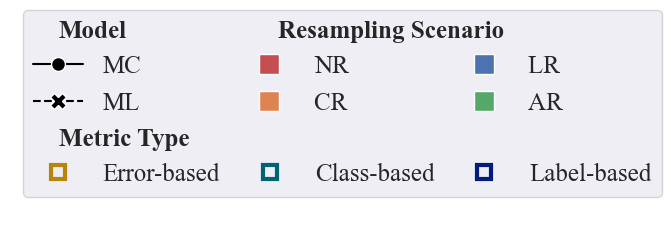

In [42]:

# metric_markers = {
#     '1 - Class Accuracy': 'o',
#     '1 - Label Accuracy': 's',
#     '1 - Label Recall': 'D',
#     '1 - Label Precision': 'X',
#     '1 - Label F1': '*'
# }

model_markers = {
    MC: 'o',
    ML: 'X'
}
marker_size = {
    MC: 70,
    ML: 100
}

marker_size_small = {
    MC: 8,
    ML: 10
}

fig, ax = plt.subplots(1,1, figsize=(0.1,0.1))
a = ax.scatter([1,2],[3,4], marker=model_markers[MC])
b = ax.scatter([1,2],[3,4], marker=model_markers[ML])
mc_mk, = a.get_paths()
ml_mk, = b.get_paths()
a.remove()
b.remove()
markers = [mc_mk, ml_mk]

ax.axis('off')
ax.set_xticks([], [])
ax.set_yticks([], [])


hl = 2.
cs = 1.
hlt = 0.25

lg1 = ax.legend(handles=[
    Line2D([0], [0], color='none', label=MODEL_COL),
    Line2D([0], [0], color='none', label=TRAIN_COL)
    ],
        loc='lower left', bbox_to_anchor=(0., 1.),
        handlelength=hlt, columnspacing=5.,
        fontsize=TICK_SIZE, ncols=2,
        )
rm_handles = [
    Line2D([0], [0], color=BLACK,
        marker=model_markers[mod], markersize=10 if mod == MC else 12,
        markeredgecolor=WHITE,
        linestyle=model_style[mod], lw=1.5,
        label=f"{abbreviations[mod]}"
    ) for m, mod in enumerate(model_names)
] + [
    Line2D([0], [0], color='none',
        marker='s', markersize=14,
        markeredgecolor=WHITE,
        markerfacecolor=CPAL[r],
        label=f"{abbreviations[res]} "
    ) for r, res in enumerate(resamplings)
]
lg2 = mlegend.Legend(ax,
                    handles=rm_handles,
                    labels=[h.get_label() for h in rm_handles],
                    fontsize=TICK_SIZE, 
                    handlelength=hl, columnspacing=cs*4.125,
                    loc='upper left', bbox_to_anchor=(1., 0.9), ncol=3, frameon=False)

lg5 = mlegend.Legend(ax,
                    handles=[
                        Line2D([0], [0], color='none', label=MET_COL)
                        ],
                    labels=[MET_COL],
                    fontsize=TICK_SIZE, 
                    handlelength=hlt,
                    loc='upper left', bbox_to_anchor=(1., 0.9), ncol=1, frameon=False)
mg_handles = [
    Line2D([0], [0], color='none',
        marker='s', markersize=12,
        markeredgecolor=WHITE,
        markerfacecolor=TPAL[metric_color[met]],
        label=f"{abbreviations[met]}" + (" " if m < 3 else "")
    ) for m, met in enumerate(article_metric_names)
]
lg6 = mlegend.Legend(ax,
                    handles=mg_handles,
                    labels=[h.get_label() for h in mg_handles],
                    fontsize=TICK_SIZE, 
                    handlelength=hl, columnspacing=cs*3.4,
                    loc='upper left', bbox_to_anchor=(1., 0.9), ncol=3, frameon=False)

lg7 = mlegend.Legend(ax,
                    handles=[
                        Line2D([0], [0], color='none', label=MG_COL)
                        ],
                    labels=[MG_COL],
                    fontsize=TICK_SIZE, 
                    handlelength=hlt,
                    loc='upper left', bbox_to_anchor=(1., 0.9), ncol=1, frameon=False)
mg_handles = [
    Line2D([0], [0], color='none',
        marker='s', markersize=10,
        markeredgecolor=TPAL[met_group_color[mgroup]],
        markeredgewidth=3.,
        markerfacecolor='none',
        label=f"{mgroup.capitalize()}-based"
    ) for mg, mgroup in enumerate(met_group_lists.keys())
]
lg8 = mlegend.Legend(ax,
                    handles=mg_handles,
                    labels=[h.get_label() for h in mg_handles],
                    fontsize=TICK_SIZE, 
                    handlelength=hl, columnspacing=cs,
                    loc='upper left', bbox_to_anchor=(1., 0.9), ncol=3, frameon=False)

legends = [
    lg1, lg2,
    # lg3, lg4,
    # lg5, lg6,
    lg7, lg8
]
# Manually combine the legends
for leg in legends[1:]:
    for child in leg._legend_box._children:
        lg1._legend_box._children.append(child)
lg1._legend_box.align = "left"


bold_labels = [MODEL_COL, TRAIN_COL, MET_COL,
               TRAIN_COL.replace(' ', '\n'), MG_COL]
for lts in [leg.get_texts() for leg in legends]:
    for text in lts:
        t = text.get_text()
        if t in bold_labels:
            text.set_fontweight('bold')
            text.set_fontsize(TICK_SIZE)
            
plt.savefig(os.path.join(PLOTS, 'example_legend.pdf'), bbox_inches='tight')

#### Key Metrics

In [323]:
key_mets = all_results_filt[all_results_filt[EVAL_COL] == ID].melt(
    id_vars=[EVAL_COL, TRAIN_COL, MODEL_COL],
    var_name=MET_COL,
    value_name=VAL_COL
)
key_mets[MG_COL] = key_mets[MET_COL].apply(
    lambda m: ('error' if m in met_group_lists['error'] else
               'class' if m in met_group_lists['class'] else
               'label')
)
key_mets.head()

,Evaluation,Resampling Scenario,Model,Metric,Value,Metric Type
0,In-distribution,No Resampling,Multiclass,Class error,0.047354,error
1,In-distribution,No Resampling,Multilabel,Class error,0.015979,error
2,In-distribution,Class Resampled,Multiclass,Class error,0.013648,error
3,In-distribution,Class Resampled,Multilabel,Class error,0.013732,error
4,In-distribution,Label Resampled,Multiclass,Class error,0.018309,error


In [45]:
TPAL

[(0.34901960784313724, 0.11764705882352941, 0.44313725490196076),
 (0.7215686274509804, 0.5215686274509804, 0.0392156862745098),
 (0.34901960784313724, 0.1843137254901961, 0.050980392156862744),
 (0.6352941176470588, 0.20784313725490197, 0.5098039215686274),
 (0.0, 0.38823529411764707, 0.4549019607843137),
 (0.5490196078431373, 0.03137254901960784, 0.0),
 (0.6941176470588235, 0.25098039215686274, 0.050980392156862744),
 (0.0, 0.10980392156862745, 0.4980392156862745),
 (0.07058823529411765, 0.44313725490196076, 0.10980392156862745),
 (0.23529411764705882, 0.23529411764705882, 0.23529411764705882)]

[None, None, None]

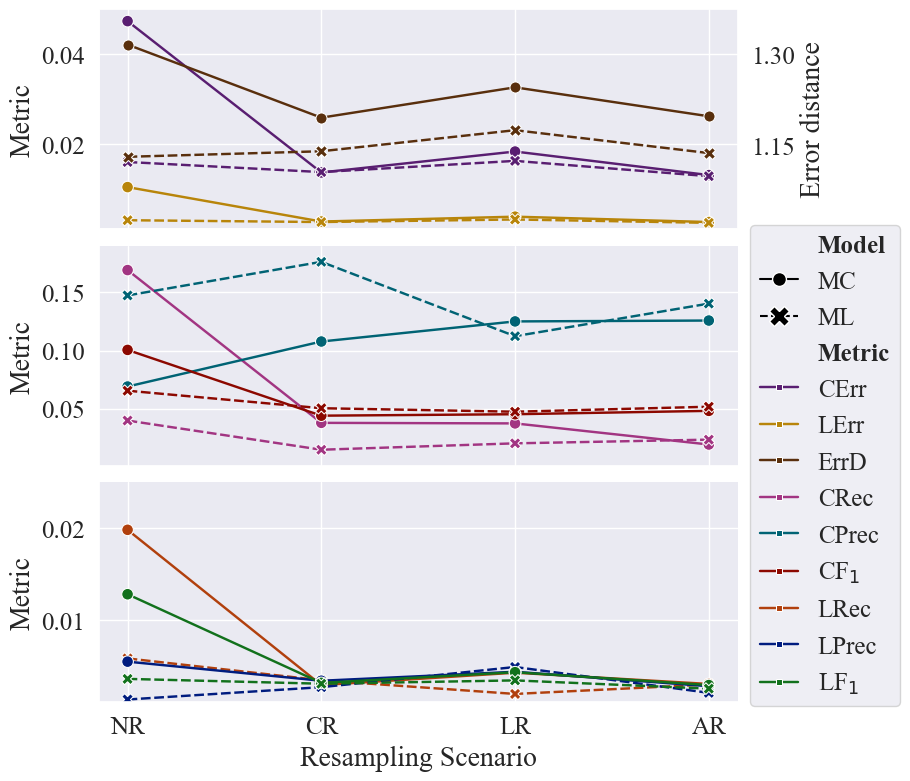

In [ ]:

data = key_mets[
    key_mets[MET_COL] != errDist
    ]
g = sns.FacetGrid(data, row=MG_COL, 
                hue=MET_COL, hue_order=metric_color, 
                palette=TPAL,
                sharey=False,
                height=3, aspect=2.75,
                gridspec_kws={
                    'hspace': 0.075
                }
    )
g.map(sns.lineplot, TRAIN_COL, VAL_COL,
    style=data[MODEL_COL], style_order=model_style, legend=False,
    zorder=1,
    linewidth=1.75)
g.map(sns.scatterplot, TRAIN_COL, VAL_COL,
    style=data[MODEL_COL], markers=model_markers, legend=False,
    zorder=2,
    linewidth=.75,
    s=70)
g.set_titles("")

axes = [ax for a, ax in g.axes_dict.items()]

ax2 = axes[0].twinx()
ax2.grid(False)

axes[0].yaxis.set_major_locator(ticker.MultipleLocator(0.02, 0))
axes[0].set_ylim(0.001, 0.05)

ax2.yaxis.set_major_locator(ticker.MultipleLocator(0.15, 1))
ax2.set_ylim(1.01, 1.375)

# axes[1].yaxis.set_major_locator(ticker.MultipleLocator(0.02, 0))
axes[1].set_ylim(0.001, 0.19)

# axes[2].yaxis.set_major_locator(ticker.MultipleLocator(0.02, 0))
axes[2].set_ylim(0.001, 0.025)

sns.lineplot(data=key_mets[
    key_mets[MET_COL] == errDist
    ], x=TRAIN_COL, y=VAL_COL,
        style=MODEL_COL, style_order=model_style,
        markers=model_markers, markersize=8,
        color=TPAL[metric_color[errDist]], linewidth=1.75,
        legend=False, zorder=1,
        ax=ax2)

handles = [
    Line2D([0], [0], color='none', label=MODEL_COL)
] + [
    Line2D([0], [0], color=BLACK,
        marker=model_markers[mod], markersize=marker_size[mod] // 7,
        markeredgecolor=WHITE,
        linestyle=model_style[mod], lw=1.5,
        label=f"{abbreviations[mod]}") for m, mod in enumerate(model_names)
    ]

lg1 = axes[1].legend(
    handles=handles,
    labels=[h.get_label() for h in handles],
    loc='center left', bbox_to_anchor=(1., 0),
    handlelength=1.5, #columnspacing=3.,
    fontsize=TICK_SIZE, ncols=1,
    #   frameon=False
    )

bold_labels = [MODEL_COL, MET_COL]
handles = [
    Line2D([0], [0], color='none', label=MET_COL)
]
for i, m in enumerate(article_metric_names):
    m_col = metric_color[m] 
    handles.append(Line2D([0], [0], color=TPAL[m_col], alpha=1,
        marker='s', markersize=5,
        markeredgecolor=WHITE,
        lw=1.75, markerfacecolor=TPAL[m_col], markeredgewidth=0.75,
        label="{}".format(
            abbreviations[m]
        )))

lg2 = mlegend.Legend(axes[1],
    handles=handles, labels=[h.get_label() for h in handles],
    loc='upper left', bbox_to_anchor=(1., 1.1),
    handlelength=1.5,
    fontsize=TICK_SIZE, ncols=1,
    #   frameon=False
)


# Manually combine the legends
for child in lg2._legend_box._children:
    lg1._legend_box._children.append(child)
lg1._legend_box.align = "left"

for text in (
    lg1.get_texts() + lg2.get_texts()
):
    t = text.get_text()
    if t in bold_labels:
        text.set_fontweight('bold')

ticks = [mtext.Text(t, 0, abbreviations[tick.get_text()]) for t, tick in enumerate(axes[2].get_xticklabels())]

ax2.set_ylabel(f"{errDist}", fontsize=LBL_SIZE)
ax2.tick_params(axis='both', right=False, labelsize=TICK_SIZE)
axes[2].set_xticklabels(ticks)
[ax.set_ylabel(f"{MET_COL}", fontsize=LBL_SIZE) for ax in axes]
axes[2].set_xlabel(TRAIN_COL, fontsize=LBL_SIZE)
[ax.tick_params(axis='both', left=False, labelsize=TICK_SIZE) for ax in axes]

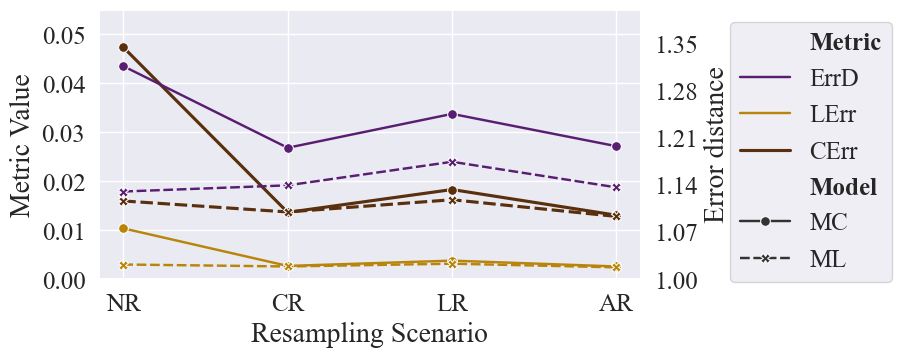

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(7,3.5))
ax2 = ax.twinx()
ax2.grid(False)

ax.yaxis.set_major_locator(ticker.MultipleLocator(0.01, -0.01))
ax.set_ylim(0, 0.055)
ax2.yaxis.set_major_locator(ticker.MultipleLocator(0.07, 0.93))
ax2.set_ylim(1, 1.4)

sns.lineplot(data=key_mets[
    key_mets[MET_COL] == errDist
    ], x=TRAIN_COL, y=VAL_COL,
        style=MODEL_COL, style_order=model_style,
        markers=model_markers, markersize=7,
        color=TPAL[0], linewidth=1.75,
        legend=False, zorder=2,
        ax=ax2)
lines = sns.lineplot(data=key_mets[
        key_mets[MET_COL].isin(met_group_lists['error']) &
        (key_mets[MET_COL] != errDist)
        ], x=TRAIN_COL, y=VAL_COL,
            hue=MET_COL, hue_order=[lErr, cErr],
            style=MODEL_COL, style_order=model_style,
            markers=model_markers, markersize=7,
            palette=TPAL[1:], linewidth=1.75, zorder=3,
            ax=ax)

for ln in lines.get_lines():
    if ln.get_color() == TPAL[2]:
        ln.set_linewidth(2.25)

handles, labels = ax.get_legend_handles_labels()
handles.insert(1, Line2D([0], [0], color=TPAL[0], linewidth=1.75, label=errDist))

legend = ax.legend(handles=handles, loc='upper left', bbox_to_anchor=(1.14, 1.), fontsize=TICK_SIZE)

bold_labels = [MODEL_COL, MET_COL]
for text in legend.get_texts():
    t = text.get_text()
    if t in bold_labels:
        text.set_fontweight('bold')
        text.set_fontsize(TICK_SIZE)
    if t in abbreviations:
        text.set_text(abbreviations[t])
        
# ticks = [mtext.Text(t, 0, tick.get_text().replace(' ', '\n')) for t, tick in enumerate(ax.get_xticklabels())]
ticks = [mtext.Text(t, 0, abbreviations[tick.get_text()]) for t, tick in enumerate(ax.get_xticklabels())]

ax2.set_ylabel(f"{errDist}", fontsize=LBL_SIZE)
ax2.tick_params(axis='both', right=False, labelsize=TICK_SIZE)
ax.set_xticklabels(ticks)
ax.set_ylabel(f"{MET_COL} {VAL_COL}", fontsize=LBL_SIZE)
ax.set_xlabel(TRAIN_COL, fontsize=LBL_SIZE)
ax.tick_params(axis='both', left=False, labelsize=TICK_SIZE)
# plt.tight_layout()


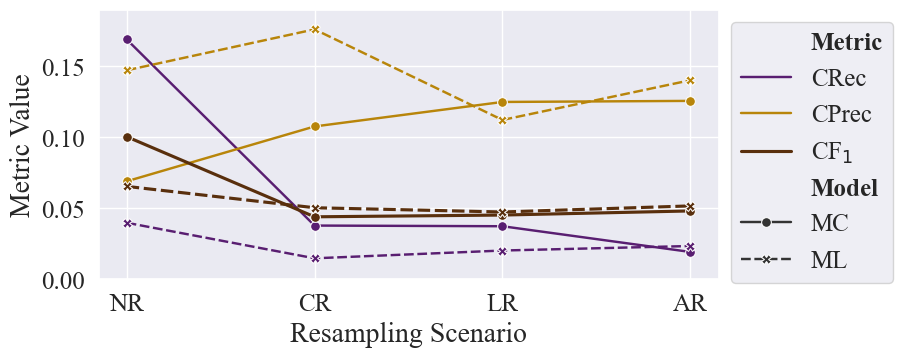

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(8,3.5))

ax.yaxis.set_major_locator(ticker.MultipleLocator(0.05, -0.05))
ax.set_ylim(0, 0.19)

lines = sns.lineplot(data=key_mets[
        key_mets[MET_COL].isin(met_group_lists['class'])
        ], x=TRAIN_COL, y=VAL_COL,
            hue=MET_COL,# hue_order=training_color,
            style=MODEL_COL, style_order=model_style,
            markers=model_markers, markersize=7,
            palette=TPAL, linewidth=1.75,
            ax=ax)

for ln in lines.get_lines():
    if ln.get_color() == TPAL[2]:
        ln.set_linewidth(2.25)

legend = plt.legend(loc='upper left', bbox_to_anchor=(1.0, 1.), fontsize=TICK_SIZE)

bold_labels = [MODEL_COL, MET_COL]
for text in legend.get_texts():
    t = text.get_text()
    if t in bold_labels:
        text.set_fontweight('bold')
        text.set_fontsize(TICK_SIZE)
    if t in abbreviations:
        text.set_text(abbreviations[t])
        
for handle in legend.legend_handles:
    lbl = handle.get_label()
    if lbl == cF1:
        handle.set_linewidth(2.25)

# ticks = [mtext.Text(t, 0, tick.get_text().replace(' ', '\n')) for t, tick in enumerate(ax.get_xticklabels())]
ticks = [mtext.Text(t, 0, abbreviations[tick.get_text()]) for t, tick in enumerate(ax.get_xticklabels())]
ax.set_xticklabels(ticks)
ax.set_ylabel(f"{MET_COL} {VAL_COL}", fontsize=LBL_SIZE)
ax.set_xlabel(TRAIN_COL, fontsize=LBL_SIZE)
ax.tick_params(axis='both', left=False, labelsize=TICK_SIZE)

# plt.tight_layout()

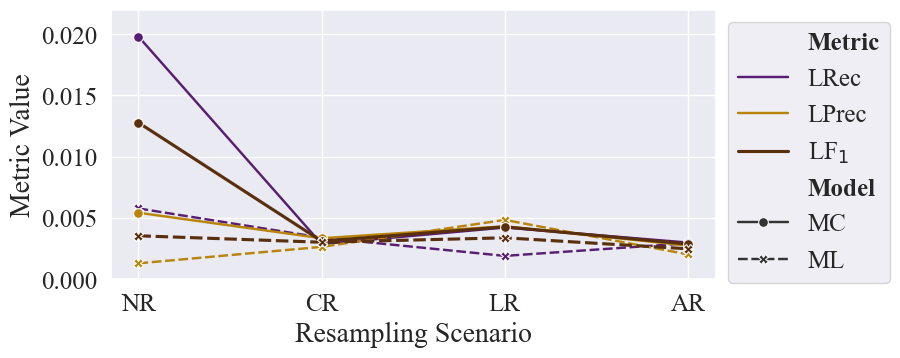

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(7.8,3.5))

ax.yaxis.set_major_locator(ticker.MultipleLocator(0.005, -0.005))
ax.set_ylim(0, 0.022)

lines = sns.lineplot(data=key_mets[
        key_mets[MET_COL].isin(met_group_lists['label'])
        ], x=TRAIN_COL, y=VAL_COL,
            hue=MET_COL,# hue_order=training_color,
            style=MODEL_COL, style_order=model_style,
            markers=model_markers, markersize=7,
            palette=TPAL, linewidth=1.75,
            ax=ax)

for ln in lines.get_lines():
    if ln.get_color() == TPAL[2]:
        ln.set_linewidth(2.25)

legend = plt.legend(loc='upper left', bbox_to_anchor=(1.0, 1.), fontsize=TICK_SIZE)

bold_labels = [MODEL_COL, MET_COL]
for text in legend.get_texts():
    t = text.get_text()
    if t in bold_labels:
        text.set_fontweight('bold')
        text.set_fontsize(TICK_SIZE)
    if t in abbreviations:
        text.set_text(abbreviations[t])
        
for handle in legend.legend_handles:
    lbl = handle.get_label()
    if lbl == lF1:
        handle.set_linewidth(2.25)

# ticks = [mtext.Text(t, 0, tick.get_text().replace(' ', '\n')) for t, tick in enumerate(ax.get_xticklabels())]
ticks = [mtext.Text(t, 0, abbreviations[tick.get_text()]) for t, tick in enumerate(ax.get_xticklabels())]
ax.set_xticklabels(ticks)
ax.set_ylabel(f"{MET_COL} {VAL_COL}", fontsize=LBL_SIZE)
ax.set_xlabel(TRAIN_COL, fontsize=LBL_SIZE)
ax.tick_params(axis='both', labelsize=TICK_SIZE)

# plt.tight_layout()

In [324]:
ood_mets = all_results_filt[all_results_filt[EVAL_COL] == DSBI].melt(
    id_vars=[EVAL_COL, TRAIN_COL, MODEL_COL],
    var_name=MET_COL,
    value_name=VAL_COL
)
ood_mets[MG_COL] = ood_mets[MET_COL].apply(
    lambda m: ('error' if m in met_group_lists['error'] else
               'class' if m in met_group_lists['class'] else
               'label')
)
ood_mets.head()

,Evaluation,Resampling Scenario,Model,Metric,Value,Metric Type
0,DSBI,No Resampling,Multiclass,Class error,0.279199,error
1,DSBI,No Resampling,Multilabel,Class error,0.061082,error
2,DSBI,Class Resampled,Multiclass,Class error,0.055581,error
3,DSBI,Class Resampled,Multilabel,Class error,0.023714,error
4,DSBI,Label Resampled,Multiclass,Class error,0.089114,error


[None, None, None]

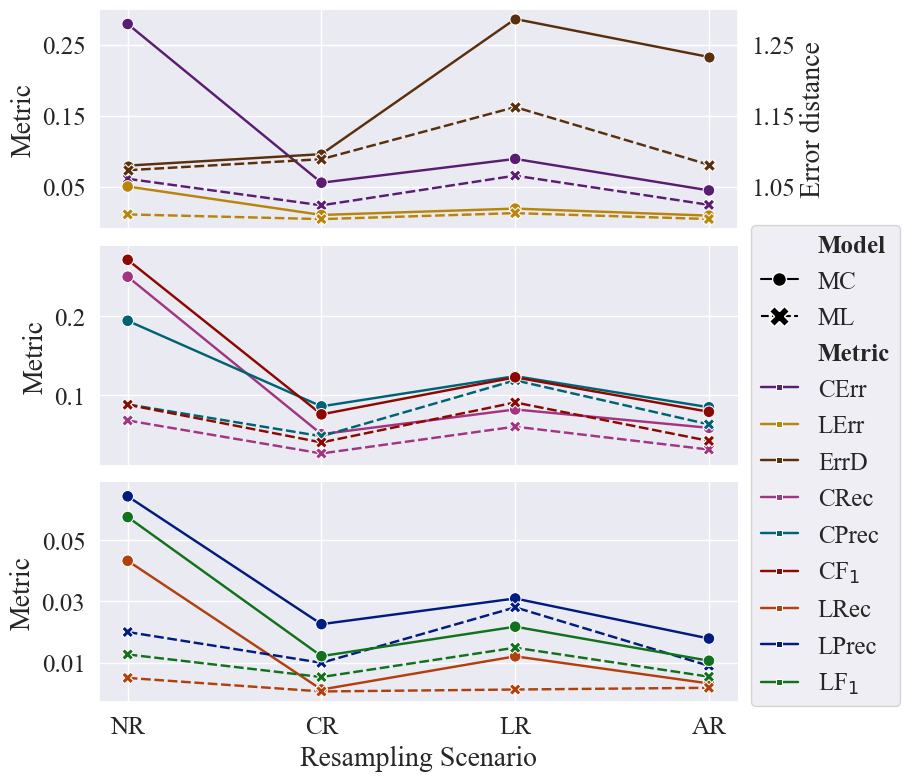

In [ ]:

data = ood_mets[
    ood_mets[MET_COL] != errDist
    ]
g = sns.FacetGrid(data, row=MG_COL, hue=MET_COL,
                  hue_order=metric_color, palette=TPAL,
    sharey=False,
    height=3, aspect=2.75,
    gridspec_kws={
        'hspace': 0.075
    }
    )
g.map(sns.lineplot, TRAIN_COL, VAL_COL,
    style=data[MODEL_COL], style_order=model_style, legend=False,
    zorder=1,
    linewidth=1.75)
g.map(sns.scatterplot, TRAIN_COL, VAL_COL,
    style=data[MODEL_COL], markers=model_markers, legend=False,
    zorder=2,
    linewidth=.75,
    s=70)
g.set_titles("")

axes = [ax for a, ax in g.axes_dict.items()]

ax2 = axes[0].twinx()
ax2.grid(False)

axes[0].yaxis.set_major_locator(ticker.MultipleLocator(0.1, -0.05))
axes[0].set_ylim(-0.01, 0.3)

ax2.yaxis.set_major_locator(ticker.MultipleLocator(0.1, 0.95))
ax2.set_ylim(0.99, 1.3)

# axes[1].yaxis.set_major_locator(ticker.MultipleLocator(0.02, 0))
axes[1].set_ylim(0.01, 0.29)

axes[2].yaxis.set_major_locator(ticker.MultipleLocator(0.02, -0.01))
axes[2].set_ylim(-0.003, 0.069)

sns.lineplot(data=ood_mets[
    ood_mets[MET_COL] == errDist
    ], x=TRAIN_COL, y=VAL_COL,
        style=MODEL_COL, style_order=model_style,
        markers=model_markers, markersize=8,
        color=TPAL[metric_color[errDist]], linewidth=1.75,
        legend=False, zorder=1,
        ax=ax2)

handles = [
    Line2D([0], [0], color='none', label=MODEL_COL)
] + [
    Line2D([0], [0], color=BLACK,
        marker=model_markers[mod], markersize=marker_size[mod] // 7,
        markeredgecolor=WHITE,
        linestyle=model_style[mod], lw=1.5,
        label=f"{abbreviations[mod]}") for m, mod in enumerate(model_names)
    ]

lg1 = axes[1].legend(
    handles=handles,
    labels=[h.get_label() for h in handles],
    loc='center left', bbox_to_anchor=(1., 0),
    handlelength=1.5, #columnspacing=3.,
    fontsize=TICK_SIZE, ncols=1,
    #   frameon=False
    )

bold_labels = [MODEL_COL, MET_COL]
handles = [
    Line2D([0], [0], color='none', label=MET_COL)
]
for i, m in enumerate(article_metric_names):
    m_col = metric_color[m]
    handles.append(Line2D([0], [0], color=TPAL[m_col], alpha=1,
        marker='s', markersize=5,
        markeredgecolor=WHITE,
        lw=1.75, markerfacecolor=TPAL[m_col], markeredgewidth=0.75,
        label="{}".format(
            abbreviations[m]
        )))

lg2 = mlegend.Legend(axes[1],
    handles=handles, labels=[h.get_label() for h in handles],
    loc='upper left', bbox_to_anchor=(1., 1.1),
    handlelength=1.5,
    fontsize=TICK_SIZE, ncols=1,
    #   frameon=False
)


# Manually combine the legends
for child in lg2._legend_box._children:
    lg1._legend_box._children.append(child)
lg1._legend_box.align = "left"

for text in (
    lg1.get_texts() + lg2.get_texts()
):
    t = text.get_text()
    if t in bold_labels:
        text.set_fontweight('bold')

ticks = [mtext.Text(t, 0, abbreviations[tick.get_text()]) for t, tick in enumerate(axes[2].get_xticklabels())]

ax2.set_ylabel(f"{errDist}", fontsize=LBL_SIZE)
ax2.tick_params(axis='both', right=False, labelsize=TICK_SIZE)
axes[2].set_xticklabels(ticks)
[ax.set_ylabel(f"{MET_COL}", fontsize=LBL_SIZE) for ax in axes]
axes[2].set_xlabel(TRAIN_COL, fontsize=LBL_SIZE)
[ax.tick_params(axis='both', left=False, labelsize=TICK_SIZE) for ax in axes]

In [325]:
all_results_melted = pd.melt(all_results_filt, id_vars=[EVAL_COL, TRAIN_COL, MODEL_COL], value_name=VAL_COL, var_name=MET_COL)
all_results_melted[MG_COL] = all_results_melted[MET_COL].apply(
    lambda m: ('error' if m in met_group_lists['error'] else
               'class' if m in met_group_lists['class'] else
               'label')
)
all_results_melted.head()

,Evaluation,Resampling Scenario,Model,Metric,Value,Metric Type
0,In-distribution,No Resampling,Multiclass,Class error,0.047354,error
1,In-distribution,No Resampling,Multilabel,Class error,0.015979,error
2,In-distribution,Class Resampled,Multiclass,Class error,0.013648,error
3,In-distribution,Class Resampled,Multilabel,Class error,0.013732,error
4,In-distribution,Label Resampled,Multiclass,Class error,0.018309,error


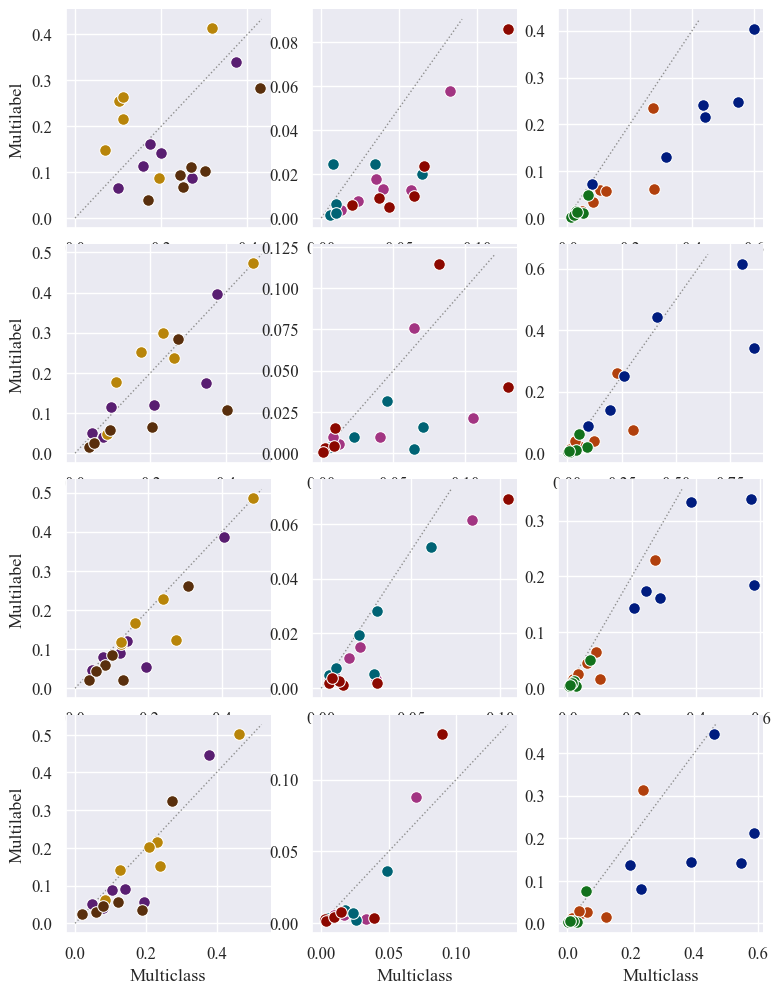

In [ ]:
data = all_results_melted.pivot(columns=[MODEL_COL], index=[EVAL_COL, TRAIN_COL, MET_COL], values=VAL_COL).reset_index()

data[MG_COL] = data[MET_COL].apply(
    lambda m: ('error' if m in met_group_lists['error'] else
               'class' if m in met_group_lists['class'] else
               'label')
)

data.loc[data[MET_COL] == errDist, [MC, ML]] = data.loc[data[MET_COL] == errDist, [MC, ML]] - 1

g = sns.FacetGrid(data, col=MG_COL, row=TRAIN_COL,
              hue=MET_COL, palette=TPAL,
    sharey=False,
    sharex=False,
    # markers=model_markers, markersize=7,
    # linewidth=1.75,
    # legend=False, zorder=2,
    height=3, aspect=1,
    gridspec_kws={
        'hspace': 0.075
    }
    )

g.map(sns.scatterplot, MC, ML,
    # style=data[MODEL_COL], markers=model_markers,
    legend=False,
    zorder=2,
    linewidth=.75,
    s=70)
g.set_titles("")

axes = [ax for a, ax in g.axes_dict.items()]
for ax in axes:
    y_max = ax.get_ylim()[1]
    sns.lineplot(x=[0,y_max], y=[0,y_max],
        # style=data[MODEL_COL], style_order=model_style,
        legend=False,
        zorder=1,
        linewidth=1.,
        color=GREY,
        linestyle=':', ax=ax)

<Axes: xlabel='Multiclass', ylabel='Multilabel'>

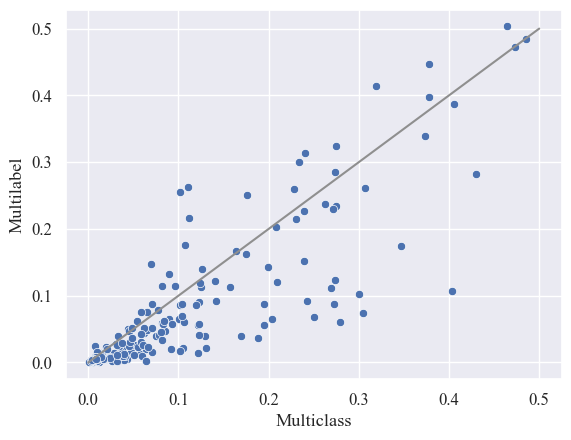

In [ ]:
sns.scatterplot(all_results_melted[all_results_melted[MET_COL] != errDist].pivot(columns=[MODEL_COL], index=[EVAL_COL, TRAIN_COL, MET_COL], values=VAL_COL),
                x=MC, y=ML)
sns.lineplot(x=[0,0.5], y=[0,0.5], color=GREY)

In [326]:
def normalised_performance(group, maxp):
    met = tuple(group[[EVAL_COL, MET_COL]].iloc[0].to_list())
    group[VAL_COL] = group[VAL_COL] / maxp.loc[met].iloc[0]
    return group

idx = [TRAIN_COL, MODEL_COL, MG_COL]
gb = [EVAL_COL, MET_COL]
all_results_normalised = all_results_melted.set_index(idx)

max_perf = all_results_normalised.groupby(gb).agg('max')
norm_vals = all_results_normalised.groupby(gb).apply(normalised_performance, maxp=max_perf)[VAL_COL].reset_index().set_index(idx + gb)
all_results_normalised = all_results_normalised.reset_index().set_index(idx + gb)
all_results_normalised["Normalised"] = norm_vals
all_results_normalised.reset_index(inplace=True)
all_results_normalised.head(10)
# max_perf

C:\Users\User\AppData\Local\Temp\ipykernel_27620\2016805272.py:10: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  max_perf = all_results_normalised.groupby(gb).agg('max')
C:\Users\User\AppData\Local\Temp\ipykernel_27620\2016805272.py:11: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  norm_vals = all_results_normalised.groupby(gb).apply(normalised_performance, maxp=max_perf)[VAL_COL].reset_index().set_index(idx + gb)
C:\Users\User\AppData\Local\Temp\ipykernel_27620\2016805272.py:11: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version o

,Resampling Scenario,Model,Metric Type,Evaluation,Metric,Value,Normalised
0,No Resampling,Multiclass,error,In-distribution,Class error,0.047354,1.000000
1,No Resampling,Multilabel,error,In-distribution,Class error,0.015979,0.337434
2,Class Resampled,Multiclass,error,In-distribution,Class error,0.013648,0.288225
3,Class Resampled,Multilabel,error,In-distribution,Class error,0.013732,0.289982
4,Label Resampled,Multiclass,error,In-distribution,Class error,0.018309,0.386643
5,Label Resampled,Multilabel,error,In-distribution,Class error,0.016228,0.342707
6,Adaptive Resampled,Multiclass,error,In-distribution,Class error,0.013066,0.275923
7,Adaptive Resampled,Multilabel,error,In-distribution,Class error,0.012816,0.270650
8,No Resampling,Multiclass,error,DSBI,Class error,0.279199,1.000000
9,No Resampling,Multilabel,error,DSBI,Class error,0.061082,0.218777


In [321]:
[abbreviations[i].lower() for i in main_evals]

['id', 'ood']

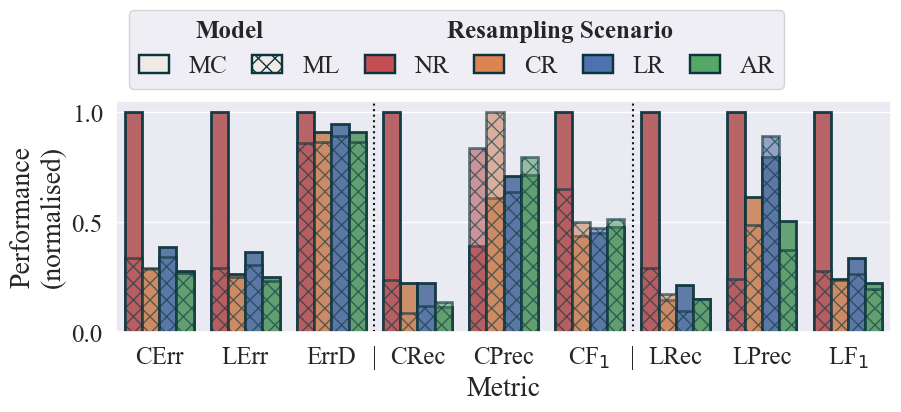

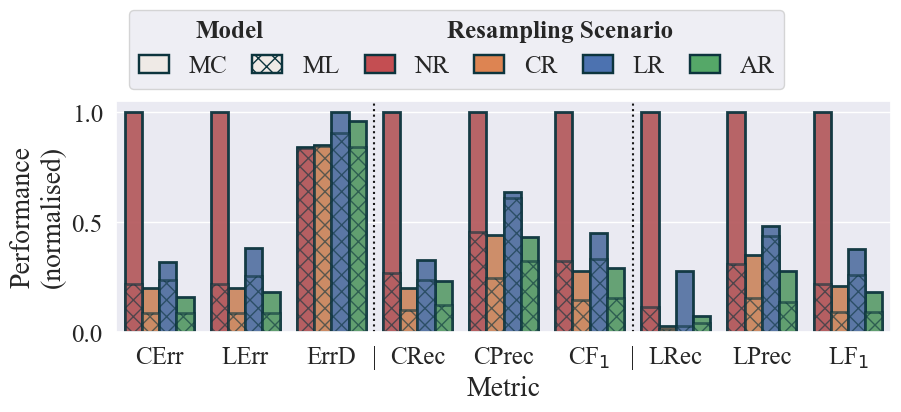

In [327]:

for e, eval in enumerate(main_evals):
    fig, ax = plt.subplots(1, 1, figsize=(10,3),
                         sharex=True)
    df_sub = all_results_normalised[all_results_normalised[EVAL_COL] == eval]
    ml_bars = sns.barplot(data=df_sub[df_sub[MODEL_COL] == ML],
                        x=MET_COL, y="Normalised",
                width=0.8, #gap=0.5,
                hue=TRAIN_COL, hue_order=training_color,
                alpha=0.6,
                zorder=2,
                linewidth=2.,
                edgecolor=DARK,
                legend=False,
                palette=CPAL,
                ax=ax)

    for bar in ml_bars.patches:
        bar.set_hatch(model_hatches[ML])
        
    mc_bars = sns.barplot(data=df_sub[df_sub[MODEL_COL] == MC], 
                        x=MET_COL, y="Normalised",
                width=0.8,
                hue=TRAIN_COL, hue_order=training_color,
                alpha=0.95,
                zorder=1,
                linewidth=2.,
                edgecolor=DARK,
                legend=False,
                palette=CPAL,
                ax=ax)
    ax.tick_params(axis='both', left=False, labelsize=TICK_SIZE)
    # ax.set_title(eval, fontsize=LBL_SIZE)
    ax.set_ylabel(f"Performance\n(normalised)", fontsize=LBL_SIZE)
    ax.yaxis.set_major_locator(ticker.MultipleLocator(0.5))
    
    yl = ax.get_ylim()
    ax.set_ylim(yl)
    ax.axvline(x=2.5, ymin=0, ymax=yl[1], color=BLACK, alpha=0.9,
                 linestyle=':', linewidth=1.5)
    ax.axvline(x=5.5, ymin=0, ymax=yl[1], color=BLACK, alpha=0.9,
                 linestyle=':', linewidth=1.5)

    # Build up legend:
    lg1 = ax.legend(handles=[
        Line2D([0], [0], color='none', label=MODEL_COL),
        Line2D([0], [0], color='none', label=TRAIN_COL)
        ],
            loc='lower left', bbox_to_anchor=(0., 1.),
            handlelength=1.5, columnspacing=5.,
            fontsize=TICK_SIZE, ncols=2,
            )
    handles = [
        Patch(edgecolor=DARK, facecolor=LIGHT,
            linestyle='-', lw=1.75, hatch=model_hatches[mod],
            label=f"{abbreviations[mod]}") for m, mod in enumerate(model_names)
        ] + [
            Patch(edgecolor=DARK, facecolor=CPAL[rs],
                    linestyle='-', lw=1.75,
                    label=f"{abbreviations[resam]}") for rs, resam in enumerate(resamplings)
        ]
    lg2 = mlegend.Legend(ax,
                        handles=handles,
                        labels=[h.get_label() for h in handles],
                        fontsize=TICK_SIZE, 
                        handlelength=1.2, columnspacing=1.,
                        loc='upper left', bbox_to_anchor=(1., 0.9), ncol=6, frameon=False)


    # Manually combine the legends
    for child in lg2._legend_box._children:
        lg1._legend_box._children.append(child)
    lg1._legend_box.align = "left"

    # Make only the desired labels bold
    bold_labels = [MODEL_COL, MET_COL, TRAIN_COL]
    for text in (
        lg1.get_texts() + lg2.get_texts()
    ):
        t = text.get_text()
        if t in bold_labels:
            text.set_fontweight('bold')
            text.set_fontsize(TICK_SIZE)
        if t in abbreviations:
            text.set_text(abbreviations[t])
            
    labels = []
    ticks = []
    for t, label in enumerate(article_metric_names):
        tx_1 = abbreviations[label]
        labels.append(mtext.Text(t, 0, tx_1))
        ticks.append(t)
    ticks = ticks + [2.5, 5.5]
    labels = labels + ["|", "|"]

    ax.set_xticks(ticks=ticks, labels=labels)
    ax.set_xlabel(MET_COL, fontsize=LBL_SIZE)
            
    plt.savefig(os.path.join(PLOT_EVALS, f'{abbreviations[eval].lower()}_norm_metrics.pdf'), bbox_inches='tight')
    # plt.tight_layout()

#### Model Generalisation

In [328]:
GR = "Generalisation Ratio"

In [329]:
in_out_results = all_results[all_results[EVAL_COL].isin(eval_groups['test'])][head_cols + article_metric_names]
in_out_results.head()

,Evaluation,Resampling Scenario,Model,Class error,Label error,Error distance,1 - class recall,1 - class precision,1 - class F1,1 - label recall,1 - label precision,1 - label F1
0,In-distribution,No Resampling,Multiclass,0.047354,0.010389,1.316344,0.169101,0.069055,0.100512,0.019811,0.005430,0.012783
20,In-distribution,No Resampling,Multilabel,0.015979,0.003010,1.130208,0.039840,0.147310,0.065471,0.005780,0.001300,0.003549
5,In-distribution,Class Resampled,Multiclass,0.013648,0.002719,1.195122,0.037852,0.107726,0.044021,0.002874,0.003345,0.003111
25,In-distribution,Class Resampled,Multilabel,0.013732,0.002608,1.139394,0.014763,0.176183,0.050421,0.003394,0.002645,0.003022
10,In-distribution,Label Resampled,Multiclass,0.018309,0.003800,1.245455,0.037381,0.124994,0.045262,0.004223,0.004325,0.004277


In [330]:
in_out_crosstable = pd.DataFrame()
for met in article_metric_names:
    # if 'Error' in met:
    #     continue
    pt = pd.pivot_table(in_out_results, index=[TRAIN_COL, MODEL_COL], columns=[EVAL_COL], values=met).reset_index()
    pt[MET_COL] = met
    in_out_crosstable = pd.concat([in_out_crosstable, pt])

in_out_crosstable[MET_COL] = pd.Categorical(in_out_crosstable[MET_COL], categories=article_metric_names, ordered=True)
in_out_crosstable.reset_index(inplace=True, drop=True)
in_out_crosstable.head()

C:\Users\User\AppData\Local\Temp\ipykernel_27620\567388146.py:5: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  pt = pd.pivot_table(in_out_results, index=[TRAIN_COL, MODEL_COL], columns=[EVAL_COL], values=met).reset_index()
C:\Users\User\AppData\Local\Temp\ipykernel_27620\567388146.py:5: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  pt = pd.pivot_table(in_out_results, index=[TRAIN_COL, MODEL_COL], columns=[EVAL_COL], values=met).reset_index()
C:\Users\User\AppData\Local\Temp\ipykernel_27620\567388146.py:5: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silenc

Evaluation,Resampling Scenario,Model,In-distribution,DSBI,Metric
0,No Resampling,Multiclass,0.047354,0.279199,Class error
1,No Resampling,Multilabel,0.015979,0.061082,Class error
2,Class Resampled,Multiclass,0.013648,0.055581,Class error
3,Class Resampled,Multilabel,0.013732,0.023714,Class error
4,Label Resampled,Multiclass,0.018309,0.089114,Class error


In [331]:
in_out_crosstable[MG_COL] = in_out_crosstable[MET_COL].apply(
    lambda m: ('error' if m in met_group_lists['error'] else
               'class' if m in met_group_lists['class'] else
               'label')
)

In [332]:
in_out_crosstable[GR] = in_out_crosstable[DSBI] / in_out_crosstable[ID]
in_out_crosstable.head()

Evaluation,Resampling Scenario,Model,In-distribution,DSBI,Metric,Metric Type,Generalisation Ratio
0,No Resampling,Multiclass,0.047354,0.279199,Class error,error,5.896049
1,No Resampling,Multilabel,0.015979,0.061082,Class error,error,3.822731
2,Class Resampled,Multiclass,0.013648,0.055581,Class error,error,4.072334
3,Class Resampled,Multilabel,0.013732,0.023714,Class error,error,1.726956
4,Label Resampled,Multiclass,0.018309,0.089114,Class error,error,4.867239


In [333]:
in_out_pivottable = pd.pivot_table(in_out_crosstable, index=[MET_COL], columns=[TRAIN_COL, MODEL_COL], values=GR)
in_out_pivottable.apply(round, ndigits=4)

C:\Users\User\AppData\Local\Temp\ipykernel_27620\2231060054.py:1: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  in_out_pivottable = pd.pivot_table(in_out_crosstable, index=[MET_COL], columns=[TRAIN_COL, MODEL_COL], values=GR)


Resampling Scenario No Resampling            Class Resampled             \
Model                  Multiclass Multilabel      Multiclass Multilabel   
Metric                                                                    
Class error                5.8960     3.8227          4.0723     1.7270   
Label error                4.8360     3.6299          3.7340     1.6502   
Error distance             0.8202     0.9496          0.9169     0.9555   
1 - class recall           1.4819     1.6975          1.3258     1.7373   
1 - class precision        2.8170     0.5980          0.7946     0.2700   
1 - class F1               2.7073     1.3392          1.7128     0.7871   
1 - label recall           2.1852     0.8585          0.4037     0.1574   
1 - label precision       11.8589    15.3767          6.7444     3.7453   
1 - label F1               4.5071     3.5632          3.8893     1.7385   

Resampling Scenario Label Resampled            Adaptive Resampled             
Model                    Multiclass Multilabel         Multiclass Multilabel  
Metric                                                                        
Class error                  4.8672     4.0394             3.4236     1.9033  
Label error                  5.0268     3.9974             3.5244     1.8104  
Error distance               1.0328     0.9896             1.0295     0.9512  
1 - class recall             2.1844     2.9522             3.0264     1.3061  
1 - class precision          0.9924     1.0576             0.6716     0.4462  
1 - class F1                 2.7078     1.9101             1.6331     0.8052  
1 - label recall             2.8486     0.6126             1.0526     0.5903  
1 - label precision          7.1592     5.7912             6.4972     4.4034  
1 - label F1                 5.0803     4.3923             3.6824     2.1590

In [334]:
display(in_out_pivottable.apply(np.quantile, q=0.25, axis=0).to_frame().T.round(2))
display(in_out_pivottable.apply(np.median, axis=0).to_frame().T.round(2))
display(in_out_pivottable.apply(np.quantile, q=0.75, axis=0).to_frame().T.round(2))

Resampling Scenario No Resampling            Class Resampled             \
Model                  Multiclass Multilabel      Multiclass Multilabel   
0                            2.19       0.95            0.92       0.79   

Resampling Scenario Label Resampled            Adaptive Resampled             
Model                    Multiclass Multilabel         Multiclass Multilabel  
0                              2.18       1.06               1.05       0.81

Resampling Scenario No Resampling            Class Resampled             \
Model                  Multiclass Multilabel      Multiclass Multilabel   
0                            2.82        1.7            1.71       1.65   

Resampling Scenario Label Resampled            Adaptive Resampled             
Model                    Multiclass Multilabel         Multiclass Multilabel  
0                              2.85       2.95               3.03       1.31

Resampling Scenario No Resampling            Class Resampled             \
Model                  Multiclass Multilabel      Multiclass Multilabel   
0                            4.84       3.63            3.89       1.74   

Resampling Scenario Label Resampled            Adaptive Resampled             
Model                    Multiclass Multilabel         Multiclass Multilabel  
0                              5.03       4.04               3.52        1.9

In [335]:
in_out_crosstable[in_out_crosstable[DSBI] > 0.2]

Evaluation,Resampling Scenario,Model,In-distribution,DSBI,Metric,Metric Type,Generalisation Ratio
0,No Resampling,Multiclass,0.047354,0.279199,Class error,error,5.896049
16,No Resampling,Multiclass,1.316344,1.079677,Error distance,error,0.820208
17,No Resampling,Multilabel,1.130208,1.073197,Error distance,error,0.949557
18,Class Resampled,Multiclass,1.195122,1.095820,Error distance,error,0.916911
19,Class Resampled,Multilabel,1.139394,1.088725,Error distance,error,0.955530
20,Label Resampled,Multiclass,1.245455,1.286276,Error distance,error,1.032777
21,Label Resampled,Multilabel,1.174359,1.162153,Error distance,error,0.989606
22,Adaptive Resampled,Multiclass,1.197452,1.232729,Error distance,error,1.029460
23,Adaptive Resampled,Multilabel,1.136364,1.080863,Error distance,error,0.951159
24,No Resampling,Multiclass,0.169101,0.250584,1 - class recall,class,1.481859


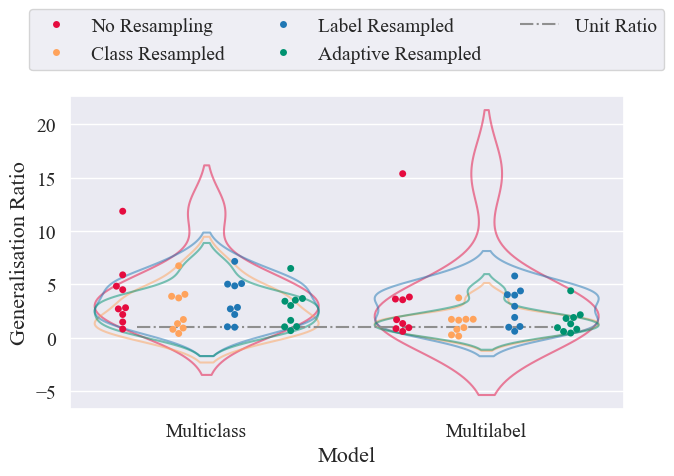

In [ ]:
plt.figure(figsize=(7,5))

sns.swarmplot(data=in_out_crosstable, x=MODEL_COL, y=GR, hue=TRAIN_COL, palette=CPAL, dodge=True)
for r, res in enumerate(resamplings):
    sns.violinplot(data=in_out_crosstable[in_out_crosstable[TRAIN_COL] == res], x=MODEL_COL, y=GR, color=CPAL[r],
                fill=None, linestyle='-', alpha=0.5,
                inner=None, density_norm='count'
                # inner='quart', inner_kws={'alpha': 0.5}
                )
# plt.axis('square')
# plot_edge = min(plt.xlim()[1], plt.ylim()[1])
sns.lineplot(x=[-0.25, 1.25], y=[1, 1], color=GREY, linestyle='-.', label='Unit Ratio')
plt.legend(loc='lower center', bbox_to_anchor=(0.5, 1.05), fontsize=TICK_SIZE, ncol=3)
plt.ylabel(GR, fontsize=LBL_SIZE)
plt.xlabel(MODEL_COL, fontsize=LBL_SIZE)
plt.tick_params(axis='both', labelsize=TICK_SIZE)

plt.tight_layout()

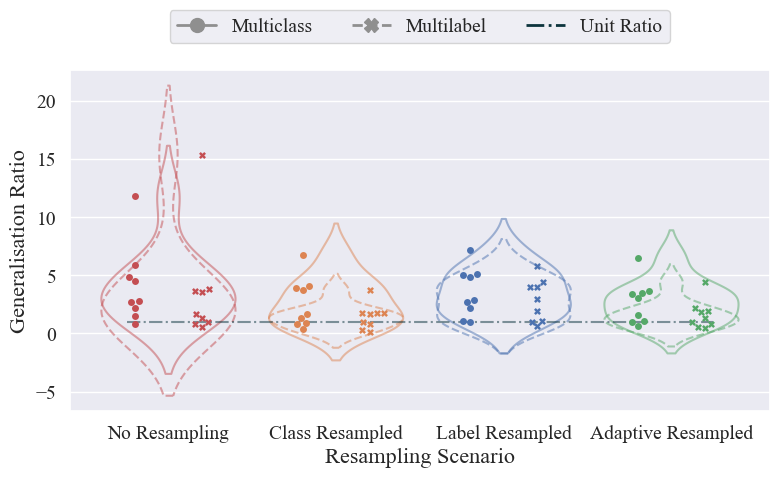

In [ ]:
plt.figure(figsize=(8,5))

dodge=True

handles = []
ax = sns.swarmplot(data=in_out_crosstable, x=TRAIN_COL, y=GR,
                   hue=MODEL_COL, palette=CPAL, dodge=dodge,
                   legend=False)

collections = ax.collections
unique_colors = np.unique(collections[0].get_facecolors(), axis=0)
markers = [mc_mk, ml_mk]

if dodge:
    N_hues = 2
    for c, collection in enumerate(collections[::N_hues]):
        collection.set_paths([mc_mk])
        collection.set_facecolor(CPAL[c])
    for c, collection in enumerate(collections[1::N_hues]):
        collection.set_paths([ml_mk])
        collection.set_facecolor(CPAL[c])
else:
    for c, collection in enumerate(collections):
        paths = []
        for current_color in collection.get_facecolors():
            for possible_marker,possible_color in zip(markers, unique_colors):
                if np.array_equal(current_color,possible_color):
                    paths.append(possible_marker)
                    break
        collection.set_paths(paths)
        collection.set_facecolor(CPAL[c])

for m, mod in enumerate(model_names):
    # handles.append(Line2D([0], [0], color=GREY, linestyle=model_style[mod], lw=2, label=mod))
    handles.append(Line2D([0], [0], color=GREY,
                          marker=model_markers[mod], markersize=10,
                          linestyle=model_style[mod], lw=2,
                          label=mod))
    sns.violinplot(data=in_out_crosstable[in_out_crosstable[MODEL_COL] == mod], x=TRAIN_COL, y=GR, color=TRAIN_COL,
                fill=None, linestyle=model_style[mod], alpha=0.5, palette=CPAL,
                inner=None, density_norm='area',
                ax=ax#, cut=0
                # inner='quart', inner_kws={'alpha': 0.5}
                )
# plt.axis('square')
# plot_edge = min(plt.xlim()[1], plt.ylim()[1])
sns.lineplot(x=[-0.25, 3.25], y=[1, 1], color=DARK, alpha=0.5, linestyle='-.')
handles.append(Line2D([0], [0], color=DARK, linestyle='-.', lw=2, label='Unit Ratio'))

plt.legend(handles=handles, loc='lower center', bbox_to_anchor=(0.5, 1.05), fontsize=TICK_SIZE, ncol=3)
plt.ylabel(GR, fontsize=LBL_SIZE)
plt.xlabel(TRAIN_COL, fontsize=LBL_SIZE)
plt.tick_params(axis='both', labelsize=TICK_SIZE)
plt.tight_layout()

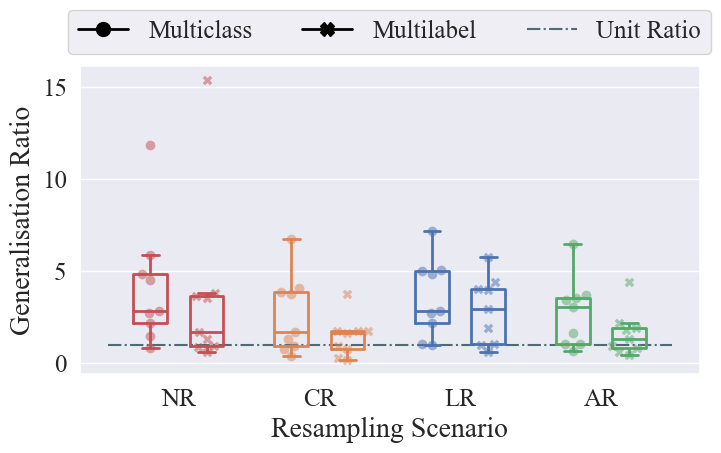

In [ ]:
fig, ax = plt.subplots(1,1, figsize=(8,4))

dodge=True

handles = []
swarm = sns.swarmplot(data=in_out_crosstable, x=TRAIN_COL, y=GR, ax=ax,
                   hue=MODEL_COL, palette=CPAL, dodge=dodge, alpha=0.5,
                   s=7,
                   legend=False, zorder=3
                   )

collections = swarm.collections
unique_colors = np.unique(collections[0].get_facecolors(), axis=0)

if dodge:
    N_hues = 2
    for c, collection in enumerate(collections[::N_hues]):
        collection.set_paths([mc_mk])
        collection.set_facecolor(CPAL[c])
    for c, collection in enumerate(collections[1::N_hues]):
        collection.set_paths([ml_mk])
        collection.set_facecolor(CPAL[c])
for m, mod in enumerate(model_names):
    handles.append(Line2D([0], [0], color=BLACK,
                          marker=model_markers[mod], markersize=10,
                        #   linestyle=model_style[mod], lw=2,
                          linestyle='-', lw=2,
                          label=mod))
box = sns.boxplot(data=in_out_crosstable, x=TRAIN_COL, y=GR, hue=MODEL_COL, dodge=dodge,
            width=0.8, gap=0.4,
            fill=None, palette=CPAL,
            linewidth=2, ax=ax,
            showfliers=False, zorder=2,
            )
children = [child for child in box.get_children() if isinstance(child, Line2D)]
c_per_box = 6
box_per_mod = 4

for c, child in enumerate(children):
    is_mc = c < 6 * 4
    res = (c // 6) % 4
    child.set_color(CPAL[res])
    # child.set_linestyle('-' if is_mc else '--')
    child.set_linestyle('-')

sns.lineplot(x=[-0.5, 3.5], y=[1, 1], color=DARK, alpha=0.7, linewidth=1.5, linestyle='-.', ax=ax, zorder=1)
handles.append(Line2D([0], [0], color=DARK, linestyle='-.', alpha=0.7, lw=1.5, label='Unit Ratio'))

# ticks = [mtext.Text(t, 0, tick.get_text().replace(' ', '\n')) for t, tick in enumerate(ax.get_xticklabels())]
ticks = [mtext.Text(t, 0, abbreviations[tick.get_text()]) for t, tick in enumerate(ax.get_xticklabels())]
ax.set_xticklabels(ticks)
ax.legend(handles=handles, loc='lower center', bbox_to_anchor=(0.5, 1.0), fontsize=TICK_SIZE, ncol=3)
ax.set_ylabel(GR, fontsize=LBL_SIZE)
ax.set_xlabel(TRAIN_COL, fontsize=LBL_SIZE)
ax.tick_params(axis='both', labelsize=TICK_SIZE)
# plt.tight_layout()


In [176]:
in_out_crosstable

Evaluation,Resampling Scenario,Model,In-distribution,DSBI,Metric,Metric Type,Generalisation Ratio
0,No Resampling,Multiclass,0.047354,0.279199,Class error,error,5.896049
1,No Resampling,Multilabel,0.015979,0.061082,Class error,error,3.822731
2,Class Resampled,Multiclass,0.013648,0.055581,Class error,error,4.072334
3,Class Resampled,Multilabel,0.013732,0.023714,Class error,error,1.726956
4,Label Resampled,Multiclass,0.018309,0.089114,Class error,error,4.867239
...,...,...,...,...,...,...,...
67,Class Resampled,Multilabel,0.003022,0.005253,1 - label F1,label,1.738542
68,Label Resampled,Multiclass,0.004277,0.021730,1 - label F1,label,5.080265
69,Label Resampled,Multilabel,0.003384,0.014862,1 - label F1,label,4.392292
70,Adaptive Resampled,Multiclass,0.002874,0.010582,1 - label F1,label,3.682390


In [175]:
met_group_color

{'error': 1, 'class': 4, 'label': 7}

In [180]:
reference_lines

[(0, (5, 1)), (0, (3, 1, 3, 1, 1, 1)), (0, (3, 1, 1, 1, 1, 1)), (0, (1, 1))]

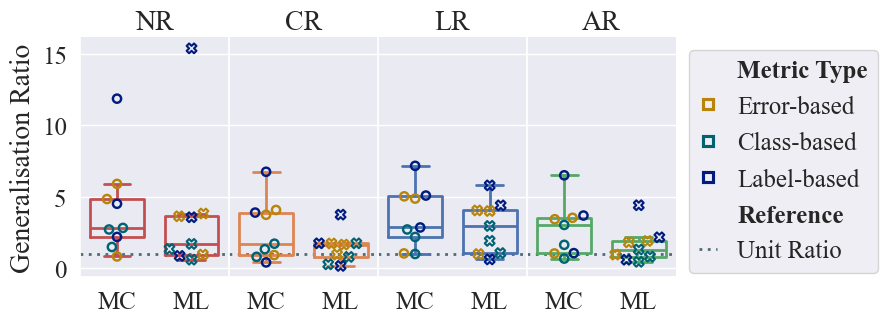

In [336]:
# fig, ax = plt.subplots(1,1, figsize=(8,4))
mg_palette = [TPAL[m] for k, m in met_group_color.items()]

cat = sns.catplot(
    data=in_out_crosstable, kind="swarm",
    x=MODEL_COL, y=GR, hue=MG_COL, col=TRAIN_COL,
    palette=mg_palette, hue_order=met_group_color,
    dodge=False, legend=False,
    height=3.5, aspect=.5,
    s=35, linewidth=1.75, zorder=3,
    facet_kws={
        'gridspec_kws': {
            'wspace': 0.
        }
    }
)
cat.set_titles("{col_name}")
axes = cat.axes

for a, ax in enumerate(axes[0]):
    res = ax.title.get_text()
    for c, collection in enumerate(ax.collections):
        model = model_names[c]
        col = collection.get_facecolor()
        collection.set_paths([markers[c]])
        collection.set_facecolor('none')
        collection.set_edgecolor(col)
        collection.set_sizes([marker_size[model]//2])
        if c == 1:
            collection.set_linewidth(1.5)
    df = in_out_crosstable[
        in_out_crosstable[TRAIN_COL] == res
    ]
    box = sns.boxplot(data=df, x=MODEL_COL, y=GR,
                width=0.85, gap=0.15,
                fill=None,
                linewidth=2, ax=ax,
                color=CPAL[a],
                showfliers=False, zorder=2,
                )
    xl = ax.get_xlim()
    ax.set_xlim(xl)
    sns.lineplot(x=list(xl), y=[1, 1], color=DARK, alpha=0.7, linewidth=2, linestyle=reference_lines[-1], ax=ax, zorder=1)
    ax.set_ylabel(GR, fontsize=LBL_SIZE)
    ax.set_xlabel('', fontsize=LBL_SIZE)
    ax.set_title(abbreviations[res], fontsize=LBL_SIZE)
    ax.tick_params(axis='both', labelsize=TICK_SIZE)
    if a == 3:
        ticks = [mtext.Text(t, 0, abbreviations[tick.get_text()]) for t, tick in enumerate(ax.get_xticklabels())]
        ax.set_xticklabels(ticks)
        
        handles = [
            Line2D([0], [0], color='none', label=MG_COL)
        ]
        for i, mg in enumerate(met_group_color.keys()):
            handles.append(Line2D([0], [0], color='none', alpha=1,
                                    marker='s', markersize=7,
                                    lw=0, markeredgecolor=TPAL[met_group_color[mg]], markeredgewidth=2.25,
                                    label="{}-based".format(
                                        mg.capitalize()
                                    )))
        handles.append(Line2D([0], [0], color='none', label='Reference'))
        handles.append(Line2D([0], [0], color=DARK, linestyle=reference_lines[-1], alpha=0.7, lw=2, label='Unit Ratio'))

        leg = ax.legend(handles=handles, labels=[h.get_label() for h in handles],
                        loc='upper left', bbox_to_anchor=(1., 1.),
                        handlelength=.75,
                        fontsize=TICK_SIZE, ncols=1,
                        #   frameon=False
                        )

        # Make only the desired labels bold
        bold_labels = [MODEL_COL, MG_COL, 'Reference']
        for text in leg.get_texts():
            t = text.get_text()
            if t in bold_labels:
                text.set_fontweight('bold')
                text.set_fontsize(TICK_SIZE)
            if t in abbreviations:
                text.set_text(abbreviations[t])

            
plt.savefig(os.path.join(PLOT_EVALS, 'model_generalisation_ratio.pdf'), bbox_inches='tight')


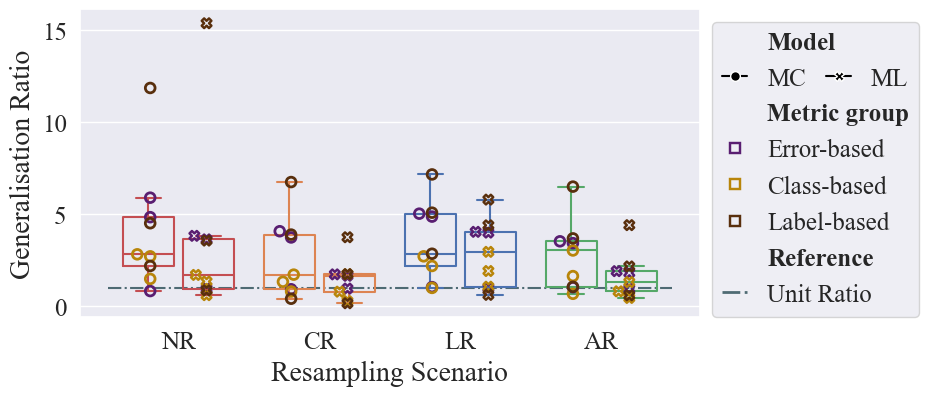

In [ ]:
fig, ax = plt.subplots(1,1, figsize=(8,4))

dodge=True

for i in range(3):    
    swarm = sns.swarmplot(data=in_out_crosstable[
        in_met_group(in_out_crosstable, group_id=i+1)
    ], x=TRAIN_COL, y=GR, ax=ax,
                    hue=MODEL_COL, palette=CPAL, dodge=dodge, alpha=1,
                    s=7, edgecolor=BLACK, linewidth=2,
                    legend=False, zorder=3,
                    )

collections = swarm.collections
if dodge:
    N_hues = 2
    for c, collection in enumerate(collections[::N_hues]):
        collection.set_paths([mc_mk])
        collection.set_facecolor('none')
        collection.set_edgecolor(TPAL[c // 4])
    for c, collection in enumerate(collections[1::N_hues]):
        collection.set_paths([ml_mk])
        collection.set_facecolor('none')
        collection.set_linewidth(1.75)
        collection.set_edgecolor(TPAL[c // 4])


box = sns.boxplot(data=in_out_crosstable, x=TRAIN_COL, y=GR, hue=MODEL_COL, dodge=dodge,
            width=0.85, gap=0.15,
            fill=None, palette=CPAL,
            linewidth=1.5, ax=ax,
            showfliers=False, zorder=2,
            )
children = [child for child in box.get_children() if isinstance(child, Line2D)]
c_per_box = 6
box_per_mod = 4

for c, child in enumerate(children):
    is_mc = c < c_per_box * box_per_mod
    res = (c // c_per_box) % box_per_mod
    child.set_color(CPAL[res])
    # child.set_linestyle('-' if is_mc else '--')
    child.set_linestyle('-')

sns.lineplot(x=[-0.5, 3.5], y=[1, 1], color=DARK, alpha=0.7, linewidth=1.5, linestyle='-.', ax=ax, zorder=1)

# Build up legend:
lg1 = ax.legend(handles=[Line2D([0], [0], color='none', label=MODEL_COL)],
          loc='upper left', bbox_to_anchor=(1., 1.),
          handlelength=1.,
          fontsize=TICK_SIZE, ncols=1,
        #   frameon=False
        )
lg2 = mlegend.Legend(ax,
                     handles=[Line2D([0], [0], color=BLACK,
                          marker=model_markers[mod], markersize=7,
                          markeredgecolor=WHITE,
                          linestyle='-', lw=1.5,
                          label=f"{abbreviations[mod]}") for m, mod in enumerate(model_names)],
                     labels=[f"{abbreviations[mod]}" for mod in model_names],
                     fontsize=TICK_SIZE, handlelength=1., columnspacing=0.8,
                     loc='upper left', bbox_to_anchor=(1., 0.9), ncol=2, frameon=False)

handles = [
    Line2D([0], [0], color='none', label=MG_COL)
    # MG_COL
]
for i in range(3):
    handles.append(Line2D([0], [0], color='none', alpha=1,
                              marker='s', markersize=7,
                              lw=0, markeredgecolor=TPAL[i], markeredgewidth=1.75,
                              label="{}-based".format(
                                  met_groups[i+1].capitalize()
                              )))
handles.append(Line2D([0], [0], color='none', label='Reference'))
handles.append(Line2D([0], [0], color=DARK, linestyle='-.', alpha=0.7, lw=2, label='Unit Ratio'))

lg3 = mlegend.Legend(ax,
                     handles=handles, labels=[h.get_label() for h in handles],
                     loc='upper left', bbox_to_anchor=(1., 0.5),
                     handlelength=1.,
                     fontsize=TICK_SIZE, ncol=1, frameon=False)

# Manually combine the legends
for child in lg2._legend_box._children:
    lg1._legend_box._children.append(child)
for child in lg3._legend_box._children:
    lg1._legend_box._children.append(child)
lg1._legend_box.align = "left"

# Make only the desired labels bold
bold_labels = [MODEL_COL, MG_COL, 'Reference']
for text in (
    lg1.get_texts() + lg2.get_texts() + lg3.get_texts()
):
    t = text.get_text()
    if t in bold_labels:
        text.set_fontweight('bold')
        text.set_fontsize(TICK_SIZE)
    if t in abbreviations:
        text.set_text(abbreviations[t])

# ticks = [mtext.Text(t, 0, tick.get_text().replace(' ', '\n')) for t, tick in enumerate(ax.get_xticklabels())]
ticks = [mtext.Text(t, 0, abbreviations[tick.get_text()]) for t, tick in enumerate(ax.get_xticklabels())]
ax.set_xticklabels(ticks)
ax.set_ylabel(GR, fontsize=LBL_SIZE)
ax.set_xlabel(TRAIN_COL, fontsize=LBL_SIZE)
ax.tick_params(axis='both', labelsize=TICK_SIZE)
# plt.tight_layout()


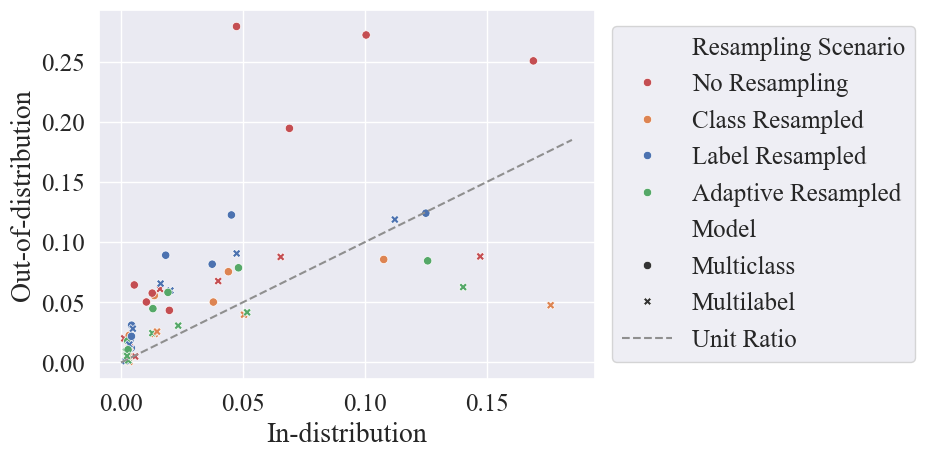

In [ ]:
sns.scatterplot(data=in_out_crosstable[in_out_crosstable[MET_COL] != 'Error distance'], x=ID, y=DSBI, hue=TRAIN_COL, style=MODEL_COL, palette=CPAL, markers=model_markers)
# plt.axis('square')
plot_edge = min(plt.xlim()[1], plt.ylim()[1])
sns.lineplot(x=[0, plot_edge], y=[0, plot_edge], color=GREY, linestyle='--', label='Unit Ratio')
plt.legend(loc='center left', bbox_to_anchor=(1.01, 0.5), fontsize=TICK_SIZE)

plt.ylabel(OOD, fontsize=LBL_SIZE)
plt.xlabel(ID, fontsize=LBL_SIZE)
plt.tick_params(axis='both', labelsize=TICK_SIZE)

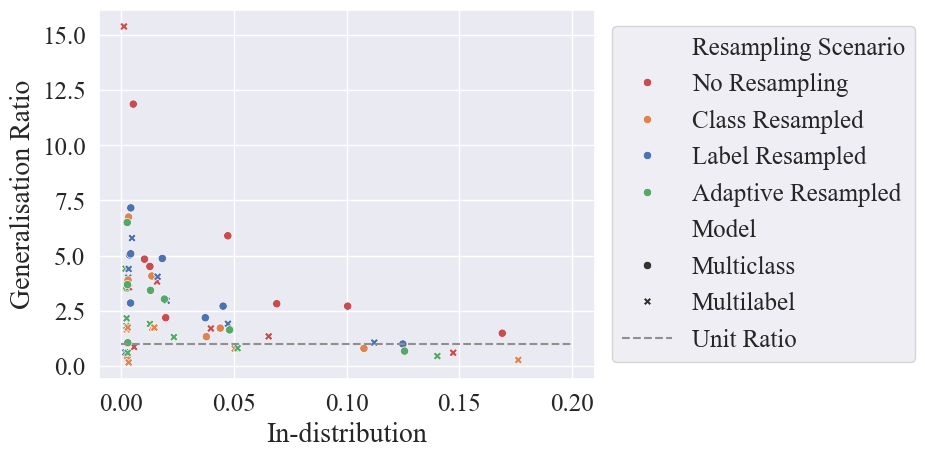

In [ ]:
sns.scatterplot(data=in_out_crosstable[in_out_crosstable[MET_COL] != 'Error distance'], x=ID, y=GR, hue=TRAIN_COL, style=MODEL_COL, palette=CPAL, markers=model_markers)
# plt.axis('square')
plot_edge = min(plt.xlim()[1], plt.ylim()[1])
sns.lineplot(x=[0, 0.2], y=[1, 1], color=GREY, linestyle='--', label='Unit Ratio')
plt.legend(loc='center left', bbox_to_anchor=(1.01, 0.5), fontsize=TICK_SIZE)

plt.ylabel(GR, fontsize=LBL_SIZE)
plt.xlabel(ID, fontsize=LBL_SIZE)
plt.tick_params(axis='both', labelsize=TICK_SIZE)

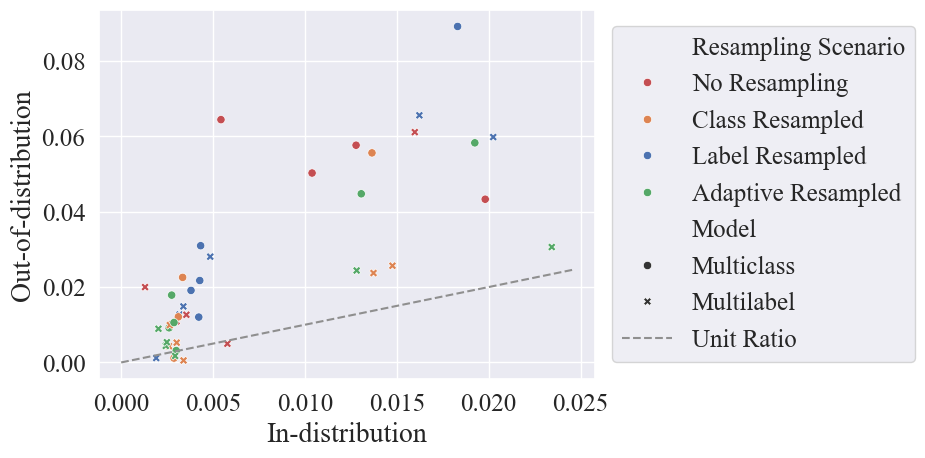

In [ ]:
sns.scatterplot(data=in_out_crosstable[
    (in_out_crosstable[DSBI] <0.1) & (in_out_crosstable[ID] < 0.03)
    ], x=ID, y=DSBI, hue=TRAIN_COL, style=MODEL_COL, palette=CPAL, markers=model_markers)
# plt.axis('square')
plot_edge = min(plt.xlim()[1], plt.ylim()[1])
sns.lineplot(x=[0, plot_edge], y=[0, plot_edge], color=GREY, linestyle='--', label='Unit Ratio')

plt.legend(loc='center left', bbox_to_anchor=(1.01, 0.5), fontsize=TICK_SIZE)
plt.ylabel(OOD, fontsize=LBL_SIZE)
plt.xlabel(ID, fontsize=LBL_SIZE)
plt.tick_params(axis='both', labelsize=TICK_SIZE)

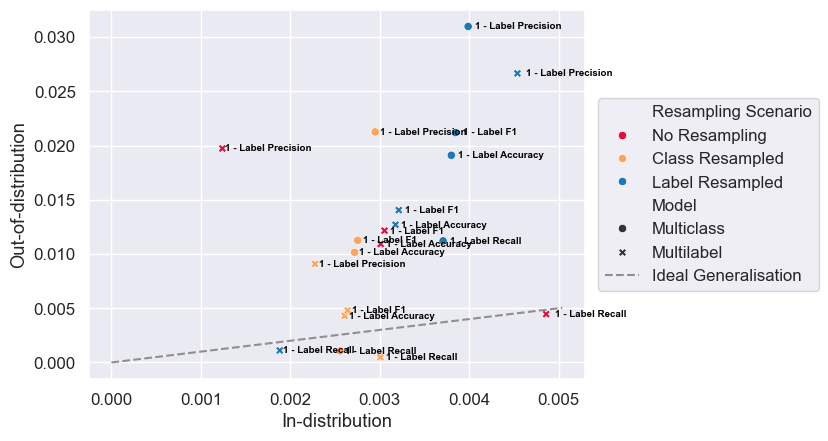

In [ ]:
focus_set = in_out_crosstable[
    (in_out_crosstable[MET_COL] != 'Mean Error') &
    (in_out_crosstable[OOD] < 0.05) & (in_out_crosstable[ID] < 0.01)
    ]

sns.scatterplot(data=focus_set, x=ID, y=OOD, hue=TRAIN_COL, style=MODEL_COL, palette=CPAL, markers=['o', 'X'])
# plt.axis('square')
plot_edge = min(plt.xlim()[1], plt.ylim()[1])
p1 = sns.lineplot(x=[0, plot_edge], y=[0, plot_edge], color=GREY, linestyle='--', label='Ideal Generalisation')
plt.legend(loc='center left', bbox_to_anchor=(1.01, 0.5))

for i, line in focus_set.iterrows():
     p1.text(line[ID]*1.02, line[OOD], 
     line[MET_COL], horizontalalignment='left', verticalalignment='center',
     size=7, color='black', weight='semibold')

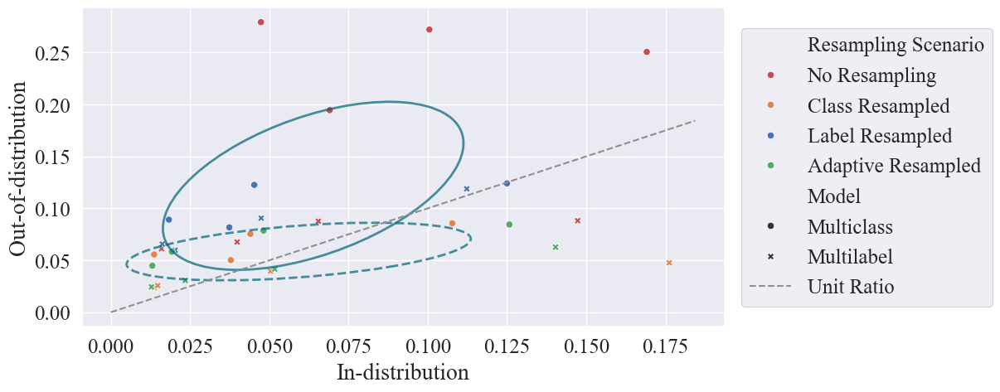

In [ ]:
fig, ax = plt.subplots(1,1,figsize=(10,5))

# in_out_focus = in_out_crosstable[in_out_crosstable[MET_COL] != 'Error distance']
in_out_focus = in_out_crosstable[in_out_crosstable[MET_COL].str.lower().str.contains('class')]

sns.scatterplot(data=in_out_focus, x=ID, y=DSBI, hue=TRAIN_COL, style=MODEL_COL, palette=CPAL, ax=ax, markers=model_markers)
# plt.axis('square')
plot_edge = min(plt.xlim()[1], plt.ylim()[1])
sns.lineplot(x=[0, plot_edge], y=[0, plot_edge], color=GREY, linestyle='--', label='Unit Ratio', ax=ax)
plt.legend(loc='center left', bbox_to_anchor=(1.01, 0.5), fontsize=TICK_SIZE)

for g, group in in_out_focus.groupby([MODEL_COL]):
    x, y = group[ID], group[DSBI]
    confidence_ellipse(x, y, ax, n_std=1.0, edgecolor=TPAL[4], linestyle=model_style[g[0]], linewidth=2, alpha=0.7)

# for g, group in in_out_focus.groupby([TRAIN_COL, MODEL_COL]):
#     x, y = group[ID], group[DSBI]
#     confidence_ellipse(x, y, ax, n_std=1.0, edgecolor=TPAL[training_color[g[0]]], linestyle=model_style[g[1]], alpha=0.7)


ax.set_ylabel(OOD, fontsize=LBL_SIZE)
ax.set_xlabel(ID, fontsize=LBL_SIZE)
ax.tick_params(axis='both', labelsize=TICK_SIZE)

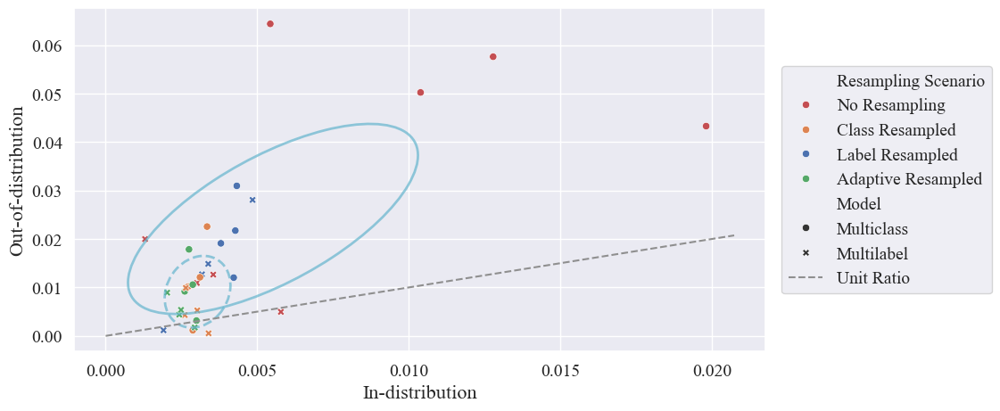

In [ ]:
fig, ax = plt.subplots(1,1,figsize=(10,5))

in_out_focus = in_out_crosstable[
    # (in_out_crosstable[MET_COL] != 'Error distance') &
    # (in_out_crosstable[DSBI] < 0.1) &
    # (in_out_crosstable[ID] < 0.03)
    in_out_crosstable[MET_COL].str.lower().str.contains('label')
    ]

sns.scatterplot(data=in_out_focus, x=ID, y=DSBI, hue=TRAIN_COL, style=MODEL_COL, palette=CPAL, ax=ax, markers=model_markers)
# plt.axis('square')
plot_edge = min(plt.xlim()[1], plt.ylim()[1])
sns.lineplot(x=[0, plot_edge], y=[0, plot_edge], color=GREY, linestyle='--', ax=ax, label='Unit Ratio')
plt.legend(loc='center left', bbox_to_anchor=(1.01, 0.5), fontsize=TICK_SIZE)

for g, group in in_out_focus.groupby([MODEL_COL]):
    x, y = group[ID], group[DSBI]
    confidence_ellipse(x, y, ax, n_std=1.0, edgecolor=CPAL[9], linestyle=model_style[g[0]], linewidth=2, alpha=0.7)

# for g, group in in_out_focus.groupby([TRAIN_COL, MODEL_COL]):
#     x, y = group[ID], group[DSBI]
#     confidence_ellipse(x, y, ax, n_std=1.0, edgecolor=CPAL[training_color[g[0]]], linestyle=model_style[g[1]], alpha=0.7)


ax.set_ylabel(OOD, fontsize=LBL_SIZE)
ax.set_xlabel(ID, fontsize=LBL_SIZE)
ax.tick_params(axis='both', labelsize=TICK_SIZE)

#### Metric Pairs

In [337]:
all_results_filt.head()

,Evaluation,Resampling Scenario,Model,Class error,Label error,Error distance,1 - class recall,1 - class precision,1 - class F1,1 - label recall,1 - label precision,1 - label F1
0,In-distribution,No Resampling,Multiclass,0.047354,0.010389,1.316344,0.169101,0.069055,0.100512,0.019811,0.005430,0.012783
20,In-distribution,No Resampling,Multilabel,0.015979,0.003010,1.130208,0.039840,0.147310,0.065471,0.005780,0.001300,0.003549
5,In-distribution,Class Resampled,Multiclass,0.013648,0.002719,1.195122,0.037852,0.107726,0.044021,0.002874,0.003345,0.003111
25,In-distribution,Class Resampled,Multilabel,0.013732,0.002608,1.139394,0.014763,0.176183,0.050421,0.003394,0.002645,0.003022
10,In-distribution,Label Resampled,Multiclass,0.018309,0.003800,1.245455,0.037381,0.124994,0.045262,0.004223,0.004325,0.004277


In [338]:
def precision(recall, f1=1):
    return (f1 * recall) / (2 * recall - f1)

def inv_prec_from_rec(rec_inv, f1=1, low=0, hi=1):
    prec = precision(1 - rec_inv, f1=f1)
    prec = np.where(prec > hi, np.nan, prec)
    prec = np.where(prec < low, np.nan, prec)
    return 1 - prec

In [339]:
def f1_ceiling(rm, pm, fm, f1=0.99, df=all_results_filt):
    min_f1 = 1 - df[inv_prec_from_rec(df[rm], f1=f1) > df[pm]][fm].max()
    rounded = np.floor(min_f1 * 100) / 100
    return rounded
    

In [340]:
def error_distance(class_error, lerr=1.0):
    return 6 * lerr / class_error

def err_dist_from_cerr(cerr, lerr=1, low=1, hi=2):
    err_dist = error_distance(cerr, lerr=lerr)
    err_dist = np.where(err_dist > hi, np.nan, err_dist)
    err_dist = np.where(err_dist < low, np.nan, err_dist)
    return err_dist

In [341]:
def lbl_error_ceiling(err_m, dist_m, lbl_m, lerr=0.99, df=all_results_filt):
    max_err = df[err_dist_from_cerr(df[err_m], lerr=lerr, low=0, hi=6) > df[dist_m]][lbl_m].max()
    rounded = np.ceil(max_err * 100) / 100
    return rounded
    

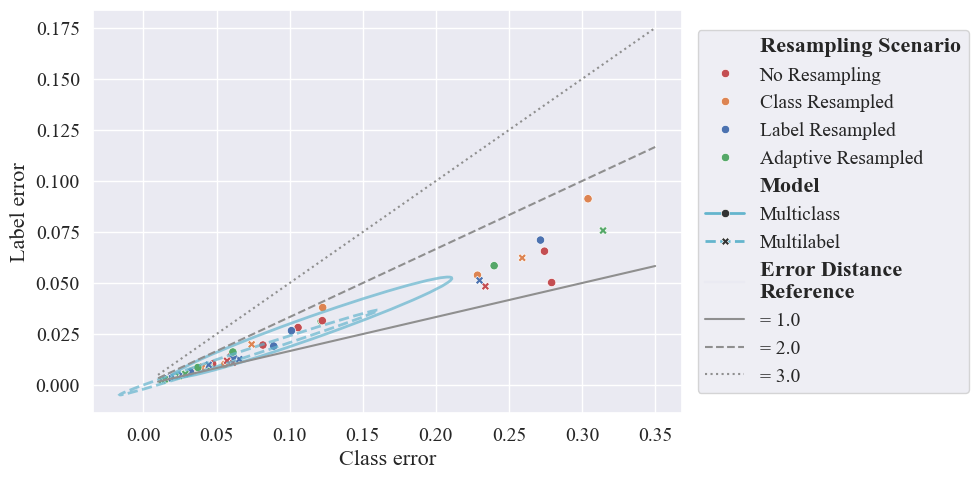

In [ ]:
fig, ax = plt.subplots(1,1, figsize=(10,5))

sns.scatterplot(data=all_results_filt, x=cErr, y=lErr, hue=TRAIN_COL, style=MODEL_COL, palette=CPAL, ax=ax, markers=model_markers)
x_range = np.linspace(0.01, 0.35, 10)
sns.lineplot(x=x_range, y=x_range / 6, label='= 1.0', color=GREY, linestyle='-')
sns.lineplot(x=x_range, y=x_range / 3, label='= 2.0', color=GREY, linestyle='--')
sns.lineplot(x=x_range, y=x_range / 2, label='= 3.0', color=GREY, linestyle=':')

handles, labels = ax.get_legend_handles_labels()
handles.insert(8, Line2D([0], [0], color=ax_face, label='Error Distance\nReference'))

legend = plt.legend(handles=handles, loc='center left', bbox_to_anchor=(1.01, 0.5), fontsize=TICK_SIZE)

bold_labels = [MODEL_COL, TRAIN_COL, 'Error Distance\nReference']
for text in legend.get_texts():
    if text.get_text() in bold_labels:
        text.set_fontweight('bold')
        text.set_fontsize(LBL_SIZE)
        
for handle in legend.legend_handles:
    lbl = handle.get_label()
    if lbl in model_names:
        handle.set_linewidth(2)
        # handle.set_markersize(7)
        handle.set_linestyle(model_style[lbl])
        handle.set_color(CPAL[9])
# for g, group in all_results_filt.groupby([TRAIN_COL, MODEL_COL]):
#     x, y = group[cRec], group[cPrec]
#     confidence_ellipse(x, y, ax, n_std=1.0, edgecolor=CPAL[training_color[g[0]]], linestyle=model_style[g[1]], alpha=0.7)

for g, group in all_results_filt.groupby([MODEL_COL]):
    x, y = group[cErr], group[lErr]
    confidence_ellipse(x, y, ax, n_std=1.0, edgecolor=CPAL[9], linestyle=model_style[g[0]], linewidth=2, alpha=0.7)


plt.ylabel(lErr, fontsize=LBL_SIZE)
plt.xlabel(cErr, fontsize=LBL_SIZE)
plt.tick_params(axis='both', labelsize=TICK_SIZE)

plt.tight_layout()

In [ ]:
TPAL

[(0.34901960784313724, 0.11764705882352941, 0.44313725490196076),
 (0.7215686274509804, 0.5215686274509804, 0.0392156862745098),
 (0.34901960784313724, 0.1843137254901961, 0.050980392156862744),
 (0.6352941176470588, 0.20784313725490197, 0.5098039215686274),
 (0.0, 0.38823529411764707, 0.4549019607843137),
 (0.23529411764705882, 0.23529411764705882, 0.23529411764705882)]

<Axes: xlabel='Density', ylabel='Error distance'>

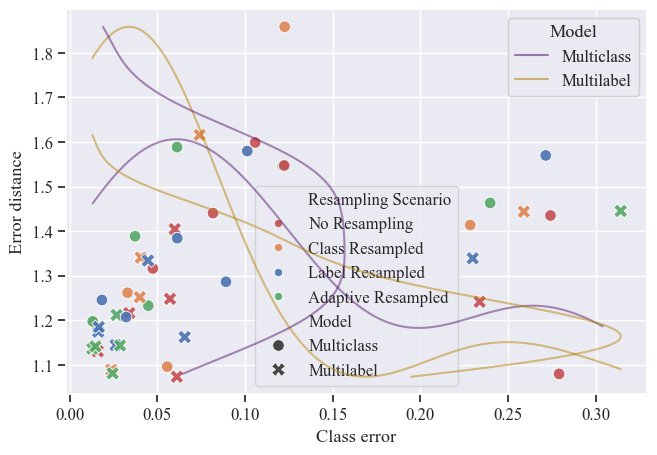

In [ ]:
fig, ax = plt.subplots(1,1, figsize=(7.5,5))

sns.scatterplot(data=all_results_filt, x=cErr, y=errDist,
                hue=TRAIN_COL, style=MODEL_COL, palette=CPAL, 
                ax=ax,
                markers=model_markers,
                size=MODEL_COL, sizes=marker_size,
                alpha=0.9,
                )

ax2 = ax.twinx()
ax2.grid(False)
ax2.set_yticks([], [])
sns.kdeplot(data=all_results_filt, x=cErr,# y=errDist,
                hue=MODEL_COL, palette=TPAL[0:],
                ax=ax2,
                # markers=model_markers,
                # style=MODEL_COL, 
                # size=MODEL_COL, sizes=marker_size,
                alpha=0.5,
                cut=0
                )

ax3 = ax.twiny()
ax3.grid(False)
ax3.set_xticks([], [])
sns.kdeplot(data=all_results_filt, y=errDist,
                hue=MODEL_COL, palette=TPAL[0:],
                ax=ax3,
                # markers=model_markers,
                # style=MODEL_COL, 
                # size=MODEL_COL, sizes=marker_size,
                alpha=0.5,
                cut=0
                )

In [342]:
resampling_means = all_results_filt.groupby([TRAIN_COL, MODEL_COL])[article_metric_names].mean().reset_index()
resampling_sterrs = all_results_filt.groupby([TRAIN_COL, MODEL_COL])[article_metric_names].agg(np.std).reset_index()
resampling_sterrs

C:\Users\User\AppData\Local\Temp\ipykernel_27620\1068433486.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  resampling_means = all_results_filt.groupby([TRAIN_COL, MODEL_COL])[article_metric_names].mean().reset_index()
C:\Users\User\AppData\Local\Temp\ipykernel_27620\1068433486.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  resampling_sterrs = all_results_filt.groupby([TRAIN_COL, MODEL_COL])[article_metric_names].agg(np.std).reset_index()
C:\Users\User\AppData\Local\Temp\ipykernel_27620\1068433486.py:2: FutureWarning: The provided callable <function std at 0x0000029F7EBAADE0> is currently using DataF

,Resampling Scenario,Model,Class error,Label error,Error distance,1 - class recall,1 - class precision,1 - class F1,1 - label recall,1 - label precision,1 - label F1
0,No Resampling,Multiclass,0.100044,0.020329,0.186386,0.086753,0.092032,0.096420,0.034616,0.023422,0.024940
1,No Resampling,Multilabel,0.078900,0.016416,0.113930,0.085713,0.112030,0.098598,0.031522,0.011033,0.019747
2,Class Resampled,Multiclass,0.117017,0.034562,0.321531,0.144152,0.140499,0.143915,0.053863,0.029066,0.040099
3,Class Resampled,Multilabel,0.092395,0.022660,0.196889,0.099646,0.140431,0.131100,0.044187,0.011267,0.027764
4,Label Resampled,Multiclass,0.091896,0.024724,0.162896,0.097427,0.136875,0.129088,0.038597,0.020504,0.029544
5,Label Resampled,Multilabel,0.082255,0.018565,0.088926,0.091016,0.143498,0.128747,0.027322,0.018307,0.022417
6,Adaptive Resampled,Multiclass,0.083609,0.020816,0.161275,0.094069,0.132164,0.119134,0.033615,0.016901,0.024963
7,Adaptive Resampled,Multilabel,0.119758,0.029270,0.130296,0.117378,0.152281,0.157125,0.052186,0.013085,0.034196


In [205]:
TPAL

[(0.34901960784313724, 0.11764705882352941, 0.44313725490196076),
 (0.7215686274509804, 0.5215686274509804, 0.0392156862745098),
 (0.34901960784313724, 0.1843137254901961, 0.050980392156862744),
 (0.6352941176470588, 0.20784313725490197, 0.5098039215686274),
 (0.0, 0.38823529411764707, 0.4549019607843137),
 (0.5490196078431373, 0.03137254901960784, 0.0),
 (0.6941176470588235, 0.25098039215686274, 0.050980392156862744),
 (0.0, 0.10980392156862745, 0.4980392156862745),
 (0.07058823529411765, 0.44313725490196076, 0.10980392156862745),
 (0.23529411764705882, 0.23529411764705882, 0.23529411764705882)]

C:\Users\User\AppData\Local\Temp\ipykernel_25004\2890015468.py:33: UserWarning: The palette list has more values (6) than needed (4), which may not be intended.
  sns.scatterplot(data=all_results_filt, x=cErr, y=errDist,
C:\Users\User\AppData\Local\Temp\ipykernel_25004\2890015468.py:58: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  for g, group in all_results_filt.groupby([MODEL_COL]):


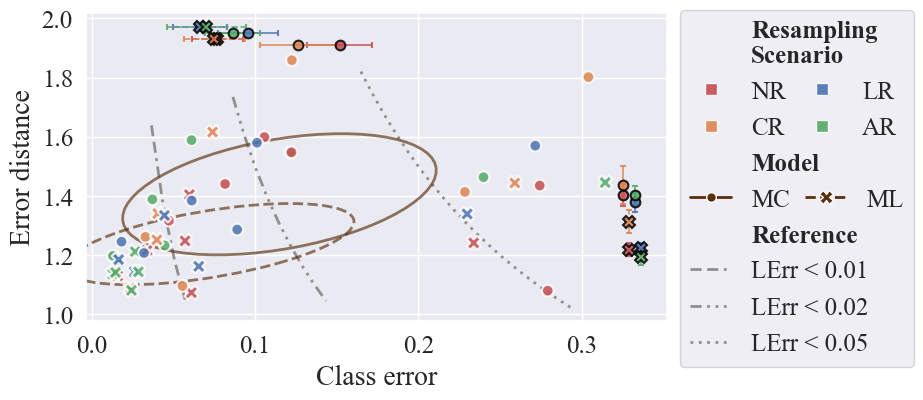

In [221]:
fig, ax = plt.subplots(1,1, figsize=(7.5,4))

for rs, resam in enumerate(resamplings):
    for m, mod in enumerate(model_names):
        means = resampling_means[
            (resampling_means[TRAIN_COL] == resam) &
            (resampling_means[MODEL_COL] == mod)
        ]
        sterrs = resampling_sterrs[
            (resampling_sterrs[TRAIN_COL] == resam) &
            (resampling_sterrs[MODEL_COL] == mod)
        ]
        xpos = 0.325 + 0.0075 * (rs // 2) + 0.00375 * m
        ypos = 1.91 + 0.04 * (rs // 2) + 0.02 * m
        for x, xe, y, ye in zip(
            [means[cErr], [xpos]], [sterrs[cErr] / 5, None],
            [[ypos], means[errDist]], [None, sterrs[errDist] / 5]
        ):
            ebc = ax.errorbar(x=x, y=y,
                        color=CPAL[rs],
                        marker=model_markers[mod],
                        markersize=marker_size[mod] // 12 + 2 * (1 - m),
                        xerr=xe, yerr=ye,
                        markeredgecolor=BLACK,
                        markeredgewidth=1.5,               
                        ecolor=CPAL[rs], elinewidth=1.25,
                        capsize=2, capthick=1, zorder=3,
                        alpha=0.85
                        )
            for cap in ebc[-1]:
                cap.set_linestyle(model_style[mod])

sns.scatterplot(data=all_results_filt, x=cErr, y=errDist,
                hue=TRAIN_COL, style=MODEL_COL, palette=CPAL, 
                ax=ax, markers=model_markers,
                size=MODEL_COL, sizes=marker_size, zorder=3,
                linewidth=1.5,
                alpha=0.85,
                )

x_range = np.linspace(0.001, 0.35, 50)
lerr_95 = lbl_error_ceiling(cErr, errDist, lErr, 0.01)
lerr_90 = lbl_error_ceiling(cErr, errDist, lErr, 0.025)
lerr_80 = lbl_error_ceiling(cErr, errDist, lErr, 0.05)
sns.lineplot(x=x_range, y=err_dist_from_cerr(x_range, lerr=0.01, hi=1.85), label=f'{abbreviations[lErr]} < {lerr_95}',
    color=GREY, linestyle=reference_lines[0],
    linewidth=2., zorder=1
)
sns.lineplot(x=x_range, y=err_dist_from_cerr(x_range, lerr=0.025, hi=1.85), label=f'{abbreviations[lErr]} < {lerr_90}',
    color=GREY, linestyle=reference_lines[1],
    linewidth=2., zorder=1
)
sns.lineplot(x=x_range, y=err_dist_from_cerr(x_range, lerr=0.05, hi=1.85), label=f'{abbreviations[lErr]} < {lerr_80}',
    color=GREY, linestyle=reference_lines[2],
    linewidth=2., zorder=1
)

for g, group in all_results_filt.groupby([MODEL_COL]):
    x, y = group[cErr], group[errDist]
    confidence_ellipse(x, y, ax, n_std=1.0, edgecolor=TPAL[2], linestyle=model_style[g[0]], linewidth=2, alpha=0.65, zorder=2)



# Build up legend:
hl = 1.65
cg = 0.6
lg1 = ax.legend(handles=[Line2D([0], [0], color='none', label=TRAIN_COL.replace(' ', '\n'))],
          loc='upper left', bbox_to_anchor=(1., 1.05),
          handlelength=hl,
          fontsize=TICK_SIZE, ncols=1,
        )
lg2 = mlegend.Legend(ax,
                     handles=[Line2D([0], [0], color='none',
                          marker='s', markersize=8,
                          markeredgecolor=WHITE,
                          markerfacecolor=CPAL[r],
                          alpha=0.9,
                        #   linestyle='-', lw=1.5,
                          label=f"{abbreviations[res]}") for r, res in enumerate(resamplings)],
                     labels=[f"{abbreviations[res]}" for res in resamplings],
                     fontsize=TICK_SIZE, handlelength=hl, columnspacing=cg,
                     loc='upper left', bbox_to_anchor=(1., 0.9), ncol=2, frameon=False)
lg3 = mlegend.Legend(ax,
                     handles=[Line2D([0], [0], color='none', label=MODEL_COL)],
                     labels=[MODEL_COL],
                     loc='upper left', bbox_to_anchor=(1., 0.5),
                     handlelength=hl,
                     fontsize=TICK_SIZE, ncol=1, frameon=False)

lg4 = mlegend.Legend(ax,
                     handles=[
                        Line2D([0], [0], color=TPAL[2],
                        marker=model_markers[mod], markersize=marker_size[mod] // 10,
                        markeredgecolor=WHITE,
                        linestyle=model_style[mod], lw=2.,
                        alpha=1.,
                        label=f"{abbreviations[mod]}") for m, mod in enumerate(model_names)
                    ],
                     labels=[f"{abbreviations[mod]}" for m, mod in enumerate(model_names)],
                     fontsize=TICK_SIZE, handlelength=hl, columnspacing=cg,
                     loc='upper left', bbox_to_anchor=(1., 0.9), ncol=2, frameon=False)

handles = [
    Line2D([0], [0], color='none', label='Reference'),
    Line2D([0], [0], color=GREY, linestyle=reference_lines[0], alpha=1., lw=2, label=f'{abbreviations[lErr]} < {lerr_95}'),
    Line2D([0], [0], color=GREY, linestyle=reference_lines[1], alpha=1., lw=2, label=f'{abbreviations[lErr]} < {lerr_90}'),
    Line2D([0], [0], color=GREY, linestyle=reference_lines[2], alpha=1., lw=2, label=f'{abbreviations[lErr]} < {lerr_80}')
]

lg5 = mlegend.Legend(ax,
                     handles=handles, labels=[h.get_label() for h in handles],
                     loc='upper left', bbox_to_anchor=(1., 0.5),
                     handlelength=hl,
                     fontsize=TICK_SIZE, ncol=1, frameon=False)
legends = [lg1, lg2, lg3, lg4, lg5]
# Manually combine the legends
for leg in legends[1:]:
    for child in leg._legend_box._children:
        lg1._legend_box._children.append(child)
lg1._legend_box.align = "left"


bold_labels = [MODEL_COL, TRAIN_COL,
               TRAIN_COL.replace(' ', '\n'), 'Reference']
for lts in [leg.get_texts() for leg in legends]:
    for text in lts:
        t = text.get_text()
        if t in bold_labels:
            text.set_fontweight('bold')
            text.set_fontsize(TICK_SIZE)

ax.set_ylabel(errDist, fontsize=LBL_SIZE)
ax.set_xlabel(cErr, fontsize=LBL_SIZE)
ax.tick_params(axis='both', labelsize=TICK_SIZE)

C:\Users\User\AppData\Local\Temp\ipykernel_25004\2805747556.py:33: UserWarning: The palette list has more values (6) than needed (4), which may not be intended.
  sns.scatterplot(data=all_results_filt, x=cRec, y=cPrec,
C:\Users\User\AppData\Local\Temp\ipykernel_25004\2805747556.py:54: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  for g, group in all_results_filt.groupby([MODEL_COL]):


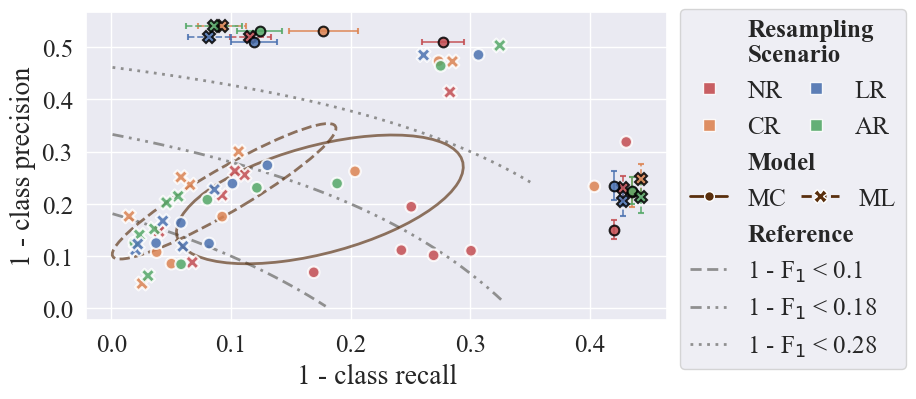

In [219]:
fig, ax = plt.subplots(1,1, figsize=(7.5,4))

for rs, resam in enumerate(resamplings):
    for m, mod in enumerate(model_names):
        means = resampling_means[
            (resampling_means[TRAIN_COL] == resam) &
            (resampling_means[MODEL_COL] == mod)
        ]
        sterrs = resampling_sterrs[
            (resampling_sterrs[TRAIN_COL] == resam) &
            (resampling_sterrs[MODEL_COL] == mod)
        ]
        xpos = 0.42 + 0.015 * (rs % 2) + 0.0075 * m
        ypos = 0.51 + 0.02 * (rs % 2) + 0.01 * m
        for x, xe, y, ye in zip(
            [means[cRec], [xpos]], [sterrs[cRec] / 5, None],
            [[ypos], means[cPrec]], [None, sterrs[cPrec] / 5]
        ):
            ebc = ax.errorbar(x=x, y=y,
                        color=CPAL[rs],
                        marker=model_markers[mod],
                        markersize=marker_size[mod] // 12 + 2 * (1 - m),
                        xerr=xe, yerr=ye,
                        markeredgecolor=BLACK,
                        markeredgewidth=1.5,               
                        ecolor=CPAL[rs], elinewidth=1.25,
                        capsize=2, capthick=1, zorder=3,
                        alpha=0.85
                        )
            for cap in ebc[-1]:
                cap.set_linestyle(model_style[mod])

sns.scatterplot(data=all_results_filt, x=cRec, y=cPrec, 
                hue=TRAIN_COL, style=MODEL_COL, palette=CPAL,
                ax=ax, markers=model_markers,
                size=MODEL_COL, sizes=marker_size, zorder=3,
                linewidth=1.5,
                alpha=0.85,
                )
x_range = np.linspace(0.001, 0.35, 50)
f1_95 = round(1 - f1_ceiling(cRec, cPrec, cF1, 0.9),2)
f1_90 = round(1 - f1_ceiling(cRec, cPrec, cF1, 0.8),2)
f1_80 = round(1 - f1_ceiling(cRec, cPrec, cF1, 0.7),2)
sns.lineplot(x=x_range, y=inv_prec_from_rec(x_range, f1=0.9), label=f'1 - F$_1$ < {f1_95}',
    color=GREY, linestyle=reference_lines[0],
    linewidth=2., zorder=1)
sns.lineplot(x=x_range, y=inv_prec_from_rec(x_range, f1=0.8), label=f'1 - F$_1$ < {f1_90}',
    color=GREY, linestyle=reference_lines[1],
    linewidth=2., zorder=1)
sns.lineplot(x=x_range, y=inv_prec_from_rec(x_range, f1=0.7), label=f'1 - F$_1$ < {f1_80}',
    color=GREY, linestyle=reference_lines[2],
    linewidth=2., zorder=1)

for g, group in all_results_filt.groupby([MODEL_COL]):
    x, y = group[cRec], group[cPrec]
    confidence_ellipse(x, y, ax, n_std=1.0, edgecolor=TPAL[2], linestyle=model_style[g[0]], linewidth=2, alpha=0.65, zorder=2)

# Build up legend:
hl = 1.5
cg = 0.6
lg1 = ax.legend(handles=[Line2D([0], [0], color='none', label=TRAIN_COL.replace(' ', '\n'))],
          loc='upper left', bbox_to_anchor=(1., 1.05),
          handlelength=hl,
          fontsize=TICK_SIZE, ncols=1,
        )
lg2 = mlegend.Legend(ax,
                     handles=[Line2D([0], [0], color='none',
                          marker='s', markersize=8,
                          markeredgecolor=WHITE,
                          markerfacecolor=CPAL[r],
                          alpha=0.9,
                        #   linestyle='-', lw=1.5,
                          label=f"{abbreviations[res]}") for r, res in enumerate(resamplings)],
                     labels=[f"{abbreviations[res]}" for res in resamplings],
                     fontsize=TICK_SIZE, handlelength=hl, columnspacing=cg,
                     loc='upper left', bbox_to_anchor=(1., 0.9), ncol=2, frameon=False)
lg3 = mlegend.Legend(ax,
                     handles=[Line2D([0], [0], color='none', label=MODEL_COL)],
                     labels=[MODEL_COL],
                     loc='upper left', bbox_to_anchor=(1., 0.5),
                     handlelength=hl,
                     fontsize=TICK_SIZE, ncol=1, frameon=False)

lg4 = mlegend.Legend(ax,
                     handles=[
                        Line2D([0], [0], color=TPAL[2],
                        marker=model_markers[mod], markersize=marker_size[mod] // 10,
                        markeredgecolor=WHITE,
                        linestyle=model_style[mod], lw=2.,
                        alpha=1.,
                        label=f"{abbreviations[mod]}") for m, mod in enumerate(model_names)
                    ],
                     labels=[f"{abbreviations[mod]}" for m, mod in enumerate(model_names)],
                     fontsize=TICK_SIZE, handlelength=hl, columnspacing=cg,
                     loc='upper left', bbox_to_anchor=(1., 0.9), ncol=2, frameon=False)

handles = [
    Line2D([0], [0], color='none', label='Reference'),
    Line2D([0], [0], color=GREY, linestyle=reference_lines[0], alpha=1., lw=2, label=f'1 - F$_1$ < {f1_95}'),
    Line2D([0], [0], color=GREY, linestyle=reference_lines[1], alpha=1., lw=2, label=f'1 - F$_1$ < {f1_90}'),
    Line2D([0], [0], color=GREY, linestyle=reference_lines[2], alpha=1., lw=2, label=f'1 - F$_1$ < {f1_80}')
]

lg5 = mlegend.Legend(ax,
                     handles=handles, labels=[h.get_label() for h in handles],
                     loc='upper left', bbox_to_anchor=(1., 0.5),
                     handlelength=hl,
                     fontsize=TICK_SIZE, ncol=1, frameon=False)
legends = [lg1, lg2, lg3, lg4, lg5]
# Manually combine the legends
for leg in legends[1:]:
    for child in leg._legend_box._children:
        lg1._legend_box._children.append(child)
lg1._legend_box.align = "left"


bold_labels = [MODEL_COL, TRAIN_COL,
               TRAIN_COL.replace(' ', '\n'), 'Reference']
for lts in [leg.get_texts() for leg in legends]:
    for text in lts:
        t = text.get_text()
        if t in bold_labels:
            text.set_fontweight('bold')
            text.set_fontsize(TICK_SIZE)

ax.set_ylabel(cPrec, fontsize=LBL_SIZE)
ax.set_xlabel(cRec, fontsize=LBL_SIZE)
ax.tick_params(axis='both', labelsize=TICK_SIZE)


C:\Users\User\AppData\Local\Temp\ipykernel_25004\2742881208.py:33: UserWarning: The palette list has more values (6) than needed (4), which may not be intended.
  sns.scatterplot(data=all_results_filt, x=lRec, y=lPrec, hue=TRAIN_COL, style=MODEL_COL, palette=CPAL, ax=ax, markers=model_markers,
C:\Users\User\AppData\Local\Temp\ipykernel_25004\2742881208.py:53: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  for g, group in all_results_filt.groupby([MODEL_COL]):


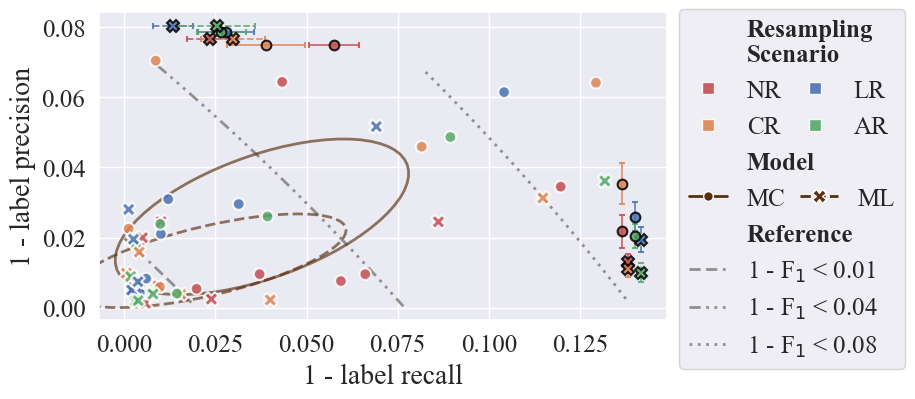

In [ ]:
fig, ax = plt.subplots(1,1, figsize=(7.33,4))

for rs, resam in enumerate(resamplings):
    for m, mod in enumerate(model_names):
        means = resampling_means[
            (resampling_means[TRAIN_COL] == resam) &
            (resampling_means[MODEL_COL] == mod)
        ]
        sterrs = resampling_sterrs[
            (resampling_sterrs[TRAIN_COL] == resam) &
            (resampling_sterrs[MODEL_COL] == mod)
        ]
        xpos = 0.1365 + 0.0035 * (rs // 2) + 0.00175 * m
        ypos = 0.075 + 0.0035 * (rs // 2) + 0.00175 * m
        for x, xe, y, ye in zip(
            [means[lRec], [xpos]], [sterrs[lRec] / 5, None],
            [[ypos], means[lPrec]], [None, sterrs[lPrec] / 5]
        ):
            ebc = ax.errorbar(x=x, y=y,
                        color=CPAL[rs],
                        marker=model_markers[mod],
                        markersize=marker_size[mod] // 12 + 2 * (1 - m),
                        xerr=xe, yerr=ye,
                        markeredgecolor=BLACK,
                        markeredgewidth=1.5,               
                        ecolor=CPAL[rs], elinewidth=1.25,
                        capsize=2, capthick=1, zorder=2,
                        alpha=0.85
                        )
            for cap in ebc[-1]:
                cap.set_linestyle(model_style[mod])

sns.scatterplot(data=all_results_filt, x=lRec, y=lPrec, hue=TRAIN_COL, style=MODEL_COL, palette=CPAL, ax=ax, markers=model_markers,
                size=MODEL_COL, sizes=marker_size, zorder=3,
                linewidth=1.5,
                alpha=0.85,
                )

x_range = np.linspace(0.00001, 0.15, 50)
f1_95 = round(1 - f1_ceiling(lRec, lPrec, lF1, 0.99), 2)
f1_90 = round(1 - f1_ceiling(lRec, lPrec, lF1, 0.96), 2)
f1_80 = round(1 - f1_ceiling(lRec, lPrec, lF1, 0.925), 2)
sns.lineplot(x=x_range, y=inv_prec_from_rec(x_range, f1=0.99, low=.93, hi=1), label=f'1 - F$_1$ < {f1_95}',
    color=GREY, linestyle=reference_lines[0],
    linewidth=2., zorder=1)
sns.lineplot(x=x_range, y=inv_prec_from_rec(x_range, f1=0.96, low=.93, hi=1), label=f'1 - F$_1$ < {f1_90}',
    color=GREY, linestyle=reference_lines[1],
    linewidth=2., zorder=1)
sns.lineplot(x=x_range, y=inv_prec_from_rec(x_range, f1=0.925, low=.93, hi=1), label=f'1 - F$_1$ < {f1_80}',
    color=GREY, linestyle=reference_lines[2],
    linewidth=2., zorder=1)

for g, group in all_results_filt.groupby([MODEL_COL]):
    x, y = group[lRec], group[lPrec]
    confidence_ellipse(x, y, ax, n_std=1.0, edgecolor=TPAL[2], linestyle=model_style[g[0]], linewidth=2, alpha=0.65, zorder=2)

# Build up legend:
hl = 1.5
cg = 0.6
lg1 = ax.legend(handles=[Line2D([0], [0], color='none', label=TRAIN_COL.replace(' ', '\n'))],
          loc='upper left', bbox_to_anchor=(1., 1.05),
          handlelength=hl,
          fontsize=TICK_SIZE, ncols=1,
        )
lg2 = mlegend.Legend(ax,
                     handles=[Line2D([0], [0], color='none',
                          marker='s', markersize=8,
                          markeredgecolor=WHITE,
                          markerfacecolor=CPAL[r],
                          alpha=0.9,
                        #   linestyle='-', lw=1.5,
                          label=f"{abbreviations[res]}") for r, res in enumerate(resamplings)],
                     labels=[f"{abbreviations[res]}" for res in resamplings],
                     fontsize=TICK_SIZE, handlelength=hl, columnspacing=cg,
                     loc='upper left', bbox_to_anchor=(1., 0.9), ncol=2, frameon=False)
lg3 = mlegend.Legend(ax,
                     handles=[Line2D([0], [0], color='none', label=MODEL_COL)],
                     labels=[MODEL_COL],
                     loc='upper left', bbox_to_anchor=(1., 0.5),
                     handlelength=hl,
                     fontsize=TICK_SIZE, ncol=1, frameon=False)

lg4 = mlegend.Legend(ax,
                     handles=[
                        Line2D([0], [0], color=TPAL[2],
                        marker=model_markers[mod], markersize=marker_size[mod] // 10,
                        markeredgecolor=WHITE,
                        linestyle=model_style[mod], lw=2.,
                        alpha=1.,
                        label=f"{abbreviations[mod]}") for m, mod in enumerate(model_names)
                    ],
                     labels=[f"{abbreviations[mod]}" for m, mod in enumerate(model_names)],
                     fontsize=TICK_SIZE, handlelength=hl, columnspacing=cg,
                     loc='upper left', bbox_to_anchor=(1., 0.9), ncol=2, frameon=False)

handles = [
    Line2D([0], [0], color='none', label='Reference'),
    Line2D([0], [0], color=GREY, linestyle=reference_lines[0], alpha=1., lw=2, label=f'1 - F$_1$ < {f1_95}'),
    Line2D([0], [0], color=GREY, linestyle=reference_lines[1], alpha=1., lw=2, label=f'1 - F$_1$ < {f1_90}'),
    Line2D([0], [0], color=GREY, linestyle=reference_lines[2], alpha=1., lw=2, label=f'1 - F$_1$ < {f1_80}')
]

lg5 = mlegend.Legend(ax,
                     handles=handles, labels=[h.get_label() for h in handles],
                     loc='upper left', bbox_to_anchor=(1., 0.5),
                     handlelength=hl,
                     fontsize=TICK_SIZE, ncol=1, frameon=False)
legends = [lg1, lg2, lg3, lg4, lg5]
# Manually combine the legends
for leg in legends[1:]:
    for child in leg._legend_box._children:
        lg1._legend_box._children.append(child)
lg1._legend_box.align = "left"

bold_labels = [MODEL_COL, TRAIN_COL,
               TRAIN_COL.replace(' ', '\n'), 'Reference']
for lts in [leg.get_texts() for leg in legends]:
    for text in lts:
        t = text.get_text()
        if t in bold_labels:
            text.set_fontweight('bold')
            text.set_fontsize(TICK_SIZE)


plt.ylabel(lPrec, fontsize=LBL_SIZE)
plt.xlabel(lRec, fontsize=LBL_SIZE)
plt.tick_params(axis='both', labelsize=TICK_SIZE)

C:\Users\User\AppData\Local\Temp\ipykernel_27620\2701195005.py:123: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  for g, group in all_results_filt.groupby([MODEL_COL]):
C:\Users\User\AppData\Local\Temp\ipykernel_27620\2701195005.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  for g, group in all_results_filt.groupby([MODEL_COL]):
C:\Users\User\AppData\Local\Temp\ipykernel_27620\2701195005.py:234: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default 

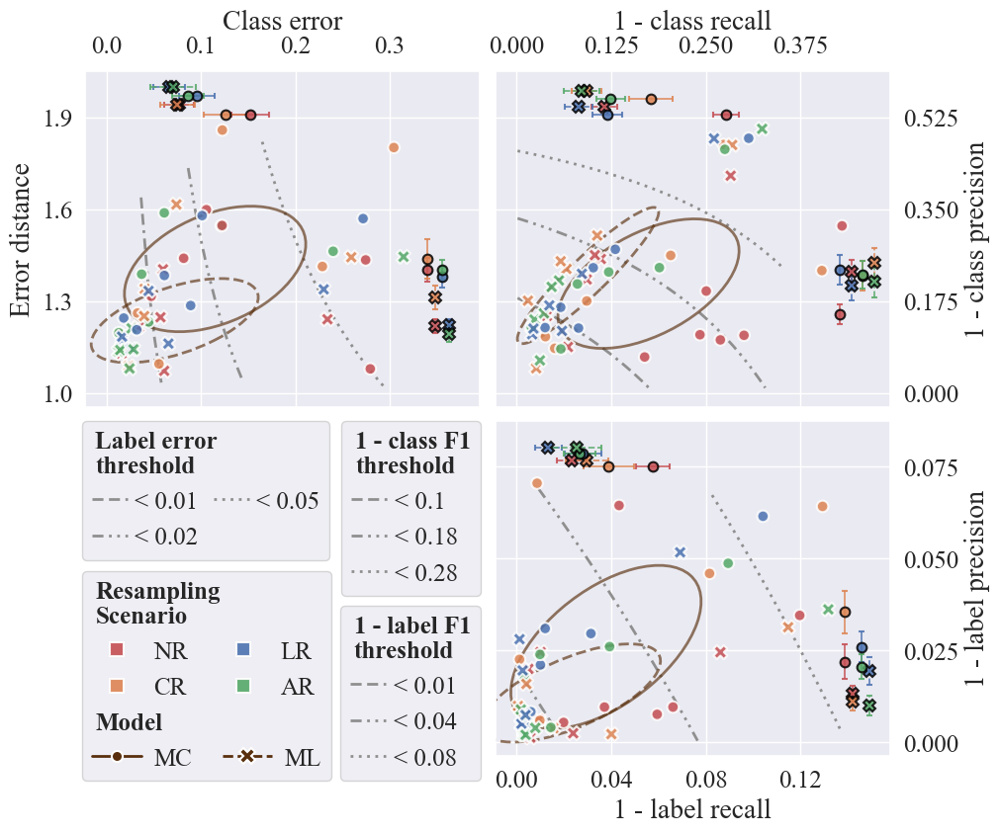

In [343]:
fig, axes = plt.subplots(2,2, figsize=(10.5,9))

# Per model means
for rs, resam in enumerate(resamplings):
    for m, mod in enumerate(model_names):
        means = resampling_means[
            (resampling_means[TRAIN_COL] == resam) &
            (resampling_means[MODEL_COL] == mod)
        ]
        sterrs = resampling_sterrs[
            (resampling_sterrs[TRAIN_COL] == resam) &
            (resampling_sterrs[MODEL_COL] == mod)
        ]
        
        # Error
        ax = axes[0,0]
        xpos = 0.34 + 0.015 * (rs // 2) + 0.0075 * m
        ypos = 1.91 + 0.06 * (rs // 2) + 0.03 * m
        for x, xe, y, ye in zip(
            [means[cErr], [xpos]], [sterrs[cErr] / 5, None],
            [[ypos], means[errDist]], [None, sterrs[errDist] / 5]
        ):
            ebc = ax.errorbar(x=x, y=y,
                        color=CPAL[rs],
                        marker=model_markers[mod],
                        markersize=marker_size[mod] // 12 + 2 * (1 - m),
                        xerr=xe, yerr=ye,
                        markeredgecolor=BLACK,
                        markeredgewidth=1.5,               
                        ecolor=CPAL[rs], elinewidth=1.25,
                        capsize=2, capthick=1, zorder=2,
                        alpha=0.85
                        )
            for cap in ebc[-1]:
                cap.set_linestyle(model_style[mod])
        
        # Class
        ax = axes[0,1]
        xpos = 0.4275 + 0.03 * (rs % 2) + 0.015 * m
        ypos = 0.53 + 0.03 * (rs % 2) + 0.015 * m
        for x, xe, y, ye in zip(
            [means[cRec], [xpos]], [sterrs[cRec] / 5, None],
            [[ypos], means[cPrec]], [None, sterrs[cPrec] / 5]
        ):
            ebc = ax.errorbar(x=x, y=y,
                        color=CPAL[rs],
                        marker=model_markers[mod],
                        markersize=marker_size[mod] // 12 + 2 * (1 - m),
                        xerr=xe, yerr=ye,
                        markeredgecolor=BLACK,
                        markeredgewidth=1.5,               
                        ecolor=CPAL[rs], elinewidth=1.25,
                        capsize=2, capthick=1, zorder=2,
                        alpha=0.85
                        )
            for cap in ebc[-1]:
                cap.set_linestyle(model_style[mod])
        
        # Label
        ax = axes[1,1]
        xpos = 0.13875 + 0.007 * (rs // 2) + 0.0035 * m
        ypos = 0.075 + 0.0035 * (rs // 2) + 0.00175 * m
        for x, xe, y, ye in zip(
            [means[lRec], [xpos]], [sterrs[lRec] / 5, None],
            [[ypos], means[lPrec]], [None, sterrs[lPrec] / 5]
        ):
            ebc = ax.errorbar(x=x, y=y,
                        color=CPAL[rs],
                        marker=model_markers[mod],
                        markersize=marker_size[mod] // 12 + 2 * (1 - m),
                        xerr=xe, yerr=ye,
                        markeredgecolor=BLACK,
                        markeredgewidth=1.5,               
                        ecolor=CPAL[rs], elinewidth=1.25,
                        capsize=2, capthick=1, zorder=2,
                        alpha=0.85
                        )
            for cap in ebc[-1]:
                cap.set_linestyle(model_style[mod])

hl = 1.45
hlt = 0.05
cg = 0.6
htp = 0.3
htpt = 0.1
lg_crn = {
    "t": -0.005,
    "r": -0.005,
    "b": -0.11,
    "l": -0.04
    }
bold_labels = [MODEL_COL, TRAIN_COL,
               TRAIN_COL.replace(' ', '\n'), 'Reference']

# Error
if True:
    ax = axes[0,0]
    sns.scatterplot(data=all_results_filt, x=cErr, y=errDist,
                    hue=TRAIN_COL, style=MODEL_COL, palette=CPAL, 
                    ax=ax, markers=model_markers,
                    size=MODEL_COL, sizes=marker_size, zorder=3,
                    linewidth=1.5,
                    alpha=0.85,
                    )

    x_range = np.linspace(0.001, 0.35, 50)
    lerr_95 = lbl_error_ceiling(cErr, errDist, lErr, 0.01)
    lerr_90 = lbl_error_ceiling(cErr, errDist, lErr, 0.025)
    lerr_80 = lbl_error_ceiling(cErr, errDist, lErr, 0.05)
    sns.lineplot(x=x_range, y=err_dist_from_cerr(x_range, lerr=0.01, hi=1.85), label=f'<{lerr_95}',
        color=GREY, linestyle=reference_lines[0], ax=ax,
        linewidth=2., zorder=1
    )
    sns.lineplot(x=x_range, y=err_dist_from_cerr(x_range, lerr=0.025, hi=1.85), label=f'<{lerr_90}',
        color=GREY, linestyle=reference_lines[1], ax=ax,
        linewidth=2., zorder=1
    )
    sns.lineplot(x=x_range, y=err_dist_from_cerr(x_range, lerr=0.05, hi=1.85), label=f'<{lerr_80}',
        color=GREY, linestyle=reference_lines[2], ax=ax,
        linewidth=2., zorder=1
    )

    for g, group in all_results_filt.groupby([MODEL_COL]):
        x, y = group[cErr], group[errDist]
        confidence_ellipse(x, y, ax, n_std=1.0, edgecolor=TPAL[2], linestyle=model_style[g[0]], linewidth=2, alpha=0.65, zorder=2)
    handles = [
        Line2D([0], [0], color=GREY, linestyle=reference_lines[0], alpha=1., lw=2, label=f'< {lerr_95}'),
        Line2D([0], [0], color=GREY, linestyle=reference_lines[1], alpha=1., lw=2, label=f'< {lerr_90}'),
        Line2D([0], [0], color=GREY, linestyle=reference_lines[2], alpha=1., lw=2, label=f'< {lerr_80}')
    ]

    lg_err = ax.legend(handles=[Line2D([0], [0], color='none', label=f'{lErr}\nthreshold')],
                    loc='upper left', bbox_to_anchor=(lg_crn['l'], lg_crn['t']),
                    handlelength=hlt, columnspacing=cg, handletextpad=htpt,
                    fontsize=TICK_SIZE, ncol=1)
    leg = mlegend.Legend(ax,
                     handles=handles, labels=[h.get_label() for h in handles],
                     fontsize=TICK_SIZE, handlelength=hl, columnspacing=cg, handletextpad=htp,
                     ncol=2, frameon=False)
    for child in leg._legend_box._children:
        lg_err._legend_box._children.append(child)
    lg_err._legend_box.align = "left"
    # ax.xaxis.tick_top()
    ax.set_ylabel(errDist, fontsize=LBL_SIZE)
    ax.set_xlabel(cErr, fontsize=LBL_SIZE)
    ax.tick_params(axis='both', labelsize=TICK_SIZE)
    ax.tick_params(axis='x', which='both', labelbottom=False, bottom=False, top=False, labeltop=True)
    ax.xaxis.set_label_position('top')
    ax.yaxis.set_major_locator(ticker.MultipleLocator(0.3, 1.))
    ax.set_ylim(0.955, 2.05)
    ax.xaxis.set_major_locator(ticker.MultipleLocator(0.1))
    ax.set_xlim(-0.0225, 0.395)


# Class
if True:
    ax = axes[0,1]
    sns.scatterplot(data=all_results_filt, x=cRec, y=cPrec, 
                    hue=TRAIN_COL, style=MODEL_COL, palette=CPAL,
                    ax=ax, markers=model_markers,
                    size=MODEL_COL, sizes=marker_size, zorder=3,
                    linewidth=1.5,
                    alpha=0.85,
                    )
    x_range = np.linspace(0.001, 0.35, 50)
    f1_95 = round(1 - f1_ceiling(cRec, cPrec, cF1, 0.9),2)
    f1_90 = round(1 - f1_ceiling(cRec, cPrec, cF1, 0.8),2)
    f1_80 = round(1 - f1_ceiling(cRec, cPrec, cF1, 0.7),2)
    sns.lineplot(x=x_range, y=inv_prec_from_rec(x_range, f1=0.9), label=f'<{f1_95}',
        color=GREY, linestyle=reference_lines[0], ax=ax,
        linewidth=2., zorder=1)
    sns.lineplot(x=x_range, y=inv_prec_from_rec(x_range, f1=0.8), label=f'<{f1_90}',
        color=GREY, linestyle=reference_lines[1], ax=ax,
        linewidth=2., zorder=1)
    sns.lineplot(x=x_range, y=inv_prec_from_rec(x_range, f1=0.7), label=f'<{f1_80}',
        color=GREY, linestyle=reference_lines[2], ax=ax,
        linewidth=2., zorder=1)

    for g, group in all_results_filt.groupby([MODEL_COL]):
        x, y = group[cRec], group[cPrec]
        confidence_ellipse(x, y, ax, n_std=1.0, edgecolor=TPAL[2], linestyle=model_style[g[0]], linewidth=2, alpha=0.65, zorder=2)

    lg_cls = ax.legend(handles=[Line2D([0], [0], color='none', label=f'{cF1}\nthreshold')],
                    loc='upper right', bbox_to_anchor=(lg_crn['r'], lg_crn['t']),
                    handlelength=hlt, columnspacing=cg, handletextpad=htpt,
                    fontsize=TICK_SIZE, ncol=1)
    handles = [
        Line2D([0], [0], color=GREY, linestyle=reference_lines[0], alpha=1., lw=2, label=f'< {f1_95}'),
        Line2D([0], [0], color=GREY, linestyle=reference_lines[1], alpha=1., lw=2, label=f'< {f1_90}'),
        Line2D([0], [0], color=GREY, linestyle=reference_lines[2], alpha=1., lw=2, label=f'< {f1_80}')
    ]
    leg = mlegend.Legend(ax,
                     handles=handles, labels=[h.get_label() for h in handles],
                     fontsize=TICK_SIZE, handlelength=hl, columnspacing=cg, handletextpad=htp,
                     ncol=1, frameon=False)
    for child in leg._legend_box._children:
        lg_cls._legend_box._children.append(child)
    lg_cls._legend_box.align = "left"
    ax.set_ylabel(cPrec, fontsize=LBL_SIZE)
    ax.set_xlabel(cRec, fontsize=LBL_SIZE)
    ax.tick_params(axis='both', labelsize=TICK_SIZE)
    ax.tick_params(axis='x', which='both', labelbottom=False, bottom=False, top=False, labeltop=True)
    ax.xaxis.set_label_position('top')
    ax.tick_params(axis='y', which='both', labelleft=False, left=False, right=False, labelright=True)
    ax.yaxis.set_label_position('right')
    ax.yaxis.set_major_locator(ticker.MultipleLocator(0.175))
    ax.set_ylim(-0.02625, 0.6125)
    ax.xaxis.set_major_locator(ticker.MultipleLocator(0.125))
    ax.set_xlim(-0.028125, 0.49375)

# Label
if True:
    ax = axes[1,1]
    sns.scatterplot(data=all_results_filt, x=lRec, y=lPrec, hue=TRAIN_COL, style=MODEL_COL, palette=CPAL, ax=ax, markers=model_markers,
                    size=MODEL_COL, sizes=marker_size, zorder=3,
                    linewidth=1.5,
                    alpha=0.85,
                    )

    x_range = np.linspace(0.00001, 0.15, 50)
    f1_95 = round(1 - f1_ceiling(lRec, lPrec, lF1, 0.99), 2)
    f1_90 = round(1 - f1_ceiling(lRec, lPrec, lF1, 0.96), 2)
    f1_80 = round(1 - f1_ceiling(lRec, lPrec, lF1, 0.925), 2)
    sns.lineplot(x=x_range, y=inv_prec_from_rec(x_range, f1=0.99, low=.93, hi=1), label=f'<{f1_95}',
        color=GREY, linestyle=reference_lines[0], ax=ax,
        linewidth=2., zorder=1)
    sns.lineplot(x=x_range, y=inv_prec_from_rec(x_range, f1=0.96, low=.93, hi=1), label=f'<{f1_90}',
        color=GREY, linestyle=reference_lines[1], ax=ax,
        linewidth=2., zorder=1)
    sns.lineplot(x=x_range, y=inv_prec_from_rec(x_range, f1=0.925, low=.93, hi=1), label=f'<{f1_80}',
        color=GREY, linestyle=reference_lines[2], ax=ax,
        linewidth=2., zorder=1)

    for g, group in all_results_filt.groupby([MODEL_COL]):
        x, y = group[lRec], group[lPrec]
        confidence_ellipse(x, y, ax, n_std=1.0, edgecolor=TPAL[2], linestyle=model_style[g[0]], linewidth=2, alpha=0.65, zorder=2)

    lg_lbl = ax.legend(handles=[Line2D([0], [0], color='none', label=f'{lF1}\nthreshold')],
                    loc='lower right', bbox_to_anchor=(lg_crn['r'], lg_crn['b']),
                    handlelength=hlt, columnspacing=cg, handletextpad=htpt,
                    fontsize=TICK_SIZE, ncol=1)
    handles = [
        Line2D([0], [0], color=GREY, linestyle=reference_lines[0], alpha=1., lw=2, label=f'< {f1_95}'),
        Line2D([0], [0], color=GREY, linestyle=reference_lines[1], alpha=1., lw=2, label=f'< {f1_90}'),
        Line2D([0], [0], color=GREY, linestyle=reference_lines[2], alpha=1., lw=2, label=f'< {f1_80}')
    ]
    leg = mlegend.Legend(ax,
                     handles=handles, labels=[h.get_label() for h in handles],
                     fontsize=TICK_SIZE, handlelength=hl, columnspacing=cg, handletextpad=htp,
                     ncol=1, frameon=False)
    for child in leg._legend_box._children:
        lg_lbl._legend_box._children.append(child)
    lg_lbl._legend_box.align = "left"
    ax.set_ylabel(lPrec, fontsize=LBL_SIZE)
    ax.set_xlabel(lRec, fontsize=LBL_SIZE)
    ax.tick_params(axis='both', labelsize=TICK_SIZE)
    ax.tick_params(axis='y', which='both', labelleft=False, left=False, right=False, labelright=True)
    ax.yaxis.set_label_position('right')
    ax.yaxis.set_major_locator(ticker.MultipleLocator(0.025))
    ax.set_ylim(-0.00375, 0.0875)
    ax.xaxis.set_major_locator(ticker.MultipleLocator(0.04))
    ax.set_xlim(-0.009, 0.158)


hl = 2.
# hlt = 0.5
cg = 1.25
htp = 0.5
# Build up legend:
if True:
    ax = axes[1,0]
    ax.axis('off')
    lg1 = ax.legend(handles=[Line2D([0], [0], color='none', label=TRAIN_COL.replace(' ', '\n'))],
            loc='lower left', bbox_to_anchor=(lg_crn['l'], lg_crn['b']),
            handlelength=hlt, handletextpad=htpt,
            fontsize=TICK_SIZE, ncols=1,
            )
    lg2 = mlegend.Legend(ax,
                        handles=[Line2D([0], [0], color='none',
                            marker='s', markersize=10,
                            markeredgecolor=WHITE,
                            markerfacecolor=CPAL[r],
                            markeredgewidth=1.5,
                            alpha=0.9,
                            #   linestyle='-', lw=1.5,
                            label=f"{abbreviations[res]}") for r, res in enumerate(resamplings)],
                        labels=[f"{abbreviations[res]}" for res in resamplings],
                        fontsize=TICK_SIZE, handlelength=hl, columnspacing=cg, handletextpad=htp,
                        loc='upper left', bbox_to_anchor=(1., 0.9), ncol=2, frameon=False)
    lg3 = mlegend.Legend(ax,
                        handles=[Line2D([0], [0], color='none', label=MODEL_COL)],
                        labels=[MODEL_COL],
                        loc='upper left', bbox_to_anchor=(1., 0.5),
                        handlelength=hlt, columnspacing=cg, handletextpad=htpt,
                        fontsize=TICK_SIZE, ncol=2, frameon=False)

    lg4 = mlegend.Legend(ax,
                        handles=[
                            Line2D([0], [0], color=TPAL[2],
                            marker=model_markers[mod], markersize=marker_size[mod] // 8,
                            markeredgecolor=WHITE,
                            markeredgewidth=1.5,
                            linestyle=model_style[mod], lw=2.,
                            alpha=1.,
                            label=f"{abbreviations[mod]}") for m, mod in enumerate(model_names)
                        ],
                        labels=[f"{abbreviations[mod]}" for m, mod in enumerate(model_names)],
                        fontsize=TICK_SIZE, handlelength=hl, columnspacing=cg, handletextpad=htp,
                        loc='upper left', bbox_to_anchor=(1., 0.9), ncol=2, frameon=False)

    legends = [lg1, lg2, lg3, lg4]
    # Manually combine the legends
    for leg in legends[1:]:
        for child in leg._legend_box._children:
            lg1._legend_box._children.append(child)
    lg1._legend_box.align = "left"

    legends = legends + [lg_err, lg_cls, lg_lbl]
    for lts in [leg.get_texts() for leg in legends]:
        for text in lts:
            t = text.get_text()
            if t in bold_labels or 'threshold' in t:
                text.set_fontweight('bold')
                text.set_fontsize(TICK_SIZE)

# plt.tight_layout()
plt.subplots_adjust(hspace=0.04, wspace=0.04)
plt.savefig(os.path.join(PLOT_EVALS, 'paired_metrics_all.pdf'), bbox_inches='tight')

#### Per-Model approach Resampling compare

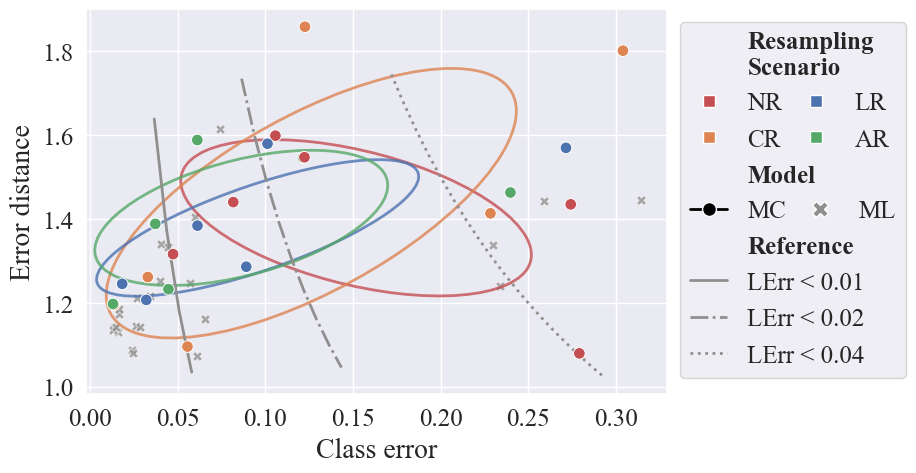

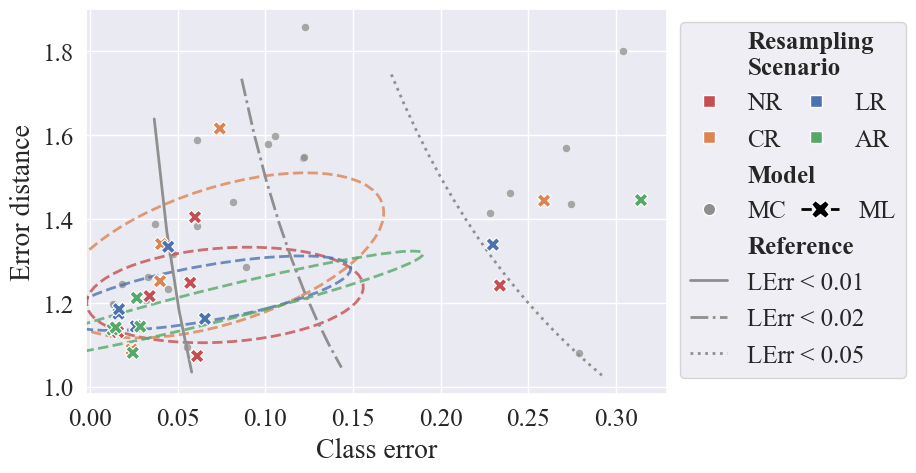

In [ ]:
xlim, ylim = None, None

for m, model in enumerate(model_names):
    fig, ax = plt.subplots(1,1, figsize=(7.5,5))

    model_results = all_results_filt[
        all_results_filt[MODEL_COL] == model
        ]
    other_model = model_names[not m]

    sns.scatterplot(data=model_results, x=cErr, y=errDist,
                    hue=TRAIN_COL, style=MODEL_COL, palette=CPAL, zorder=3,
                    ax=ax, markers=model_markers, s=marker_size[model])
    sns.scatterplot(data=all_results_filt[all_results_filt[MODEL_COL] != model],
                    x=cErr, y=errDist,
                    marker=model_markers[other_model], color=GREY, zorder=1,
                    ax=ax, s=marker_size[other_model] // 2, legend=False,
                    alpha=0.75,)
    
    x_range = np.linspace(0.001, 0.35, 50)
    lerr_95 = lbl_error_ceiling(cErr, errDist, lErr, 0.01, df=model_results)
    lerr_90 = lbl_error_ceiling(cErr, errDist, lErr, 0.025, df=model_results)
    lerr_80 = lbl_error_ceiling(cErr, errDist, lErr, 0.05, df=model_results)
    sns.lineplot(x=x_range, y=err_dist_from_cerr(x_range, lerr=0.01, hi=1.8), label=f'{abbreviations[lErr]} < {lerr_95}', color=GREY, linestyle='-',
    linewidth=2.)
    sns.lineplot(x=x_range, y=err_dist_from_cerr(x_range, lerr=0.025, hi=1.8), label=f'{abbreviations[lErr]} < {lerr_90}', color=GREY, linestyle='-.',
    linewidth=2.)
    sns.lineplot(x=x_range, y=err_dist_from_cerr(x_range, lerr=0.05, hi=1.8), label=f'{abbreviations[lErr]} < {lerr_80}', color=GREY, linestyle=':',
    linewidth=2.)
    for g, (rs, group) in enumerate(model_results.groupby([TRAIN_COL])):
        x, y = group[cErr], group[errDist]
        confidence_ellipse(x, y, ax, n_std=1.0, edgecolor=CPAL[g], linestyle=model_style[model], linewidth=2, alpha=0.8)


    # Build up legend:
    hl = 1.5
    cg = 0.6
    lg1 = ax.legend(handles=[Line2D([0], [0], color='none', label=TRAIN_COL.replace(' ', '\n'))],
            loc='upper left', bbox_to_anchor=(1., 1.),
            handlelength=hl,
            fontsize=TICK_SIZE, ncols=1,
            )
    lg2 = mlegend.Legend(ax,
                        handles=[Line2D([0], [0], color='none',
                            marker='s', markersize=8,
                            markeredgecolor=WHITE,
                            markerfacecolor=CPAL[r],
                            #   linestyle='-', lw=1.5,
                            label=f"{abbreviations[res]}") for r, res in enumerate(resamplings)],
                        labels=[f"{abbreviations[res]}" for res in resamplings],
                        fontsize=TICK_SIZE, handlelength=hl, columnspacing=cg,
                        loc='upper left', bbox_to_anchor=(1., 0.9), ncol=2, frameon=False)
    lg3 = mlegend.Legend(ax,
                        handles=[Line2D([0], [0], color='none', label=MODEL_COL)],
                        labels=[MODEL_COL],
                        loc='upper left', bbox_to_anchor=(1., 0.5),
                        handlelength=hl,
                        fontsize=TICK_SIZE, ncol=1, frameon=False)

    model_handles = []
    for m, mod in enumerate(model_names):
        if mod == model:
            model_handles.append(Line2D([0], [0], color=BLACK,
                            marker=model_markers[mod], markersize=marker_size[mod] // 10 + 3,
                            markeredgecolor=WHITE,
                            linestyle=model_style[mod], lw=2.,
                            alpha=1.,
                            label=f"{abbreviations[mod]}"))
        else:
            model_handles.append(Line2D([0], [0], color='none',
                            marker=model_markers[mod], markersize=marker_size[mod] // 10 + 2,
                            markeredgecolor=WHITE,
                            markerfacecolor=GREY,
                            linestyle=model_style[mod], lw=1.,
                            alpha=1.,
                            label=f"{abbreviations[mod]}"))
    lg4 = mlegend.Legend(ax,
                        handles=model_handles,
                        labels=[h.get_label() for h in model_handles],
                        fontsize=TICK_SIZE, handlelength=hl, columnspacing=cg,
                        loc='upper left', bbox_to_anchor=(1., 0.9), ncol=2, frameon=False)

    handles = [
        Line2D([0], [0], color='none', label='Reference'),
        Line2D([0], [0], color=GREY, linestyle='-', alpha=1., lw=2, label=f'{abbreviations[lErr]} < {lerr_95}'),
        Line2D([0], [0], color=GREY, linestyle='-.', alpha=1., lw=2, label=f'{abbreviations[lErr]} < {lerr_90}'),
        Line2D([0], [0], color=GREY, linestyle=':', alpha=1., lw=2, label=f'{abbreviations[lErr]} < {lerr_80}')
    ]

    lg5 = mlegend.Legend(ax,
                        handles=handles, labels=[h.get_label() for h in handles],
                        loc='upper left', bbox_to_anchor=(1., 0.5),
                        handlelength=hl,
                        fontsize=TICK_SIZE, ncol=1, frameon=False)
    legends = [lg1, lg2, lg3, lg4, lg5]
    # Manually combine the legends
    for leg in legends[1:]:
        for child in leg._legend_box._children:
            lg1._legend_box._children.append(child)
    lg1._legend_box.align = "left"

    bold_labels = [MODEL_COL, TRAIN_COL,
                TRAIN_COL.replace(' ', '\n'), 'Reference']
    for lts in [leg.get_texts() for leg in legends]:
        for text in lts:
            t = text.get_text()
            if t in bold_labels:
                text.set_fontweight('bold')
                text.set_fontsize(TICK_SIZE)
            
    ax.set_ylabel(errDist, fontsize=LBL_SIZE)
    ax.set_xlabel(cErr, fontsize=LBL_SIZE)
    ax.tick_params(axis='both', labelsize=TICK_SIZE)
    if xlim:
        ax.set_xlim(xlim)
    else:
        xlim = ax.get_xlim()
    if ylim:
        ax.set_ylim(ylim)
    else:
        ylim = ax.get_ylim()

# plt.tight_layout()

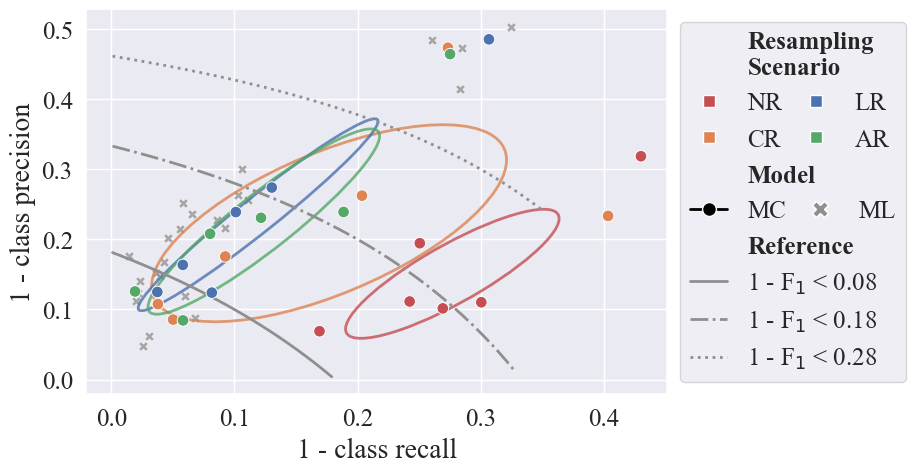

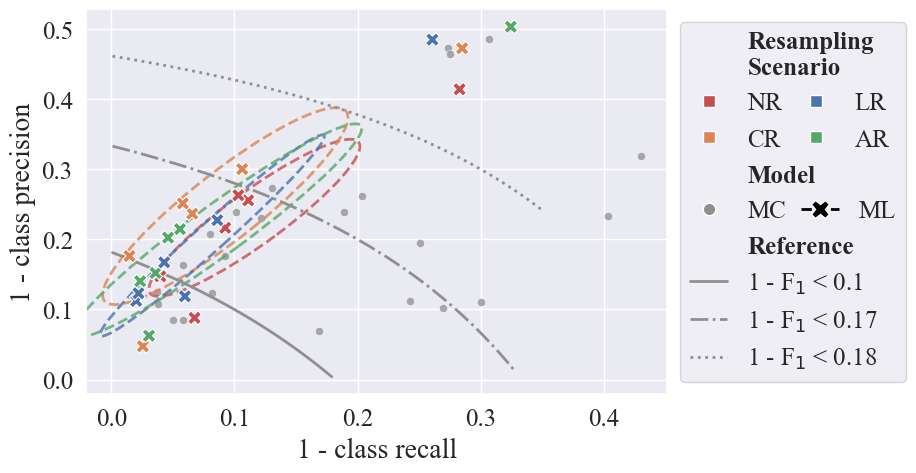

In [ ]:
xlim, ylim = None, None
for m, model in enumerate(model_names):
    fig, ax = plt.subplots(1,1, figsize=(7.5,5))

    model_results = all_results_filt[
        all_results_filt[MODEL_COL] == model
        ]
    other_model = model_names[not m]

    sns.scatterplot(data=model_results, x=cRec, y=cPrec,
                    hue=TRAIN_COL, style=MODEL_COL, palette=CPAL, zorder=3,
                    ax=ax, markers=model_markers, s=marker_size[model])
    sns.scatterplot(data=all_results_filt[all_results_filt[MODEL_COL] != model],
                    x=cRec, y=cPrec,
                    marker=model_markers[other_model], color=GREY, zorder=1,
                    ax=ax, s=marker_size[other_model] // 2, legend=False,
                    alpha=0.75,)
    x_range = np.linspace(0.001, 0.35, 50)
    f1_95 = round(1 - f1_ceiling(cRec, cPrec, cF1, 0.9, df=model_results),2)
    f1_90 = round(1 - f1_ceiling(cRec, cPrec, cF1, 0.8, df=model_results),2)
    f1_80 = round(1 - f1_ceiling(cRec, cPrec, cF1, 0.7, df=model_results),2)
    sns.lineplot(x=x_range, y=inv_prec_from_rec(x_range, f1=0.9), label=f'1 - F$_1$ < {f1_95}', color=GREY, linestyle='-',
    linewidth=2.)
    sns.lineplot(x=x_range, y=inv_prec_from_rec(x_range, f1=0.8), label=f'1 - F$_1$ < {f1_90}', color=GREY, linestyle='-.',
    linewidth=2.)
    sns.lineplot(x=x_range, y=inv_prec_from_rec(x_range, f1=0.7), label=f'1 - F$_1$ < {f1_80}', color=GREY, linestyle=':',
    linewidth=2.)

    for g, (rs, group) in enumerate(model_results.groupby([TRAIN_COL])):
        x, y = group[cRec], group[cPrec]
        confidence_ellipse(x, y, ax, n_std=1.0, edgecolor=CPAL[g], linestyle=model_style[model], linewidth=2, alpha=0.8)

    # Build up legend:
    hl = 1.5
    cg = 0.6
    lg1 = ax.legend(handles=[Line2D([0], [0], color='none', label=TRAIN_COL.replace(' ', '\n'))],
            loc='upper left', bbox_to_anchor=(1., 1.),
            handlelength=hl,
            fontsize=TICK_SIZE, ncols=1,
            )
    lg2 = mlegend.Legend(ax,
                        handles=[Line2D([0], [0], color='none',
                            marker='s', markersize=8,
                            markeredgecolor=WHITE,
                            markerfacecolor=CPAL[r],
                            #   linestyle='-', lw=1.5,
                            label=f"{abbreviations[res]}") for r, res in enumerate(resamplings)],
                        labels=[f"{abbreviations[res]}" for res in resamplings],
                        fontsize=TICK_SIZE, handlelength=hl, columnspacing=cg,
                        loc='upper left', bbox_to_anchor=(1., 0.9), ncol=2, frameon=False)
    lg3 = mlegend.Legend(ax,
                        handles=[Line2D([0], [0], color='none', label=MODEL_COL)],
                        labels=[MODEL_COL],
                        loc='upper left', bbox_to_anchor=(1., 0.5),
                        handlelength=hl,
                        fontsize=TICK_SIZE, ncol=1, frameon=False)

    model_handles = []
    for m, mod in enumerate(model_names):
        if mod == model:
            model_handles.append(Line2D([0], [0], color=BLACK,
                            marker=model_markers[mod], markersize=marker_size[mod] // 10 + 3,
                            markeredgecolor=WHITE,
                            linestyle=model_style[mod], lw=2.,
                            alpha=1.,
                            label=f"{abbreviations[mod]}"))
        else:
            model_handles.append(Line2D([0], [0], color='none',
                            marker=model_markers[mod], markersize=marker_size[mod] // 10 + 2,
                            markeredgecolor=WHITE,
                            markerfacecolor=GREY,
                            linestyle=model_style[mod], lw=1.,
                            alpha=1.,
                            label=f"{abbreviations[mod]}"))
    lg4 = mlegend.Legend(ax,
                        handles=model_handles,
                        labels=[h.get_label() for h in model_handles],
                        fontsize=TICK_SIZE, handlelength=hl, columnspacing=cg,
                        loc='upper left', bbox_to_anchor=(1., 0.9), ncol=2, frameon=False)

    handles = [
        Line2D([0], [0], color='none', label='Reference'),
        Line2D([0], [0], color=GREY, linestyle='-', alpha=1., lw=2, label=f'1 - F$_1$ < {f1_95}'),
        Line2D([0], [0], color=GREY, linestyle='-.', alpha=1., lw=2, label=f'1 - F$_1$ < {f1_90}'),
        Line2D([0], [0], color=GREY, linestyle=':', alpha=1., lw=2, label=f'1 - F$_1$ < {f1_80}')
    ]

    lg5 = mlegend.Legend(ax,
                        handles=handles, labels=[h.get_label() for h in handles],
                        loc='upper left', bbox_to_anchor=(1., 0.5),
                        handlelength=hl,
                        fontsize=TICK_SIZE, ncol=1, frameon=False)
    legends = [lg1, lg2, lg3, lg4, lg5]
    # Manually combine the legends
    for leg in legends[1:]:
        for child in leg._legend_box._children:
            lg1._legend_box._children.append(child)
    lg1._legend_box.align = "left"


    bold_labels = [MODEL_COL, TRAIN_COL,
                TRAIN_COL.replace(' ', '\n'), 'Reference']
    for lts in [leg.get_texts() for leg in legends]:
        for text in lts:
            t = text.get_text()
            if t in bold_labels:
                text.set_fontweight('bold')
                text.set_fontsize(TICK_SIZE)

    ax.set_ylabel(cPrec, fontsize=LBL_SIZE)
    ax.set_xlabel(cRec, fontsize=LBL_SIZE)
    ax.tick_params(axis='both', labelsize=TICK_SIZE)

    if xlim:
        ax.set_xlim(xlim)
    else:
        xlim = ax.get_xlim()
    if ylim:
        ax.set_ylim(ylim)
    else:
        ylim = ax.get_ylim()
# plt.tight_layout()

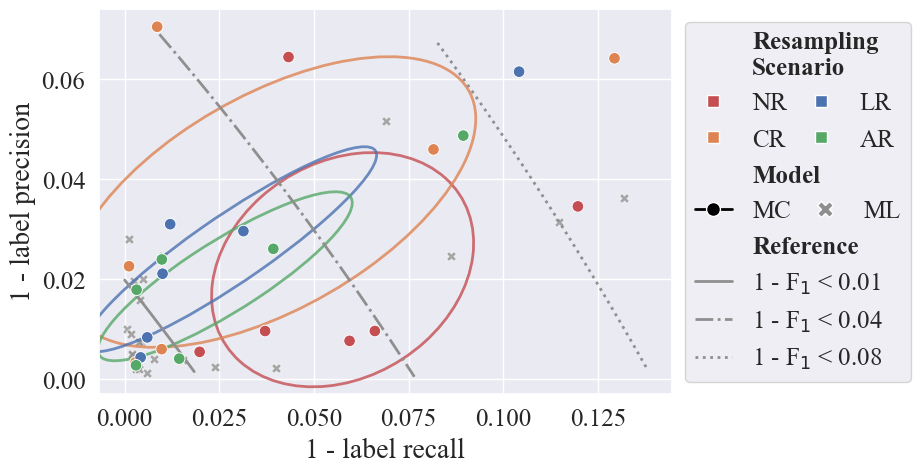

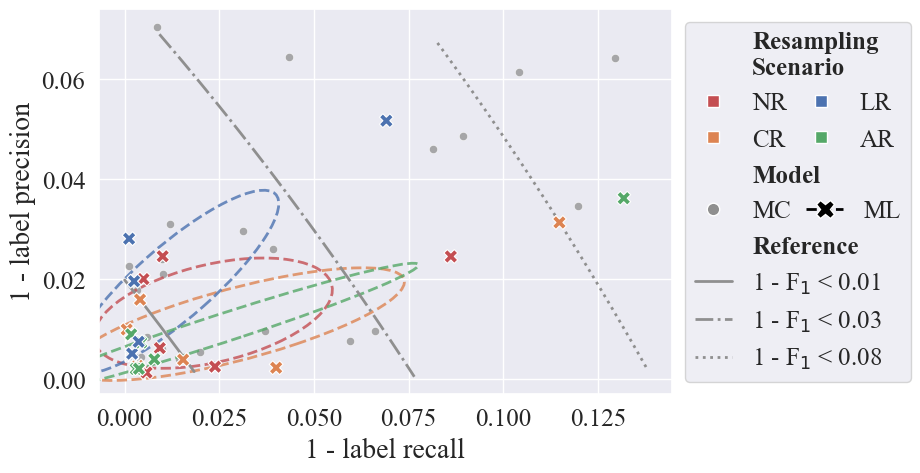

In [ ]:
xlim, ylim = None, None
for m, model in enumerate(model_names):
    fig, ax = plt.subplots(1,1, figsize=(7.4,5))

    model_results = all_results_filt[
        all_results_filt[MODEL_COL] == model
        ]
    other_model = model_names[not m]

    sns.scatterplot(data=model_results, x=lRec, y=lPrec,
                    hue=TRAIN_COL, style=MODEL_COL, palette=CPAL, zorder=3,
                    ax=ax, markers=model_markers, s=marker_size[model])
    sns.scatterplot(data=all_results_filt[all_results_filt[MODEL_COL] != model],
                    x=lRec, y=lPrec,
                    marker=model_markers[other_model], color=GREY, zorder=1,
                    ax=ax, s=marker_size[other_model] // 2, legend=False,
                alpha=0.75,)

    x_range = np.linspace(0.00001, 0.15, 50)
    f1_95 = round(1 - f1_ceiling(lRec, lPrec, lF1, 0.99, df=model_results),2)
    f1_90 = round(1 - f1_ceiling(lRec, lPrec, lF1, 0.96, df=model_results),2)
    f1_80 = round(1 - f1_ceiling(lRec, lPrec, lF1, 0.925, df=model_results),2)
    sns.lineplot(x=x_range, y=inv_prec_from_rec(x_range, f1=0.99, low=0.93), label=f'1 - F$_1$ < {f1_95}', color=GREY, linestyle='-',
    linewidth=2.)
    sns.lineplot(x=x_range, y=inv_prec_from_rec(x_range, f1=0.96, low=0.93), label=f'1 - F$_1$ < {f1_90}', color=GREY, linestyle='-.',
    linewidth=2.)
    sns.lineplot(x=x_range, y=inv_prec_from_rec(x_range, f1=0.925, low=0.93), label=f'1 - F$_1$ < {f1_80}', color=GREY, linestyle=':',
    linewidth=2.)

    for g, (rs, group) in enumerate(model_results.groupby([TRAIN_COL])):
        x, y = group[lRec], group[lPrec]
        confidence_ellipse(x, y, ax, n_std=1.0, edgecolor=CPAL[g], linestyle=model_style[model], linewidth=2, alpha=0.8)

    # Build up legend:
    hl = 1.5
    cg = 0.6
    lg1 = ax.legend(handles=[Line2D([0], [0], color='none', label=TRAIN_COL.replace(' ', '\n'))],
            loc='upper left', bbox_to_anchor=(1., 1.),
            handlelength=hl,
            fontsize=TICK_SIZE, ncols=1,
            )
    lg2 = mlegend.Legend(ax,
                        handles=[Line2D([0], [0], color='none',
                            marker='s', markersize=8,
                            markeredgecolor=WHITE,
                            markerfacecolor=CPAL[r],
                            #   linestyle='-', lw=1.5,
                            label=f"{abbreviations[res]}") for r, res in enumerate(resamplings)],
                        labels=[f"{abbreviations[res]}" for res in resamplings],
                        fontsize=TICK_SIZE, handlelength=hl, columnspacing=cg,
                        loc='upper left', bbox_to_anchor=(1., 0.9), ncol=2, frameon=False)
    lg3 = mlegend.Legend(ax,
                        handles=[Line2D([0], [0], color='none', label=MODEL_COL)],
                        labels=[MODEL_COL],
                        loc='upper left', bbox_to_anchor=(1., 0.5),
                        handlelength=hl,
                        fontsize=TICK_SIZE, ncol=1, frameon=False)

    model_handles = []
    for m, mod in enumerate(model_names):
        if mod == model:
            model_handles.append(Line2D([0], [0], color=BLACK,
                            marker=model_markers[mod], markersize=marker_size[mod] // 10 + 3,
                            markeredgecolor=WHITE,
                            linestyle=model_style[mod], lw=2.,
                            alpha=1.,
                            label=f"{abbreviations[mod]}"))
        else:
            model_handles.append(Line2D([0], [0], color='none',
                            marker=model_markers[mod], markersize=marker_size[mod] // 10 + 2,
                            markeredgecolor=WHITE,
                            markerfacecolor=GREY,
                            linestyle=model_style[mod], lw=1.,
                            alpha=1.,
                            label=f"{abbreviations[mod]}"))
    lg4 = mlegend.Legend(ax,
                        handles=model_handles,
                        labels=[h.get_label() for h in model_handles],
                        fontsize=TICK_SIZE, handlelength=hl, columnspacing=cg,
                        loc='upper left', bbox_to_anchor=(1., 0.9), ncol=2, frameon=False)

    handles = [
        Line2D([0], [0], color='none', label='Reference'),
        Line2D([0], [0], color=GREY, linestyle='-', alpha=1., lw=2, label=f'1 - F$_1$ < {f1_95}'),
        Line2D([0], [0], color=GREY, linestyle='-.', alpha=1., lw=2, label=f'1 - F$_1$ < {f1_90}'),
        Line2D([0], [0], color=GREY, linestyle=':', alpha=1., lw=2, label=f'1 - F$_1$ < {f1_80}')
    ]

    lg5 = mlegend.Legend(ax,
                        handles=handles, labels=[h.get_label() for h in handles],
                        loc='upper left', bbox_to_anchor=(1., 0.5),
                        handlelength=hl,
                        fontsize=TICK_SIZE, ncol=1, frameon=False)
    legends = [lg1, lg2, lg3, lg4, lg5]
    # Manually combine the legends
    for leg in legends[1:]:
        for child in leg._legend_box._children:
            lg1._legend_box._children.append(child)
    lg1._legend_box.align = "left"

    bold_labels = [MODEL_COL, TRAIN_COL,
                TRAIN_COL.replace(' ', '\n'), 'Reference']
    for lts in [leg.get_texts() for leg in legends]:
        for text in lts:
            t = text.get_text()
            if t in bold_labels:
                text.set_fontweight('bold')
                text.set_fontsize(TICK_SIZE)

    ax.set_ylabel(lPrec, fontsize=LBL_SIZE)
    ax.set_xlabel(lRec, fontsize=LBL_SIZE)
    ax.tick_params(axis='both', labelsize=TICK_SIZE)

    if xlim:
        ax.set_xlim(xlim)
    else:
        xlim = ax.get_xlim()
    if ylim:
        ax.set_ylim(ylim)
    else:
        ylim = ax.get_ylim()
        
# plt.tight_layout()

#### Pairwise across Evals

In [ ]:
all_results_melted.head()

,Evaluation,Resampling Scenario,Model,Metric,Value
0,In-distribution,No Resampling,Multiclass,Class error,0.047354
1,In-distribution,No Resampling,Multilabel,Class error,0.015979
2,In-distribution,Class Resampled,Multiclass,Class error,0.013648
3,In-distribution,Class Resampled,Multilabel,Class error,0.013732
4,In-distribution,Label Resampled,Multiclass,Class error,0.018309


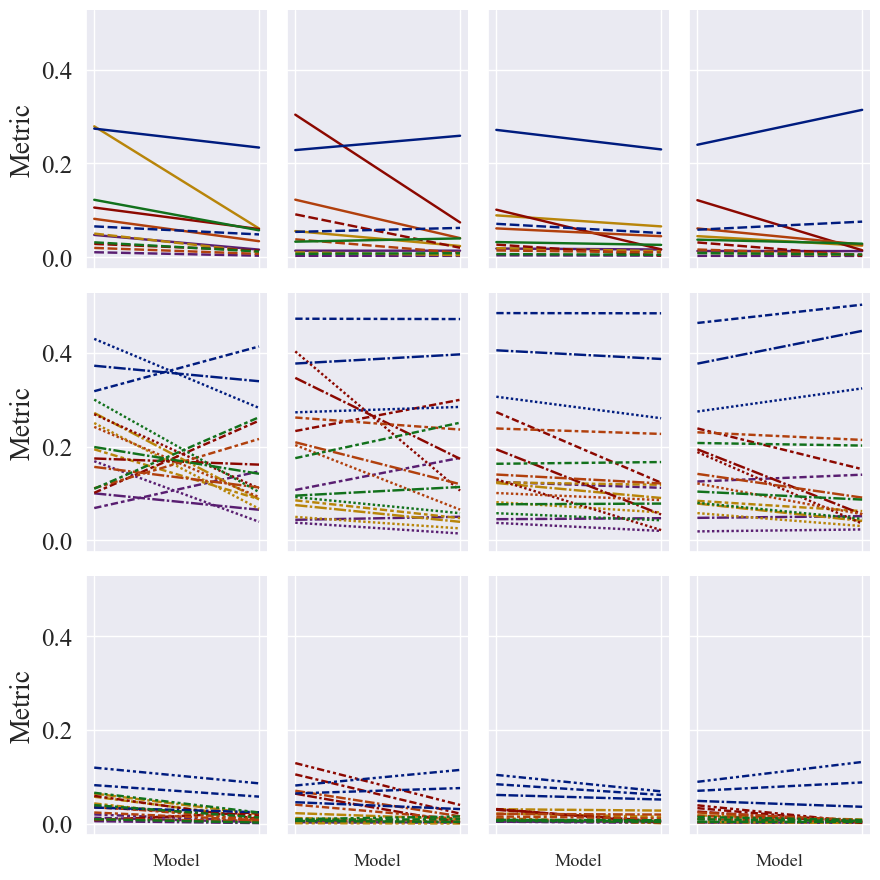

In [ ]:

data = all_results_melted[
    all_results_melted[MET_COL] != errDist
    ]
g = sns.FacetGrid(data=all_results_melted,
                  row=MG_COL, col=TRAIN_COL,
                  hue=EVAL_COL, #hue_order=metric_color,
                  palette=TPAL,
                  #sharey=False, #sharex=False,
                  height=3, aspect=0.75,
                  )
g.map(sns.lineplot, MODEL_COL, VAL_COL,
    # style=all_results_melted[MODEL_COL], style_order=model_style,
    style=data[MET_COL],
    legend=False,
    zorder=1,
    linewidth=1.75)
g.set_titles("")


axes = [ax for a, ax in g.axes_dict.items()]
ticks = [mtext.Text(t, 0, abbreviations[tick.get_text()]) for t, tick in enumerate(axes[0].get_xticklabels())]

# ax2.set_ylabel(f"{errDist}", fontsize=LBL_SIZE)
# ax2.tick_params(axis='both', right=False, labelsize=TICK_SIZE)
axes[0].set_xticklabels(ticks)
[ax.set_ylabel(f"{MET_COL}", fontsize=LBL_SIZE) for ax in axes]
axes[0].set_xlabel(MODEL_COL, fontsize=LBL_SIZE)
[ax.tick_params(axis='both', left=False, labelsize=TICK_SIZE) for ax in axes];
plt.tight_layout()

In [ ]:

data = key_mets[
    key_mets[MET_COL] != errDist
    ]
g = sns.FacetGrid(data, row=MG_COL, 
                hue=MET_COL, hue_order=metric_color, 
                palette=TPAL,
                sharey=False,
                height=3, aspect=2.75,
                gridspec_kws={
                    'hspace': 0.075
                }
    )
g.map(sns.lineplot, TRAIN_COL, VAL_COL,
    style=data[MODEL_COL], style_order=model_style, legend=False,
    zorder=1,
    linewidth=1.75)
g.map(sns.scatterplot, TRAIN_COL, VAL_COL,
    style=data[MODEL_COL], markers=model_markers, legend=False,
    zorder=2,
    linewidth=.75,
    s=70)
g.set_titles("")

axes = [ax for a, ax in g.axes_dict.items()]

ax2 = axes[0].twinx()
ax2.grid(False)

axes[0].yaxis.set_major_locator(ticker.MultipleLocator(0.02, 0))
axes[0].set_ylim(0.001, 0.05)

ax2.yaxis.set_major_locator(ticker.MultipleLocator(0.15, 1))
ax2.set_ylim(1.01, 1.375)

# axes[1].yaxis.set_major_locator(ticker.MultipleLocator(0.02, 0))
axes[1].set_ylim(0.001, 0.19)

# axes[2].yaxis.set_major_locator(ticker.MultipleLocator(0.02, 0))
axes[2].set_ylim(0.001, 0.025)

sns.lineplot(data=key_mets[
    key_mets[MET_COL] == errDist
    ], x=TRAIN_COL, y=VAL_COL,
        style=MODEL_COL, style_order=model_style,
        markers=model_markers, markersize=8,
        color=TPAL[metric_color[errDist]], linewidth=1.75,
        legend=False, zorder=1,
        ax=ax2)

handles = [
    Line2D([0], [0], color='none', label=MODEL_COL)
] + [
    Line2D([0], [0], color=BLACK,
        marker=model_markers[mod], markersize=marker_size[mod] // 7,
        markeredgecolor=WHITE,
        linestyle=model_style[mod], lw=1.5,
        label=f"{abbreviations[mod]}") for m, mod in enumerate(model_names)
    ]

lg1 = axes[1].legend(
    handles=handles,
    labels=[h.get_label() for h in handles],
    loc='center left', bbox_to_anchor=(1., 0),
    handlelength=1.5, #columnspacing=3.,
    fontsize=TICK_SIZE, ncols=1,
    #   frameon=False
    )

bold_labels = [MODEL_COL, MET_COL]
handles = [
    Line2D([0], [0], color='none', label=MET_COL)
]
for i, m in enumerate(article_metric_names):
    m_col = metric_color[m] 
    handles.append(Line2D([0], [0], color=TPAL[m_col], alpha=1,
        marker='s', markersize=5,
        markeredgecolor=WHITE,
        lw=1.75, markerfacecolor=TPAL[m_col], markeredgewidth=0.75,
        label="{}".format(
            abbreviations[m]
        )))

lg2 = mlegend.Legend(axes[1],
    handles=handles, labels=[h.get_label() for h in handles],
    loc='upper left', bbox_to_anchor=(1., 1.1),
    handlelength=1.5,
    fontsize=TICK_SIZE, ncols=1,
    #   frameon=False
)


# Manually combine the legends
for child in lg2._legend_box._children:
    lg1._legend_box._children.append(child)
lg1._legend_box.align = "left"

for text in (
    lg1.get_texts() + lg2.get_texts()
):
    t = text.get_text()
    if t in bold_labels:
        text.set_fontweight('bold')

ticks = [mtext.Text(t, 0, abbreviations[tick.get_text()]) for t, tick in enumerate(axes[2].get_xticklabels())]

ax2.set_ylabel(f"{errDist}", fontsize=LBL_SIZE)
ax2.tick_params(axis='both', right=False, labelsize=TICK_SIZE)
axes[2].set_xticklabels(ticks)
[ax.set_ylabel(f"{MET_COL}", fontsize=LBL_SIZE) for ax in axes]
axes[2].set_xlabel(TRAIN_COL, fontsize=LBL_SIZE)
[ax.tick_params(axis='both', left=False, labelsize=TICK_SIZE) for ax in axes]

### Stats Tests

#### Setup

In [41]:
from scipy.stats import friedmanchisquare, wilcoxon, shapiro, kruskal
import scikit_posthocs as sp


In [42]:
def sidak_adjust_alpha(a, m):
    return 1-pow(1-a, 1. / m)

def sidak_adjust_p(p, m):
    return 1 - pow(1 - p, m)



In [43]:
alpha = 0.05
num_compares = 3
alpha_adj = sidak_adjust_alpha(alpha, num_compares)
alpha_adj

0.016952427508441503

In [44]:
pval = 0.01
sidak_adjust_p(pval, num_compares)

0.029700999999999977

In [45]:
sidak_adjust_alpha(alpha, 9)

0.005683044988048058

In [126]:
def mc_ml_stats_test(results, metric, indexing=[TRAIN_COL, EVAL_COL], use_errors=False, a=alpha):
    print(f"Metric: {metric}")
    alt = 'greater' if 'Error' in metric or use_errors else 'less'
    h0 = 'ML >= MC' if 'Error' in metric or use_errors else 'MC >= ML'
    metric_table = pd.pivot_table(data=results, values=metric, index=indexing, columns=MODEL_COL)
    print(f"Number of paired samples: {metric_table.shape[0]}")
    
    shap_ml = shapiro(metric_table[ML])
    shap_mc = shapiro(metric_table[MC])
    print(f"Normality Test Multiclass. P-value {shap_mc.pvalue}. Reject H0 (normality) - {shap_mc.pvalue < a}")
    print(f"Normality Test Multilabel. P-value {shap_ml.pvalue}. Reject H0 (normality) - {shap_ml.pvalue < a}")
    wicox = wilcoxon(metric_table[MC], metric_table[ML], alternative=alt)
    print(f"Wilcoxon signed rank test. H0: {h0}. P-value {wicox.pvalue}. Reject H0 - {wicox.pvalue < a}")
    print('-'*50)
    
    return wicox

In [127]:
def mc_ml_stats_test_across_all(results, metrics, indexing=[TRAIN_COL, EVAL_COL], use_errors=True, a=alpha):
    alt = 'greater' if  use_errors else 'less'
    h0 = 'ML >= MC' if  use_errors else 'MC >= ML'
    metric_table = pd.concat([
        pd.pivot_table(data=results, values=metric, index=indexing, columns=MODEL_COL)
        for metric in metrics])
    print(f"Number of paired samples: {metric_table.shape[0]}")
    
    shap_ml = shapiro(metric_table[ML])
    shap_mc = shapiro(metric_table[MC])
    print(f"Normality Test Multiclass. P-value {shap_mc.pvalue}. Reject H0 (normality) - {shap_mc.pvalue < a}")
    print(f"Normality Test Multilabel. P-value {shap_ml.pvalue}. Reject H0 (normality) - {shap_ml.pvalue < a}")
    wicox = wilcoxon(metric_table[MC], metric_table[ML], alternative=alt)
    print(f"Wilcoxon signed rank test. H0: {h0}. P-value {wicox.pvalue}. Reject H0 - {wicox.pvalue < a}")
    print('-'*50)
    return wicox

In [128]:

def resampling_stats_test(results, metric, a=alpha):
    print(f"Metric: {metric}")
    metric_table = pd.pivot_table(data=results, values=metric, index=[MODEL_COL, EVAL_COL], columns=TRAIN_COL)[resamplings]
    print(f"Number of paired samples: {metric_table.shape[0]}")
    
    shap_base = shapiro(metric_table[BASE])
    shap_cb = shapiro(metric_table[CB])
    shap_lb = shapiro(metric_table[LB])
    shap_ab = shapiro(metric_table[AB])
    print(f"Normality Test No Resampling. P-value {shap_base.pvalue}. Reject H0 (normality) - {shap_base.pvalue < a}")
    print(f"Normality Test Class Resampling. P-value {shap_cb.pvalue}. Reject H0 (normality) - {shap_cb.pvalue < a}")
    print(f"Normality Test Label Resampling. P-value {shap_lb.pvalue}. Reject H0 (normality) - {shap_lb.pvalue < a}")
    print(f"Normality Test Adaptive Resampling. P-value {shap_ab.pvalue}. Reject H0 (normality) - {shap_ab.pvalue < a}")
    fried = friedmanchisquare(*metric_table.to_numpy().T)
    reject = fried.pvalue < a
    print(f"Friedman Chi-square test. H0: All resampling equivalent. P-value {fried.pvalue}. Reject H0 - {reject}")
    nemenyi = pd.DataFrame()
    if reject:
        nemenyi = sp.posthoc_nemenyi_friedman(metric_table.to_numpy())
        print("Nemenyi posthoc test for pairwise comparison.")
        nemenyi.columns = resamplings
        nemenyi.index = resamplings
        display(nemenyi)
    print('-'*50)
    
    return fried.pvalue, nemenyi
    

In [129]:

def resampling_stats_test_across_all(results, metrics, a=alpha):
    metric_table = pd.concat([
        pd.pivot_table(data=results, values=metric, index=[MODEL_COL, EVAL_COL], columns=TRAIN_COL)[resamplings]
        for metric in metrics])
    print(f"Number of paired samples: {metric_table.shape[0]}")
    
    shap_base = shapiro(metric_table[BASE])
    shap_cb = shapiro(metric_table[CB])
    shap_lb = shapiro(metric_table[LB])
    shap_ab = shapiro(metric_table[AB])
    print(f"Normality Test No Resampling. P-value {shap_base.pvalue}. Reject H0 (normality) - {shap_base.pvalue < a}")
    print(f"Normality Test Class Resampling. P-value {shap_cb.pvalue}. Reject H0 (normality) - {shap_cb.pvalue < a}")
    print(f"Normality Test Label Resampling. P-value {shap_lb.pvalue}. Reject H0 (normality) - {shap_lb.pvalue < a}")
    print(f"Normality Test Adaptive Resampling. P-value {shap_ab.pvalue}. Reject H0 (normality) - {shap_ab.pvalue < a}")
    fried = friedmanchisquare(*metric_table.to_numpy().T)
    reject = fried.pvalue < a
    print(f"Friedman Chi-square test. H0: All resampling equivalent. P-value {fried.pvalue}. Reject H0 - {reject}")
    nemenyi = pd.DataFrame()
    if reject:
        nemenyi = sp.posthoc_nemenyi_friedman(metric_table.to_numpy())
        print("Nemenyi posthoc test for pairwise comparison.")
        nemenyi.columns = resamplings
        nemenyi.index = resamplings
        display(nemenyi)
    print('-'*50)
    
    return fried.pvalue, nemenyi
    

In [130]:

def resampling_stats_test_kw(results, metric):
    print(f"Metric: {metric}")
    metric_table = pd.pivot_table(data=results, values=metric, index=[MODEL_COL, EVAL_COL], columns=TRAIN_COL)[resamplings]
    print(f"Number of paired samples: {metric_table.shape[0]}")
    
    shap_base = shapiro(metric_table[BASE])
    shap_cb = shapiro(metric_table[CB])
    shap_lb = shapiro(metric_table[LB])
    shap_ab = shapiro(metric_table[AB])
    print(f"Normality Test No Resampling. P-value {shap_base.pvalue}. Reject H0 (normality) - {shap_base.pvalue < alpha}")
    print(f"Normality Test Class Resampling. P-value {shap_cb.pvalue}. Reject H0 (normality) - {shap_cb.pvalue < alpha}")
    print(f"Normality Test Label Resampling. P-value {shap_lb.pvalue}. Reject H0 (normality) - {shap_lb.pvalue < alpha}")
    print(f"Normality Test Adaptive Resampling. P-value {shap_ab.pvalue}. Reject H0 (normality) - {shap_ab.pvalue < alpha}")
    krusk = kruskal(*metric_table.to_numpy().T)
    reject = krusk.pvalue < alpha
    print(f"Kruskal-Wallis H test. H0: All resampling equivalent. P-value {krusk.pvalue}. Reject H0 - {reject}")
    dunn = pd.DataFrame()
    if reject:
        dunn = sp.posthoc_dunn(metric_table.to_numpy())
        print("Dunn posthoc test for pairwise comparison.")
        dunn.columns = resamplings
        dunn.index = resamplings
        display(dunn)
    print('-'*50)
    
    return krusk.pvalue, dunn
    

#### MC ML Compare

In [ ]:
model_all_stats = {}
for metric in article_metric_names:
    wc = mc_ml_stats_test(all_results_filt, metric, use_errors=True, a=sidak_adjust_alpha(alpha, len(article_metric_names)))
    model_all_stats[metric] = wc.pvalue

Metric: Class error
Number of paired samples: 24
Normality Test Multiclass. P-value 0.0015437962369599684. Reject H0 (normality) - True
Normality Test Multilabel. P-value 2.7539605245658995e-06. Reject H0 (normality) - True
Wilcoxon signed rank test. H0: ML >= MC. P-value 0.0002472400665283203. Reject H0 - True
--------------------------------------------------
Metric: Label error
Number of paired samples: 24
Normality Test Multiclass. P-value 0.006930883984898789. Reject H0 (normality) - False
Normality Test Multilabel. P-value 2.8295668624902066e-06. Reject H0 (normality) - True
Wilcoxon signed rank test. H0: ML >= MC. P-value 0.00018638372421264648. Reject H0 - True
--------------------------------------------------
Metric: Error distance
Number of paired samples: 24
Normality Test Multiclass. P-value 0.46456013804297874. Reject H0 (normality) - False
Normality Test Multilabel. P-value 0.015936372566432613. Reject H0 (normality) - False
Wilcoxon signed rank test. H0: ML >= MC. P-val

In [ ]:
wc = mc_ml_stats_test_across_all(all_results_filt, article_metric_names, use_errors=True)
model_all_stats["All"] = wc.pvalue

Number of paired samples: 216
Normality Test Multiclass. P-value 8.855141420772418e-23. Reject H0 (normality) - True
Normality Test Multilabel. P-value 4.538648081752689e-23. Reject H0 (normality) - True
Wilcoxon signed rank test. H0: ML >= MC. P-value 1.816580316617367e-18. Reject H0 - True
--------------------------------------------------


#### Resampling compare

##### Manual analysis

In [160]:
metric_table = pd.pivot_table(data=all_results_filt, values=cRec, index=[MODEL_COL, EVAL_COL], columns=TRAIN_COL)[resamplings]

fried = friedmanchisquare(*metric_table.to_numpy().T)
reject = fried.pvalue < a
print(f"Friedman Chi-square test. H0: All resampling equivalent. P-value {fried.pvalue}. Reject H0 - {reject}")


nemenyi = sp.posthoc_nemenyi_friedman(metric_table.to_numpy())
nemenyi.columns = resamplings
nemenyi.index = resamplings
display(nemenyi)

Friedman Chi-square test. H0: All resampling equivalent. P-value 0.0011887906933325822. Reject H0 - True


C:\Users\User\AppData\Local\Temp\ipykernel_27620\2094120822.py:1: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  metric_table = pd.pivot_table(data=all_results_filt, values=cRec, index=[MODEL_COL, EVAL_COL], columns=TRAIN_COL)[resamplings]


,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
No Resampling,1.000000,0.036176,0.001574,0.008514
Class Resampled,0.036176,1.000000,0.778483,0.964741
Label Resampled,0.001574,0.778483,1.000000,0.964741
Adaptive Resampled,0.008514,0.964741,0.964741,1.000000


In [161]:
mrs = metric_table.apply(lambda x: np.argsort(np.argsort(x)) + 1, axis=1).mean()
mrs

Resampling Scenario
No Resampling         3.750000
Class Resampled       2.333333
Label Resampled       1.833333
Adaptive Resampled    2.083333
dtype: float64

In [159]:
k = 4
N = 12

In [162]:
chi2 = (12 * N) / (k * (k+1)) * (np.sum(mrs ** 2) - 0.25 * (k * (k+1)**2))
FF = ((N-1)*chi2) / (N * (k-1) - chi2)

# CV for a=0.05, dof k-1=3: 3.4903

chi2, FF # FF > Cv => reject

(15.900000000000018, 8.701492537313452)

In [163]:
# Nemenyi:
qa = 2.569 # for k=4
CD = qa * np.sqrt(k * (k+1) / (6 * N))
CD

1.353981884828761

In [168]:
# Paired diffs
for r1, m1 in mrs.to_frame().iterrows():
    for r2, m2 in mrs.to_frame().iterrows():
        if r1 == r2:
            continue
        print(f"Absolute paired difference {abbreviations[r1]} vs {abbreviations[r2]}: {np.abs(m1-m2)[0]}")

Absolute paired difference NR vs CR: 1.4166666666666665
Absolute paired difference NR vs LR: 1.9166666666666667
Absolute paired difference NR vs AR: 1.6666666666666665
Absolute paired difference CR vs NR: 1.4166666666666665
Absolute paired difference CR vs LR: 0.5000000000000002
Absolute paired difference CR vs AR: 0.25
Absolute paired difference LR vs NR: 1.9166666666666667
Absolute paired difference LR vs CR: 0.5000000000000002
Absolute paired difference LR vs AR: 0.2500000000000002
Absolute paired difference AR vs NR: 1.6666666666666665
Absolute paired difference AR vs CR: 0.25
Absolute paired difference AR vs LR: 0.2500000000000002


##### All models

In [131]:
resample_all_stats = {}
print(f"ADJUSTED ALPHA {round(sidak_adjust_alpha(alpha, len(article_metric_names)), 5)}")
for metric in article_metric_names:
    pval, phoc = resampling_stats_test(all_results_filt, metric, a=sidak_adjust_alpha(alpha, len(article_metric_names)))
    # pval, phoc = resampling_stats_test(all_results_filt, metric, a=alpha)
    resample_all_stats[metric] = (pval, phoc)

ADJUSTED ALPHA 0.00568
Metric: Class error
Number of paired samples: 12
Normality Test No Resampling. P-value 0.0149616829586541. Reject H0 (normality) - False
Normality Test Class Resampling. P-value 0.007119883928608553. Reject H0 (normality) - False
Normality Test Label Resampling. P-value 0.0031057762512255254. Reject H0 (normality) - True
Normality Test Adaptive Resampling. P-value 0.0007621580958396306. Reject H0 (normality) - True
Friedman Chi-square test. H0: All resampling equivalent. P-value 0.08966250398816791. Reject H0 - False
--------------------------------------------------
Metric: Label error
Number of paired samples: 12
Normality Test No Resampling. P-value 0.09591973377757135. Reject H0 (normality) - False
Normality Test Class Resampling. P-value 0.008182448994239255. Reject H0 (normality) - False
Normality Test Label Resampling. P-value 0.0027526460625217452. Reject H0 (normality) - True
Normality Test Adaptive Resampling. P-value 0.0008959071038128554. Reject H0 (n

C:\Users\User\AppData\Local\Temp\ipykernel_27620\4259523407.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  metric_table = pd.pivot_table(data=results, values=metric, index=[MODEL_COL, EVAL_COL], columns=TRAIN_COL)[resamplings]
C:\Users\User\AppData\Local\Temp\ipykernel_27620\4259523407.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  metric_table = pd.pivot_table(data=results, values=metric, index=[MODEL_COL, EVAL_COL], columns=TRAIN_COL)[resamplings]
C:\Users\User\AppData\Local\Temp\ipykernel_27620\4259523407.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify obser

Nemenyi posthoc test for pairwise comparison.


,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
No Resampling,1.000000,0.036176,0.001574,0.008514
Class Resampled,0.036176,1.000000,0.778483,0.964741
Label Resampled,0.001574,0.778483,1.000000,0.964741
Adaptive Resampled,0.008514,0.964741,0.964741,1.000000


--------------------------------------------------
Metric: 1 - class precision
Number of paired samples: 12
Normality Test No Resampling. P-value 0.2640893911085244. Reject H0 (normality) - False
Normality Test Class Resampling. P-value 0.2754926638951118. Reject H0 (normality) - False
Normality Test Label Resampling. P-value 0.003396333332068273. Reject H0 (normality) - True
Normality Test Adaptive Resampling. P-value 0.029845040322201317. Reject H0 (normality) - False
Friedman Chi-square test. H0: All resampling equivalent. P-value 0.5125209069771435. Reject H0 - False
--------------------------------------------------
Metric: 1 - class F1
Number of paired samples: 12
Normality Test No Resampling. P-value 0.1576949982988986. Reject H0 (normality) - False
Normality Test Class Resampling. P-value 0.02891129563783921. Reject H0 (normality) - False
Normality Test Label Resampling. P-value 0.003084272923845013. Reject H0 (normality) - True
Normality Test Adaptive Resampling. P-value 0.002

C:\Users\User\AppData\Local\Temp\ipykernel_27620\4259523407.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  metric_table = pd.pivot_table(data=results, values=metric, index=[MODEL_COL, EVAL_COL], columns=TRAIN_COL)[resamplings]
C:\Users\User\AppData\Local\Temp\ipykernel_27620\4259523407.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  metric_table = pd.pivot_table(data=results, values=metric, index=[MODEL_COL, EVAL_COL], columns=TRAIN_COL)[resamplings]
C:\Users\User\AppData\Local\Temp\ipykernel_27620\4259523407.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify obser

,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
No Resampling,1.000000,0.022956,0.001574,0.082573
Class Resampled,0.022956,1.000000,0.858779,0.964741
Label Resampled,0.001574,0.858779,1.000000,0.585369
Adaptive Resampled,0.082573,0.964741,0.585369,1.000000


--------------------------------------------------
Metric: 1 - label precision
Number of paired samples: 12
Normality Test No Resampling. P-value 0.011275171076361189. Reject H0 (normality) - False
Normality Test Class Resampling. P-value 0.016102912786098565. Reject H0 (normality) - False
Normality Test Label Resampling. P-value 0.06670805460372936. Reject H0 (normality) - False
Normality Test Adaptive Resampling. P-value 0.027184785789153173. Reject H0 (normality) - False
Friedman Chi-square test. H0: All resampling equivalent. P-value 0.02555702810722494. Reject H0 - False
--------------------------------------------------
Metric: 1 - label F1
Number of paired samples: 12
Normality Test No Resampling. P-value 0.10619331777843205. Reject H0 (normality) - False
Normality Test Class Resampling. P-value 0.006524885943082887. Reject H0 (normality) - False
Normality Test Label Resampling. P-value 0.0022620047366979546. Reject H0 (normality) - True
Normality Test Adaptive Resampling. P-val

C:\Users\User\AppData\Local\Temp\ipykernel_27620\4259523407.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  metric_table = pd.pivot_table(data=results, values=metric, index=[MODEL_COL, EVAL_COL], columns=TRAIN_COL)[resamplings]
C:\Users\User\AppData\Local\Temp\ipykernel_27620\4259523407.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  metric_table = pd.pivot_table(data=results, values=metric, index=[MODEL_COL, EVAL_COL], columns=TRAIN_COL)[resamplings]


In [132]:

print(f"ADJUSTED ALPHA {round(sidak_adjust_alpha(alpha, 3), 5)}")
for g, mg in met_group_lists.items():
    print(f"{g.capitalize()}-based metrics")
    # pval, phoc = resampling_stats_test_across_all(all_results_filt, mg, a=sidak_adjust_alpha(alpha, 3))
    pval, phoc = resampling_stats_test_across_all(all_results_filt, mg, a=alpha)
    resample_all_stats[g] = (pval, phoc)
    print('-'*100)

ADJUSTED ALPHA 0.01695
Error-based metrics
Number of paired samples: 36
Normality Test No Resampling. P-value 5.893697434749919e-07. Reject H0 (normality) - True
Normality Test Class Resampling. P-value 9.778875081572773e-07. Reject H0 (normality) - True
Normality Test Label Resampling. P-value 2.7606914490045365e-07. Reject H0 (normality) - True
Normality Test Adaptive Resampling. P-value 3.5619063289091034e-07. Reject H0 (normality) - True
Friedman Chi-square test. H0: All resampling equivalent. P-value 0.031117170455882037. Reject H0 - True
Nemenyi posthoc test for pairwise comparison.


C:\Users\User\AppData\Local\Temp\ipykernel_27620\892267968.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  pd.pivot_table(data=results, values=metric, index=[MODEL_COL, EVAL_COL], columns=TRAIN_COL)[resamplings]
C:\Users\User\AppData\Local\Temp\ipykernel_27620\892267968.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  pd.pivot_table(data=results, values=metric, index=[MODEL_COL, EVAL_COL], columns=TRAIN_COL)[resamplings]
C:\Users\User\AppData\Local\Temp\ipykernel_27620\892267968.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning

,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
No Resampling,1.000000,0.983361,0.797991,0.031364
Class Resampled,0.983361,1.000000,0.947190,0.082221
Label Resampled,0.797991,0.947190,1.000000,0.261119
Adaptive Resampled,0.031364,0.082221,0.261119,1.000000


--------------------------------------------------
----------------------------------------------------------------------------------------------------
Class-based metrics
Number of paired samples: 36
Normality Test No Resampling. P-value 0.03037267287709985. Reject H0 (normality) - True
Normality Test Class Resampling. P-value 0.0053496654617761884. Reject H0 (normality) - True
Normality Test Label Resampling. P-value 0.00010000485522070805. Reject H0 (normality) - True
Normality Test Adaptive Resampling. P-value 0.00017758826906017367. Reject H0 (normality) - True
Friedman Chi-square test. H0: All resampling equivalent. P-value 0.1165781064917745. Reject H0 - False
--------------------------------------------------
----------------------------------------------------------------------------------------------------
Label-based metrics
Number of paired samples: 36
Normality Test No Resampling. P-value 0.00011954067342401922. Reject H0 (normality) - True
Normality Test Class Resampling.

C:\Users\User\AppData\Local\Temp\ipykernel_27620\892267968.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  pd.pivot_table(data=results, values=metric, index=[MODEL_COL, EVAL_COL], columns=TRAIN_COL)[resamplings]
C:\Users\User\AppData\Local\Temp\ipykernel_27620\892267968.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  pd.pivot_table(data=results, values=metric, index=[MODEL_COL, EVAL_COL], columns=TRAIN_COL)[resamplings]
C:\Users\User\AppData\Local\Temp\ipykernel_27620\892267968.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning

Nemenyi posthoc test for pairwise comparison.


,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
No Resampling,1.000000,0.220784,0.406467,0.010313
Class Resampled,0.220784,1.000000,0.983361,0.635254
Label Resampled,0.406467,0.983361,1.000000,0.406467
Adaptive Resampled,0.010313,0.635254,0.406467,1.000000


--------------------------------------------------
----------------------------------------------------------------------------------------------------


In [133]:
pval, phoc = resampling_stats_test_across_all(all_results_filt, article_metric_names)
resample_all_stats['All'] = (pval, phoc)

Number of paired samples: 108
Normality Test No Resampling. P-value 4.520249481820164e-16. Reject H0 (normality) - True
Normality Test Class Resampling. P-value 3.829628648517959e-16. Reject H0 (normality) - True
Normality Test Label Resampling. P-value 1.3577083739917784e-16. Reject H0 (normality) - True
Normality Test Adaptive Resampling. P-value 1.6912205712321134e-16. Reject H0 (normality) - True
Friedman Chi-square test. H0: All resampling equivalent. P-value 0.00012151040342188536. Reject H0 - True
Nemenyi posthoc test for pairwise comparison.


C:\Users\User\AppData\Local\Temp\ipykernel_27620\892267968.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  pd.pivot_table(data=results, values=metric, index=[MODEL_COL, EVAL_COL], columns=TRAIN_COL)[resamplings]
C:\Users\User\AppData\Local\Temp\ipykernel_27620\892267968.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  pd.pivot_table(data=results, values=metric, index=[MODEL_COL, EVAL_COL], columns=TRAIN_COL)[resamplings]
C:\Users\User\AppData\Local\Temp\ipykernel_27620\892267968.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning

,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
No Resampling,1.000000,0.229104,0.036176,0.000044
Class Resampled,0.229104,1.000000,0.858779,0.048236
Label Resampled,0.036176,0.858779,1.000000,0.277139
Adaptive Resampled,0.000044,0.048236,0.277139,1.000000


--------------------------------------------------


##### MC Only

In [134]:
print("MC MODELS ONLY\n", "#"*50)
print(f"ADJUSTED ALPHA {round(sidak_adjust_alpha(alpha, len(article_metric_names)), 5)}")
resample_mc_stats = {}
for metric in article_metric_names:
    pval, phoc = resampling_stats_test(all_results_filt[all_results_filt[MODEL_COL] == MC], metric, a=sidak_adjust_alpha(alpha, len(article_metric_names)))
    # pval, phoc = resampling_stats_test(all_results_filt[all_results_filt[MODEL_COL] == MC], metric, a=alpha)
    resample_mc_stats[metric] = (pval, phoc)

MC MODELS ONLY
 ##################################################
ADJUSTED ALPHA 0.00568
Metric: Class error
Number of paired samples: 6
Normality Test No Resampling. P-value 0.12176959232071655. Reject H0 (normality) - False
Normality Test Class Resampling. P-value 0.345250245095577. Reject H0 (normality) - False
Normality Test Label Resampling. P-value 0.06927841762618095. Reject H0 (normality) - False
Normality Test Adaptive Resampling. P-value 0.1207317128463885. Reject H0 (normality) - False
Friedman Chi-square test. H0: All resampling equivalent. P-value 0.1327783580222304. Reject H0 - False
--------------------------------------------------
Metric: Label error
Number of paired samples: 6
Normality Test No Resampling. P-value 0.7712569048588205. Reject H0 (normality) - False
Normality Test Class Resampling. P-value 0.27821839014428085. Reject H0 (normality) - False
Normality Test Label Resampling. P-value 0.054952672039737714. Reject H0 (normality) - False
Normality Test Adaptiv

C:\Users\User\AppData\Local\Temp\ipykernel_27620\4259523407.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  metric_table = pd.pivot_table(data=results, values=metric, index=[MODEL_COL, EVAL_COL], columns=TRAIN_COL)[resamplings]
C:\Users\User\AppData\Local\Temp\ipykernel_27620\4259523407.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  metric_table = pd.pivot_table(data=results, values=metric, index=[MODEL_COL, EVAL_COL], columns=TRAIN_COL)[resamplings]
C:\Users\User\AppData\Local\Temp\ipykernel_27620\4259523407.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify obser

In [135]:

print(f"ADJUSTED ALPHA {round(sidak_adjust_alpha(alpha, 3), 5)}")
for g, mg in met_group_lists.items():
    print(f"{g.capitalize()}-based metrics")
    # pval, phoc = resampling_stats_test_across_all(all_results_filt[all_results_filt[MODEL_COL] == MC], mg, a=sidak_adjust_alpha(alpha, 3))
    pval, phoc = resampling_stats_test_across_all(all_results_filt[all_results_filt[MODEL_COL] == MC], mg, a=alpha)
    resample_mc_stats[g] = (pval, phoc)
    print('-'*100)

ADJUSTED ALPHA 0.01695
Error-based metrics
Number of paired samples: 18
Normality Test No Resampling. P-value 0.0001487703667860792. Reject H0 (normality) - True
Normality Test Class Resampling. P-value 0.0002957525612119527. Reject H0 (normality) - True
Normality Test Label Resampling. P-value 8.76655216184941e-05. Reject H0 (normality) - True
Normality Test Adaptive Resampling. P-value 7.13642925256895e-05. Reject H0 (normality) - True
Friedman Chi-square test. H0: All resampling equivalent. P-value 0.07189777249646509. Reject H0 - False
--------------------------------------------------
----------------------------------------------------------------------------------------------------
Class-based metrics
Number of paired samples: 18
Normality Test No Resampling. P-value 0.5380564942107435. Reject H0 (normality) - False
Normality Test Class Resampling. P-value 0.11222380364386308. Reject H0 (normality) - False
Normality Test Label Resampling. P-value 0.016461520268075965. Reject H0 

C:\Users\User\AppData\Local\Temp\ipykernel_27620\892267968.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  pd.pivot_table(data=results, values=metric, index=[MODEL_COL, EVAL_COL], columns=TRAIN_COL)[resamplings]
C:\Users\User\AppData\Local\Temp\ipykernel_27620\892267968.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  pd.pivot_table(data=results, values=metric, index=[MODEL_COL, EVAL_COL], columns=TRAIN_COL)[resamplings]
C:\Users\User\AppData\Local\Temp\ipykernel_27620\892267968.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning

,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
No Resampling,1.000000,0.092643,0.269748,0.010494
Class Resampled,0.092643,1.000000,0.955198,0.865978
Label Resampled,0.269748,0.955198,1.000000,0.568662
Adaptive Resampled,0.010494,0.865978,0.568662,1.000000


--------------------------------------------------
----------------------------------------------------------------------------------------------------


In [136]:
pval, phoc = resampling_stats_test_across_all(all_results_filt[all_results_filt[MODEL_COL] == MC], article_metric_names)
resample_mc_stats['All'] = (pval, phoc)

Number of paired samples: 54
Normality Test No Resampling. P-value 3.76422984531777e-11. Reject H0 (normality) - True
Normality Test Class Resampling. P-value 3.8855643289313845e-11. Reject H0 (normality) - True
Normality Test Label Resampling. P-value 1.564181526761762e-11. Reject H0 (normality) - True
Normality Test Adaptive Resampling. P-value 1.1884064645039213e-11. Reject H0 (normality) - True
Friedman Chi-square test. H0: All resampling equivalent. P-value 0.0017977566794674291. Reject H0 - True
Nemenyi posthoc test for pairwise comparison.


C:\Users\User\AppData\Local\Temp\ipykernel_27620\892267968.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  pd.pivot_table(data=results, values=metric, index=[MODEL_COL, EVAL_COL], columns=TRAIN_COL)[resamplings]
C:\Users\User\AppData\Local\Temp\ipykernel_27620\892267968.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  pd.pivot_table(data=results, values=metric, index=[MODEL_COL, EVAL_COL], columns=TRAIN_COL)[resamplings]
C:\Users\User\AppData\Local\Temp\ipykernel_27620\892267968.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning

,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
No Resampling,1.000000,0.054805,0.036648,0.001112
Class Resampled,0.054805,1.000000,0.998820,0.631550
Label Resampled,0.036648,0.998820,1.000000,0.723805
Adaptive Resampled,0.001112,0.631550,0.723805,1.000000


--------------------------------------------------


##### ML Only

In [137]:
print("ML MODELS ONLY\n", "#"*50)
print(f"ADJUSTED ALPHA {round(sidak_adjust_alpha(alpha, len(article_metric_names)), 5)}")
resample_ml_stats = {}
for metric in article_metric_names:
    pval, phoc = resampling_stats_test(all_results_filt[all_results_filt[MODEL_COL] == ML], metric, a=sidak_adjust_alpha(alpha, len(article_metric_names)))
    # pval, phoc = resampling_stats_test(all_results_filt[all_results_filt[MODEL_COL] == ML], metric, a=alpha)
    resample_ml_stats[metric] = (pval, phoc)
    
# pval, phoc = resampling_stats_test_across_all(all_results_filt[all_results_filt[MODEL_COL] == ML], article_metric_names)
# resample_ml_stats['All'] = (pval, phoc)

ML MODELS ONLY
 ##################################################
ADJUSTED ALPHA 0.00568
Metric: Class error
Number of paired samples: 6
Normality Test No Resampling. P-value 0.00668590914339353. Reject H0 (normality) - False
Normality Test Class Resampling. P-value 0.005136307814683545. Reject H0 (normality) - True
Normality Test Label Resampling. P-value 0.004824031485865157. Reject H0 (normality) - True
Normality Test Adaptive Resampling. P-value 9.895281549392862e-05. Reject H0 (normality) - True
Friedman Chi-square test. H0: All resampling equivalent. P-value 0.5319483712104878. Reject H0 - False
--------------------------------------------------
Metric: Label error
Number of paired samples: 6
Normality Test No Resampling. P-value 0.011326068061092614. Reject H0 (normality) - False
Normality Test Class Resampling. P-value 0.008945296245434001. Reject H0 (normality) - False
Normality Test Label Resampling. P-value 0.0030805431759682407. Reject H0 (normality) - True
Normality Test 

C:\Users\User\AppData\Local\Temp\ipykernel_27620\4259523407.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  metric_table = pd.pivot_table(data=results, values=metric, index=[MODEL_COL, EVAL_COL], columns=TRAIN_COL)[resamplings]
C:\Users\User\AppData\Local\Temp\ipykernel_27620\4259523407.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  metric_table = pd.pivot_table(data=results, values=metric, index=[MODEL_COL, EVAL_COL], columns=TRAIN_COL)[resamplings]
C:\Users\User\AppData\Local\Temp\ipykernel_27620\4259523407.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify obser

Friedman Chi-square test. H0: All resampling equivalent. P-value 0.016940373522533844. Reject H0 - False
--------------------------------------------------
Metric: 1 - label precision
Number of paired samples: 6
Normality Test No Resampling. P-value 0.09001790202371214. Reject H0 (normality) - False
Normality Test Class Resampling. P-value 0.1045164328499143. Reject H0 (normality) - False
Normality Test Label Resampling. P-value 0.14258830476930046. Reject H0 (normality) - False
Normality Test Adaptive Resampling. P-value 0.004035910123424981. Reject H0 (normality) - True
Friedman Chi-square test. H0: All resampling equivalent. P-value 0.02929088653488826. Reject H0 - False
--------------------------------------------------
Metric: 1 - label F1
Number of paired samples: 6
Normality Test No Resampling. P-value 0.013033787909929678. Reject H0 (normality) - False
Normality Test Class Resampling. P-value 0.004859061743915253. Reject H0 (normality) - True
Normality Test Label Resampling. P-

C:\Users\User\AppData\Local\Temp\ipykernel_27620\4259523407.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  metric_table = pd.pivot_table(data=results, values=metric, index=[MODEL_COL, EVAL_COL], columns=TRAIN_COL)[resamplings]
C:\Users\User\AppData\Local\Temp\ipykernel_27620\4259523407.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  metric_table = pd.pivot_table(data=results, values=metric, index=[MODEL_COL, EVAL_COL], columns=TRAIN_COL)[resamplings]


In [138]:

print(f"ADJUSTED ALPHA {round(sidak_adjust_alpha(alpha, 3), 5)}")
for g, mg in met_group_lists.items():
    print(f"{g.capitalize()}-based metrics")
    # pval, phoc = resampling_stats_test_across_all(all_results_filt[all_results_filt[MODEL_COL] == ML], mg, a=sidak_adjust_alpha(alpha, 3))
    pval, phoc = resampling_stats_test_across_all(all_results_filt[all_results_filt[MODEL_COL] == ML], mg, a=0.075)
    resample_ml_stats[g] = (pval, phoc)
    print('-'*100)

ADJUSTED ALPHA 0.01695
Error-based metrics
Number of paired samples: 18
Normality Test No Resampling. P-value 6.194913237052726e-05. Reject H0 (normality) - True
Normality Test Class Resampling. P-value 0.00010587214250747073. Reject H0 (normality) - True
Normality Test Label Resampling. P-value 4.3200973033516804e-05. Reject H0 (normality) - True
Normality Test Adaptive Resampling. P-value 7.861613662044275e-05. Reject H0 (normality) - True
Friedman Chi-square test. H0: All resampling equivalent. P-value 0.05033109785985302. Reject H0 - True
Nemenyi posthoc test for pairwise comparison.


C:\Users\User\AppData\Local\Temp\ipykernel_27620\892267968.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  pd.pivot_table(data=results, values=metric, index=[MODEL_COL, EVAL_COL], columns=TRAIN_COL)[resamplings]
C:\Users\User\AppData\Local\Temp\ipykernel_27620\892267968.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  pd.pivot_table(data=results, values=metric, index=[MODEL_COL, EVAL_COL], columns=TRAIN_COL)[resamplings]
C:\Users\User\AppData\Local\Temp\ipykernel_27620\892267968.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning

,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
No Resampling,1.000000,0.650954,0.865978,0.486687
Class Resampled,0.650954,1.000000,0.980268,0.048305
Label Resampled,0.865978,0.980268,1.000000,0.124650
Adaptive Resampled,0.486687,0.048305,0.124650,1.000000


--------------------------------------------------
----------------------------------------------------------------------------------------------------
Class-based metrics
Number of paired samples: 18
Normality Test No Resampling. P-value 0.042983876523378255. Reject H0 (normality) - True
Normality Test Class Resampling. P-value 0.04862133424368359. Reject H0 (normality) - True
Normality Test Label Resampling. P-value 0.0016582958752979005. Reject H0 (normality) - True
Normality Test Adaptive Resampling. P-value 0.0005805819827971799. Reject H0 (normality) - True
Friedman Chi-square test. H0: All resampling equivalent. P-value 0.10530042407332542. Reject H0 - False
--------------------------------------------------
----------------------------------------------------------------------------------------------------
Label-based metrics


C:\Users\User\AppData\Local\Temp\ipykernel_27620\892267968.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  pd.pivot_table(data=results, values=metric, index=[MODEL_COL, EVAL_COL], columns=TRAIN_COL)[resamplings]
C:\Users\User\AppData\Local\Temp\ipykernel_27620\892267968.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  pd.pivot_table(data=results, values=metric, index=[MODEL_COL, EVAL_COL], columns=TRAIN_COL)[resamplings]
C:\Users\User\AppData\Local\Temp\ipykernel_27620\892267968.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning

Number of paired samples: 18
Normality Test No Resampling. P-value 9.502545833610902e-05. Reject H0 (normality) - True
Normality Test Class Resampling. P-value 2.9898611280129038e-05. Reject H0 (normality) - True
Normality Test Label Resampling. P-value 8.613778091662614e-05. Reject H0 (normality) - True
Normality Test Adaptive Resampling. P-value 9.176942095480584e-07. Reject H0 (normality) - True
Friedman Chi-square test. H0: All resampling equivalent. P-value 0.6149349357825349. Reject H0 - False
--------------------------------------------------
----------------------------------------------------------------------------------------------------


In [139]:
pval, phoc = resampling_stats_test_across_all(all_results_filt[all_results_filt[MODEL_COL] == ML], article_metric_names)
resample_ml_stats['All'] = (pval, phoc)

Number of paired samples: 54
Normality Test No Resampling. P-value 2.0719634256588614e-11. Reject H0 (normality) - True
Normality Test Class Resampling. P-value 2.0138879060987645e-11. Reject H0 (normality) - True
Normality Test Label Resampling. P-value 9.115506150725171e-12. Reject H0 (normality) - True
Normality Test Adaptive Resampling. P-value 1.8321202286277623e-11. Reject H0 (normality) - True
Friedman Chi-square test. H0: All resampling equivalent. P-value 0.03441147779443683. Reject H0 - True
Nemenyi posthoc test for pairwise comparison.


C:\Users\User\AppData\Local\Temp\ipykernel_27620\892267968.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  pd.pivot_table(data=results, values=metric, index=[MODEL_COL, EVAL_COL], columns=TRAIN_COL)[resamplings]
C:\Users\User\AppData\Local\Temp\ipykernel_27620\892267968.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  pd.pivot_table(data=results, values=metric, index=[MODEL_COL, EVAL_COL], columns=TRAIN_COL)[resamplings]
C:\Users\User\AppData\Local\Temp\ipykernel_27620\892267968.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning

,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
No Resampling,1.000000,0.998820,0.678388,0.044957
Class Resampled,0.998820,1.000000,0.767138,0.066389
Label Resampled,0.678388,0.767138,1.000000,0.443088
Adaptive Resampled,0.044957,0.066389,0.443088,1.000000


--------------------------------------------------


##### Direct comparison of each resampling with base

In [ ]:
def direct_resampling_stats_test(results, metric, strat):
    print(f"Metric: {metric}")
    alt = 'greater' if 'Error' in metric else 'less'
    h0 = f'{strat} >= No resampling' if 'Error' in metric else f'No resampling >= {strat}'
    metric_table = pd.pivot_table(data=results, values=metric, index=[MODEL_COL, EVAL_COL], columns=TRAIN_COL)
    print(f"Number of paired samples: {metric_table.shape[0]}")
    
    shap_res = shapiro(metric_table[strat])
    shap_base = shapiro(metric_table[BASE])
    print(f"Normality Test {BASE}. P-value {shap_base.pvalue}. Reject H0 (normality) - {shap_base.pvalue < alpha}")
    print(f"Normality Test {strat}. P-value {shap_res.pvalue}. Reject H0 (normality) - {shap_res.pvalue < alpha}")
    wicox = wilcoxon(metric_table[BASE], metric_table[strat], alternative=alt)
    print(f"Wilcoxon signed rank test. H0: {h0}. P-value {wicox.pvalue}. Reject H0 - {wicox.pvalue < alpha}")
    print('-'*50)

In [ ]:
print("CLASS RESAMPLED\n", "#"*50)
for metric in metrics_filt:
    direct_resampling_stats_test(all_results_filt, metric, CB)

CLASS RESAMPLED
 ##################################################
Metric: Class error
Number of paired samples: 12
Normality Test No Resampling. P-value 0.0149616829586541. Reject H0 (normality) - True
Normality Test Class Resampled. P-value 0.007119883928608553. Reject H0 (normality) - True
Wilcoxon signed rank test. H0: No resampling >= Class Resampled. P-value 0.7880859375. Reject H0 - False
--------------------------------------------------
Metric: Label error
Number of paired samples: 12
Normality Test No Resampling. P-value 0.4609006779870349. Reject H0 (normality) - False
Normality Test Class Resampled. P-value 0.030260140743907753. Reject H0 (normality) - True
Wilcoxon signed rank test. H0: No resampling >= Class Resampled. P-value 0.991943359375. Reject H0 - False
--------------------------------------------------
Metric: 1 - class recall
Number of paired samples: 12
Normality Test No Resampling. P-value 0.2640893911085244. Reject H0 (normality) - False
Normality Test Class 

In [ ]:
print("LABEL RESAMPLED\n", "#"*50)
for metric in metrics_filt:
    direct_resampling_stats_test(all_results_filt, metric, LB)

LABEL RESAMPLED
 ##################################################
Metric: Class error
Number of paired samples: 12
Normality Test No Resampling. P-value 0.0149616829586541. Reject H0 (normality) - True
Normality Test Label Resampled. P-value 0.0031057762512255254. Reject H0 (normality) - True
Wilcoxon signed rank test. H0: No resampling >= Label Resampled. P-value 0.989501953125. Reject H0 - False
--------------------------------------------------
Metric: Label error
Number of paired samples: 12
Normality Test No Resampling. P-value 0.4609006779870349. Reject H0 (normality) - False
Normality Test Label Resampled. P-value 0.006644642749434917. Reject H0 (normality) - True
Wilcoxon signed rank test. H0: No resampling >= Label Resampled. P-value 1.0. Reject H0 - False
--------------------------------------------------
Metric: 1 - class recall
Number of paired samples: 12
Normality Test No Resampling. P-value 0.2640893911085244. Reject H0 (normality) - False
Normality Test Label Resample

In [ ]:
print("ADAPTIVE RESAMPLED\n", "#"*50)
for metric in metrics_filt:
    direct_resampling_stats_test(all_results_filt, metric, AB)

ADAPTIVE RESAMPLED
 ##################################################
Metric: Class error
Number of paired samples: 12
Normality Test No Resampling. P-value 0.0149616829586541. Reject H0 (normality) - True
Normality Test Adaptive Resampled. P-value 0.0007621580958396306. Reject H0 (normality) - True
Wilcoxon signed rank test. H0: No resampling >= Adaptive Resampled. P-value 0.98291015625. Reject H0 - False
--------------------------------------------------
Metric: Label error
Number of paired samples: 12
Normality Test No Resampling. P-value 0.4609006779870349. Reject H0 (normality) - False
Normality Test Adaptive Resampled. P-value 0.0074016535408497714. Reject H0 (normality) - True
Wilcoxon signed rank test. H0: No resampling >= Adaptive Resampled. P-value 0.998779296875. Reject H0 - False
--------------------------------------------------
Metric: 1 - class recall
Number of paired samples: 12
Normality Test No Resampling. P-value 0.2640893911085244. Reject H0 (normality) - False
Nor

In [ ]:
print("CLASS RESAMPLED, MC MODELS ONLY\n", "#"*50)
for metric in metrics_filt:
    direct_resampling_stats_test(all_results[all_results[MODEL_COL] == MC], metric, CB)

CLASS RESAMPLED, MC MODELS ONLY
 ##################################################
Metric: Class Accuracy
Number of paired samples: 8
Normality Test No Resampling. P-value 0.34397046450357827. Reject H0 (normality) - False
Normality Test Class Resampled. P-value 0.13842066759152394. Reject H0 (normality) - False
Wilcoxon signed rank test. H0: No resampling >= Class Resampled. P-value 0.421875. Reject H0 - False
--------------------------------------------------
Metric: Class Recall
Number of paired samples: 8
Normality Test No Resampling. P-value 0.2370383879010735. Reject H0 (normality) - False
Normality Test Class Resampled. P-value 0.3547564414219074. Reject H0 (normality) - False
Wilcoxon signed rank test. H0: No resampling >= Class Resampled. P-value 0.19140625. Reject H0 - False
--------------------------------------------------
Metric: Class Precision
Number of paired samples: 8
Normality Test No Resampling. P-value 0.2076369335141523. Reject H0 (normality) - False
Normality Te

In [ ]:
print("CLASS RESAMPLED, ML MODELS ONLY\n", "#"*50)
for metric in metrics_filt:
    direct_resampling_stats_test(all_results[all_results[MODEL_COL] == ML], metric, CB)

CLASS RESAMPLED, ML MODELS ONLY
 ##################################################
Metric: Class Accuracy
Number of paired samples: 8
Normality Test No Resampling. P-value 0.011555057202412063. Reject H0 (normality) - True
Normality Test Class Resampled. P-value 0.010117553754621774. Reject H0 (normality) - True
Wilcoxon signed rank test. H0: No resampling >= Class Resampled. P-value 0.125. Reject H0 - False
--------------------------------------------------
Metric: Class Recall
Number of paired samples: 8
Normality Test No Resampling. P-value 0.01752375876742613. Reject H0 (normality) - True
Normality Test Class Resampled. P-value 0.020026542168163214. Reject H0 (normality) - True
Wilcoxon signed rank test. H0: No resampling >= Class Resampled. P-value 0.0078125. Reject H0 - True
--------------------------------------------------
Metric: Class Precision
Number of paired samples: 8
Normality Test No Resampling. P-value 0.561556746633493. Reject H0 (normality) - False
Normality Test Cl

In [ ]:
print("LABEL RESAMPLED, MC MODELS ONLY\n", "#"*50)
for metric in metrics_filt:
    direct_resampling_stats_test(all_results[all_results[MODEL_COL] == MC], metric, LB)

LABEL RESAMPLED, MC MODELS ONLY
 ##################################################
Metric: Class Accuracy
Number of paired samples: 8
Normality Test No Resampling. P-value 0.34397046450357827. Reject H0 (normality) - False
Normality Test Label Resampled. P-value 0.020331002565150923. Reject H0 (normality) - True
Wilcoxon signed rank test. H0: No resampling >= Label Resampled. P-value 0.09765625. Reject H0 - False
--------------------------------------------------
Metric: Class Recall
Number of paired samples: 8
Normality Test No Resampling. P-value 0.2370383879010735. Reject H0 (normality) - False
Normality Test Label Resampled. P-value 0.025385752238914885. Reject H0 (normality) - True
Wilcoxon signed rank test. H0: No resampling >= Label Resampled. P-value 0.09765625. Reject H0 - False
--------------------------------------------------
Metric: Class Precision
Number of paired samples: 8
Normality Test No Resampling. P-value 0.2076369335141523. Reject H0 (normality) - False
Normality

In [ ]:
print("LABEL RESAMPLED, ML MODELS ONLY\n", "#"*50)
for metric in metrics_filt:
    direct_resampling_stats_test(all_results[all_results[MODEL_COL] == ML], metric, LB)

LABEL RESAMPLED, ML MODELS ONLY
 ##################################################
Metric: Class Accuracy
Number of paired samples: 8
Normality Test No Resampling. P-value 0.011555057202412063. Reject H0 (normality) - True
Normality Test Label Resampled. P-value 0.006527443430847588. Reject H0 (normality) - True
Wilcoxon signed rank test. H0: No resampling >= Label Resampled. P-value 0.09765625. Reject H0 - False
--------------------------------------------------
Metric: Class Recall
Number of paired samples: 8
Normality Test No Resampling. P-value 0.01752375876742613. Reject H0 (normality) - True
Normality Test Label Resampled. P-value 0.010373881322468087. Reject H0 (normality) - True
Wilcoxon signed rank test. H0: No resampling >= Label Resampled. P-value 0.00390625. Reject H0 - True
--------------------------------------------------
Metric: Class Precision
Number of paired samples: 8
Normality Test No Resampling. P-value 0.561556746633493. Reject H0 (normality) - False
Normality T

In [ ]:
print("ADAPTIVE RESAMPLED, MC MODELS ONLY\n", "#"*50)
for metric in metrics_filt:
    direct_resampling_stats_test(all_results[all_results[MODEL_COL] == MC], metric, AB)

ADAPTIVE RESAMPLED, MC MODELS ONLY
 ##################################################
Metric: Class Accuracy
Number of paired samples: 8
Normality Test No Resampling. P-value 0.34397046450357827. Reject H0 (normality) - False
Normality Test Adaptive Resampled. P-value 0.022540163580567905. Reject H0 (normality) - True
Wilcoxon signed rank test. H0: No resampling >= Adaptive Resampled. P-value 0.125. Reject H0 - False
--------------------------------------------------
Metric: Class Recall
Number of paired samples: 8
Normality Test No Resampling. P-value 0.2370383879010735. Reject H0 (normality) - False
Normality Test Adaptive Resampled. P-value 0.05750948324271699. Reject H0 (normality) - False
Wilcoxon signed rank test. H0: No resampling >= Adaptive Resampled. P-value 0.09765625. Reject H0 - False
--------------------------------------------------
Metric: Class Precision
Number of paired samples: 8
Normality Test No Resampling. P-value 0.2076369335141523. Reject H0 (normality) - False

In [ ]:
print("ADAPTIVE RESAMPLED, ML MODELS ONLY\n", "#"*50)
for metric in metrics_filt:
    direct_resampling_stats_test(all_results[all_results[MODEL_COL] == ML], metric, AB)

ADAPTIVE RESAMPLED, ML MODELS ONLY
 ##################################################
Metric: Class Accuracy
Number of paired samples: 8
Normality Test No Resampling. P-value 0.011555057202412063. Reject H0 (normality) - True
Normality Test Adaptive Resampled. P-value 0.011232550852651018. Reject H0 (normality) - True
Wilcoxon signed rank test. H0: No resampling >= Adaptive Resampled. P-value 0.37109375. Reject H0 - False
--------------------------------------------------
Metric: Class Recall
Number of paired samples: 8
Normality Test No Resampling. P-value 0.01752375876742613. Reject H0 (normality) - True
Normality Test Adaptive Resampled. P-value 0.012080227167235355. Reject H0 (normality) - True
Wilcoxon signed rank test. H0: No resampling >= Adaptive Resampled. P-value 0.3203125. Reject H0 - False
--------------------------------------------------
Metric: Class Precision
Number of paired samples: 8
Normality Test No Resampling. P-value 0.561556746633493. Reject H0 (normality) - Fa

### Ranks analysis

In [104]:
from scipy import stats

err_func = stats.sem
# err_func = np.std

#### Model approaches

In [ ]:
model_ranks_df = all_results_filt.copy()
for m in article_metric_names:
    model_ranks_df[f"{m} Rank"] = model_ranks_df.groupby([TRAIN_COL, EVAL_COL])[m].rank(method='min', ascending=True)
    
ranks = [f"{met} Rank" for met in article_metric_names]
metrics_ranks = [
    column
    for metric in zip(article_metric_names, ranks)
    for column in metric
]

model_ranks_df.sort_values(head_cols, inplace=True)
model_ranks_df = model_ranks_df[head_cols + metrics_ranks]
model_ranks_df['Mean Metric Rank'] = model_ranks_df.apply(lambda row: row[ranks].mean(), axis=1)
model_ranks_df['Median Metric Rank'] = model_ranks_df.apply(lambda row: row[ranks].median(), axis=1)
model_ranks_df.head()

,Evaluation,Resampling Scenario,Model,Class error,Class error Rank,Label error,Label error Rank,Error distance,Error distance Rank,1 - class recall,...,1 - class F1,1 - class F1 Rank,1 - label recall,1 - label recall Rank,1 - label precision,1 - label precision Rank,1 - label F1,1 - label F1 Rank,Mean Metric Rank,Median Metric Rank
0,In-distribution,No Resampling,Multiclass,0.047354,2.0,0.010389,2.0,1.316344,2.0,0.169101,...,0.100512,2.0,0.019811,2.0,0.005430,2.0,0.012783,2.0,1.888889,2.0
20,In-distribution,No Resampling,Multilabel,0.015979,1.0,0.003010,1.0,1.130208,1.0,0.039840,...,0.065471,1.0,0.005780,1.0,0.001300,1.0,0.003549,1.0,1.111111,1.0
5,In-distribution,Class Resampled,Multiclass,0.013648,1.0,0.002719,2.0,1.195122,2.0,0.037852,...,0.044021,1.0,0.002874,1.0,0.003345,2.0,0.003111,2.0,1.555556,2.0
25,In-distribution,Class Resampled,Multilabel,0.013732,2.0,0.002608,1.0,1.139394,1.0,0.014763,...,0.050421,2.0,0.003394,2.0,0.002645,1.0,0.003022,1.0,1.444444,1.0
10,In-distribution,Label Resampled,Multiclass,0.018309,2.0,0.003800,2.0,1.245455,2.0,0.037381,...,0.045262,1.0,0.004223,2.0,0.004325,1.0,0.004277,2.0,1.777778,2.0


In [ ]:
model_ranks_df.set_index(head_cols[:2])[[MODEL_COL, 'Mean Metric Rank'] + ranks].sort_values(MODEL_COL)


Model  Mean Metric Rank  \
Evaluation           Resampling Scenario                                 
In-distribution      No Resampling        Multiclass          1.888889   
Noise Augmented      Label Resampled      Multiclass          2.000000   
                     Class Resampled      Multiclass          2.000000   
Rotation Augmented   Class Resampled      Multiclass          1.222222   
Noise Augmented      No Resampling        Multiclass          1.888889   
Blur Augmented       Adaptive Resampled   Multiclass          2.000000   
Brightness Augmented Adaptive Resampled   Multiclass          2.000000   
                     Label Resampled      Multiclass          2.000000   
Rotation Augmented   Label Resampled      Multiclass          2.000000   
Brightness Augmented Class Resampled      Multiclass          1.888889   
                     No Resampling        Multiclass          1.777778   
Rotation Augmented   No Resampling        Multiclass          1.888889   
DSBI                 Adaptive Resampled   Multiclass          2.000000   
Rotation Augmented   Adaptive Resampled   Multiclass          1.222222   
DSBI                 Label Resampled      Multiclass          2.000000   
In-distribution      Class Resampled      Multiclass          1.555556   
Blur Augmented       Label Resampled      Multiclass          1.777778   
In-distribution      Label Resampled      Multiclass          1.777778   
Blur Augmented       Class Resampled      Multiclass          1.333333   
In-distribution      Adaptive Resampled   Multiclass          1.666667   
DSBI                 Class Resampled      Multiclass          2.000000   
Blur Augmented       No Resampling        Multiclass          1.888889   
DSBI                 No Resampling        Multiclass          2.000000   
Noise Augmented      Adaptive Resampled   Multiclass          2.000000   
Blur Augmented       No Resampling        Multilabel          1.111111   
Rotation Augmented   Class Resampled      Multilabel          1.777778   
                     Adaptive Resampled   Multilabel          1.777778   
Blur Augmented       Class Resampled      Multilabel          1.666667   
Rotation Augmented   Label Resampled      Multilabel          1.000000   
                     No Resampling        Multilabel          1.111111   
Blur Augmented       Label Resampled      Multilabel          1.222222   
Brightness Augmented Adaptive Resampled   Multilabel          1.000000   
Noise Augmented      Label Resampled      Multilabel          1.000000   
                     Class Resampled      Multilabel          1.000000   
                     No Resampling        Multilabel          1.111111   
Brightness Augmented Label Resampled      Multilabel          1.000000   
                     Class Resampled      Multilabel          1.111111   
                     No Resampling        Multilabel          1.222222   
DSBI                 Adaptive Resampled   Multilabel          1.000000   
                     Label Resampled      Multilabel          1.000000   
                     Class Resampled      Multilabel          1.000000   
                     No Resampling        Multilabel          1.000000   
In-distribution      Adaptive Resampled   Multilabel          1.333333   
                     Label Resampled      Multilabel          1.222222   
                     Class Resampled      Multilabel          1.444444   
                     No Resampling        Multilabel          1.111111   
Noise Augmented      Adaptive Resampled   Multilabel          1.000000   
Blur Augmented       Adaptive Resampled   Multilabel          1.000000   

                                          Class error Rank  Label error Rank  \
Evaluation           Resampling Scenario                                       
In-distribution      No Resampling                     2.0               2.0   
Noise Augmented      Label Resampled                   2.0               2.0   
                     Class

In [ ]:
model_ranks_df.set_index(head_cols[:2])[[MODEL_COL, 'Median Metric Rank'] + ranks].sort_values(MODEL_COL)


Model  Median Metric Rank  \
Evaluation           Resampling Scenario                                   
In-distribution      No Resampling        Multiclass                 2.0   
Noise Augmented      Label Resampled      Multiclass                 2.0   
                     Class Resampled      Multiclass                 2.0   
Rotation Augmented   Class Resampled      Multiclass                 1.0   
Noise Augmented      No Resampling        Multiclass                 2.0   
Blur Augmented       Adaptive Resampled   Multiclass                 2.0   
Brightness Augmented Adaptive Resampled   Multiclass                 2.0   
                     Label Resampled      Multiclass                 2.0   
Rotation Augmented   Label Resampled      Multiclass                 2.0   
Brightness Augmented Class Resampled      Multiclass                 2.0   
                     No Resampling        Multiclass                 2.0   
Rotation Augmented   No Resampling        Multiclass                 2.0   
DSBI                 Adaptive Resampled   Multiclass                 2.0   
Rotation Augmented   Adaptive Resampled   Multiclass                 1.0   
DSBI                 Label Resampled      Multiclass                 2.0   
In-distribution      Class Resampled      Multiclass                 2.0   
Blur Augmented       Label Resampled      Multiclass                 2.0   
In-distribution      Label Resampled      Multiclass                 2.0   
Blur Augmented       Class Resampled      Multiclass                 1.0   
In-distribution      Adaptive Resampled   Multiclass                 2.0   
DSBI                 Class Resampled      Multiclass                 2.0   
Blur Augmented       No Resampling        Multiclass                 2.0   
DSBI                 No Resampling        Multiclass                 2.0   
Noise Augmented      Adaptive Resampled   Multiclass                 2.0   
Blur Augmented       No Resampling        Multilabel                 1.0   
Rotation Augmented   Class Resampled      Multilabel                 2.0   
                     Adaptive Resampled   Multilabel                 2.0   
Blur Augmented       Class Resampled      Multilabel                 2.0   
Rotation Augmented   Label Resampled      Multilabel                 1.0   
                     No Resampling        Multilabel                 1.0   
Blur Augmented       Label Resampled      Multilabel                 1.0   
Brightness Augmented Adaptive Resampled   Multilabel                 1.0   
Noise Augmented      Label Resampled      Multilabel                 1.0   
                     Class Resampled      Multilabel                 1.0   
                     No Resampling        Multilabel                 1.0   
Brightness Augmented Label Resampled      Multilabel                 1.0   
                     Class Resampled      Multilabel                 1.0   
                     No Resampling        Multilabel                 1.0   
DSBI                 Adaptive Resampled   Multilabel                 1.0   
                     Label Resampled      Multilabel                 1.0   
                     Class Resampled      Multilabel                 1.0   
                     No Resampling        Multilabel                 1.0   
In-distribution      Adaptive Resampled   Multilabel                 1.0   
                     Label Resampled      Multilabel                 1.0   
                     Class Resampled      Multilabel                 1.0   
                     No Resampling        Multilabel                 1.0   
Noise Augmented      Adaptive Resampled   Multilabel                 1.0   
Blur Augmented       Adaptive Resampled   Multilabel                 1.0   

                                          Class error Rank  Label error Rank  \
Evaluation           Resampling Scenario                                       
In-distribution      No Resampling                     2.0               2.0   
Noise 

In [ ]:
model_ranks_df.groupby(MODEL_COL)[ranks].agg('mean')

,Class error Rank,Label error Rank,Error distance Rank,1 - class recall Rank,1 - class precision Rank,1 - class F1 Rank,1 - label recall Rank,1 - label precision Rank,1 - label F1 Rank
Model,,,,,,,,,
Multiclass,1.833333,1.875,1.958333,1.875,1.541667,1.708333,1.833333,1.916667,1.875
Multilabel,1.166667,1.125,1.041667,1.125,1.458333,1.291667,1.166667,1.083333,1.125


In [ ]:
model_ranks_df.groupby(MODEL_COL)[ranks].agg('median')

,Class error Rank,Label error Rank,Error distance Rank,1 - class recall Rank,1 - class precision Rank,1 - class F1 Rank,1 - label recall Rank,1 - label precision Rank,1 - label F1 Rank
Model,,,,,,,,,
Multiclass,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0
Multilabel,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0


In [ ]:
model_ranks_df.groupby(MODEL_COL)['Mean Metric Rank'].agg('mean')

Model
Multiclass    1.824074
Multilabel    1.175926
Name: Mean Metric Rank, dtype: float64

In [ ]:
model_ranks_df.groupby(MODEL_COL)['Median Metric Rank'].agg('mean')

Model
Multiclass    1.875
Multilabel    1.125
Name: Median Metric Rank, dtype: float64

In [ ]:
mean_rank = model_ranks_df.groupby(MODEL_COL)[ranks].agg(np.mean).T.round(2)    
sterr_rank = model_ranks_df.groupby(MODEL_COL)[ranks].agg(err_func).T.round(2).rename(
    columns=lambda c: f"{c} Err"
)
col_list = []
for mod in model_names:
    col_list.append(mod)
    col_list.append(f"{mod} Err")
mean_model_ranks_df = pd.concat([mean_rank, sterr_rank], axis=1)[col_list]

display(mean_model_ranks_df)
print('-'*100)

Model,Multiclass,Multiclass Err,Multilabel,Multilabel Err
Class error Rank,1.83,0.08,1.17,0.08
Label error Rank,1.88,0.07,1.12,0.07
Error distance Rank,1.96,0.04,1.04,0.04
1 - class recall Rank,1.88,0.07,1.12,0.07
1 - class precision Rank,1.54,0.10,1.46,0.10
1 - class F1 Rank,1.71,0.09,1.29,0.09
1 - label recall Rank,1.83,0.08,1.17,0.08
1 - label precision Rank,1.92,0.06,1.08,0.06
1 - label F1 Rank,1.88,0.07,1.12,0.07


----------------------------------------------------------------------------------------------------


In [ ]:

df = pd.DataFrame(columns=[MODEL_COL, "Mean", "Error"])
for g, group in model_ranks_df.groupby(MODEL_COL)[ranks]:
    m = group.mean(axis=None)
    s = err_func(group.to_numpy(), axis=None)
    df.loc[df.shape[0]] = [g, m, s]
overall_model_means_df = df.set_index(MODEL_COL).T.round(2)
display(overall_model_means_df)
print('-'*100)

Model,Multiclass,Multilabel
Mean,1.82,1.18
Error,0.03,0.03


----------------------------------------------------------------------------------------------------


In [ ]:
# formatted_model_ranks = {}
df = mean_model_ranks_df.copy()

df = df.rename_axis(index=MET_COL).reset_index()
df[MET_COL] = df[MET_COL].apply(lambda met: met.split(' Rank')[0])
formatted_model_ranks = pd.concat([df.melt(id_vars=[MET_COL],
                value_vars=model_names,
                value_name='Mean Rank').set_index([MET_COL]),
              df.melt(id_vars=[MET_COL],
                value_vars=[f"{mod} Err" for mod in model_names],
                value_name='Error').set_index([MET_COL])["Error"]], axis=1)
display(formatted_model_ranks.head())

,Model,Mean Rank,Error
Metric,,,
Class error,Multiclass,1.83,0.08
Label error,Multiclass,1.88,0.07
Error distance,Multiclass,1.96,0.04
1 - class recall,Multiclass,1.88,0.07
1 - class precision,Multiclass,1.54,0.10


In [ ]:
TPAL

[(0.34901960784313724, 0.11764705882352941, 0.44313725490196076),
 (0.7215686274509804, 0.5215686274509804, 0.0392156862745098),
 (0.34901960784313724, 0.1843137254901961, 0.050980392156862744),
 (0.6352941176470588, 0.20784313725490197, 0.5098039215686274),
 (0.0, 0.38823529411764707, 0.4549019607843137),
 (0.5490196078431373, 0.03137254901960784, 0.0),
 (0.6941176470588235, 0.25098039215686274, 0.050980392156862744),
 (0.0, 0.10980392156862745, 0.4980392156862745),
 (0.07058823529411765, 0.44313725490196076, 0.10980392156862745),
 (0.23529411764705882, 0.23529411764705882, 0.23529411764705882)]

In [ ]:
tests_xs = [-1] + list(range(9))
tests_ys = [0.85, 0.85] * 5
sqr_ys = [y - 0.075 for y in tests_ys]

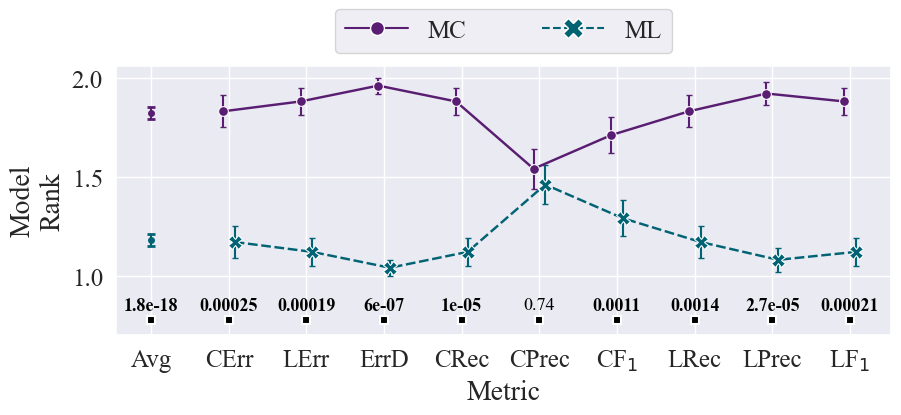

In [ ]:
xs = article_metric_names
xs_t = list(range(len(xs)))


fig, ax = plt.subplots(1, 1, figsize=(10,3.5))
df = formatted_model_ranks
df2 = overall_model_means_df
colors = [TPAL[0], TPAL[4]]

for m, mod in enumerate(model_names):
    x_off = 0.075 if m % 2 != 0 else -0.075
    df_sub = df[df[MODEL_COL] == mod].reset_index().sort_values([MET_COL], key=lambda m: m.map(metric_order))
    errors = ax.errorbar(
                x=[x+x_off for x in xs_t], y=df_sub["Mean Rank"],
                yerr=df_sub['Error'], xerr=None,
                ecolor=colors[m], elinewidth=1.5,
                color=GREY, linewidth=0.,
                capsize=2, capthick=1, zorder=1)
    lines = sns.lineplot(data=df_sub,
                x=[x+x_off for x in xs_t], y="Mean Rank",
                color=colors[m], style=MODEL_COL,
                style_order=model_style,
                markers=model_markers, markersize=marker_size[mod] // 10,
                linewidth=1.75,
                palette=CPAL, zorder=3,
                ax=ax, legend=m == 0
                )

handles = [
    Line2D([0], [0], color=colors[m],
        marker=model_markers[mod], markersize=marker_size[mod] // 7,
        markeredgecolor=WHITE,
        linestyle=model_style[mod], lw=1.5,
        label=f"{abbreviations[mod]}") for m, mod in enumerate(model_names)
]
legend = ax.legend(handles=handles, loc='lower center', bbox_to_anchor=(0.5, 1.),
                   handlelength=2.5,
                   columnspacing=3.,
                   ncols=2, fontsize=TICK_SIZE)

bold_labels = [MODEL_COL, MET_COL, TRAIN_COL]
for text in legend.get_texts():
    t = text.get_text()
    if t in bold_labels:
        text.set_fontweight('bold')
        text.set_fontsize(TICK_SIZE)
    if t in abbreviations:
        text.set_text(abbreviations[t])
        
labels = []
ticks = []
for t, label in enumerate(xs):
    tx_1 = abbreviations[label]
    labels.append(mtext.Text(t, 0, tx_1))
    ticks.append(t)

for m, mod in enumerate(model_names):
    XX = -1 #-0.95 if m % 2 != 0 else -1.05
    
    errors = ax.errorbar(
                x=[XX], y=[df2[mod]['Mean']],
                yerr=[df2[mod]['Error']], xerr=None,
                ecolor=colors[m], elinewidth=1.5,
                color=colors[m], linewidth=2,
                marker='.',
                markersize=8,
                markerfacecolor=colors[m], #markeredgewidth=1.5,
                capsize=3, capthick=2, zorder=1)
ticks.append(-1)
labels.append(mtext.Text(-1, 0, 'Avg'))

for met, x, y, sq in zip(article_metric_names + ['All'], ticks, tests_ys, sqr_ys):
    ts = model_all_stats[met] # if met in model_all_stats else model_all_stats['All']
    ax.text(x, y, f"{ts:.2}",
            horizontalalignment='center', verticalalignment='center',
            size=13, color='black', weight='semibold' if ts < 0.05 else 'normal')

    sns.scatterplot(x=[x], y=[sq], color=BLACK, linewidth=1.5, marker='s', s=40, ax=ax, legend=False)

ax.yaxis.set_major_locator(ticker.MultipleLocator(0.5, 1))
ax.set_ylabel(f"{MODEL_COL}\nRank", fontsize=LBL_SIZE)
ax.set_ylim(0.7, ax.get_ylim()[1])
ax.set_xlabel(MET_COL, fontsize=LBL_SIZE)
ax.set_xticks(ticks=ticks, labels=labels,
            #   rotation=40, ha='right', rotation_mode="anchor"
            )
ax.tick_params(axis='both', left=False, labelsize=TICK_SIZE)

#### Resampling strategies

In [105]:
ranks_df = all_results_filt.copy()
for m in article_metric_names:
    ranks_df[f"{m} Rank"] = ranks_df.groupby([MODEL_COL, EVAL_COL])[m].rank(method='min', ascending=True)
    
head_cols_rs = [EVAL_COL, MODEL_COL, TRAIN_COL]
ranks = [f"{met} Rank" for met in article_metric_names]
metrics_ranks = [
    column
    for metric in zip(article_metric_names, ranks)
    for column in metric
]

ranks_df.sort_values(head_cols_rs, inplace=True)
ranks_df = ranks_df[head_cols_rs + metrics_ranks]
ranks_df['Mean Metric Rank'] = ranks_df.apply(lambda row: row[ranks].mean(), axis=1)
ranks_df['Median Metric Rank'] = ranks_df.apply(lambda row: row[ranks].median(), axis=1)
ranks_df.head()

C:\Users\User\AppData\Local\Temp\ipykernel_27620\1529840901.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  ranks_df[f"{m} Rank"] = ranks_df.groupby([MODEL_COL, EVAL_COL])[m].rank(method='min', ascending=True)
C:\Users\User\AppData\Local\Temp\ipykernel_27620\1529840901.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  ranks_df[f"{m} Rank"] = ranks_df.groupby([MODEL_COL, EVAL_COL])[m].rank(method='min', ascending=True)
C:\Users\User\AppData\Local\Temp\ipykernel_27620\1529840901.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass

,Evaluation,Model,Resampling Scenario,Class error,Class error Rank,Label error,Label error Rank,Error distance,Error distance Rank,1 - class recall,...,1 - class F1,1 - class F1 Rank,1 - label recall,1 - label recall Rank,1 - label precision,1 - label precision Rank,1 - label F1,1 - label F1 Rank,Mean Metric Rank,Median Metric Rank
0,In-distribution,Multiclass,No Resampling,0.047354,4.0,0.010389,4.0,1.316344,4.0,0.169101,...,0.100512,4.0,0.019811,4.0,0.005430,4.0,0.012783,4.0,3.666667,4.0
5,In-distribution,Multiclass,Class Resampled,0.013648,2.0,0.002719,2.0,1.195122,1.0,0.037852,...,0.044021,1.0,0.002874,1.0,0.003345,2.0,0.003111,2.0,1.777778,2.0
10,In-distribution,Multiclass,Label Resampled,0.018309,3.0,0.003800,3.0,1.245455,3.0,0.037381,...,0.045262,2.0,0.004223,3.0,0.004325,3.0,0.004277,3.0,2.777778,3.0
15,In-distribution,Multiclass,Adaptive Resampled,0.013066,1.0,0.002608,1.0,1.197452,2.0,0.019246,...,0.048163,3.0,0.002996,2.0,0.002748,1.0,0.002874,1.0,1.777778,1.0
20,In-distribution,Multilabel,No Resampling,0.015979,3.0,0.003010,3.0,1.130208,1.0,0.039840,...,0.065471,4.0,0.005780,4.0,0.001300,1.0,0.003549,4.0,3.000000,3.0


In [106]:
ranks_df[head_cols_rs + ['Mean Metric Rank'] + ranks].sort_values(head_cols_rs[::-1])


,Evaluation,Model,Resampling Scenario,Mean Metric Rank,Class error Rank,Label error Rank,Error distance Rank,1 - class recall Rank,1 - class precision Rank,1 - class F1 Rank,1 - label recall Rank,1 - label precision Rank,1 - label F1 Rank
0,In-distribution,Multiclass,No Resampling,3.666667,4.0,4.0,4.0,4.0,1.0,4.0,4.0,4.0,4.0
1,DSBI,Multiclass,No Resampling,3.666667,4.0,4.0,1.0,4.0,4.0,4.0,4.0,4.0,4.0
6,Brightness Augmented,Multiclass,No Resampling,2.111111,2.0,2.0,3.0,3.0,1.0,1.0,3.0,1.0,3.0
6,Noise Augmented,Multiclass,No Resampling,2.666667,3.0,3.0,2.0,4.0,1.0,3.0,4.0,1.0,3.0
6,Rotation Augmented,Multiclass,No Resampling,2.555556,4.0,3.0,2.0,4.0,1.0,1.0,4.0,1.0,3.0
6,Blur Augmented,Multiclass,No Resampling,3.666667,4.0,4.0,4.0,4.0,1.0,4.0,4.0,4.0,4.0
20,In-distribution,Multilabel,No Resampling,3.000000,3.0,3.0,1.0,4.0,3.0,4.0,4.0,1.0,4.0
21,DSBI,Multilabel,No Resampling,3.000000,3.0,3.0,1.0,4.0,3.0,3.0,4.0,3.0,3.0
7,Brightness Augmented,Multilabel,No Resampling,3.222222,3.0,3.0,3.0,4.0,3.0,3.0,3.0,4.0,3.0
7,Noise Augmented,Multilabel,No Resampling,2.333333,2.0,2.0,2.0,4.0,2.0,2.0,4.0,1.0,2.0


In [107]:
ranks_df.set_index(head_cols_rs[:2])[[TRAIN_COL, 'Median Metric Rank'] + ranks].sort_values(TRAIN_COL)


,,Resampling Scenario,Median Metric Rank,Class error Rank,Label error Rank,Error distance Rank,1 - class recall Rank,1 - class precision Rank,1 - class F1 Rank,1 - label recall Rank,1 - label precision Rank,1 - label F1 Rank
Evaluation,Model,,,,,,,,,,,
In-distribution,Multiclass,No Resampling,4.0,4.0,4.0,4.0,4.0,1.0,4.0,4.0,4.0,4.0
Brightness Augmented,Multilabel,No Resampling,3.0,3.0,3.0,3.0,4.0,3.0,3.0,3.0,4.0,3.0
DSBI,Multilabel,No Resampling,3.0,3.0,3.0,1.0,4.0,3.0,3.0,4.0,3.0,3.0
Noise Augmented,Multiclass,No Resampling,3.0,3.0,3.0,2.0,4.0,1.0,3.0,4.0,1.0,3.0
Rotation Augmented,Multilabel,No Resampling,1.0,2.0,1.0,1.0,2.0,1.0,1.0,2.0,1.0,1.0
Blur Augmented,Multilabel,No Resampling,4.0,4.0,4.0,3.0,4.0,4.0,4.0,4.0,1.0,4.0
DSBI,Multiclass,No Resampling,4.0,4.0,4.0,1.0,4.0,4.0,4.0,4.0,4.0,4.0
Noise Augmented,Multilabel,No Resampling,2.0,2.0,2.0,2.0,4.0,2.0,2.0,4.0,1.0,2.0
In-distribution,Multilabel,No Resampling,3.0,3.0,3.0,1.0,4.0,3.0,4.0,4.0,1.0,4.0


In [108]:
print("MC Models Only")
display(ranks_df[ranks_df[MODEL_COL] == MC].groupby(TRAIN_COL)[ranks].agg('mean'))
print("ML Models Only")
display(ranks_df[ranks_df[MODEL_COL] == ML].groupby(TRAIN_COL)[ranks].agg('mean'))
print("All")
display(ranks_df.groupby(TRAIN_COL)[ranks].agg('mean'))

MC Models Only


C:\Users\User\AppData\Local\Temp\ipykernel_27620\3430799833.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  display(ranks_df[ranks_df[MODEL_COL] == MC].groupby(TRAIN_COL)[ranks].agg('mean'))


,Class error Rank,Label error Rank,Error distance Rank,1 - class recall Rank,1 - class precision Rank,1 - class F1 Rank,1 - label recall Rank,1 - label precision Rank,1 - label F1 Rank
Resampling Scenario,,,,,,,,,
No Resampling,3.500000,3.333333,2.666667,3.833333,1.500000,2.833333,3.833333,2.500000,3.500000
Class Resampled,2.500000,2.500000,2.333333,2.500000,2.666667,2.500000,1.666667,2.666667,2.500000
Label Resampled,2.166667,2.166667,2.500000,1.833333,3.166667,2.166667,2.333333,3.000000,2.166667
Adaptive Resampled,1.833333,2.000000,2.500000,1.833333,2.666667,2.500000,2.166667,1.833333,1.833333


ML Models Only


C:\Users\User\AppData\Local\Temp\ipykernel_27620\3430799833.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  display(ranks_df[ranks_df[MODEL_COL] == ML].groupby(TRAIN_COL)[ranks].agg('mean'))


,Class error Rank,Label error Rank,Error distance Rank,1 - class recall Rank,1 - class precision Rank,1 - class F1 Rank,1 - label recall Rank,1 - label precision Rank,1 - label F1 Rank
Resampling Scenario,,,,,,,,,
No Resampling,2.833333,2.666667,1.833333,3.666667,2.666667,2.833333,3.500000,1.833333,2.833333
Class Resampled,2.666667,2.666667,3.500000,2.166667,3.000000,2.666667,2.666667,2.333333,2.666667
Label Resampled,2.666667,2.833333,2.833333,1.833333,2.166667,2.166667,1.166667,3.833333,2.666667
Adaptive Resampled,1.833333,1.833333,1.833333,2.333333,2.166667,2.333333,2.666667,2.000000,1.833333


All


C:\Users\User\AppData\Local\Temp\ipykernel_27620\3430799833.py:6: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  display(ranks_df.groupby(TRAIN_COL)[ranks].agg('mean'))


,Class error Rank,Label error Rank,Error distance Rank,1 - class recall Rank,1 - class precision Rank,1 - class F1 Rank,1 - label recall Rank,1 - label precision Rank,1 - label F1 Rank
Resampling Scenario,,,,,,,,,
No Resampling,3.166667,3.000000,2.250000,3.750000,2.083333,2.833333,3.666667,2.166667,3.166667
Class Resampled,2.583333,2.583333,2.916667,2.333333,2.833333,2.583333,2.166667,2.500000,2.583333
Label Resampled,2.416667,2.500000,2.666667,1.833333,2.666667,2.166667,1.750000,3.416667,2.416667
Adaptive Resampled,1.833333,1.916667,2.166667,2.083333,2.416667,2.416667,2.416667,1.916667,1.833333


In [109]:
stats.sem(ranks_df[(ranks_df[MODEL_COL] == MC) & (ranks_df[TRAIN_COL] == BASE)][ranks], axis=None)

0.16384757678511896

In [110]:
print("MC Models Only")
print(f"No Resampling: {stats.sem(ranks_df[(ranks_df[MODEL_COL] == MC) & (ranks_df[TRAIN_COL] == BASE)][ranks], axis=None)}")
print(f"Class Resampling: {stats.sem(ranks_df[(ranks_df[MODEL_COL] == MC) & (ranks_df[TRAIN_COL] == CB)][ranks], axis=None)}")
print(f"Label Resampling: {stats.sem(ranks_df[(ranks_df[MODEL_COL] == MC) & (ranks_df[TRAIN_COL] == LB)][ranks], axis=None)}")
print(f"Adaptive Resampling: {stats.sem(ranks_df[(ranks_df[MODEL_COL] == MC) & (ranks_df[TRAIN_COL] == AB)][ranks], axis=None)}")
print("ML Models Only")
print(f"No Resampling: {stats.sem(ranks_df[(ranks_df[MODEL_COL] == ML) & (ranks_df[TRAIN_COL] == BASE)][ranks], axis=None)}")
print(f"Class Resampling: {stats.sem(ranks_df[(ranks_df[MODEL_COL] == ML) & (ranks_df[TRAIN_COL] == CB)][ranks], axis=None)}")
print(f"Label Resampling: {stats.sem(ranks_df[(ranks_df[MODEL_COL] == ML) & (ranks_df[TRAIN_COL] == LB)][ranks], axis=None)}")
print(f"Adaptive Resampling: {stats.sem(ranks_df[(ranks_df[MODEL_COL] == ML) & (ranks_df[TRAIN_COL] == AB)][ranks], axis=None)}")
# print("All")
# display(ranks_df.groupby('Training')[ranks].agg('mean').T)

MC Models Only
No Resampling: 0.16384757678511896
Class Resampling: 0.15549980698811688
Label Resampling: 0.14816998441448356
Adaptive Resampling: 0.11229856971713634
ML Models Only
No Resampling: 0.15228330925927308
Class Resampling: 0.13119253493496574
Label Resampling: 0.1727666979189779
Adaptive Resampling: 0.13804190847897926


In [111]:
print("MC Models Only")
display(ranks_df[ranks_df[MODEL_COL] == MC].groupby(TRAIN_COL)[ranks].agg(pd.Series.std).T.round(1))
print("ML Models Only")
display(ranks_df[ranks_df[MODEL_COL] == ML].groupby(TRAIN_COL)[ranks].agg(pd.Series.std).T.round(1))
print("All")
display(ranks_df.groupby(TRAIN_COL)[ranks].agg(pd.Series.std).T.round(1))

MC Models Only


C:\Users\User\AppData\Local\Temp\ipykernel_27620\2037408467.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  display(ranks_df[ranks_df[MODEL_COL] == MC].groupby(TRAIN_COL)[ranks].agg(pd.Series.std).T.round(1))


Resampling Scenario,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
Class error Rank,0.8,1.2,1.0,1.0
Label error Rank,0.8,1.2,1.3,0.9
Error distance Rank,1.2,1.4,1.4,0.8
1 - class recall Rank,0.4,1.2,1.0,0.4
1 - class precision Rank,1.2,0.8,0.8,1.2
1 - class F1 Rank,1.5,1.4,1.2,0.5
1 - label recall Rank,0.4,1.2,1.0,0.4
1 - label precision Rank,1.6,1.0,0.6,1.0
1 - label F1 Rank,0.5,1.2,1.3,0.8


ML Models Only


C:\Users\User\AppData\Local\Temp\ipykernel_27620\2037408467.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  display(ranks_df[ranks_df[MODEL_COL] == ML].groupby(TRAIN_COL)[ranks].agg(pd.Series.std).T.round(1))


Resampling Scenario,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
Class error Rank,0.8,1.0,1.5,1.2
Label error Rank,1.0,1.0,1.3,1.2
Error distance Rank,1.0,0.5,1.0,1.2
1 - class recall Rank,0.8,1.0,1.0,1.0
1 - class precision Rank,1.0,1.3,1.3,1.0
1 - class F1 Rank,1.2,1.0,1.5,1.0
1 - label recall Rank,0.8,1.0,0.4,0.8
1 - label precision Rank,1.3,0.5,0.4,0.9
1 - label F1 Rank,1.2,1.0,1.2,1.2


All


C:\Users\User\AppData\Local\Temp\ipykernel_27620\2037408467.py:6: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  display(ranks_df.groupby(TRAIN_COL)[ranks].agg(pd.Series.std).T.round(1))


Resampling Scenario,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
Class error Rank,0.8,1.1,1.2,1.0
Label error Rank,1.0,1.1,1.3,1.0
Error distance Rank,1.1,1.2,1.2,1.0
1 - class recall Rank,0.6,1.1,0.9,0.8
1 - class precision Rank,1.2,1.0,1.2,1.1
1 - class F1 Rank,1.3,1.2,1.3,0.8
1 - label recall Rank,0.7,1.2,1.0,0.7
1 - label precision Rank,1.5,0.8,0.7,0.9
1 - label F1 Rank,0.9,1.1,1.2,0.9


In [112]:
mean_ranks_df = {}

for ls in [
    [MC], [ML], [MC,ML]
]:
    label = ls[0] if len(ls) == 1 else "All"
    print("{} Models".format(
        label
    ))
    mean_rank = ranks_df[ranks_df[MODEL_COL].isin(ls)].groupby(TRAIN_COL)[ranks].agg(np.mean).T.round(2)    
    sterr_rank = ranks_df[ranks_df[MODEL_COL].isin(ls)].groupby(TRAIN_COL)[ranks].agg(err_func).T.round(2).rename(
        columns=lambda c: f"{c} Err"
    )
    col_list = []
    for rs in resamplings:
        col_list.append(rs)
        col_list.append(f"{rs} Err")
    df = pd.concat([mean_rank, sterr_rank], axis=1)[col_list]
    
    mean_ranks_df[label] = df
    display(df)
    print('-'*100)

Multiclass Models


C:\Users\User\AppData\Local\Temp\ipykernel_27620\1754925676.py:10: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_rank = ranks_df[ranks_df[MODEL_COL].isin(ls)].groupby(TRAIN_COL)[ranks].agg(np.mean).T.round(2)
C:\Users\User\AppData\Local\Temp\ipykernel_27620\1754925676.py:10: FutureWarning: The provided callable <function mean at 0x0000029F7EBAACA0> is currently using DataFrameGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.
  mean_rank = ranks_df[ranks_df[MODEL_COL].isin(ls)].groupby(TRAIN_COL)[ranks].agg(np.mean).T.round(2)
C:\Users\User\AppData\Local\Temp\ipykernel_27620\1754925676.py:11: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version 

Resampling Scenario,No Resampling,No Resampling Err,Class Resampled,Class Resampled Err,Label Resampled,Label Resampled Err,Adaptive Resampled,Adaptive Resampled Err
Class error Rank,3.50,0.34,2.50,0.50,2.17,0.40,1.83,0.40
Label error Rank,3.33,0.33,2.50,0.50,2.17,0.54,2.00,0.37
Error distance Rank,2.67,0.49,2.33,0.56,2.50,0.56,2.50,0.34
1 - class recall Rank,3.83,0.17,2.50,0.50,1.83,0.40,1.83,0.17
1 - class precision Rank,1.50,0.50,2.67,0.33,3.17,0.31,2.67,0.49
1 - class F1 Rank,2.83,0.60,2.50,0.56,2.17,0.48,2.50,0.22
1 - label recall Rank,3.83,0.17,1.67,0.49,2.33,0.42,2.17,0.17
1 - label precision Rank,2.50,0.67,2.67,0.42,3.00,0.26,1.83,0.40
1 - label F1 Rank,3.50,0.22,2.50,0.50,2.17,0.54,1.83,0.31


----------------------------------------------------------------------------------------------------
Multilabel Models


C:\Users\User\AppData\Local\Temp\ipykernel_27620\1754925676.py:10: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_rank = ranks_df[ranks_df[MODEL_COL].isin(ls)].groupby(TRAIN_COL)[ranks].agg(np.mean).T.round(2)
C:\Users\User\AppData\Local\Temp\ipykernel_27620\1754925676.py:10: FutureWarning: The provided callable <function mean at 0x0000029F7EBAACA0> is currently using DataFrameGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.
  mean_rank = ranks_df[ranks_df[MODEL_COL].isin(ls)].groupby(TRAIN_COL)[ranks].agg(np.mean).T.round(2)
C:\Users\User\AppData\Local\Temp\ipykernel_27620\1754925676.py:11: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version 

Resampling Scenario,No Resampling,No Resampling Err,Class Resampled,Class Resampled Err,Label Resampled,Label Resampled Err,Adaptive Resampled,Adaptive Resampled Err
Class error Rank,2.83,0.31,2.67,0.42,2.67,0.61,1.83,0.48
Label error Rank,2.67,0.42,2.67,0.42,2.83,0.54,1.83,0.48
Error distance Rank,1.83,0.40,3.50,0.22,2.83,0.40,1.83,0.48
1 - class recall Rank,3.67,0.33,2.17,0.40,1.83,0.40,2.33,0.42
1 - class precision Rank,2.67,0.42,3.00,0.52,2.17,0.54,2.17,0.40
1 - class F1 Rank,2.83,0.48,2.67,0.42,2.17,0.60,2.33,0.42
1 - label recall Rank,3.50,0.34,2.67,0.42,1.17,0.17,2.67,0.33
1 - label precision Rank,1.83,0.54,2.33,0.21,3.83,0.17,2.00,0.37
1 - label F1 Rank,2.83,0.48,2.67,0.42,2.67,0.49,1.83,0.48


----------------------------------------------------------------------------------------------------
All Models


C:\Users\User\AppData\Local\Temp\ipykernel_27620\1754925676.py:10: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_rank = ranks_df[ranks_df[MODEL_COL].isin(ls)].groupby(TRAIN_COL)[ranks].agg(np.mean).T.round(2)
C:\Users\User\AppData\Local\Temp\ipykernel_27620\1754925676.py:10: FutureWarning: The provided callable <function mean at 0x0000029F7EBAACA0> is currently using DataFrameGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.
  mean_rank = ranks_df[ranks_df[MODEL_COL].isin(ls)].groupby(TRAIN_COL)[ranks].agg(np.mean).T.round(2)
C:\Users\User\AppData\Local\Temp\ipykernel_27620\1754925676.py:11: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version 

Resampling Scenario,No Resampling,No Resampling Err,Class Resampled,Class Resampled Err,Label Resampled,Label Resampled Err,Adaptive Resampled,Adaptive Resampled Err
Class error Rank,3.17,0.24,2.58,0.31,2.42,0.36,1.83,0.30
Label error Rank,3.00,0.28,2.58,0.31,2.50,0.38,1.92,0.29
Error distance Rank,2.25,0.33,2.92,0.34,2.67,0.33,2.17,0.30
1 - class recall Rank,3.75,0.18,2.33,0.31,1.83,0.27,2.08,0.23
1 - class precision Rank,2.08,0.36,2.83,0.30,2.67,0.33,2.42,0.31
1 - class F1 Rank,2.83,0.37,2.58,0.34,2.17,0.37,2.42,0.23
1 - label recall Rank,3.67,0.19,2.17,0.34,1.75,0.28,2.42,0.19
1 - label precision Rank,2.17,0.42,2.50,0.23,3.42,0.19,1.92,0.26
1 - label F1 Rank,3.17,0.27,2.58,0.31,2.42,0.36,1.83,0.27


----------------------------------------------------------------------------------------------------


In [113]:
print("MC Models Only")
display(ranks_df[ranks_df[MODEL_COL] == MC].groupby(TRAIN_COL)[ranks].agg('median'))
print("ML Models Only")
display(ranks_df[ranks_df[MODEL_COL] == ML].groupby(TRAIN_COL)[ranks].agg('median'))
print("All")
display(ranks_df.groupby(TRAIN_COL)[ranks].agg('median'))

MC Models Only


C:\Users\User\AppData\Local\Temp\ipykernel_27620\2748187739.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  display(ranks_df[ranks_df[MODEL_COL] == MC].groupby(TRAIN_COL)[ranks].agg('median'))


,Class error Rank,Label error Rank,Error distance Rank,1 - class recall Rank,1 - class precision Rank,1 - class F1 Rank,1 - label recall Rank,1 - label precision Rank,1 - label F1 Rank
Resampling Scenario,,,,,,,,,
No Resampling,4.0,3.5,2.5,4.0,1.0,3.5,4.0,2.5,3.5
Class Resampled,2.0,2.0,2.0,3.0,2.5,2.5,1.0,2.0,2.0
Label Resampled,2.5,2.0,2.5,1.5,3.0,2.0,3.0,3.0,2.0
Adaptive Resampled,1.5,2.0,3.0,2.0,2.5,2.5,2.0,1.5,2.0


ML Models Only


C:\Users\User\AppData\Local\Temp\ipykernel_27620\2748187739.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  display(ranks_df[ranks_df[MODEL_COL] == ML].groupby(TRAIN_COL)[ranks].agg('median'))


,Class error Rank,Label error Rank,Error distance Rank,1 - class recall Rank,1 - class precision Rank,1 - class F1 Rank,1 - label recall Rank,1 - label precision Rank,1 - label F1 Rank
Resampling Scenario,,,,,,,,,
No Resampling,3.0,3.0,1.5,4.0,3.0,3.0,4.0,1.0,3.0
Class Resampled,3.0,3.0,3.5,2.5,3.5,3.0,3.0,2.0,3.0
Label Resampled,3.0,3.0,2.5,1.5,2.0,1.5,1.0,4.0,2.5
Adaptive Resampled,1.5,1.5,1.5,2.0,2.0,2.0,2.5,2.0,1.5


All


C:\Users\User\AppData\Local\Temp\ipykernel_27620\2748187739.py:6: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  display(ranks_df.groupby(TRAIN_COL)[ranks].agg('median'))


,Class error Rank,Label error Rank,Error distance Rank,1 - class recall Rank,1 - class precision Rank,1 - class F1 Rank,1 - label recall Rank,1 - label precision Rank,1 - label F1 Rank
Resampling Scenario,,,,,,,,,
No Resampling,3.0,3.0,2.0,4.0,1.5,3.0,4.0,1.0,3.0
Class Resampled,2.5,2.5,3.0,3.0,3.0,3.0,2.0,2.0,2.5
Label Resampled,2.5,2.5,2.5,1.5,3.0,2.0,1.0,3.5,2.5
Adaptive Resampled,1.5,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0


In [114]:
overall_means_df = {}

for ls in [
    [MC], [ML], [MC,ML]
]:
    label = ls[0] if len(ls) == 1 else "All"
    print("{} Models".format(
        label
    ))
    df = pd.DataFrame(columns=[TRAIN_COL, "Mean", "Error"])
    for g, group in ranks_df[ranks_df[MODEL_COL].isin(ls)].groupby(TRAIN_COL)[ranks]:
        m = group.mean(axis=None)
        s = err_func(group.to_numpy(), axis=None)
        df.loc[df.shape[0]] = [g, m, s]
    df = df.set_index(TRAIN_COL).T.round(2)
    overall_means_df[label] = df
    display(df)
    print('-'*100)

Multiclass Models


C:\Users\User\AppData\Local\Temp\ipykernel_27620\3021580125.py:11: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  for g, group in ranks_df[ranks_df[MODEL_COL].isin(ls)].groupby(TRAIN_COL)[ranks]:


Resampling Scenario,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
Mean,3.06,2.43,2.39,2.13
Error,0.16,0.16,0.15,0.11


----------------------------------------------------------------------------------------------------
Multilabel Models


C:\Users\User\AppData\Local\Temp\ipykernel_27620\3021580125.py:11: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  for g, group in ranks_df[ranks_df[MODEL_COL].isin(ls)].groupby(TRAIN_COL)[ranks]:


Resampling Scenario,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
Mean,2.74,2.70,2.46,2.09
Error,0.15,0.13,0.17,0.14


----------------------------------------------------------------------------------------------------
All Models


C:\Users\User\AppData\Local\Temp\ipykernel_27620\3021580125.py:11: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  for g, group in ranks_df[ranks_df[MODEL_COL].isin(ls)].groupby(TRAIN_COL)[ranks]:


Resampling Scenario,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
Mean,2.90,2.56,2.43,2.11
Error,0.11,0.10,0.11,0.09


----------------------------------------------------------------------------------------------------


In [115]:
print("MC Models Only")
display(ranks_df[ranks_df[MODEL_COL] == MC].groupby(TRAIN_COL)['Mean Metric Rank'].agg('mean'))
print("ML Models Only")
display(ranks_df[ranks_df[MODEL_COL] == ML].groupby(TRAIN_COL)['Mean Metric Rank'].agg('mean'))
print("All")
display(ranks_df.groupby(TRAIN_COL)['Mean Metric Rank'].agg('mean'))

MC Models Only


C:\Users\User\AppData\Local\Temp\ipykernel_27620\162184613.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  display(ranks_df[ranks_df[MODEL_COL] == MC].groupby(TRAIN_COL)['Mean Metric Rank'].agg('mean'))


Resampling Scenario
No Resampling         3.055556
Class Resampled       2.425926
Label Resampled       2.388889
Adaptive Resampled    2.129630
Name: Mean Metric Rank, dtype: float64

ML Models Only


C:\Users\User\AppData\Local\Temp\ipykernel_27620\162184613.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  display(ranks_df[ranks_df[MODEL_COL] == ML].groupby(TRAIN_COL)['Mean Metric Rank'].agg('mean'))


Resampling Scenario
No Resampling         2.740741
Class Resampled       2.703704
Label Resampled       2.462963
Adaptive Resampled    2.092593
Name: Mean Metric Rank, dtype: float64

All


C:\Users\User\AppData\Local\Temp\ipykernel_27620\162184613.py:6: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  display(ranks_df.groupby(TRAIN_COL)['Mean Metric Rank'].agg('mean'))


Resampling Scenario
No Resampling         2.898148
Class Resampled       2.564815
Label Resampled       2.425926
Adaptive Resampled    2.111111
Name: Mean Metric Rank, dtype: float64

In [116]:
ranks_df.groupby(TRAIN_COL)['Median Metric Rank'].agg('mean')

C:\Users\User\AppData\Local\Temp\ipykernel_27620\1465202074.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  ranks_df.groupby(TRAIN_COL)['Median Metric Rank'].agg('mean')


Resampling Scenario
No Resampling         3.000000
Class Resampled       2.583333
Label Resampled       2.416667
Adaptive Resampled    1.916667
Name: Median Metric Rank, dtype: float64

In [117]:
formatted_ranks_df = {}
for d, df in mean_ranks_df.items():
    df = df.rename_axis(index=MET_COL).reset_index()
    df[MET_COL] = df[MET_COL].apply(lambda met: met.split(' Rank')[0])
    form_df = pd.concat([df.melt(id_vars=[MET_COL],
                      value_vars=resamplings,
                      value_name='Mean Rank').set_index([MET_COL]),
                    df.melt(id_vars=[MET_COL],
                      value_vars=[f"{rs} Err" for rs in resamplings],
                      value_name='Error').set_index([MET_COL])["Error"]], axis=1)
    display(form_df.head())
    formatted_ranks_df[d] = form_df

,Resampling Scenario,Mean Rank,Error
Metric,,,
Class error,No Resampling,3.50,0.34
Label error,No Resampling,3.33,0.33
Error distance,No Resampling,2.67,0.49
1 - class recall,No Resampling,3.83,0.17
1 - class precision,No Resampling,1.50,0.50


,Resampling Scenario,Mean Rank,Error
Metric,,,
Class error,No Resampling,2.83,0.31
Label error,No Resampling,2.67,0.42
Error distance,No Resampling,1.83,0.40
1 - class recall,No Resampling,3.67,0.33
1 - class precision,No Resampling,2.67,0.42


,Resampling Scenario,Mean Rank,Error
Metric,,,
Class error,No Resampling,3.17,0.24
Label error,No Resampling,3.00,0.28
Error distance,No Resampling,2.25,0.33
1 - class recall,No Resampling,3.75,0.18
1 - class precision,No Resampling,2.08,0.36


In [142]:
resample_all_stats.keys()

dict_keys(['Class error', 'Label error', 'Error distance', '1 - class recall', '1 - class precision', '1 - class F1', '1 - label recall', '1 - label precision', '1 - label F1', 'error', 'class', 'label', 'All'])

In [147]:
stats_tests = {
    'All': [resample_all_stats['All'][0]] + [
        resample_all_stats[met][0] for met in article_metric_names],
    MC: [resample_mc_stats['All'][0], resample_mc_stats['error'][0], resample_mc_stats['class'][0], resample_mc_stats['label'][0]],
    ML: [resample_ml_stats['All'][0], resample_ml_stats['error'][0], resample_ml_stats['class'][0], resample_ml_stats['label'][0]]
}

tests_xs = [-1, 1, 4, 7]
tests_xs_all = [-1] + list(range(9))
tests_lines_xs = [
    [-1,-1],
    [0,2],
    [3,5],
    [6,8]
]
tests_lines_xs_all = [[x,x] for x in tests_xs_all]
tests_ys = 0.85
tests_lines_ys = [0.7]*2

stats_tests

{'All': [0.00012151040342188536,
  0.08966250398816791,
  0.2308387482088751,
  0.44022729436022834,
  0.0011887906933325822,
  0.5125209069771435,
  0.6369337956527357,
  0.0020918236196081825,
  0.02555702810722494,
  0.08966250398816791],
 'Multiclass': [0.0017977566794674291,
  0.07189777249646509,
  0.8012519569012009,
  0.015454827216857907],
 'Multilabel': [0.03441147779443683,
  0.05033109785985302,
  0.10530042407332542,
  0.6149349357825349]}

In [344]:
formatted_ranks_df.keys()

dict_keys(['Multiclass', 'Multilabel', 'All'])

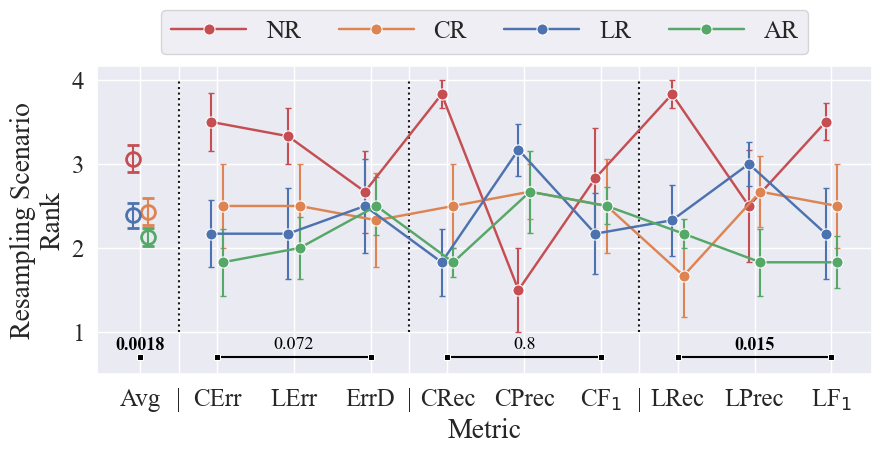

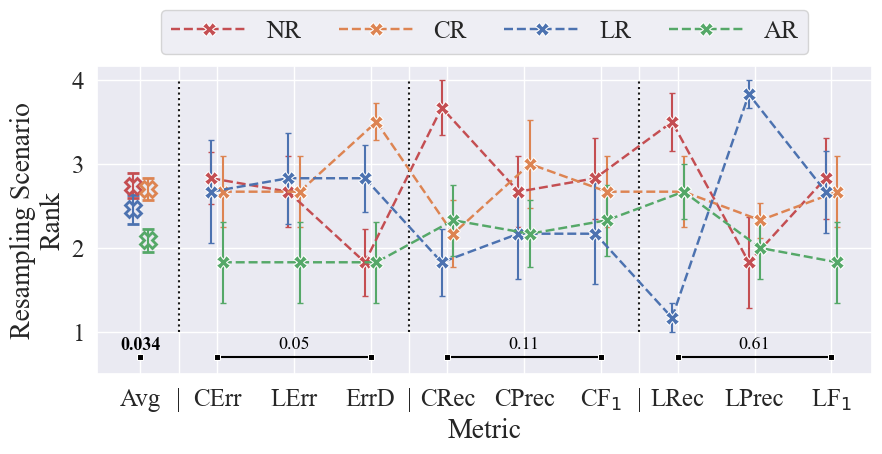

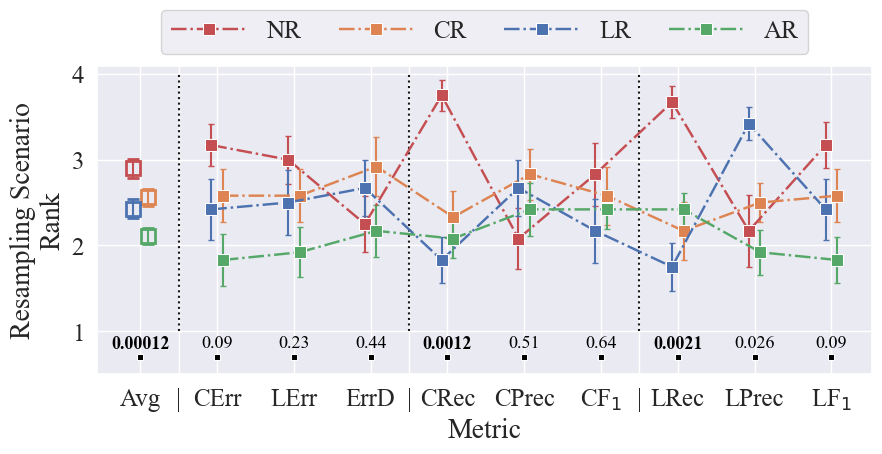

In [345]:
xs = article_metric_names
xs_t = list(range(len(xs)))

hl = 3.
cg = 1.5

for key in formatted_ranks_df.keys():
    fig, ax = plt.subplots(1, 1, figsize=(10,4))
    df = formatted_ranks_df[key]
    df2 = overall_means_df[key]
    df[MODEL_COL] = key
    sts = stats_tests[key]
    sts_x = tests_xs_all if key == 'All' else tests_xs
    sts_x_ln = tests_lines_xs_all if key == 'All' else tests_lines_xs
    ap = sidak_adjust_alpha(0.05, len(sts)-1)

    ms = marker_size_small[key] if key in marker_size_small else 8
    for rs, resam in enumerate(resamplings):
        x_off = 0.075 if rs % 2 != 0 else -0.075
        df_sub = df[df[TRAIN_COL] == resam].reset_index().sort_values([MET_COL], key=lambda m: m.map(metric_order))
        errors = ax.errorbar(
                    x=[x+x_off for x in xs_t], y=df_sub["Mean Rank"],
                    yerr=df_sub['Error'], xerr=None,
                    ecolor=CPAL[rs], elinewidth=1.5,
                    color=GREY, linewidth=0.,
                    capsize=2, capthick=1, zorder=1)
        lines = sns.lineplot(data=df_sub,
                    x=[x+x_off for x in xs_t], y="Mean Rank",
                    hue=TRAIN_COL, hue_order=training_color,
                    linestyle=model_style[key] if key in model_style else '-.', linewidth=1.75,
                    marker=model_markers[key] if key in model_markers else 's',
                    markersize=ms,
                    palette=CPAL, zorder=3,
                    ax=ax, legend=rs==0
                    )

    handles, labels = ax.get_legend_handles_labels()
    legend = ax.legend(handles=handles, loc='lower center', bbox_to_anchor=(0.5, 1.),
                       handlelength=hl, columnspacing=cg,
                       ncols=4, fontsize=TICK_SIZE)

    bold_labels = [MODEL_COL, MET_COL, TRAIN_COL]
    for text in legend.get_texts():
        t = text.get_text()
        if t in bold_labels:
            text.set_fontweight('bold')
            text.set_fontsize(TICK_SIZE)
        if t in abbreviations:
            text.set_text(abbreviations[t])
            
    labels = []
    ticks = []
    for t, label in enumerate(xs):
        tx_1 = abbreviations[label]
        labels.append(mtext.Text(t, 0, tx_1))
        ticks.append(t)

    for rs, resam in enumerate(resamplings):
        XX = -0.9 if rs % 2 != 0 else -1.1
        
        errors = ax.errorbar(
                    x=[XX], y=[df2[resam]['Mean']],
                    yerr=[df2[resam]['Error']], xerr=None,
                    ecolor=CPAL[rs], elinewidth=1.5,
                    color=CPAL[rs], linewidth=2,
                    marker=model_markers[key] if key in model_markers else 's',
                    markersize=ms + 2,
                    markeredgecolor=CPAL[rs], markerfacecolor='none',markeredgewidth=2,
                    capsize=4, capthick=2, zorder=1)
    ticks.append(-1)
    labels.append(mtext.Text(-1, 0, 'Avg'))
    
    ticks = ticks + [-0.5, 2.5, 5.5]
    labels = labels + ["|", "|", "|"]
    
    for ts, x in zip(sts, sts_x):
        a = alpha if x == -1 else ap
        ax.text(x, tests_ys, f"{ts:.2}",
                horizontalalignment='center', verticalalignment='center',
                size=13, color='black', weight='semibold' if ts < a else 'normal')
        
    for x in sts_x_ln:
        sns.lineplot(x=x, y=tests_lines_ys, color=BLACK, linewidth=1.5, marker='s', markersize=5, ax=ax, legend=False)

    yl = ax.get_ylim()[1]
    ax.set_ylim(0.5, yl)
    ax.axvline(x=-0.5, ymin=0.5/(yl-0.5), ymax=3.5/(yl-0.5), color=BLACK, alpha=0.9,
                 linestyle=':', linewidth=1.5, zorder=1)
    ax.axvline(x=2.5, ymin=0.5/(yl-0.5), ymax=3.5/(yl-0.5), color=BLACK, alpha=0.9,
                 linestyle=':', linewidth=1.5, zorder=1)
    ax.axvline(x=5.5, ymin=0.5/(yl-0.5), ymax=3.5/(yl-0.5), color=BLACK, alpha=0.9,
                 linestyle=':', linewidth=1.5, zorder=1)

    ax.yaxis.set_major_locator(ticker.MultipleLocator(1, 1))
    ax.set_ylabel(f"{TRAIN_COL}\nRank", fontsize=LBL_SIZE)
    ax.set_xlabel(MET_COL, fontsize=LBL_SIZE)
    ax.set_xticks(ticks=ticks, labels=labels,
                #   rotation=40, ha='right', rotation_mode="anchor"
                )
    ax.tick_params(axis='both', left=False, labelsize=TICK_SIZE)
    subtit = f"_{abbreviations[key]}" if key in abbreviations else ""
    plt.savefig(os.path.join(PLOT_EVALS, f'resampling_ranks{subtit}.pdf'), bbox_inches='tight')

NameError: name 'stats_tests' is not defined

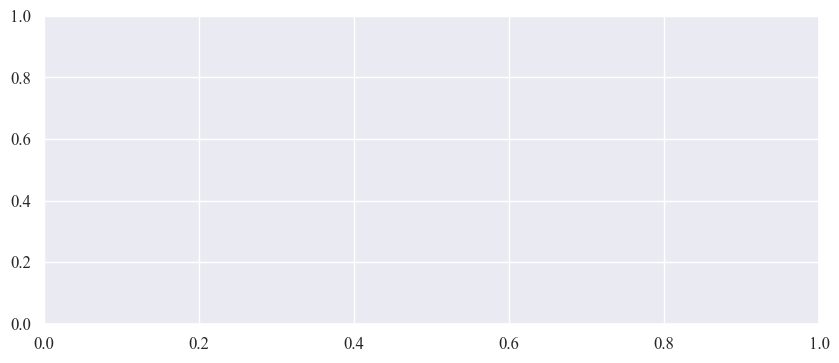

In [120]:

for key in formatted_ranks_df.keys():
    fig, ax = plt.subplots(1, 1, figsize=(10,4))
    df = formatted_ranks_df[key]
    df2 = overall_means_df[key]
    df[MODEL_COL] = key
    sts = stats_tests[key]

    ms = marker_size[key] // 10 if key in marker_size else 7
    for rs, resam in enumerate(resamplings):
        x_off = 0.075 if rs % 2 != 0 else -0.075
        df_sub = df[df[TRAIN_COL] == resam].reset_index().sort_values([MET_COL], key=lambda m: m.map(metric_order))
        errors = ax.errorbar(
                    x=[x+x_off for x in xs_t], y=df_sub["Mean Rank"],
                    yerr=df_sub['Error'], xerr=None,
                    ecolor=CPAL[rs], elinewidth=1.5,
                    color=GREY, linewidth=0.,
                    capsize=2, capthick=1, zorder=1)
        lines = sns.lineplot(data=df_sub,
                    x=[x+x_off for x in xs_t], y="Mean Rank",
                    hue=TRAIN_COL, hue_order=training_color,
                    linestyle=model_style[key] if key in model_style else '-.', linewidth=1.75,
                    marker=model_markers[key] if key in model_markers else 's',
                    markersize=ms,
                    palette=CPAL, zorder=3,
                    ax=ax, legend=rs==0
                    )

    handles, labels = ax.get_legend_handles_labels()
    legend = ax.legend(handles=handles, loc='lower center', bbox_to_anchor=(0.5, 1.), ncols=4, fontsize=TICK_SIZE)

    bold_labels = [MODEL_COL, MET_COL, TRAIN_COL]
    for text in legend.get_texts():
        t = text.get_text()
        if t in bold_labels:
            text.set_fontweight('bold')
            text.set_fontsize(TICK_SIZE)
        if t in abbreviations:
            text.set_text(abbreviations[t])
            
    labels = []
    ticks = []
    for t, label in enumerate(xs):
        tx_1 = abbreviations[label]
        labels.append(mtext.Text(t, 0, tx_1))
        ticks.append(t)

    for rs, resam in enumerate(resamplings):
        XX = -0.9 if rs % 2 != 0 else -1.1
        
        errors = ax.errorbar(
                    x=[XX], y=[df2[resam]['Mean']],
                    yerr=[df2[resam]['Error']], xerr=None,
                    ecolor=CPAL[rs], elinewidth=1.5,
                    color=CPAL[rs], linewidth=2,
                    marker=model_markers[key] if key in model_markers else 's',
                    markersize=ms + 5,
                    markeredgecolor=CPAL[rs], markerfacecolor='none',markeredgewidth=2,
                    capsize=4, capthick=2, zorder=1)
    ticks.append(-1)
    labels.append(mtext.Text(-1, 0, 'Avg'))
    
    for ts, x in zip(sts, tests_xs):
        a = alpha if x == -1 else ap
        ax.text(x, tests_ys, f"{ts:.2}",
                horizontalalignment='center', verticalalignment='center',
                size=13, color='black', weight='semibold' if ts < a else 'normal')
        
    for x in tests_lines_xs:
        sns.lineplot(x=x, y=tests_lines_ys, color=BLACK, linewidth=1.5, marker='s', markersize=5, ax=ax, legend=False)

    ax.yaxis.set_major_locator(ticker.MultipleLocator(1, 1))
    ax.set_ylabel(f"{TRAIN_COL}\nRank", fontsize=LBL_SIZE)
    ax.set_ylim(0.5, ax.get_ylim()[1])
    ax.set_xlabel(MET_COL, fontsize=LBL_SIZE)
    ax.set_xticks(ticks=ticks, labels=labels,
                #   rotation=40, ha='right', rotation_mode="anchor"
                )
    ax.tick_params(axis='both', left=False, labelsize=TICK_SIZE)

### Per class / label results

In [79]:
pc_metrics = article_metric_names[3:6]
pc_metrics

['1 - class recall', '1 - class precision', '1 - class F1']

#### Setup

In [80]:
per_class_results_ood = per_class_results[per_class_results[EVAL_COL] == DSBI].set_index(
    head_cols
)#[['Class'] + pc_metrics]

per_class_results_ood.head()

Class  1 - class recall  \
Evaluation Resampling Scenario Model                                 
DSBI       No Resampling       Multiclass      0               NaN   
                               Multiclass      1          0.011807   
                               Multiclass      2          0.129630   
                               Multiclass      3          0.018551   
                               Multiclass      4          0.515152   

                                           1 - class precision  1 - class F1  
Evaluation Resampling Scenario Model                                          
DSBI       No Resampling       Multiclass                  NaN           NaN  
                               Multiclass             0.262873      0.155607  
                               Multiclass             0.120125      0.124903  
                               Multiclass             0.258344      0.155133  
                               Multiclass             0.000000      0.346939

In [92]:
class_freqs = pd.DataFrame()
class_freqs.index.name = 'Class'
class_freqs['Percent of Train set'] = train_Y_cat.sum(axis=0) / train_Y.shape[0] * 100
class_freqs['Rank in Train set'] = class_freqs.sort_values('Percent of Train set', ascending=False).reset_index().sort_values('Class').index + 1
class_freqs['Percent of Test set'] = test_Y_cat.sum(axis=0) / test_Y.shape[0] * 100
class_freqs['Rank in Test set'] = class_freqs.sort_values('Percent of Test set', ascending=False).reset_index().sort_values('Class').index + 1
class_freqs['Percent of OOD set'] = dsbi_Y_cat.sum(axis=0) / dsbi_Y.shape[0] * 100
class_freqs['Rank in OOD set'] = class_freqs.sort_values('Percent of OOD set', ascending=False).reset_index().sort_values('Class').index + 1

class_freqs.head()

,Percent of Train set,Rank in Train set,Percent of Test set,Rank in Test set,Percent of OOD set,Rank in OOD set
Class,,,,,,
0,0.000000,64,0.000000,64,0.000000,64
1,8.217477,2,7.723036,2,2.413045,13
2,2.090462,16,2.097204,16,1.420212,26
3,1.824823,20,1.797603,21,2.480987,12
4,0.093840,48,0.024967,53,1.808140,16


In [93]:
per_class_average_ood = per_class_results_ood.groupby('Class').agg('mean').reset_index()
per_class_average_ood.head()

,Class,1 - class recall,1 - class precision,1 - class F1
0,0,NaN,1.000000,NaN
1,1,0.032584,0.048268,0.043057
2,2,0.065972,0.084973,0.083355
3,3,0.022085,0.040932,0.033676
4,4,0.206970,0.006085,0.128128


In [94]:
for metric in pc_metrics:
    asc = True
    per_class_average_ood[f"{metric} Rank"] = per_class_average_ood.sort_values(
        metric, ascending=asc).reset_index().sort_values('Class').index
per_class_average_ood.head()

,Class,1 - class recall,1 - class precision,1 - class F1,1 - class recall Rank,1 - class precision Rank,1 - class F1 Rank
0,0,NaN,1.000000,NaN,63,63,63
1,1,0.032584,0.048268,0.043057,22,26,16
2,2,0.065972,0.084973,0.083355,40,42,38
3,3,0.022085,0.040932,0.033676,12,20,6
4,4,0.206970,0.006085,0.128128,58,2,50


In [95]:
def get_ordering(df, metric):
    asc = True
    ordering = list(
        df.sort_values(
        metric, ascending=asc).reset_index(drop=True).sort_values('Class').index
    )
    # df[f"{metric} Ordering"] = ordering
    order_df = pd.DataFrame({'Class': range(NUM_CLASSES), f"{metric} Ordering": ordering}).set_index('Class')
    return order_df

In [96]:
per_class_results_ood_ordered = per_class_results_ood.reset_index()
for metric in pc_metrics:
    per_class_results_ood_ordered = pd.concat([per_class_results_ood_ordered.set_index(head_cols + ['Class']),
           per_class_results_ood_ordered.reset_index().groupby(head_cols).apply(get_ordering, metric=metric)
        ], axis=1).reset_index()
per_class_results_ood_ordered = per_class_results_ood_ordered.set_index(head_cols)
per_class_results_ood_ordered.head()

C:\Users\User\AppData\Local\Temp\ipykernel_7932\829146589.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  per_class_results_ood_ordered.reset_index().groupby(head_cols).apply(get_ordering, metric=metric)
C:\Users\User\AppData\Local\Temp\ipykernel_7932\829146589.py:4: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  per_class_results_ood_ordered.reset_index().groupby(head_cols).apply(get_ordering, metric=metric)
C:\Users\User\AppData\Local\Temp\ipykernel_7932\829146589.py:4: FutureWarning: The default of obs

Class  1 - class recall  \
Evaluation Resampling Scenario Model                                 
DSBI       No Resampling       Multiclass      0               NaN   
                               Multiclass      1          0.011807   
                               Multiclass      2          0.129630   
                               Multiclass      3          0.018551   
                               Multiclass      4          0.515152   

                                           1 - class precision  1 - class F1  \
Evaluation Resampling Scenario Model                                           
DSBI       No Resampling       Multiclass                  NaN           NaN   
                               Multiclass             0.262873      0.155607   
                               Multiclass             0.120125      0.124903   
                               Multiclass             0.258344      0.155133   
                               Multiclass             0.000000      0.346939   

                                           1 - class recall Ordering  \
Evaluation Resampling Scenario Model                                   
DSBI       No Resampling       Multiclass                         63   
                               Multiclass                         12   
                               Multiclass                         35   
                               Multiclass                         15   
                               Multiclass                         51   

                                           1 - class precision Ordering  \
Evaluation Resampling Scenario Model                                      
DSBI       No Resampling       Multiclass                            59   
                               Multiclass                            43   
                               Multiclass                            31   
                               Multiclass                            42   
                               Multiclass                             1   

                                           1 - class F1 Ordering  
Evaluation Resampling Scenario Model                              
DSBI       No Resampling       Multiclass                     59  
                               Multiclass                     25  
                               Multiclass                     22  
                               Multiclass                     24  
                               Multiclass                     43

In [97]:
class_freqs.sort_values('Rank in Train set', ascending=True).head(20)

,Percent of Train set,Rank in Train set,Percent of Test set,Rank in Test set,Percent of OOD set,Rank in OOD set
Class,,,,,,
21,8.744424,1,8.538615,1,1.538563,22
1,8.217477,2,7.723036,2,2.413045,13
17,6.887840,3,7.082224,3,1.477196,25
10,6.025958,4,6.150133,4,3.644772,7
30,5.367635,5,5.218043,5,1.571438,21
29,4.909986,6,5.051598,6,0.832840,45
14,4.134725,7,4.161119,8,0.784623,46
7,4.087083,8,4.036285,9,2.031692,15
5,4.072646,9,4.285952,7,1.483771,24


In [98]:
train_Y_cat.sum(axis=0)[16]

7

In [99]:
dsbi_Y_cat.sum(axis=0)[16]

3639

In [100]:
len(dsbi_Y_cat) * 0.08

3650.16

In [101]:
minority_classes = class_freqs.sort_values('Rank in Train set', ascending=True)[class_freqs['Percent of Train set'] < 0.1][
    ["Percent of Train set", "Rank in Train set", "Percent of OOD set", "Rank in OOD set"]
].rename(columns={
    "Percent of Train set": "Class Frequency",
    "Rank in Train set": "Class Rank",
    "Percent of OOD set": "OOD Frequency",
    "Rank in OOD set": "OOD Rank"
    }).drop(0)
minority_classes.replace({64: 63})
minority_classes

C:\Users\User\AppData\Local\Temp\ipykernel_7932\2271073937.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  minority_classes = class_freqs.sort_values('Rank in Train set', ascending=True)[class_freqs['Percent of Train set'] < 0.1][


,Class Frequency,Class Rank,OOD Frequency,OOD Rank
Class,,,,
28,0.096727,47,1.367611,29
4,0.093840,48,1.808140,16
35,0.070741,49,0.863524,44
32,0.067853,50,0.451487,56
8,0.067853,51,0.681614,48
48,0.056304,52,1.402678,27
55,0.047642,53,1.041050,41
6,0.043311,54,3.776273,5
44,0.027430,55,0.922699,43


In [102]:
majority_classes = class_freqs.sort_values('Rank in Train set', ascending=True)[class_freqs['Percent of Train set'] > 1.9][
    ["Percent of Train set", "Rank in Train set", "Percent of OOD set", "Rank in OOD set"]
].rename(columns={
    "Percent of Train set": "Class Frequency",
    "Rank in Train set": "Class Rank",
    "Percent of OOD set": "OOD Frequency",
    "Rank in OOD set": "OOD Rank"
    })
majority_classes

C:\Users\User\AppData\Local\Temp\ipykernel_7932\2622798468.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  majority_classes = class_freqs.sort_values('Rank in Train set', ascending=True)[class_freqs['Percent of Train set'] > 1.9][


,Class Frequency,Class Rank,OOD Frequency,OOD Rank
Class,,,,
21,8.744424,1,1.538563,22
1,8.217477,2,2.413045,13
17,6.887840,3,1.477196,25
10,6.025958,4,3.644772,7
30,5.367635,5,1.571438,21
29,4.909986,6,0.832840,45
14,4.134725,7,0.784623,46
7,4.087083,8,2.031692,15
5,4.072646,9,1.483771,24


In [103]:
display(minority_classes.index)
display(majority_classes.index)

Index([28, 4, 35, 32, 8, 48, 55, 6, 44, 12, 39, 16, 20, 61, 57, 59, 41], dtype='int64', name='Class')

Index([21, 1, 17, 10, 30, 29, 14, 7, 5, 23, 58, 25, 13, 37, 15, 2, 50], dtype='int64', name='Class')

In [104]:
dsbi_Y_cat.sum(axis=0)[40]

2

In [105]:
class_freqs[~(class_freqs.index.isin(minority_classes.index) | class_freqs.index.isin(majority_classes.index))]

,Percent of Train set,Rank in Train set,Percent of Test set,Rank in Test set,Percent of OOD set,Rank in OOD set
Class,,,,,,
0,0.000000,64,0.000000,64,0.000000,64
3,1.824823,20,1.797603,21,2.480987,12
9,0.548602,32,0.607523,33,1.126526,35
11,0.330605,36,0.266312,38,1.764306,17
18,0.921074,30,1.198402,28,4.074342,3
19,0.847445,31,0.898802,30,4.157626,2
22,0.542827,33,0.491012,35,1.056392,38
24,0.435994,35,0.740679,31,0.258619,61
26,1.248791,28,1.198402,27,1.052009,40


In [106]:
per_class_results_ood

Class  1 - class recall  \
Evaluation Resampling Scenario Model                                 
DSBI       No Resampling       Multiclass      0               NaN   
                               Multiclass      1          0.011807   
                               Multiclass      2          0.129630   
                               Multiclass      3          0.018551   
                               Multiclass      4          0.515152   
...                                          ...               ...   
           Adaptive Resampled  Multilabel     59          0.021661   
                               Multilabel     60          0.018827   
                               Multilabel     61          0.021739   
                               Multilabel     62          0.021053   
                               Multilabel     63          0.023810   

                                           1 - class precision  1 - class F1  
Evaluation Resampling Scenario Model                                          
DSBI       No Resampling       Multiclass                  NaN           NaN  
                               Multiclass             0.262873      0.155607  
                               Multiclass             0.120125      0.124903  
                               Multiclass             0.258344      0.155133  
                               Multiclass             0.000000      0.346939  
...                                                        ...           ...  
           Adaptive Resampled  Multilabel             0.049123      0.035587  
                               Multilabel             0.012391      0.015619  
                               Multilabel             0.032258      0.027027  
                               Multilabel             0.057432      0.039587  
                               Multilabel             0.000000      0.012048  

[512 rows x 4 columns]

In [107]:
class_freqs

,Percent of Train set,Rank in Train set,Percent of Test set,Rank in Test set,Percent of OOD set,Rank in OOD set
Class,,,,,,
0,0.000000,64,0.000000,64,0.000000,64
1,8.217477,2,7.723036,2,2.413045,13
2,2.090462,16,2.097204,16,1.420212,26
3,1.824823,20,1.797603,21,2.480987,12
4,0.093840,48,0.024967,53,1.808140,16
...,...,...,...,...,...,...
59,0.002887,62,0.008322,55,0.607097,51
60,1.508655,24,1.597870,22,3.026717,8
61,0.005775,60,0.016644,54,0.403270,59


In [108]:
minority_clas_results = per_class_results_ood[per_class_results_ood.Class.isin(minority_classes.index)].reset_index()
minority_clas_results['Class Rank'] = minority_clas_results.Class.map(
    lambda x: minority_classes['Class Rank'][x]
)
# for met in pc_metrics:
#     if 'Error' in met:
#         continue
#     minority_clas_results[f"1 - {met}"] = 1 - minority_clas_results[met]
minority_clas_results

,Evaluation,Resampling Scenario,Model,Class,1 - class recall,1 - class precision,1 - class F1,Class Rank
0,DSBI,No Resampling,Multiclass,4,0.515152,0.000000,0.346939,48
1,DSBI,No Resampling,Multiclass,6,0.502031,0.002326,0.335656,54
2,DSBI,No Resampling,Multiclass,8,0.122186,0.199413,0.162577,51
3,DSBI,No Resampling,Multiclass,12,0.997770,0.000000,0.995549,56
4,DSBI,No Resampling,Multiclass,16,1.000000,NaN,NaN,58
...,...,...,...,...,...,...,...,...
131,DSBI,Adaptive Resampled,Multilabel,48,0.015625,0.141689,0.082969,52
132,DSBI,Adaptive Resampled,Multilabel,55,0.023158,0.023158,0.023158,53
133,DSBI,Adaptive Resampled,Multilabel,57,0.008000,0.019763,0.013917,61
134,DSBI,Adaptive Resampled,Multilabel,59,0.021661,0.049123,0.035587,62


In [109]:
majority_clas_results = per_class_results_ood[per_class_results_ood.Class.isin(majority_classes.index)].reset_index()
majority_clas_results['Class Rank'] = majority_clas_results.Class.map(
    lambda x: majority_classes['Class Rank'][x]
)
# for met in pc_metrics:
#     if 'Error' in met:
#         continue
#     majority_clas_results[f"1 - {met}"] = 1 - majority_clas_results[met]
majority_clas_results

,Evaluation,Resampling Scenario,Model,Class,1 - class recall,1 - class precision,1 - class F1,Class Rank
0,DSBI,No Resampling,Multiclass,1,0.011807,0.262873,0.155607,2
1,DSBI,No Resampling,Multiclass,2,0.129630,0.120125,0.124903,16
2,DSBI,No Resampling,Multiclass,5,0.042836,0.292576,0.186441,9
3,DSBI,No Resampling,Multiclass,7,0.061489,0.338403,0.223907,8
4,DSBI,No Resampling,Multiclass,10,0.001804,0.243391,0.139227,4
...,...,...,...,...,...,...,...,...
131,DSBI,Adaptive Resampled,Multilabel,29,0.018421,0.026110,0.022280,6
132,DSBI,Adaptive Resampled,Multilabel,30,0.015342,0.043360,0.029553,5
133,DSBI,Adaptive Resampled,Multilabel,37,0.010726,0.021224,0.016003,14
134,DSBI,Adaptive Resampled,Multilabel,50,0.011494,0.038339,0.025101,17


In [110]:
class_freqs

,Percent of Train set,Rank in Train set,Percent of Test set,Rank in Test set,Percent of OOD set,Rank in OOD set
Class,,,,,,
0,0.000000,64,0.000000,64,0.000000,64
1,8.217477,2,7.723036,2,2.413045,13
2,2.090462,16,2.097204,16,1.420212,26
3,1.824823,20,1.797603,21,2.480987,12
4,0.093840,48,0.024967,53,1.808140,16
...,...,...,...,...,...,...
59,0.002887,62,0.008322,55,0.607097,51
60,1.508655,24,1.597870,22,3.026717,8
61,0.005775,60,0.016644,54,0.403270,59


In [111]:
middle_clas_results = per_class_results_ood[~(per_class_results_ood.Class.isin(majority_classes.index) | per_class_results_ood.Class.isin(minority_classes.index))].reset_index()
middle_clas_results['Class Rank'] = middle_clas_results.Class.map(
    lambda x: class_freqs['Rank in Train set'][x]
)
# for met in pc_metrics:
#     if 'Error' in met:
#         continue
#     middle_clas_results[f"1 - {met}"] = 1 - middle_clas_results[met]
middle_clas_results

,Evaluation,Resampling Scenario,Model,Class,1 - class recall,1 - class precision,1 - class F1,Class Rank
0,DSBI,No Resampling,Multiclass,0,NaN,NaN,NaN,64
1,DSBI,No Resampling,Multiclass,3,0.018551,0.258344,0.155133,20
2,DSBI,No Resampling,Multiclass,9,0.075875,0.235105,0.162996,32
3,DSBI,No Resampling,Multiclass,11,0.045963,0.012853,0.029690,36
4,DSBI,No Resampling,Multiclass,18,0.009683,0.032580,0.021265,30
...,...,...,...,...,...,...,...,...
235,DSBI,Adaptive Resampled,Multilabel,54,0.003571,0.073090,0.039587,39
236,DSBI,Adaptive Resampled,Multilabel,56,0.004630,0.052863,0.029345,46
237,DSBI,Adaptive Resampled,Multilabel,60,0.018827,0.012391,0.015619,24
238,DSBI,Adaptive Resampled,Multilabel,62,0.021053,0.057432,0.039587,22


In [112]:

from whittaker_eilers import WhittakerSmoother

def optimal_smooth(series, order, bsc=False):
    WS = WhittakerSmoother(lmbda=1, order=order, data_length=len(series), weights=~pd.isna(series))
    WS_o = WS.smooth_optimal(series.fillna(0.), break_serial_correlation=bsc)
    
    return WS_o.get_optimal().get_smoothed()

def rolling_smooth(series, window):
    smoothed = series.rolling(window=window, min_periods=1).mean()
    # smoothed = smoothed.fillna(method='bfill').fillna(method='ffill')
    
    return smoothed
# pc_met_eval_train.loc[mask, 'Smoothed'] = optimal_smooth(pc_met_eval_train.loc[mask, met], order=ORD)

In [113]:
majority_classes

,Class Frequency,Class Rank,OOD Frequency,OOD Rank
Class,,,,
21,8.744424,1,1.538563,22
1,8.217477,2,2.413045,13
17,6.887840,3,1.477196,25
10,6.025958,4,3.644772,7
30,5.367635,5,1.571438,21
29,4.909986,6,0.832840,45
14,4.134725,7,0.784623,46
7,4.087083,8,2.031692,15
5,4.072646,9,1.483771,24


In [114]:
majority_clas_results[(majority_clas_results[TRAIN_COL] == BASE) & (majority_clas_results[MODEL_COL] == MC)].head()

,Evaluation,Resampling Scenario,Model,Class,1 - class recall,1 - class precision,1 - class F1,Class Rank
0,DSBI,No Resampling,Multiclass,1,0.011807,0.262873,0.155607,2
1,DSBI,No Resampling,Multiclass,2,0.129630,0.120125,0.124903,16
2,DSBI,No Resampling,Multiclass,5,0.042836,0.292576,0.186441,9
3,DSBI,No Resampling,Multiclass,7,0.061489,0.338403,0.223907,8
4,DSBI,No Resampling,Multiclass,10,0.001804,0.243391,0.139227,4


In [115]:
minority_clas_results[(minority_clas_results[TRAIN_COL] == BASE) & (minority_clas_results[MODEL_COL] == MC)].head()

,Evaluation,Resampling Scenario,Model,Class,1 - class recall,1 - class precision,1 - class F1,Class Rank
0,DSBI,No Resampling,Multiclass,4,0.515152,0.000000,0.346939,48
1,DSBI,No Resampling,Multiclass,6,0.502031,0.002326,0.335656,54
2,DSBI,No Resampling,Multiclass,8,0.122186,0.199413,0.162577,51
3,DSBI,No Resampling,Multiclass,12,0.997770,0.000000,0.995549,56
4,DSBI,No Resampling,Multiclass,16,1.000000,NaN,NaN,58


In [116]:
minority_classes.shape, majority_classes.shape

((17, 4), (17, 4))

In [117]:

WIN = 5
ORD = 4
title_size = 18
label_size = 14

def smooth_data(data, metric, smoother='rolling'):
    if smoother == 'rolling':
        data.loc[data[MODEL_COL] == MC, f'{metric} Smoothed'] = rolling_smooth(data.loc[data[MODEL_COL] == MC, metric], window=WIN)
        data.loc[data[MODEL_COL] == ML, f'{metric} Smoothed'] = rolling_smooth(data.loc[data[MODEL_COL] == ML, metric], window=WIN)
    elif smoother == 'whittaker':
        data.loc[data[MODEL_COL] == MC, f'{metric} Smoothed'] = optimal_smooth(data.loc[data[MODEL_COL] == MC, metric], order=ORD)
        data.loc[data[MODEL_COL] == ML, f'{metric} Smoothed'] = optimal_smooth(data.loc[data[MODEL_COL] == ML, metric], order=ORD)
    else:
        print('Please provide valid smoother name.')
        return None
    return data


In [118]:
def major_minor_class_results(major_results, minor_results, met):
    fig, axes = plt.subplots(2, 3, figsize=(20, 8), sharey='row')
    for t, train in enumerate(major_results[TRAIN_COL].unique()):

        major = major_results[major_results[TRAIN_COL] == train].sort_values('Class Rank', ascending=True)
        major = smooth_data(major, met)
        mjm_mc = major[major[MODEL_COL] == MC][met].median()
        mjm_ml = major[major[MODEL_COL] == ML][met].median()
        print(f"Model comparison for Majority Classes, {train} case. MC Median {round(mjm_mc, 4)}; ML Median {round(mjm_ml, 4)}.")
        # major_wilcox = mc_ml_stats_test(major, met, ['Class'], True)

        sns.scatterplot(data=major, x='Class Rank', y=met, ax=axes[0, t], legend=False, style=MODEL_COL, hue=MODEL_COL,
                        style_order=model_style.keys(), hue_order=model_style.keys(), palette=PALS[t])
        sns.lineplot(data=major, x='Class Rank', y=f'{met} Smoothed', ax=axes[0, t], legend=False, style=MODEL_COL, hue=MODEL_COL,
                        style_order=model_style.keys(), hue_order=model_style.keys(), palette=PALS[t])
        axes[0, t].xaxis.set_major_locator(ticker.MultipleLocator(2))
        axes[0, t].set_title(train, fontsize=title_size)
        axes[0, t].set_xlabel(f'Majority Classes', fontsize=label_size)
        # axes[0, t].set_xlabel(f'Majority Classes (p-value {major_wilcox.pvalue:.2e})', fontsize=label_size)

        minor = minor_results[minor_results[TRAIN_COL] == train].sort_values('Class Rank', ascending=True)
        minor = smooth_data(minor, met)
        mnm_mc = minor[minor[MODEL_COL] == MC][met].median()
        mnm_ml = minor[minor[MODEL_COL] == ML][met].median()
        print(f"Model comparison for Minority Classes, {train} case. MC Median {round(mnm_mc, 4)}; ML Median {round(mnm_ml, 4)}.")
        # minor_wilcox = mc_ml_stats_test(minor, met, ['Class'], True)

        sns.scatterplot(data=minor, x='Class Rank', y=met, ax=axes[1, t], style=MODEL_COL, hue=MODEL_COL,
                        style_order=model_style.keys(), hue_order=model_style.keys(), palette=PALS[t])
        sns.lineplot(data=minor, x='Class Rank', y=f'{met} Smoothed', ax=axes[1, t], style=MODEL_COL, hue=MODEL_COL,
                        style_order=model_style.keys(), hue_order=model_style.keys(), palette=PALS[t])
        axes[1, t].xaxis.set_major_locator(ticker.MultipleLocator(2))
        axes[1, t].legend(loc='upper center', ncol=2, bbox_to_anchor=(0.5, -0.2))
        axes[1, t].set_xlabel(f'Minority Classes', fontsize=label_size)
        # axes[1, t].set_xlabel(f'Minority Classes (p-value {minor_wilcox.pvalue:.2e})', fontsize=label_size)
        
        print(f"Increase in Median {met} per model: {round(1 + (mnm_mc - mjm_mc) / mjm_mc, 3)}x factor increase for MC; {round(1 + (mnm_ml - mjm_ml) / mjm_ml, 3)}x factor increase for ML.")

    plt.tight_layout()
    return fig

In [119]:
average_measure = 'mean'

average_class_results_ood = per_class_results_ood.groupby(head_cols)[pc_metrics].agg(average_measure).dropna()
average_majority_clas_results = majority_clas_results.groupby(head_cols)[pc_metrics].agg(average_measure).dropna()
average_minority_clas_results = minority_clas_results.groupby(head_cols)[pc_metrics].agg(average_measure).dropna()
average_middle_clas_results = middle_clas_results.groupby(head_cols)[pc_metrics].agg(average_measure).dropna()
average_class_results_ood

C:\Users\User\AppData\Local\Temp\ipykernel_7932\1594018827.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  average_class_results_ood = per_class_results_ood.groupby(head_cols)[pc_metrics].agg(average_measure).dropna()
C:\Users\User\AppData\Local\Temp\ipykernel_7932\1594018827.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  average_majority_clas_results = majority_clas_results.groupby(head_cols)[pc_metrics].agg(average_measure).dropna()
C:\Users\User\AppData\Local\Temp\ipykernel_7932\1594018827.py:5: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future vers

1 - class recall  \
Evaluation Resampling Scenario Model                          
DSBI       No Resampling       Multiclass          0.250584   
                               Multilabel          0.067630   
           Class Resampled     Multiclass          0.050182   
                               Multilabel          0.025649   
           Label Resampled     Multiclass          0.081656   
                               Multilabel          0.059778   
           Adaptive Resampled  Multiclass          0.058246   
                               Multilabel          0.030605   

                                           1 - class precision  1 - class F1  
Evaluation Resampling Scenario Model                                          
DSBI       No Resampling       Multiclass             0.194530      0.272113  
                               Multilabel             0.088091      0.087677  
           Class Resampled     Multiclass             0.085600      0.075398  
                               Multilabel             0.047567      0.039686  
           Label Resampled     Multiclass             0.124047      0.122561  
                               Multilabel             0.118768      0.090580  
           Adaptive Resampled  Multiclass             0.084448      0.078656  
                               Multilabel             0.062608      0.041638

In [120]:
average_class_results_ood.T

Evaluation                   DSBI                                        \
Resampling Scenario No Resampling            Class Resampled              
Model                  Multiclass Multilabel      Multiclass Multilabel   
1 - class recall         0.250584   0.067630        0.050182   0.025649   
1 - class precision      0.194530   0.088091        0.085600   0.047567   
1 - class F1             0.272113   0.087677        0.075398   0.039686   

Evaluation                                                                    
Resampling Scenario Label Resampled            Adaptive Resampled             
Model                    Multiclass Multilabel         Multiclass Multilabel  
1 - class recall           0.081656   0.059778           0.058246   0.030605  
1 - class precision        0.124047   0.118768           0.084448   0.062608  
1 - class F1               0.122561   0.090580           0.078656   0.041638

In [121]:
per_class_ood_std = per_class_results_ood.groupby([TRAIN_COL, MODEL_COL]).agg('std').drop(columns='Class').T
per_class_ood_std

C:\Users\User\AppData\Local\Temp\ipykernel_7932\43647627.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  per_class_ood_std = per_class_results_ood.groupby([TRAIN_COL, MODEL_COL]).agg('std').drop(columns='Class').T


Resampling Scenario No Resampling            Class Resampled             \
Model                  Multiclass Multilabel      Multiclass Multilabel   
1 - class recall         0.328937   0.091894        0.069912   0.063771   
1 - class precision      0.239494   0.154326        0.134907   0.121805   
1 - class F1             0.258954   0.134881        0.110190   0.100454   

Resampling Scenario Label Resampled            Adaptive Resampled             
Model                    Multiclass Multilabel         Multiclass Multilabel  
1 - class recall           0.138740   0.082954           0.071780   0.063957  
1 - class precision        0.182608   0.185104           0.149996   0.163470  
1 - class F1               0.151735   0.126783           0.115552   0.101412

In [122]:
print("Lower bound")
display(per_class_results_ood.groupby([TRAIN_COL, MODEL_COL]).agg('mean').drop(columns='Class').T - 0.5 * per_class_results_ood.groupby([TRAIN_COL, MODEL_COL]).agg('std').drop(columns='Class').T)
print("Upper bound")
display(per_class_results_ood.groupby([TRAIN_COL, MODEL_COL]).agg('mean').drop(columns='Class').T + 0.5 * per_class_results_ood.groupby([TRAIN_COL, MODEL_COL]).agg('std').drop(columns='Class').T)

Lower bound


C:\Users\User\AppData\Local\Temp\ipykernel_7932\1866796018.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  display(per_class_results_ood.groupby([TRAIN_COL, MODEL_COL]).agg('mean').drop(columns='Class').T - 0.5 * per_class_results_ood.groupby([TRAIN_COL, MODEL_COL]).agg('std').drop(columns='Class').T)
C:\Users\User\AppData\Local\Temp\ipykernel_7932\1866796018.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  display(per_class_results_ood.groupby([TRAIN_COL, MODEL_COL]).agg('mean').drop(columns='Class').T - 0.5 * per_class_results_ood.groupby([TRAIN_COL, MODEL_COL]).agg('std').drop(columns='Class').T)


Resampling Scenario No Resampling            Class Resampled             \
Model                  Multiclass Multilabel      Multiclass Multilabel   
1 - class recall         0.086116   0.021683        0.015226  -0.006237   
1 - class precision      0.074782   0.010927        0.018146  -0.013336   
1 - class F1             0.142636   0.020237        0.020303  -0.010541   

Resampling Scenario Label Resampled            Adaptive Resampled             
Model                    Multiclass Multilabel         Multiclass Multilabel  
1 - class recall           0.012286   0.018301           0.022356  -0.001373  
1 - class precision        0.032743   0.026216           0.009450  -0.019127  
1 - class F1               0.046693   0.027188           0.020880  -0.009067

Upper bound


C:\Users\User\AppData\Local\Temp\ipykernel_7932\1866796018.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  display(per_class_results_ood.groupby([TRAIN_COL, MODEL_COL]).agg('mean').drop(columns='Class').T + 0.5 * per_class_results_ood.groupby([TRAIN_COL, MODEL_COL]).agg('std').drop(columns='Class').T)
C:\Users\User\AppData\Local\Temp\ipykernel_7932\1866796018.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  display(per_class_results_ood.groupby([TRAIN_COL, MODEL_COL]).agg('mean').drop(columns='Class').T + 0.5 * per_class_results_ood.groupby([TRAIN_COL, MODEL_COL]).agg('std').drop(columns='Class').T)


Resampling Scenario No Resampling            Class Resampled             \
Model                  Multiclass Multilabel      Multiclass Multilabel   
1 - class recall         0.415052   0.113577        0.085138   0.057534   
1 - class precision      0.314277   0.165254        0.153054   0.108469   
1 - class F1             0.401590   0.155118        0.130493   0.089913   

Resampling Scenario Label Resampled            Adaptive Resampled             
Model                    Multiclass Multilabel         Multiclass Multilabel  
1 - class recall           0.151026   0.101255           0.094136   0.062584  
1 - class precision        0.215351   0.211320           0.159446   0.144343  
1 - class F1               0.198428   0.153971           0.136432   0.092344

In [123]:
def imbalance_compare(met):
    comparison = average_class_results_ood[[met]].rename(columns={met: 'Baseline'})
    comparison['Majority'] = average_majority_clas_results[met]
    comparison['M Relative'] = (comparison['Majority']) / comparison['Baseline']
    comparison['Middle'] = average_middle_clas_results[met]
    comparison['md Relative'] = (comparison['Middle']) / comparison['Baseline']
    comparison['Minority'] = average_minority_clas_results[met]
    comparison['m Relative'] = (comparison['Minority']) / comparison['Baseline']
    return comparison

In [124]:
for met in pc_metrics:
    print(met)
    per_group_compare = imbalance_compare(met).reset_index().melt(id_vars=[TRAIN_COL, MODEL_COL], value_vars=[
        "Baseline", "Majority", "Middle", "Minority"
    ], var_name="Group", value_name="Score").pivot(columns=[TRAIN_COL, MODEL_COL], index=["Group"])
    display(per_group_compare.round(3))
    
    abs_diff = per_group_compare.apply(lambda row: np.abs(
    row - (average_class_results_ood.T).loc[met].values
    ) / per_class_ood_std.loc[met].values, axis=1)
    display(abs_diff.round(2))
    print('-'*100)

1 - class recall


Score                                        \
Resampling Scenario No Resampling            Class Resampled              
Model                  Multiclass Multilabel      Multiclass Multilabel   
Group                                                                     
Baseline                    0.251      0.068           0.050      0.026   
Majority                    0.032      0.022           0.027      0.016   
Middle                      0.127      0.057           0.049      0.030   
Minority                    0.679      0.131           0.075      0.029   

                                                                              
Resampling Scenario Label Resampled            Adaptive Resampled             
Model                    Multiclass Multilabel         Multiclass Multilabel  
Group                                                                         
Baseline                      0.082      0.060              0.058      0.031  
Majority                      0.038      0.034              0.034      0.020  
Middle                        0.057      0.050              0.061      0.034  
Minority                      0.167      0.102              0.078      0.035

Score                                        \
Resampling Scenario No Resampling            Class Resampled              
Model                  Multiclass Multilabel      Multiclass Multilabel   
Group                                                                     
Baseline                     0.00       0.00            0.00       0.00   
Majority                     0.66       0.50            0.32       0.15   
Middle                       0.38       0.12            0.02       0.06   
Minority                     1.30       0.69            0.35       0.05   

                                                                              
Resampling Scenario Label Resampled            Adaptive Resampled             
Model                    Multiclass Multilabel         Multiclass Multilabel  
Group                                                                         
Baseline                       0.00       0.00               0.00       0.00  
Majority                       0.31       0.31               0.33       0.16  
Middle                         0.18       0.12               0.04       0.05  
Minority                       0.62       0.51               0.27       0.07

----------------------------------------------------------------------------------------------------
1 - class precision


Score                                        \
Resampling Scenario No Resampling            Class Resampled              
Model                  Multiclass Multilabel      Multiclass Multilabel   
Group                                                                     
Baseline                    0.195      0.088           0.086      0.048   
Majority                    0.321      0.106           0.067      0.028   
Middle                      0.188      0.107           0.122      0.070   
Minority                    0.043      0.038           0.042      0.029   

                                                                              
Resampling Scenario Label Resampled            Adaptive Resampled             
Model                    Multiclass Multilabel         Multiclass Multilabel  
Group                                                                         
Baseline                      0.124      0.119              0.084      0.063  
Majority                      0.169      0.087              0.088      0.027  
Middle                        0.127      0.166              0.109      0.099  
Minority                      0.074      0.068              0.040      0.034

Score                                        \
Resampling Scenario No Resampling            Class Resampled              
Model                  Multiclass Multilabel      Multiclass Multilabel   
Group                                                                     
Baseline                     0.00       0.00            0.00       0.00   
Majority                     0.53       0.12            0.14       0.16   
Middle                       0.03       0.12            0.27       0.18   
Minority                     0.63       0.32            0.33       0.15   

                                                                              
Resampling Scenario Label Resampled            Adaptive Resampled             
Model                    Multiclass Multilabel         Multiclass Multilabel  
Group                                                                         
Baseline                       0.00       0.00               0.00       0.00  
Majority                       0.25       0.17               0.02       0.22  
Middle                         0.02       0.25               0.16       0.22  
Minority                       0.28       0.27               0.30       0.18

----------------------------------------------------------------------------------------------------
1 - class F1


Score                                        \
Resampling Scenario No Resampling            Class Resampled              
Model                  Multiclass Multilabel      Multiclass Multilabel   
Group                                                                     
Baseline                    0.272      0.088           0.075      0.040   
Majority                    0.232      0.069           0.049      0.022   
Middle                      0.202      0.096           0.100      0.056   
Minority                    0.480      0.092           0.061      0.030   

                                                                              
Resampling Scenario Label Resampled            Adaptive Resampled             
Model                    Multiclass Multilabel         Multiclass Multilabel  
Group                                                                         
Baseline                      0.123      0.091              0.079      0.042  
Majority                      0.125      0.064              0.067      0.024  
Middle                        0.106      0.106              0.096      0.056  
Minority                      0.148      0.092              0.061      0.035

Score                                        \
Resampling Scenario No Resampling            Class Resampled              
Model                  Multiclass Multilabel      Multiclass Multilabel   
Group                                                                     
Baseline                     0.00       0.00            0.00       0.00   
Majority                     0.15       0.14            0.24       0.17   
Middle                       0.27       0.06            0.22       0.16   
Minority                     0.80       0.03            0.13       0.10   

                                                                              
Resampling Scenario Label Resampled            Adaptive Resampled             
Model                    Multiclass Multilabel         Multiclass Multilabel  
Group                                                                         
Baseline                       0.00       0.00               0.00       0.00  
Majority                       0.02       0.21               0.10       0.18  
Middle                         0.11       0.12               0.15       0.14  
Minority                       0.17       0.01               0.15       0.06

----------------------------------------------------------------------------------------------------


In [125]:
# (average_class_results_ood.T).loc[cF1].values

per_group_compare.apply(lambda row: np.abs(
    row - (average_class_results_ood.T).loc[cF1].values
    ), axis=1)

Score                                        \
Resampling Scenario No Resampling            Class Resampled              
Model                  Multiclass Multilabel      Multiclass Multilabel   
Group                                                                     
Baseline                 0.000000   0.000000        0.000000   0.000000   
Majority                 0.039873   0.018787        0.026662   0.017442   
Middle                   0.070013   0.008499        0.024163   0.015928   
Minority                 0.208324   0.004289        0.014558   0.009729   

                                                                              
Resampling Scenario Label Resampled            Adaptive Resampled             
Model                    Multiclass Multilabel         Multiclass Multilabel  
Group                                                                         
Baseline                   0.000000   0.000000           0.000000   0.000000  
Majority                   0.002410   0.026841           0.011342   0.017914  
Middle                     0.016301   0.015195           0.017083   0.014218  
Minority                   0.025398   0.000921           0.017800   0.006341

In [126]:

per_group_compare.apply(lambda row: np.abs(
    row - (average_class_results_ood.T).loc[cF1].values
    ) / per_class_ood_std.loc[cF1].values, axis=1)

Score                                        \
Resampling Scenario No Resampling            Class Resampled              
Model                  Multiclass Multilabel      Multiclass Multilabel   
Group                                                                     
Baseline                 0.000000   0.000000        0.000000   0.000000   
Majority                 0.153977   0.139283        0.241961   0.173632   
Middle                   0.270368   0.063010        0.219286   0.158560   
Minority                 0.804482   0.031795        0.132115   0.096853   

                                                                              
Resampling Scenario Label Resampled            Adaptive Resampled             
Model                    Multiclass Multilabel         Multiclass Multilabel  
Group                                                                         
Baseline                   0.000000   0.000000           0.000000   0.000000  
Majority                   0.015882   0.211711           0.098154   0.176649  
Middle                     0.107433   0.119848           0.147840   0.140205  
Minority                   0.167386   0.007264           0.154043   0.062525

In [127]:
for met in pc_metrics:
    display(imbalance_compare(met).reset_index().melt(id_vars=[TRAIN_COL, MODEL_COL], value_vars=[
        "Baseline", "M Relative", "md Relative", "m Relative"
    ], var_name="Group", value_name="Score").pivot(columns=[TRAIN_COL, MODEL_COL], index=["Group"]))

Score                                        \
Resampling Scenario No Resampling            Class Resampled              
Model                  Multiclass Multilabel      Multiclass Multilabel   
Group                                                                     
Baseline                 0.250584   0.067630        0.050182   0.025649   
M Relative               0.129675   0.324563        0.547655   0.618921   
m Relative               2.711153   1.943688        1.493543   1.119318   
md Relative              0.507101   0.842749        0.975850   1.153446   

                                                                              
Resampling Scenario Label Resampled            Adaptive Resampled             
Model                    Multiclass Multilabel         Multiclass Multilabel  
Group                                                                         
Baseline                   0.081656   0.059778           0.058246   0.030605  
M Relative                 0.470204   0.575850           0.589063   0.661690  
m Relative                 2.047488   1.712003           1.331589   1.146121  
md Relative                0.696526   0.831259           1.046515   1.112663

Score                                        \
Resampling Scenario No Resampling            Class Resampled              
Model                  Multiclass Multilabel      Multiclass Multilabel   
Group                                                                     
Baseline                 0.194530   0.088091        0.085600   0.047567   
M Relative               1.649232   1.206934        0.782352   0.591989   
m Relative               0.220680   0.435646        0.487103   0.614421   
md Relative              0.968766   1.209522        1.428251   1.465208   

                                                                              
Resampling Scenario Label Resampled            Adaptive Resampled             
Model                    Multiclass Multilabel         Multiclass Multilabel  
Group                                                                         
Baseline                   0.124047   0.118768           0.084448   0.062608  
M Relative                 1.364464   0.733669           1.043232   0.427489  
m Relative                 0.594838   0.571456           0.469310   0.539041  
md Relative                1.023857   1.393762           1.285751   1.585633

Score                                        \
Resampling Scenario No Resampling            Class Resampled              
Model                  Multiclass Multilabel      Multiclass Multilabel   
Group                                                                     
Baseline                 0.272113   0.087677        0.075398   0.039686   
M Relative               0.853469   0.785729        0.646386   0.560504   
m Relative               1.765581   1.048913        0.806920   0.754845   
md Relative              0.742706   1.096934        1.320476   1.401347   

                                                                              
Resampling Scenario Label Resampled            Adaptive Resampled             
Model                    Multiclass Multilabel         Multiclass Multilabel  
Group                                                                         
Baseline                   0.122561   0.090580           0.078656   0.041638  
M Relative                 1.019663   0.703671           0.855804   0.569766  
m Relative                 1.207231   1.010168           0.773698   0.847719  
md Relative                0.866993   1.167750           1.217189   1.341474

In [128]:
for met in pc_metrics:
    display(imbalance_compare(met).rename(columns={'Baseline': met}))

1 - class recall  Majority  \
Evaluation Resampling Scenario Model                                    
DSBI       No Resampling       Multiclass          0.250584  0.032495   
                               Multilabel          0.067630  0.021950   
           Class Resampled     Multiclass          0.050182  0.027483   
                               Multilabel          0.025649  0.015875   
           Label Resampled     Multiclass          0.081656  0.038395   
                               Multilabel          0.059778  0.034423   
           Adaptive Resampled  Multiclass          0.058246  0.034311   
                               Multilabel          0.030605  0.020251   

                                           M Relative    Middle  md Relative  \
Evaluation Resampling Scenario Model                                           
DSBI       No Resampling       Multiclass    0.129675  0.127071     0.507101   
                               Multilabel    0.324563  0.056995     0.842749   
           Class Resampled     Multiclass    0.547655  0.048970     0.975850   
                               Multilabel    0.618921  0.029585     1.153446   
           Label Resampled     Multiclass    0.470204  0.056876     0.696526   
                               Multilabel    0.575850  0.049691     0.831259   
           Adaptive Resampled  Multiclass    0.589063  0.060956     1.046515   
                               Multilabel    0.661690  0.034053     1.112663   

                                           Minority  m Relative  
Evaluation Resampling Scenario Model                             
DSBI       No Resampling       Multiclass  0.679372    2.711153  
                               Multilabel  0.131451    1.943688  
           Class Resampled     Multiclass  0.074949    1.493543  
                               Multilabel  0.028709    1.119318  
           Label Resampled     Multiclass  0.167190    2.047488  
                               Multilabel  0.102341    1.712003  
           Adaptive Resampled  Multiclass  0.077560    1.331589  
                               Multilabel  0.035077    1.146121

1 - class precision  Majority  \
Evaluation Resampling Scenario Model                                       
DSBI       No Resampling       Multiclass             0.194530  0.320824   
                               Multilabel             0.088091  0.106319   
           Class Resampled     Multiclass             0.085600  0.066969   
                               Multilabel             0.047567  0.028159   
           Label Resampled     Multiclass             0.124047  0.169258   
                               Multilabel             0.118768  0.087137   
           Adaptive Resampled  Multiclass             0.084448  0.088099   
                               Multilabel             0.062608  0.026764   

                                           M Relative    Middle  md Relative  \
Evaluation Resampling Scenario Model                                           
DSBI       No Resampling       Multiclass    1.649232  0.188454     0.968766   
                               Multilabel    1.206934  0.106547     1.209522   
           Class Resampled     Multiclass    0.782352  0.122258     1.428251   
                               Multilabel    0.591989  0.069695     1.465208   
           Label Resampled     Multiclass    1.364464  0.127007     1.023857   
                               Multilabel    0.733669  0.165535     1.393762   
           Adaptive Resampled  Multiclass    1.043232  0.108579     1.285751   
                               Multilabel    0.427489  0.099274     1.585633   

                                           Minority  m Relative  
Evaluation Resampling Scenario Model                             
DSBI       No Resampling       Multiclass  0.042929    0.220680  
                               Multilabel  0.038376    0.435646  
           Class Resampled     Multiclass  0.041696    0.487103  
                               Multilabel  0.029226    0.614421  
           Label Resampled     Multiclass  0.073788    0.594838  
                               Multilabel  0.067871    0.571456  
           Adaptive Resampled  Multiclass  0.039632    0.469310  
                               Multilabel  0.033748    0.539041

1 - class F1  Majority  M Relative  \
Evaluation Resampling Scenario Model                                            
DSBI       No Resampling       Multiclass      0.272113  0.232240    0.853469   
                               Multilabel      0.087677  0.068891    0.785729   
           Class Resampled     Multiclass      0.075398  0.048736    0.646386   
                               Multilabel      0.039686  0.022244    0.560504   
           Label Resampled     Multiclass      0.122561  0.124970    1.019663   
                               Multilabel      0.090580  0.063738    0.703671   
           Adaptive Resampled  Multiclass      0.078656  0.067314    0.855804   
                               Multilabel      0.041638  0.023724    0.569766   

                                             Middle  md Relative  Minority  \
Evaluation Resampling Scenario Model                                         
DSBI       No Resampling       Multiclass  0.202100     0.742706  0.480437   
                               Multilabel  0.096176     1.096934  0.091966   
           Class Resampled     Multiclass  0.099561     1.320476  0.060840   
                               Multilabel  0.055614     1.401347  0.029957   
           Label Resampled     Multiclass  0.106259     0.866993  0.147959   
                               Multilabel  0.105774     1.167750  0.091501   
           Adaptive Resampled  Multiclass  0.095739     1.217189  0.060856   
                               Multilabel  0.055857     1.341474  0.035298   

                                           m Relative  
Evaluation Resampling Scenario Model                   
DSBI       No Resampling       Multiclass    1.765581  
                               Multilabel    1.048913  
           Class Resampled     Multiclass    0.806920  
                               Multilabel    0.754845  
           Label Resampled     Multiclass    1.207231  
                               Multilabel    1.010168  
           Adaptive Resampled  Multiclass    0.773698  
                               Multilabel    0.847719

In [129]:
def imbalance_compare_middle_base(met):
    comparison = average_middle_clas_results[[met]].rename(columns={met: 'Baseline'})
    comparison['Majority'] = average_majority_clas_results[met]
    comparison['M Relative'] = ((comparison['Majority']) / comparison['Baseline']).round(2)
    comparison['Minority'] = average_minority_clas_results[met]
    comparison['m Relative'] = ((comparison['Minority']) / comparison['Baseline']).round(2)
    comparison = comparison.reset_index().drop('Evaluation', axis=1)
    melted = comparison.melt(id_vars=[TRAIN_COL, MODEL_COL], value_vars=[
        "Baseline", "M Relative", "m Relative"
    ], var_name="Group", value_name="Score")
    # return melted
    return pd.pivot(melted, columns=[TRAIN_COL, MODEL_COL], index=["Group"])

def imbalance_compare_middle_base_percentage(met):
    comparison = average_middle_clas_results[[met]].rename(columns={met: 'Baseline'})
    comparison['Majority'] = average_majority_clas_results[met]
    comparison['M Relative'] = ((comparison['Majority'] - comparison['Baseline']) / comparison['Baseline'] * 100).round(2)
    comparison['Minority'] = average_minority_clas_results[met]
    comparison['m Relative'] = ((comparison['Minority'] - comparison['Baseline']) / comparison['Baseline'] * 100).round(2)
    comparison = comparison.reset_index().drop('Evaluation', axis=1)
    return pd.pivot(comparison, columns=MODEL_COL, index=[TRAIN_COL]).swaplevel(axis=1)[[MC, ML]].loc[resamplings, :]


In [130]:
for met in pc_metrics:
    display(imbalance_compare_middle_base(met).rename(columns={'Baseline': met}).round(4))

Score                                        \
Resampling Scenario No Resampling            Class Resampled              
Model                  Multiclass Multilabel      Multiclass Multilabel   
Group                                                                     
Baseline                   0.1271      0.057           0.049     0.0296   
M Relative                 0.2600      0.390           0.560     0.5400   
m Relative                 5.3500      2.310           1.530     0.9700   

                                                                              
Resampling Scenario Label Resampled            Adaptive Resampled             
Model                    Multiclass Multilabel         Multiclass Multilabel  
Group                                                                         
Baseline                     0.0569     0.0497              0.061     0.0341  
M Relative                   0.6800     0.6900              0.560     0.5900  
m Relative                   2.9400     2.0600              1.270     1.0300

Score                                        \
Resampling Scenario No Resampling            Class Resampled              
Model                  Multiclass Multilabel      Multiclass Multilabel   
Group                                                                     
Baseline                   0.1885     0.1065          0.1223     0.0697   
M Relative                 1.7000     1.0000          0.5500     0.4000   
m Relative                 0.2300     0.3600          0.3400     0.4200   

                                                                              
Resampling Scenario Label Resampled            Adaptive Resampled             
Model                    Multiclass Multilabel         Multiclass Multilabel  
Group                                                                         
Baseline                      0.127     0.1655             0.1086     0.0993  
M Relative                    1.330     0.5300             0.8100     0.2700  
m Relative                    0.580     0.4100             0.3700     0.3400

Score                                        \
Resampling Scenario No Resampling            Class Resampled              
Model                  Multiclass Multilabel      Multiclass Multilabel   
Group                                                                     
Baseline                   0.2021     0.0962          0.0996     0.0556   
M Relative                 1.1500     0.7200          0.4900     0.4000   
m Relative                 2.3800     0.9600          0.6100     0.5400   

                                                                              
Resampling Scenario Label Resampled            Adaptive Resampled             
Model                    Multiclass Multilabel         Multiclass Multilabel  
Group                                                                         
Baseline                     0.1063     0.1058             0.0957     0.0559  
M Relative                   1.1800     0.6000             0.7000     0.4200  
m Relative                   1.3900     0.8700             0.6400     0.6300

#### Predictions Investigation

Lowest frequency classes: 57, 59, 41

In [ ]:
bin_to_num_map = {
    f"{i:06b}"[::-1]: i for i in range(64)
}
bin_to_num_map

{'000000': 0,
 '100000': 1,
 '010000': 2,
 '110000': 3,
 '001000': 4,
 '101000': 5,
 '011000': 6,
 '111000': 7,
 '000100': 8,
 '100100': 9,
 '010100': 10,
 '110100': 11,
 '001100': 12,
 '101100': 13,
 '011100': 14,
 '111100': 15,
 '000010': 16,
 '100010': 17,
 '010010': 18,
 '110010': 19,
 '001010': 20,
 '101010': 21,
 '011010': 22,
 '111010': 23,
 '000110': 24,
 '100110': 25,
 '010110': 26,
 '110110': 27,
 '001110': 28,
 '101110': 29,
 '011110': 30,
 '111110': 31,
 '000001': 32,
 '100001': 33,
 '010001': 34,
 '110001': 35,
 '001001': 36,
 '101001': 37,
 '011001': 38,
 '111001': 39,
 '000101': 40,
 '100101': 41,
 '010101': 42,
 '110101': 43,
 '001101': 44,
 '101101': 45,
 '011101': 46,
 '111101': 47,
 '000011': 48,
 '100011': 49,
 '010011': 50,
 '110011': 51,
 '001011': 52,
 '101011': 53,
 '011011': 54,
 '111011': 55,
 '000111': 56,
 '100111': 57,
 '010111': 58,
 '110111': 59,
 '001111': 60,
 '101111': 61,
 '011111': 62,
 '111111': 63}

In [ ]:
ood_predictions = pd.read_csv(os.path.join(EVAL, 'all_cbr_ood_predictions.csv'), dtype=str)
ood_predictions_classes = ood_predictions.map(lambda x: bin_to_num_map[x])
    
display(ood_predictions.head())
display(ood_predictions_classes.head())

,true_label,Base MC,Base ML,CB MC,CB ML,LB MC,LB ML
0,010100,010100,010100,010100,010100,010100,010100
1,101000,101000,101000,101000,101000,101000,101000
2,001100,101100,001100,001100,001100,001100,001100
3,011000,011100,011000,011000,011000,011000,011000
4,010001,010001,010001,010001,010001,010000,010001


,true_label,Base MC,Base ML,CB MC,CB ML,LB MC,LB ML
0,10,10,10,10,10,10,10
1,5,5,5,5,5,5,5
2,12,13,12,12,12,12,12
3,6,14,6,6,6,6,6
4,34,34,34,34,34,2,34


In [ ]:
per_class_results_ood.loc[(OOD, 'No resampling', 'Multiclass'), ['Class', 'Class Accuracy']].sort_values('Class Accuracy').head(15)

KeyError: ('Out-of-distribution', 'No resampling', 'Multiclass')

In [ ]:
ood_predictions_classes[ood_predictions_classes.true_label == 41]['Base MC'].value_counts()

Base MC
45    444
43    137
9     134
1      47
33     13
25      2
40      1
49      1
Name: count, dtype: int64

In [ ]:
ood_predictions_classes['Base MC'].value_counts().shape

(59,)

In [ ]:
ood_predictions_classes['Base MC'].value_counts().sort_index()

Base MC
1     1476
2      641
3     1498
4      400
5      916
6      860
7     1315
8      341
9      621
10    2194
11     778
12       3
13    1926
14    1234
15     302
17    4453
18    1903
19    1941
20      84
21    1406
22     423
23     365
24     380
25    2031
26     475
27    1965
28     393
29     581
30     874
31     434
32     138
33     392
34     959
35      16
36     879
37    1133
38     400
39      62
40     127
42     117
43     637
44     236
45     913
46     254
47     194
48     552
49    1158
50     616
51     413
52     396
53     361
54     271
55     156
56     239
58     698
60    1700
61      67
62     241
63      89
Name: count, dtype: int64

Classes never predicted: 16, 41, 57, 59

In [ ]:
ood_predictions_classes['CB MC'].value_counts().sort_index()

CB MC
1     1069
2      621
3     1100
4      754
5      640
      ... 
59     252
60    1439
61     235
62     310
63     139
Name: count, Length: 63, dtype: int64

In [ ]:
ood_predictions_classes['LB MC'].value_counts().sort_index()

LB MC
1     1171
2     1153
3     1116
4      680
5      644
      ... 
59      76
60    1477
61     195
62     292
63     141
Name: count, Length: 63, dtype: int64

In [ ]:
ood_predictions_classes['Base ML'].value_counts().sort_index()

Base ML
1     1092
2      620
3     1150
4      476
5      810
      ... 
59     268
60    1409
61     172
62     291
63      73
Name: count, Length: 63, dtype: int64

In [ ]:
ood_predictions_classes['CB ML'].value_counts().sort_index()

CB ML
1     1063
2      614
3     1127
4      776
5      670
      ... 
59     284
60    1391
61     191
62     293
63      87
Name: count, Length: 63, dtype: int64

In [ ]:
ood_predictions_classes['LB ML'].value_counts().sort_index()

LB ML
0        3
1     1034
2      606
3     1105
4      681
      ... 
59     300
60    1362
61     195
62     363
63      93
Name: count, Length: 64, dtype: int64

Classes never predicted: 16, 41, 57, 59

Classes never predicted: 16, 41, 57, 59

Classes never predicted: 16, 41, 57, 59

Classes never predicted: 16, 41, 57, 59

Classes never predicted: 16, 41, 57, 59

#### Figures V1

Model comparison for Majority Classes, No Resampling case. MC Median 0.0161; ML Median 0.0128.
Model comparison for Minority Classes, No Resampling case. MC Median 0.6758; ML Median 0.125.
Increase in Median 1 - Class Accuracy per model: 41.899x factor increase for MC; 9.75x factor increase for ML.
Model comparison for Majority Classes, Class Resampled case. MC Median 0.0285; ML Median 0.0097.
Model comparison for Minority Classes, Class Resampled case. MC Median 0.0558; ML Median 0.0156.
Increase in Median 1 - Class Accuracy per model: 1.96x factor increase for MC; 1.608x factor increase for ML.
Model comparison for Majority Classes, Label Resampled case. MC Median 0.0223; ML Median 0.0279.
Model comparison for Minority Classes, Label Resampled case. MC Median 0.1142; ML Median 0.0899.
Increase in Median 1 - Class Accuracy per model: 5.113x factor increase for MC; 3.217x factor increase for ML.


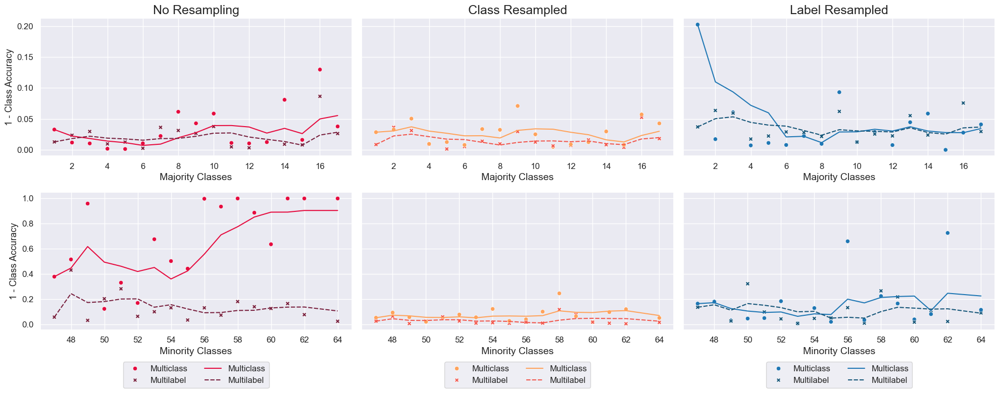

In [ ]:
major_minor_class_results(majority_clas_results, minority_clas_results, '1 - Class Accuracy');
# plt.savefig(os.path.join(PLOTS, 'article', 'majority_minority_class_accuracy.png'), bbox_inches='tight')

Model comparison for Majority Classes, No Resampling case. MC Median 0.0029; ML Median 0.0021.
Model comparison for Minority Classes, No Resampling case. MC Median 0.1372; ML Median 0.0208.
Increase in Median 1 - Label Accuracy per model: 47.7x factor increase for MC; 9.75x factor increase for ML.
Model comparison for Majority Classes, Class Resampled case. MC Median 0.0047; ML Median 0.0018.
Model comparison for Minority Classes, Class Resampled case. MC Median 0.0121; ML Median 0.0028.
Increase in Median 1 - Label Accuracy per model: 2.556x factor increase for MC; 1.547x factor increase for ML.
Model comparison for Majority Classes, Label Resampled case. MC Median 0.0049; ML Median 0.0047.
Model comparison for Minority Classes, Label Resampled case. MC Median 0.0212; ML Median 0.0167.
Increase in Median 1 - Label Accuracy per model: 4.334x factor increase for MC; 3.58x factor increase for ML.


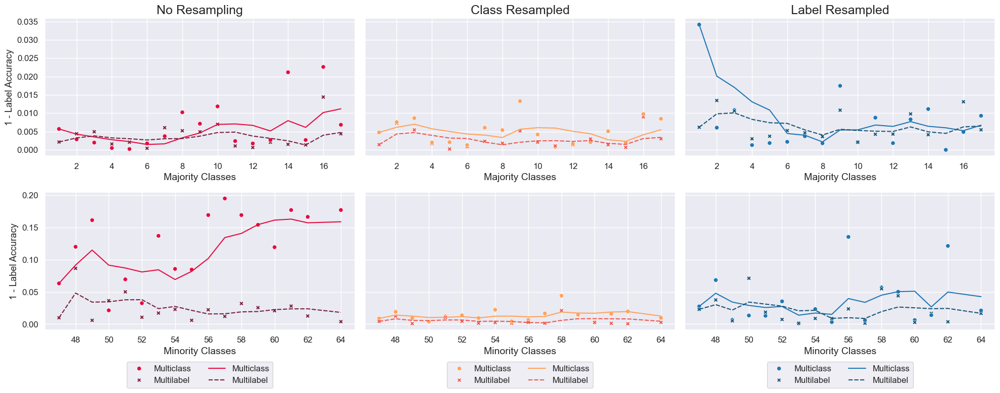

In [ ]:
major_minor_class_results(majority_clas_results, minority_clas_results, '1 - Label Accuracy');
# plt.savefig(os.path.join(PLOTS, 'article', 'majority_minority_label_accuracy.png'), bbox_inches='tight')

Model comparison for Majority Classes, No Resampling case. MC Median 1.0476; ML Median 1.0.
Model comparison for Minority Classes, No Resampling case. MC Median 1.064; ML Median 1.0533.
Increase in Median Mean Error per model: 1.016x factor increase for MC; 1.053x factor increase for ML.
Model comparison for Majority Classes, Class Resampled case. MC Median 1.0278; ML Median 1.0.
Model comparison for Minority Classes, Class Resampled case. MC Median 1.0385; ML Median 1.0667.
Increase in Median Mean Error per model: 1.01x factor increase for MC; 1.067x factor increase for ML.
Model comparison for Majority Classes, Label Resampled case. MC Median 1.1156; ML Median 1.0376.
Model comparison for Minority Classes, Label Resampled case. MC Median 1.1124; ML Median 1.1143.
Increase in Median Mean Error per model: 0.997x factor increase for MC; 1.074x factor increase for ML.


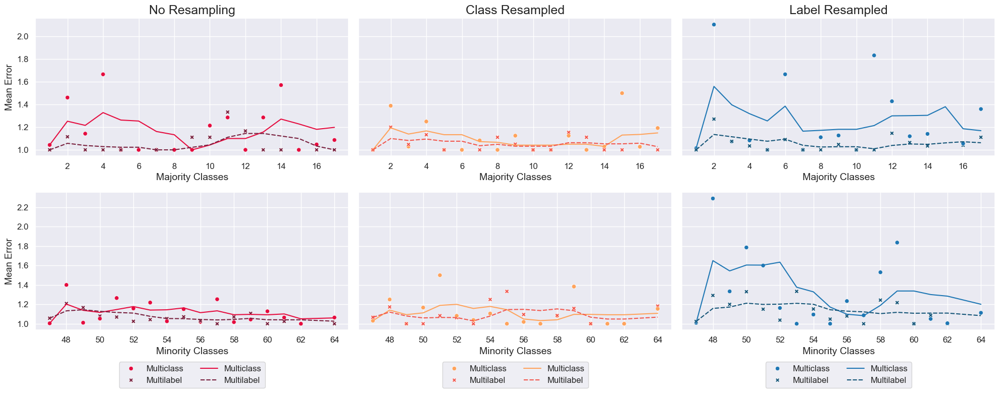

In [ ]:
major_minor_class_results(majority_clas_results, minority_clas_results, 'Mean Error');
# plt.savefig(os.path.join(PLOTS, 'article', 'majority_minority_mean_error_dist.png'), bbox_inches='tight')

Model comparison for Majority Classes, No Resampling case. MC Median 0.003; ML Median 0.0016.
Model comparison for Minority Classes, No Resampling case. MC Median 0.0253; ML Median 0.0025.
Increase in Median 1 - Label Recall per model: 8.359x factor increase for MC; 1.589x factor increase for ML.
Model comparison for Majority Classes, Class Resampled case. MC Median 0.0; ML Median 0.0.
Model comparison for Minority Classes, Class Resampled case. MC Median 0.0016; ML Median 0.0007.
Increase in Median 1 - Label Recall per model: infx factor increase for MC; infx factor increase for ML.
Model comparison for Majority Classes, Label Resampled case. MC Median 0.0018; ML Median 0.0.
Model comparison for Minority Classes, Label Resampled case. MC Median 0.0031; ML Median 0.0013.
Increase in Median 1 - Label Recall per model: 1.753x factor increase for MC; infx factor increase for ML.


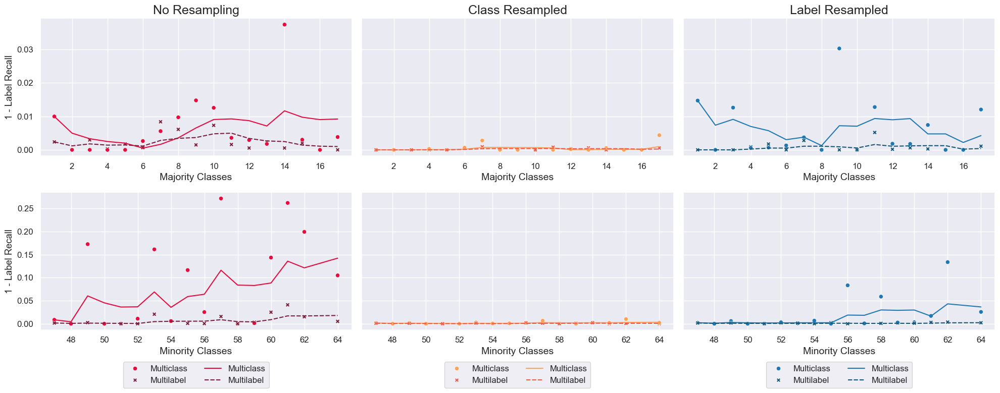

In [ ]:
major_minor_class_results(majority_clas_results, minority_clas_results, '1 - Label Recall');
# plt.savefig(os.path.join(PLOTS, 'article', 'majority_minority_label_recall.png'), bbox_inches='tight')

Model comparison for Majority Classes, No Resampling case. MC Median 0.0036; ML Median 0.0032.
Model comparison for Minority Classes, No Resampling case. MC Median 0.114; ML Median 0.0179.
Increase in Median 1 - Label Precision per model: 32.023x factor increase for MC; 5.67x factor increase for ML.
Model comparison for Majority Classes, Class Resampled case. MC Median 0.0093; ML Median 0.0032.
Model comparison for Minority Classes, Class Resampled case. MC Median 0.0181; ML Median 0.0067.
Increase in Median 1 - Label Precision per model: 1.958x factor increase for MC; 2.064x factor increase for ML.
Model comparison for Majority Classes, Label Resampled case. MC Median 0.0037; ML Median 0.0081.
Model comparison for Minority Classes, Label Resampled case. MC Median 0.0503; ML Median 0.0257.
Increase in Median 1 - Label Precision per model: 13.514x factor increase for MC; 3.192x factor increase for ML.


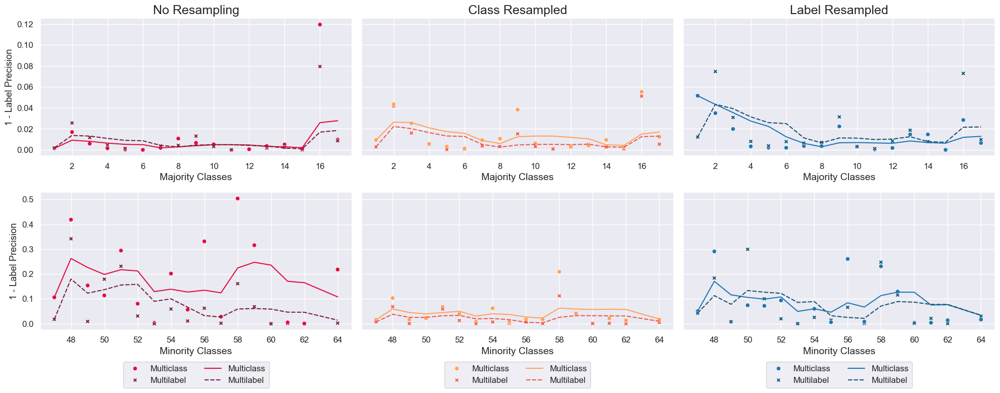

In [ ]:
major_minor_class_results(majority_clas_results, minority_clas_results, '1 - Label Precision');
# plt.savefig(os.path.join(PLOTS, 'article', 'majority_minority_label_precision.png'), bbox_inches='tight')

Model comparison for Majority Classes, No Resampling case. MC Median 0.0037; ML Median 0.0024.
Model comparison for Minority Classes, No Resampling case. MC Median 0.1527; ML Median 0.0158.
Increase in Median 1 - Label F1 per model: 40.923x factor increase for MC; 6.567x factor increase for ML.
Model comparison for Majority Classes, Class Resampled case. MC Median 0.0047; ML Median 0.0018.
Model comparison for Minority Classes, Class Resampled case. MC Median 0.0119; ML Median 0.0036.
Increase in Median 1 - Label F1 per model: 2.514x factor increase for MC; 2.013x factor increase for ML.
Model comparison for Majority Classes, Label Resampled case. MC Median 0.0066; ML Median 0.0045.
Model comparison for Minority Classes, Label Resampled case. MC Median 0.0341; ML Median 0.013.
Increase in Median 1 - Label F1 per model: 5.149x factor increase for MC; 2.9x factor increase for ML.


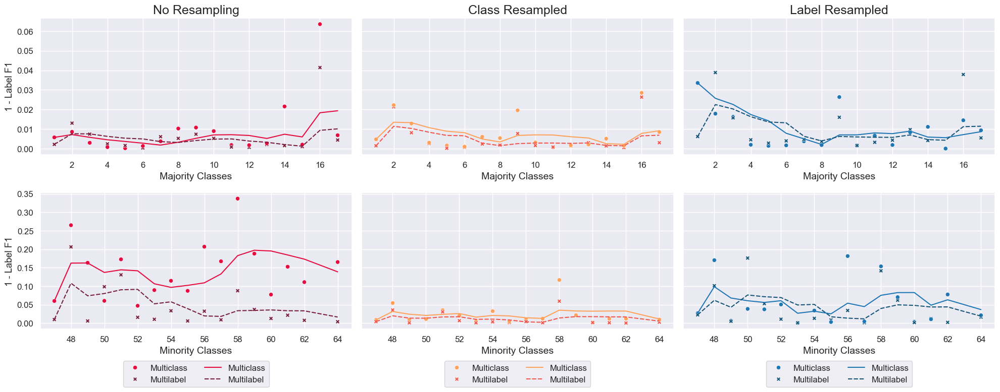

In [ ]:
major_minor_class_results(majority_clas_results, minority_clas_results, '1 - Label F1');
# plt.savefig(os.path.join(PLOTS, 'article', 'majority_minority_label_f1.png'), bbox_inches='tight')

#### Figures V2

In [ ]:
def major_minor_class_results_v2(major_results, minor_results, met):
    figs = []
    for t, train in enumerate(major_results.Training.unique()):
        fig, axes = plt.subplots(2, 1, figsize=(7, 8), sharey=True)

        major = major_results[major_results.Training == train].sort_values('Class Rank', ascending=True)
        major = smooth_data(major, met)
        mjm_mc = major[major.Model == MC][met].median()
        mjm_ml = major[major.Model == ML][met].median()
        print(f"Model comparison for Majority Classes, {train} case. MC Median {round(mjm_mc, 4)}; ML Median {round(mjm_ml, 4)}.")
        # major_wilcox = mc_ml_stats_test(major, met, ['Class'], True)

        sns.scatterplot(data=major, x='Class Rank', y=met, ax=axes[0], legend=False, style='Model', hue='Model',
                        style_order=model_style.keys(), hue_order=model_style.keys(), palette=PALS[t])
        sns.lineplot(data=major, x='Class Rank', y=f'{met} Smoothed', ax=axes[0], legend=False, style='Model', hue='Model',
                        style_order=model_style.keys(), hue_order=model_style.keys(), palette=PALS[t])
        axes[0].xaxis.set_major_locator(ticker.MultipleLocator(2))
        axes[0].set_title(train, fontsize=title_size)
        axes[0].set_xlabel(f'Majority Classes', fontsize=label_size)
        # axes[0].set_xlabel(f'Majority Classes (p-value {major_wilcox.pvalue:.2e})', fontsize=label_size)

        minor = minor_results[minor_results.Training == train].sort_values('Class Rank', ascending=True)
        minor = smooth_data(minor, met)
        mnm_mc = minor[minor.Model == MC][met].median()
        mnm_ml = minor[minor.Model == ML][met].median()
        print(f"Model comparison for Minority Classes, {train} case. MC Median {round(mnm_mc, 4)}; ML Median {round(mnm_ml, 4)}.")
        # minor_wilcox = mc_ml_stats_test(minor, met, ['Class'], True)

        sns.scatterplot(data=minor, x='Class Rank', y=met, ax=axes[1], style='Model', hue='Model',
                        style_order=model_style.keys(), hue_order=model_style.keys(), palette=PALS[t])
        sns.lineplot(data=minor, x='Class Rank', y=f'{met} Smoothed', ax=axes[1], style='Model', hue='Model',
                        style_order=model_style.keys(), hue_order=model_style.keys(), palette=PALS[t])
        axes[1].xaxis.set_major_locator(ticker.MultipleLocator(2))
        axes[1].legend(loc='upper center', ncol=2, bbox_to_anchor=(0.5, -0.2))
        axes[1].set_xlabel(f'Minority Classes', fontsize=label_size)
        # axes[1].set_xlabel(f'Minority Classes (p-value {minor_wilcox.pvalue:.2e})', fontsize=label_size)
        
        print(f"Increase in Median {met} per model: {round(1 + (mnm_mc - mjm_mc) / mjm_mc, 3)}x factor increase for MC; {round(1 + (mnm_ml - mjm_ml) / mjm_ml, 3)}x factor increase for ML.")
        plt.tight_layout()
        figs.append(fig)
    return figs

Model comparison for Majority Classes, No resampling case. MC Median 0.0161; ML Median 0.0128.
Model comparison for Minority Classes, No resampling case. MC Median 0.6758; ML Median 0.125.
Increase in Median 1 - Class Accuracy per model: 41.899x factor increase for MC; 9.75x factor increase for ML.
Model comparison for Majority Classes, Class-resampled case. MC Median 0.0285; ML Median 0.0097.
Model comparison for Minority Classes, Class-resampled case. MC Median 0.0558; ML Median 0.0156.
Increase in Median 1 - Class Accuracy per model: 1.96x factor increase for MC; 1.608x factor increase for ML.
Model comparison for Majority Classes, Label-resampled case. MC Median 0.0223; ML Median 0.0279.
Model comparison for Minority Classes, Label-resampled case. MC Median 0.1142; ML Median 0.0899.
Increase in Median 1 - Class Accuracy per model: 5.113x factor increase for MC; 3.217x factor increase for ML.


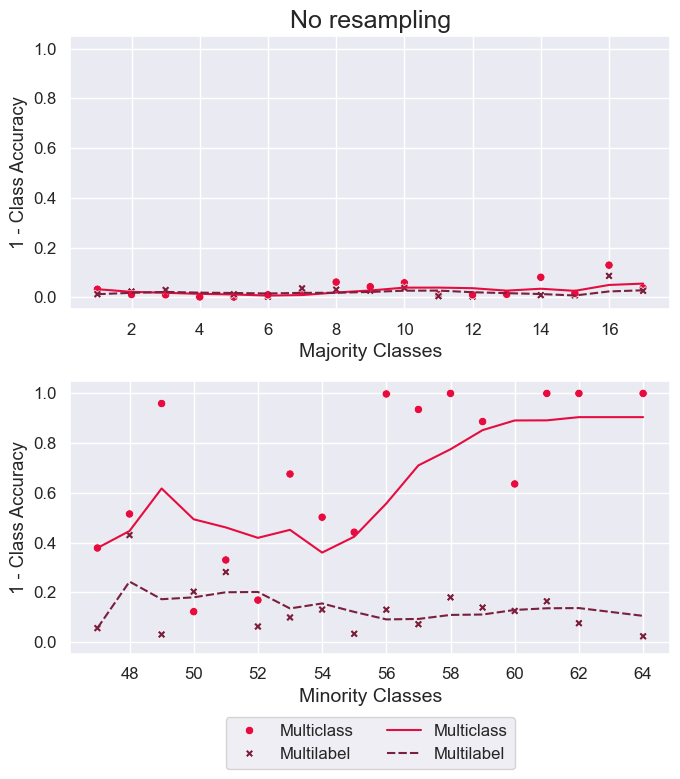

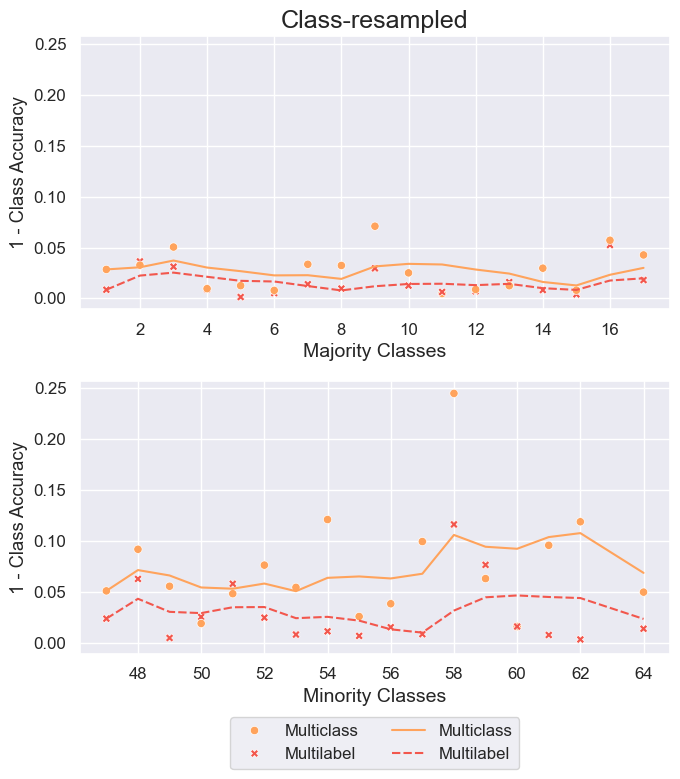

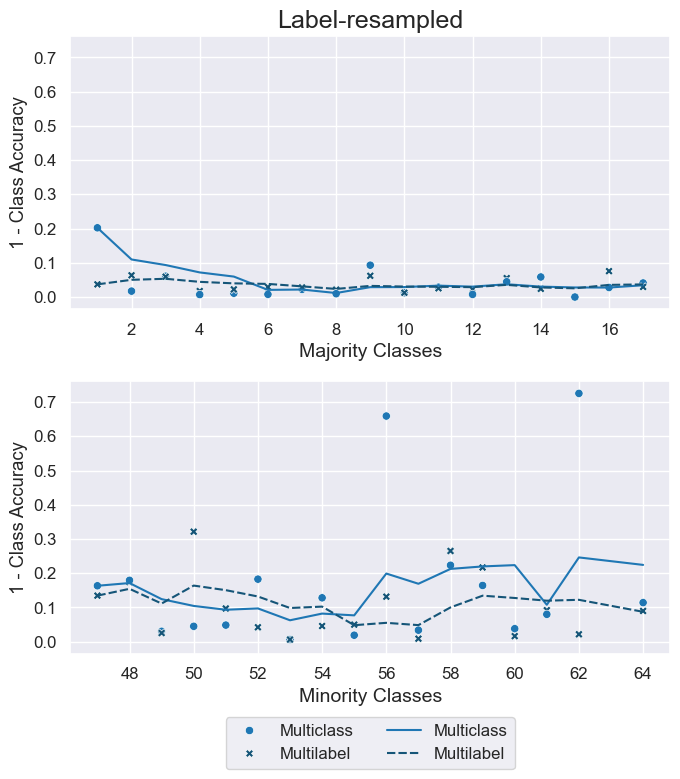

In [ ]:
for f, fig in enumerate(major_minor_class_results_v2(majority_clas_results, minority_clas_results, '1 - Class Accuracy')):
    fig.savefig(os.path.join(PLOTS, 'article', f'majority_minority_class_accuracy_{resamplings[f]}.png'), bbox_inches='tight')

Model comparison for Majority Classes, No resampling case. MC Median 0.0029; ML Median 0.0021.
Model comparison for Minority Classes, No resampling case. MC Median 0.1372; ML Median 0.0208.
Increase in Median 1 - Label Accuracy per model: 47.7x factor increase for MC; 9.75x factor increase for ML.
Model comparison for Majority Classes, Class-resampled case. MC Median 0.0047; ML Median 0.0018.
Model comparison for Minority Classes, Class-resampled case. MC Median 0.0121; ML Median 0.0028.
Increase in Median 1 - Label Accuracy per model: 2.556x factor increase for MC; 1.547x factor increase for ML.
Model comparison for Majority Classes, Label-resampled case. MC Median 0.0049; ML Median 0.0047.
Model comparison for Minority Classes, Label-resampled case. MC Median 0.0212; ML Median 0.0167.
Increase in Median 1 - Label Accuracy per model: 4.334x factor increase for MC; 3.58x factor increase for ML.


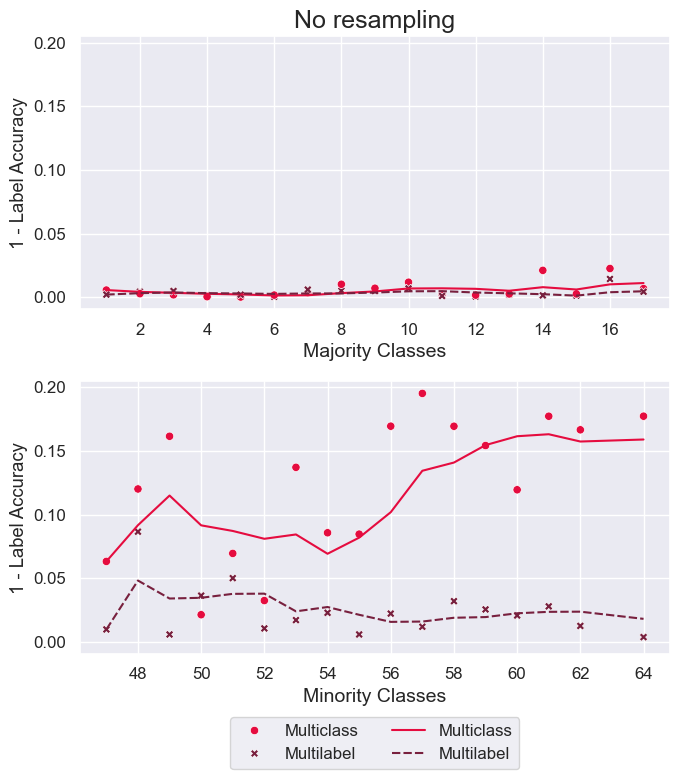

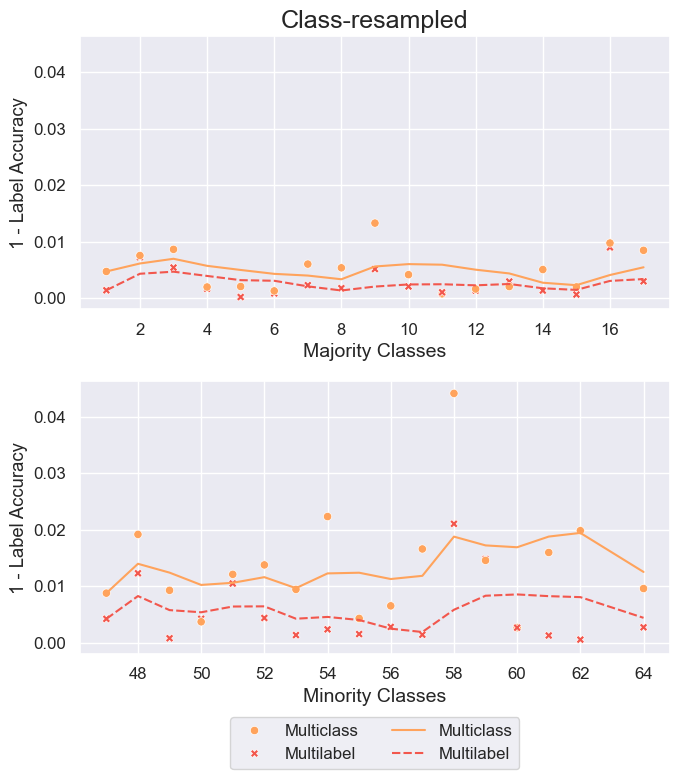

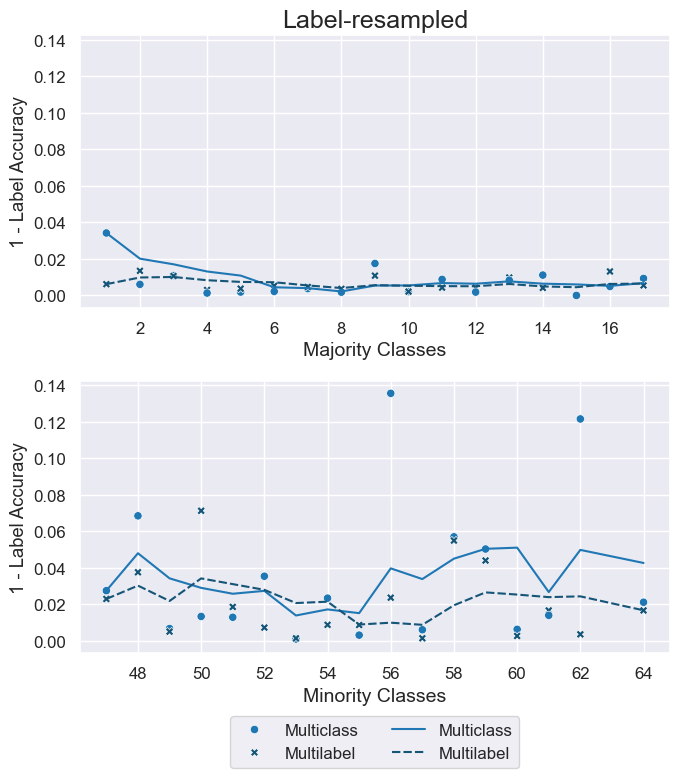

In [ ]:
for f, fig in enumerate(major_minor_class_results_v2(majority_clas_results, minority_clas_results, '1 - Label Accuracy')):
    fig.savefig(os.path.join(PLOTS, 'article', f'majority_minority_label_accuracy_{trainings[f]}.png'), bbox_inches='tight')

Model comparison for Majority Classes, No resampling case. MC Median 1.0476; ML Median 1.0.
Model comparison for Minority Classes, No resampling case. MC Median 1.064; ML Median 1.0533.
Increase in Median Mean Error per model: 1.016x factor increase for MC; 1.053x factor increase for ML.
Model comparison for Majority Classes, Class-resampled case. MC Median 1.0278; ML Median 1.0.
Model comparison for Minority Classes, Class-resampled case. MC Median 1.0385; ML Median 1.0667.
Increase in Median Mean Error per model: 1.01x factor increase for MC; 1.067x factor increase for ML.
Model comparison for Majority Classes, Label-resampled case. MC Median 1.1156; ML Median 1.0376.
Model comparison for Minority Classes, Label-resampled case. MC Median 1.1124; ML Median 1.1143.
Increase in Median Mean Error per model: 0.997x factor increase for MC; 1.074x factor increase for ML.


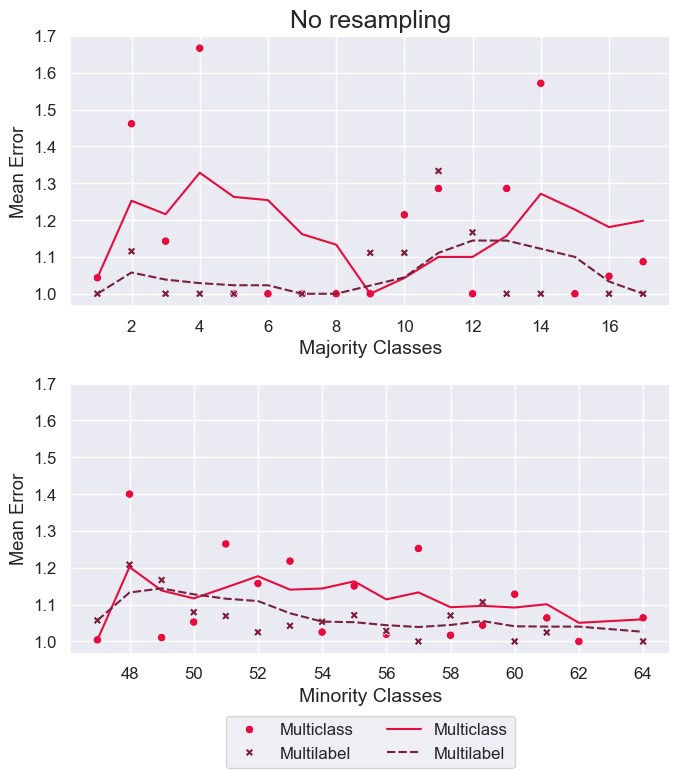

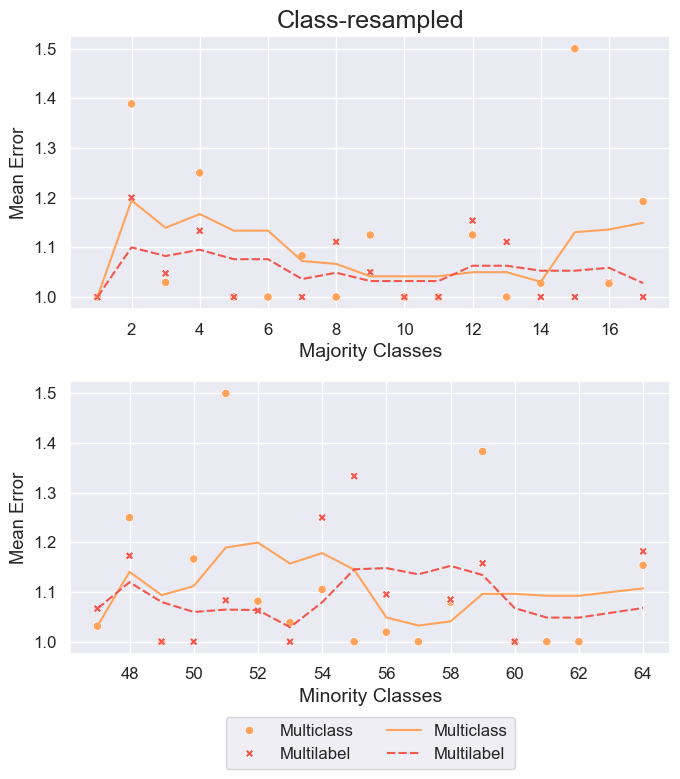

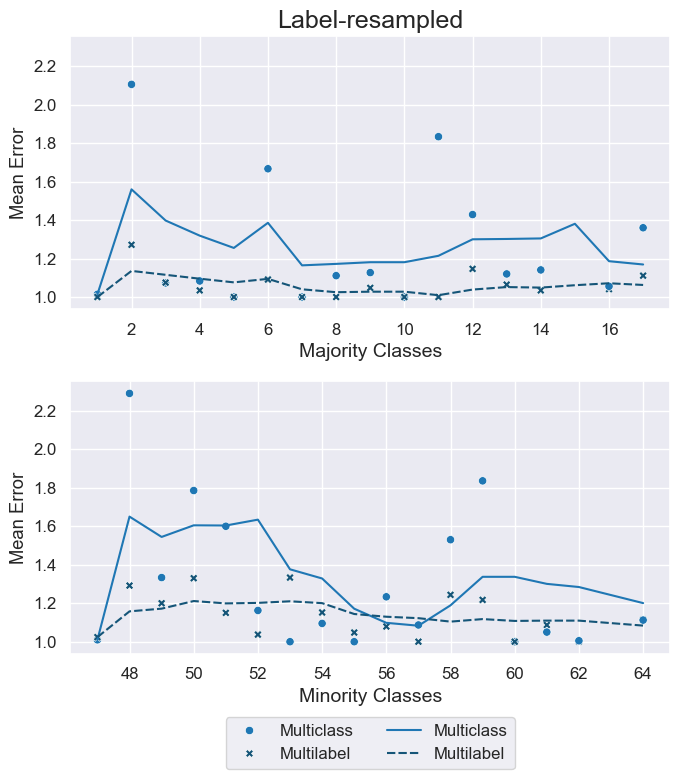

In [ ]:
for f, fig in enumerate(major_minor_class_results_v2(majority_clas_results, minority_clas_results, 'Mean Error')):
    fig.savefig(os.path.join(PLOTS, 'article', f'majority_minority_mean_error_dist_{trainings[f]}.png'), bbox_inches='tight')

Model comparison for Majority Classes, No resampling case. MC Median 0.003; ML Median 0.0016.
Model comparison for Minority Classes, No resampling case. MC Median 0.0253; ML Median 0.0025.
Increase in Median 1 - Label Recall per model: 8.359x factor increase for MC; 1.589x factor increase for ML.
Model comparison for Majority Classes, Class-resampled case. MC Median 0.0; ML Median 0.0.
Model comparison for Minority Classes, Class-resampled case. MC Median 0.0016; ML Median 0.0007.
Increase in Median 1 - Label Recall per model: infx factor increase for MC; infx factor increase for ML.
Model comparison for Majority Classes, Label-resampled case. MC Median 0.0018; ML Median 0.0.
Model comparison for Minority Classes, Label-resampled case. MC Median 0.0031; ML Median 0.0013.
Increase in Median 1 - Label Recall per model: 1.753x factor increase for MC; infx factor increase for ML.


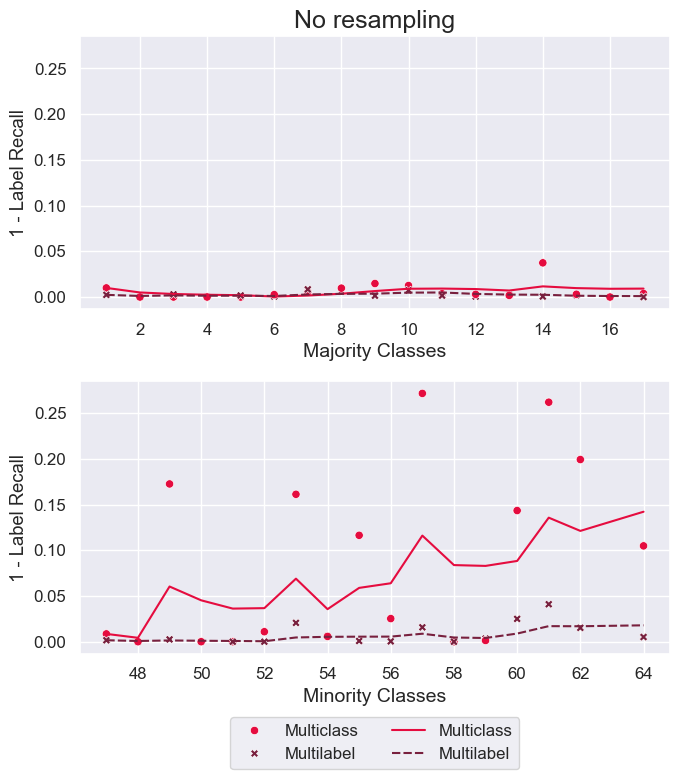

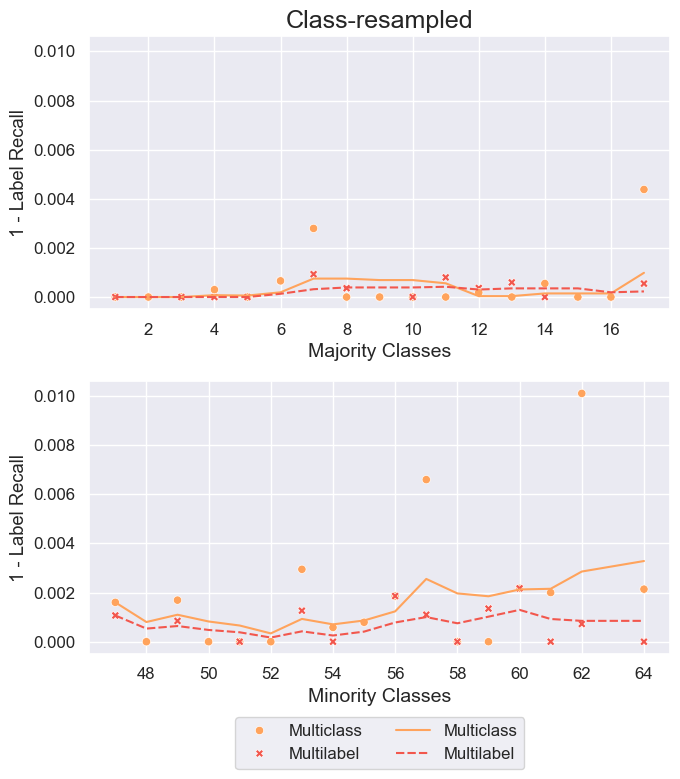

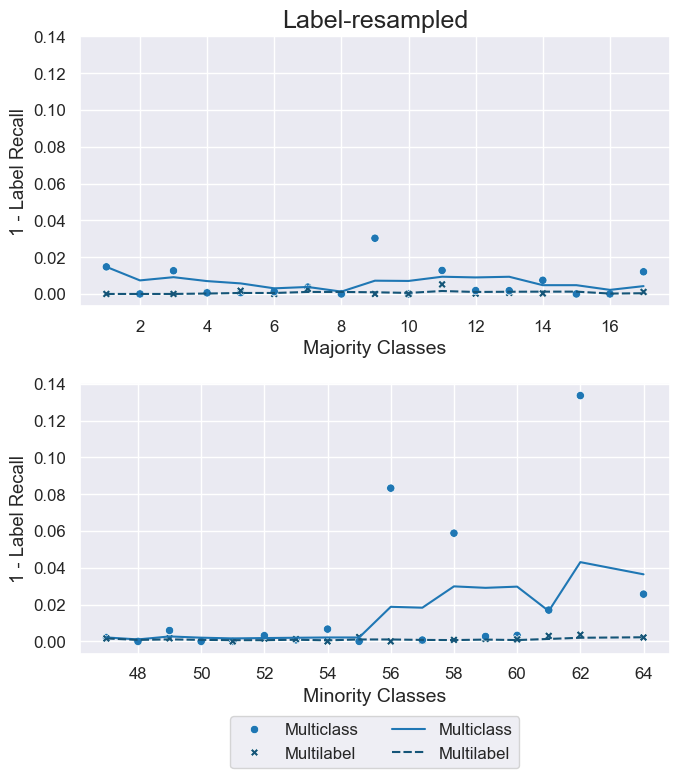

In [ ]:
for f, fig in enumerate(major_minor_class_results_v2(majority_clas_results, minority_clas_results, '1 - Label Recall')):
    fig.savefig(os.path.join(PLOTS, 'article', f'majority_minority_label_recall_{trainings[f]}.png'), bbox_inches='tight')

Model comparison for Majority Classes, No resampling case. MC Median 0.0036; ML Median 0.0032.
Model comparison for Minority Classes, No resampling case. MC Median 0.114; ML Median 0.0179.
Increase in Median 1 - Label Precision per model: 32.023x factor increase for MC; 5.67x factor increase for ML.
Model comparison for Majority Classes, Class-resampled case. MC Median 0.0093; ML Median 0.0032.
Model comparison for Minority Classes, Class-resampled case. MC Median 0.0181; ML Median 0.0067.
Increase in Median 1 - Label Precision per model: 1.958x factor increase for MC; 2.064x factor increase for ML.
Model comparison for Majority Classes, Label-resampled case. MC Median 0.0037; ML Median 0.0081.
Model comparison for Minority Classes, Label-resampled case. MC Median 0.0503; ML Median 0.0257.
Increase in Median 1 - Label Precision per model: 13.514x factor increase for MC; 3.192x factor increase for ML.


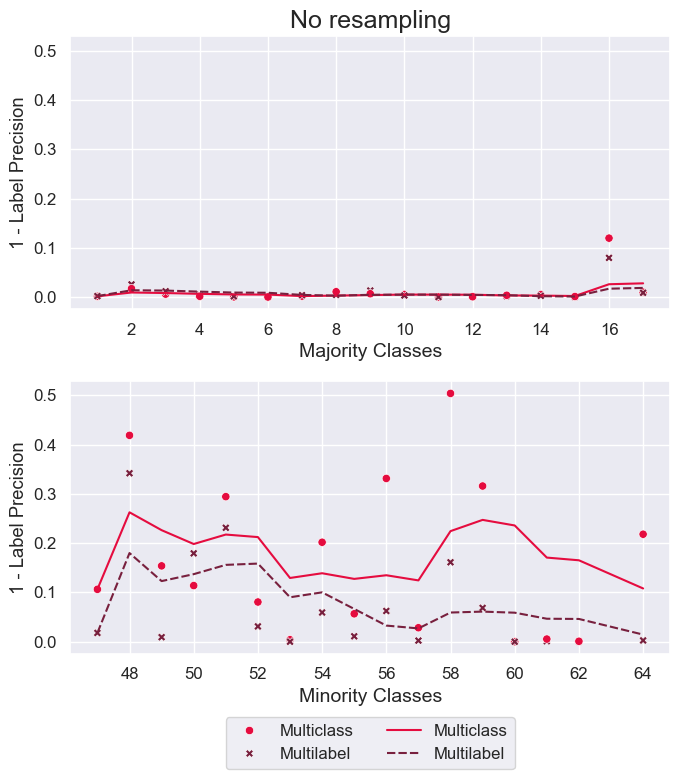

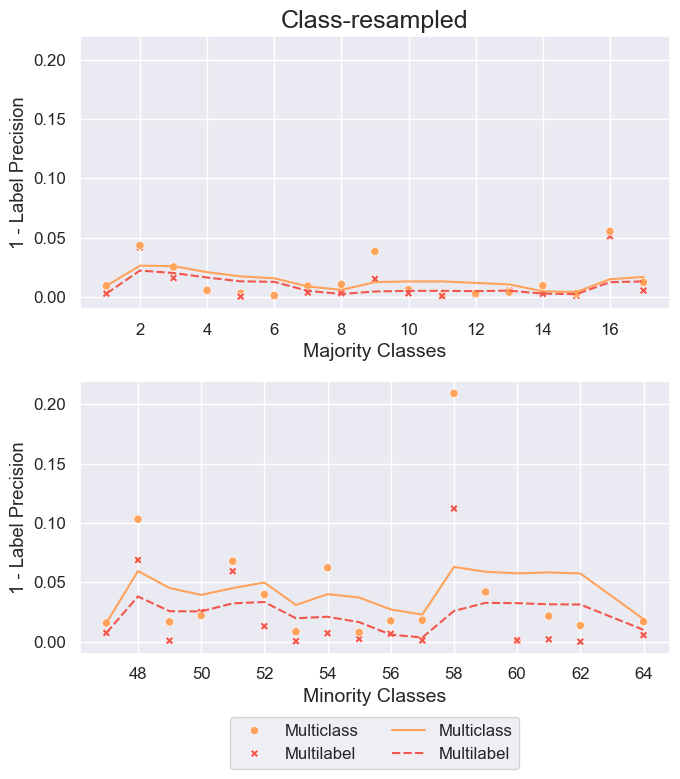

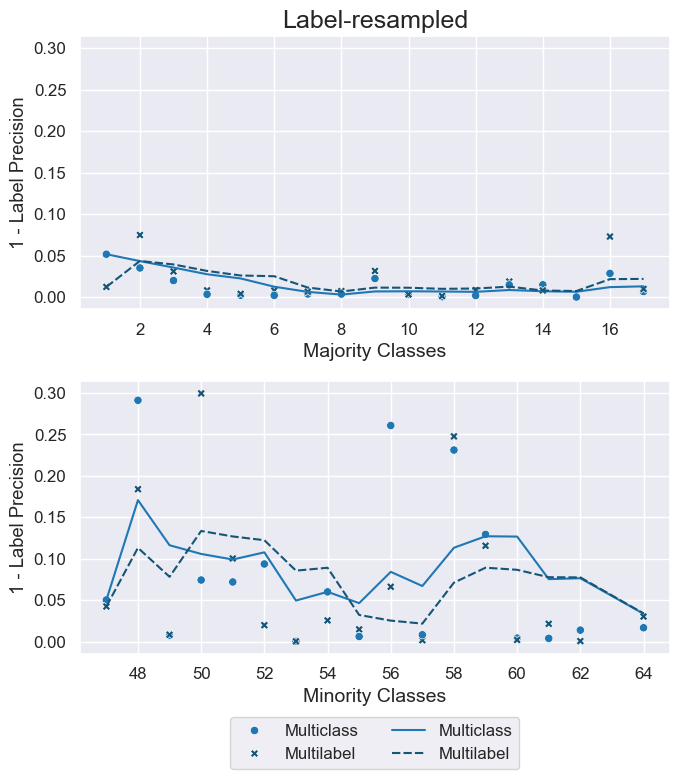

In [ ]:
for f, fig in enumerate(major_minor_class_results_v2(majority_clas_results, minority_clas_results, '1 - Label Precision')):
    fig.savefig(os.path.join(PLOTS, 'article', f'majority_minority_label_precision_{trainings[f]}.png'), bbox_inches='tight')

Model comparison for Majority Classes, No resampling case. MC Median 0.0037; ML Median 0.0024.
Model comparison for Minority Classes, No resampling case. MC Median 0.1527; ML Median 0.0158.
Increase in Median 1 - Label F1 per model: 40.923x factor increase for MC; 6.567x factor increase for ML.
Model comparison for Majority Classes, Class-resampled case. MC Median 0.0047; ML Median 0.0018.
Model comparison for Minority Classes, Class-resampled case. MC Median 0.0119; ML Median 0.0036.
Increase in Median 1 - Label F1 per model: 2.514x factor increase for MC; 2.013x factor increase for ML.
Model comparison for Majority Classes, Label-resampled case. MC Median 0.0066; ML Median 0.0045.
Model comparison for Minority Classes, Label-resampled case. MC Median 0.0341; ML Median 0.013.
Increase in Median 1 - Label F1 per model: 5.149x factor increase for MC; 2.9x factor increase for ML.


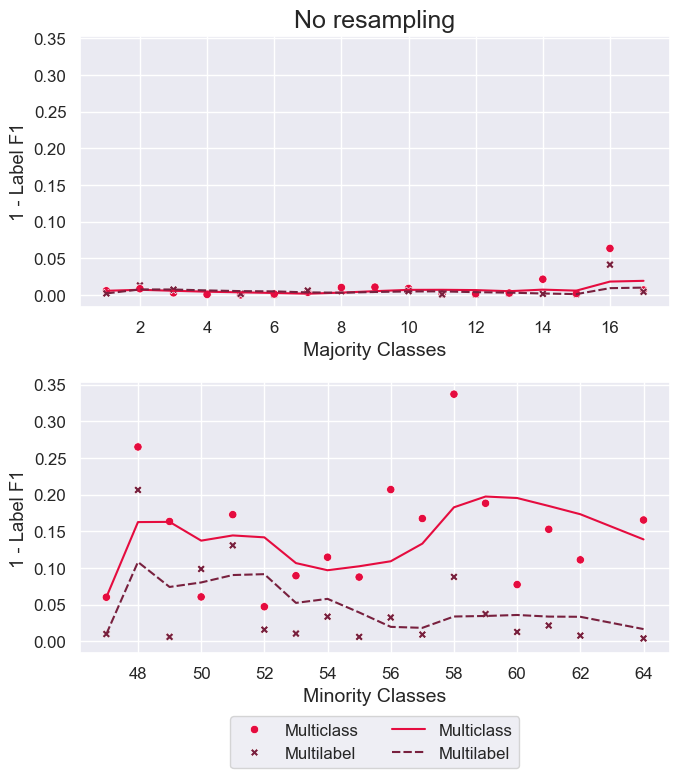

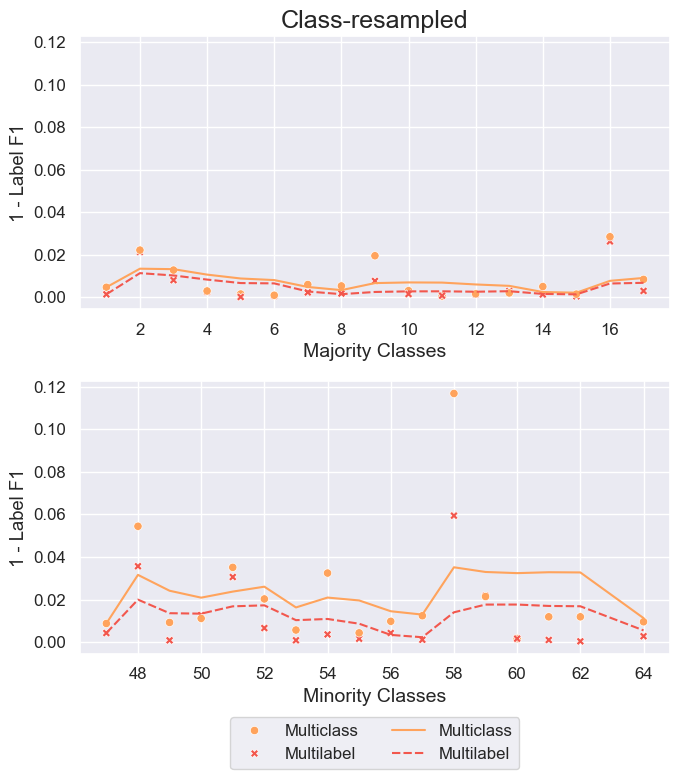

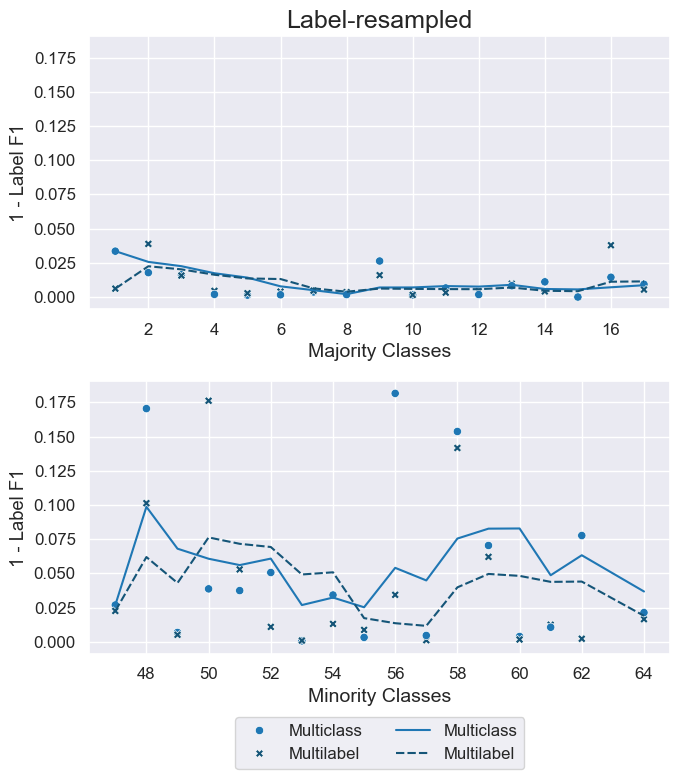

In [ ]:
for f, fig in enumerate(major_minor_class_results_v2(majority_clas_results, minority_clas_results, '1 - Label F1')):
    fig.savefig(os.path.join(PLOTS, 'article', f'majority_minority_label_f1_{trainings[f]}.png'), bbox_inches='tight')

#### Figures V3

In [ ]:
average_middle_clas_results

1 - Class Accuracy  \
Evaluation          Resampling Scenario Model                            
Out-of-distribution No Resampling       Multiclass            0.127071   
                                        Multilabel            0.056995   
                    Class Resampled     Multiclass            0.048970   
                                        Multilabel            0.029585   
                    Label Resampled     Multiclass            0.056876   
                                        Multilabel            0.049691   

                                                    1 - Label Accuracy  \
Evaluation          Resampling Scenario Model                            
Out-of-distribution No Resampling       Multiclass            0.024409   
                                        Multilabel            0.009926   
                    Class Resampled     Multiclass            0.008657   
                                        Multilabel            0.005035   
                    Label Resampled     Multiclass            0.010242   
                                        Multilabel            0.008744   

                                                    Mean Error  \
Evaluation          Resampling Scenario Model                    
Out-of-distribution No Resampling       Multiclass    1.230844   
                                        Multilabel    1.056001   
                    Class Resampled     Multiclass    1.102002   
                                        Multilabel    1.030994   
                    Label Resampled     Multiclass    1.161917   
                                        Multilabel    1.055581   

                                                    1 - Label Recall  \
Evaluation          Resampling Scenario Model                          
Out-of-distribution No Resampling       Multiclass          0.035184   
                                        Multilabel          0.005101   
                    Class Resampled     Multiclass          0.001160   
                                        Multilabel          0.000623   
                    Label Resampled     Multiclass          0.007434   
                                        Multilabel          0.001170   

                                                    1 - Label Precision  \
Evaluation          Resampling Scenario Model                             
Out-of-distribution No Resampling       Multiclass             0.011479   
                                        Multilabel             0.014566   
                    Class Resampled     Multiclass             0.018351   
                                        Multilabel             0.011027   
                    Label Resampled     Multiclass             0.015779   
                                        Multilabel             0.018965   

                                                    1 - Label F1  
Evaluation          Resampling Scenario Model                     
Out-of-distribution No Resampling       Multiclass      0.024551  
                                        Multilabel      0.010267  
                    Class Resampled     Multiclass      0.010187  
                                        Multilabel      0.006218  
                    Label Resampled     Multiclass      0.012075  
                                        Multilabel      0.010545

In [ ]:
def major_minor_class_results_v3(major_results, minor_results, avg_middle_results, met):
    avg_middle_results = avg_middle_results.reset_index().drop('Evaluation', axis=1).set_index([TRAIN_COL, MODEL_COL])
    
    fig, axes = plt.subplots(3, 2, figsize=(10, 12), sharey='row')
    for t, train in enumerate(major_results[TRAIN_COL].unique()):
        for m, model in enumerate(model_names):
            LEG0 = m==0
            LEG1 = m==1
            ax = axes[t, m]
            LEG = False

            major = major_results[(major_results[TRAIN_COL] == train) & (major_results[MODEL_COL] == model)].sort_values('Class Rank', ascending=True)
            major = smooth_data(major, met)
            minor = minor_results[(minor_results[TRAIN_COL] == train) & (minor_results[MODEL_COL] == model)].sort_values('Class Rank', ascending=True)
            minor['Class Rank'] = minor['Class Rank'] - 46
            minor = smooth_data(minor, met)
            
            sns.lineplot(x=[1, 17], y=[avg_middle_results.loc[(train, model), met]]*2, ax=ax, linestyle='-', alpha=0.5,
                         color=PALS[t][3], label='Baseline' if LEG else None, legend=LEG)
            sns.scatterplot(data=minor, x='Class Rank', y=met, ax=ax, s=75, marker='v',
                label='Minority' if LEG0 else None, color=PALS[t][1], legend=LEG0)
            sns.lineplot(data=minor, x='Class Rank', y=f'{met} Smoothed', ax=ax, linestyle=':',
                label='Minority' if LEG1 else None, color=PALS[t][1], legend=LEG1)
            sns.scatterplot(data=major, x='Class Rank', y=met, ax=ax, s=75, marker='^',
                label='Majority' if LEG0 else None, color=PALS[t][0], legend=LEG0)
            sns.lineplot(data=major, x='Class Rank', y=f'{met} Smoothed', ax=ax, linestyle='-.',
                label='Majority' if LEG1 else None, color=PALS[t][0], legend=LEG1)
            ax.xaxis.set_major_locator(ticker.MultipleLocator(2))
            ax.set_title(f"{train}, {model}", fontsize=LBL_LARGE)
            ax.set_xlabel(f'Ordered Classes', fontsize=LBL_SIZE)
            ax.set_ylabel(met, fontsize=LBL_SIZE)
            ax.set_xticks([])
            ax.tick_params(axis='both', labelsize=TICK_SIZE)
            
            # if LEG:
            #     ax.legend(loc='center left', ncol=1, bbox_to_anchor=(1.01, 0.5))
            if LEG0 or LEG1:
                ax.legend(loc='upper center', ncol=3, bbox_to_anchor=(0.5, -0.1), fontsize=TICK_SIZE)
            
    plt.tight_layout()
    return fig

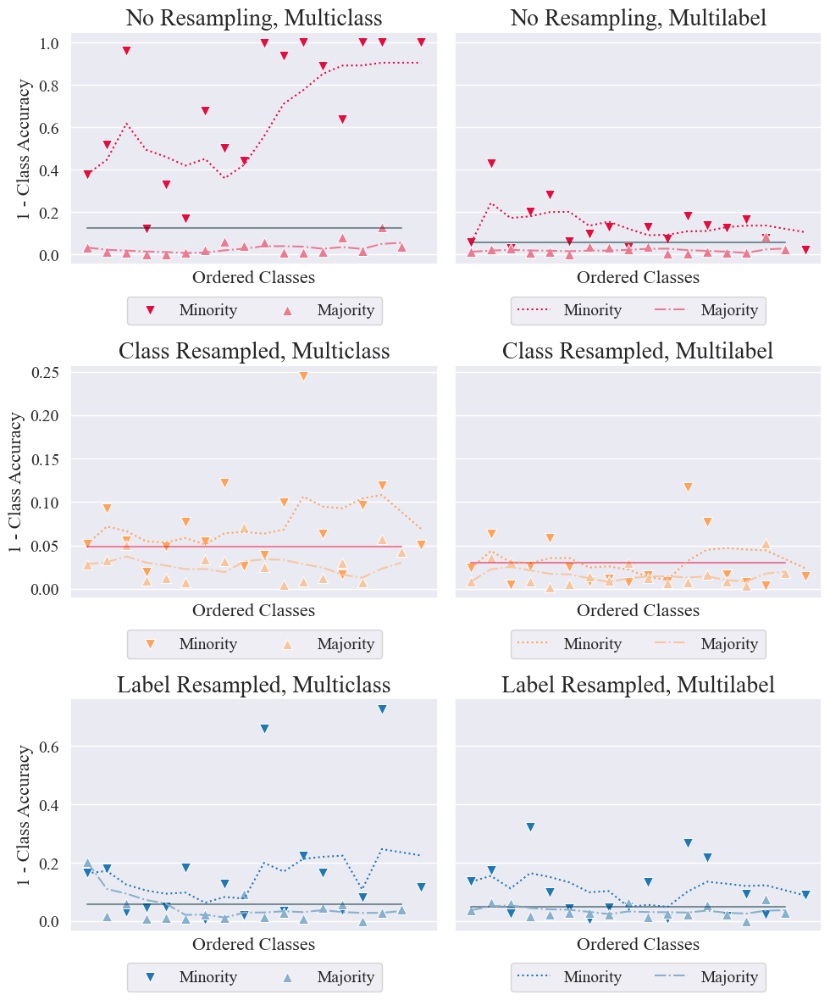

In [ ]:
major_minor_class_results_v3(majority_clas_results, minority_clas_results, average_middle_clas_results, '1 - Class Accuracy');
plt.savefig(os.path.join(PLOTS, 'article', 'majority_minority_class_accuracy.png'), bbox_inches='tight')

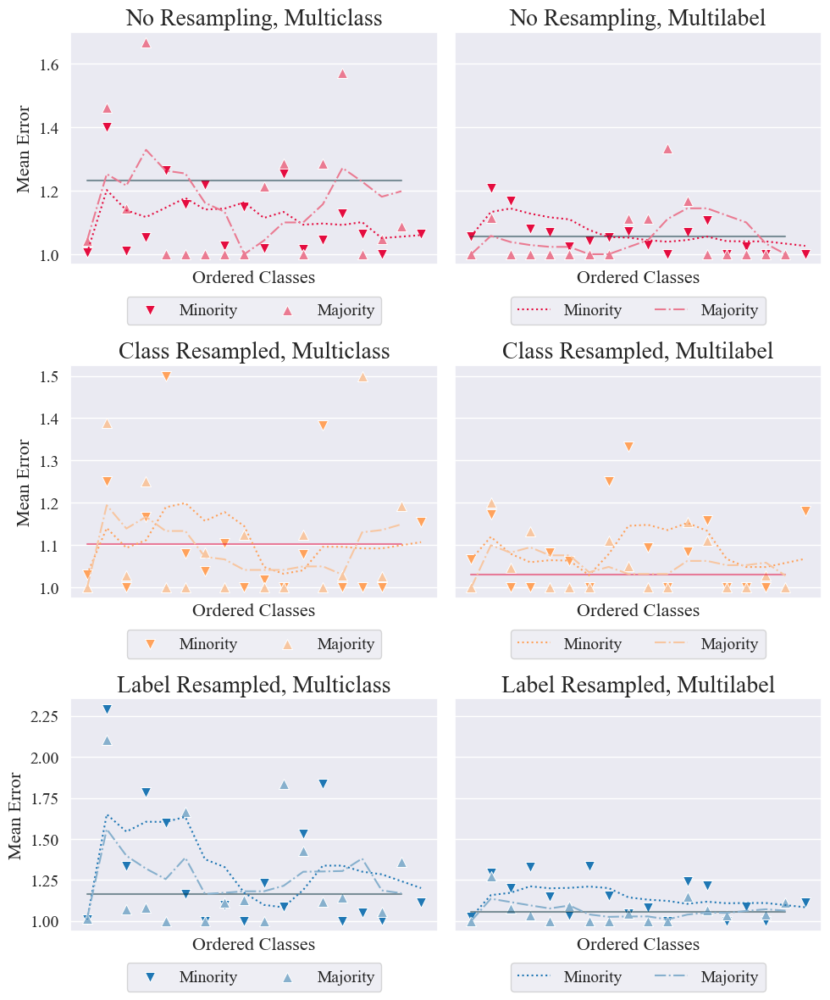

In [ ]:
major_minor_class_results_v3(majority_clas_results, minority_clas_results, average_middle_clas_results, 'Mean Error');
plt.savefig(os.path.join(PLOTS, 'article', 'majority_minority_mean_error_dist.png'), bbox_inches='tight')

#### Figures V4

In [397]:
average_middle_clas_results

1 - class recall  \
Evaluation Resampling Scenario Model                          
DSBI       No Resampling       Multiclass          0.127071   
                               Multilabel          0.056995   
           Class Resampled     Multiclass          0.048970   
                               Multilabel          0.029585   
           Label Resampled     Multiclass          0.056876   
                               Multilabel          0.049691   
           Adaptive Resampled  Multiclass          0.060956   
                               Multilabel          0.034053   

                                           1 - class precision  1 - class F1  
Evaluation Resampling Scenario Model                                          
DSBI       No Resampling       Multiclass             0.188454      0.202100  
                               Multilabel             0.106547      0.096176  
           Class Resampled     Multiclass             0.122258      0.099561  
                               Multilabel             0.069695      0.055614  
           Label Resampled     Multiclass             0.127007      0.106259  
                               Multilabel             0.165535      0.105774  
           Adaptive Resampled  Multiclass             0.108579      0.095739  
                               Multilabel             0.099274      0.055857

In [398]:
def major_minor_class_results_v4(major_results, minor_results, avg_middle_results, met):
    avg_middle_results = avg_middle_results.reset_index().drop(EVAL_COL, axis=1).set_index([TRAIN_COL, MODEL_COL])
    
    # g = sns.FacetGrid(data=major, row=MODEL_COL, col=TRAIN_COL)
    fig, axes = plt.subplots(2, 4, figsize=(10, 5), sharey='row')
    for t, train in enumerate(major_results[TRAIN_COL].unique()):
        for m, model in enumerate(model_names):
            LEG0 = False # m==0
            LEG1 = False # m==0
            ax = axes[m, t]
            LEG = False

            major = major_results[(major_results[TRAIN_COL] == train) & (major_results[MODEL_COL] == model)].sort_values('Class Rank', ascending=True)
            major = smooth_data(major, met)
            minor = minor_results[(minor_results[TRAIN_COL] == train) & (minor_results[MODEL_COL] == model)].sort_values('Class Rank', ascending=True)
            minor['Class Rank'] = minor['Class Rank'] - 46
            minor = smooth_data(minor, met)
            
            sns.lineplot(x=[1, 17], y=[avg_middle_results.loc[(train, model), met]]*2, ax=ax, linestyle='-', zorder=1, alpha=0.5,
                         color=PALS[t][3], label='Baseline' if LEG else None, legend=LEG)
            sns.scatterplot(data=minor, x='Class Rank', y=met, ax=ax, s=75, marker='v', zorder=2,
                label='Minority' if LEG0 else None, color=PALS[t][2], legend=LEG0)
            sns.lineplot(data=minor, x='Class Rank', y=f'{met} Smoothed', ax=ax, linestyle=':', zorder=1,
                label='Minority' if LEG1 else None, color=PALS[t][2], legend=LEG1)
            sns.scatterplot(data=major, x='Class Rank', y=met, ax=ax, s=75, marker='^', zorder=2,
                label='Majority' if LEG0 else None, color=PALS[t][1], legend=LEG0)
            sns.lineplot(data=major, x='Class Rank', y=f'{met} Smoothed', ax=ax, linestyle='-.', zorder=1,
                label='Majority' if LEG1 else None, color=PALS[t][1], legend=LEG1)
            ax.xaxis.set_major_locator(ticker.MultipleLocator(2))
            if m == 0:
                ax.set_title(f"{abbreviations[train]}", fontsize=LBL_SIZE)
            if m == 1:
                ax.set_xlabel(f'Classes', fontsize=LBL_SIZE)
            else:
                ax.set_xlabel('')
            ax.set_ylabel(abbreviations[model], fontsize=LBL_SIZE)
            ax.set_xticks([])
            ax.tick_params(axis='both', labelsize=TICK_SIZE)
            
    
    # Build up legend:
    ax = axes[0,-1]
    hl = 1.1
    hl_t = 0.5
    cg = 0.4
    lg1 = ax.legend(handles=[
        Line2D([0], [0], color='none', label="Class sets"),
        Line2D([0], [0], color='none', label=TRAIN_COL),
        ],
            loc='lower right', bbox_to_anchor=(1.05, 1.15),
            handlelength=3., columnspacing=8.,
            fontsize=TICK_SIZE, ncols=2,
            )
    handles=[
        Line2D([0], [0], color=GREY, marker='^', markersize=10, markeredgecolor=BLACK, markeredgewidth=1.,
               markerfacecolor='none', linestyle='-.', lw=1.5, alpha=1., label="Majority"),
        Line2D([0], [0], color=GREY, marker='.', markersize=0, markeredgecolor=BLACK, markeredgewidth=1.,
               markerfacecolor='none', linestyle='-', lw=1.5, alpha=1., label="Middle"),
        Line2D([0], [0], color=GREY, marker='v', markersize=10, markeredgecolor=BLACK, markeredgewidth=1.,
               markerfacecolor='none', linestyle=':', lw=1.5, alpha=1., label="Minority"),
    ] + [
        Line2D([0], [0], color='none',
                marker='s', markersize=8, markeredgecolor=WHITE,
                markerfacecolor=CPAL[r], alpha=0.9, label=f"{abbreviations[res]}")
        for r, res in enumerate(resamplings)
    ]
    lg2 = mlegend.Legend(ax,
                        handles=handles,
                        labels=[h.get_label() for h in handles],
                        fontsize=TICK_SIZE, handlelength=hl, columnspacing=cg,
                        loc='upper left', bbox_to_anchor=(1., 0.9), ncol=7, frameon=False)

    legends = [lg1, lg2]
    # Manually combine the legends
    for leg in legends[1:]:
        for child in leg._legend_box._children:
            lg1._legend_box._children.append(child)
    lg1._legend_box.align = "left"


    bold_labels = [MODEL_COL, TRAIN_COL,
                TRAIN_COL.replace(' ', '\n'), "Class sets"]
    for lts in [leg.get_texts() for leg in legends]:
        for text in lts:
            t = text.get_text()
            if t in bold_labels:
                text.set_fontweight('bold')
                text.set_fontsize(TICK_SIZE)
    # plt.tight_layout()
    plt.subplots_adjust(hspace=0.05, wspace=0.01)
                
    return fig

In [399]:
pc_metrics

['1 - class recall', '1 - class precision', '1 - class F1']

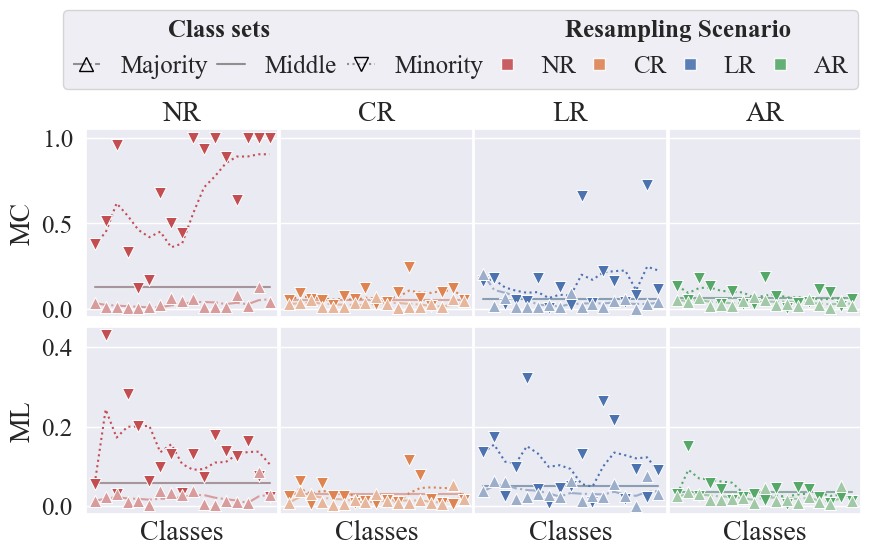

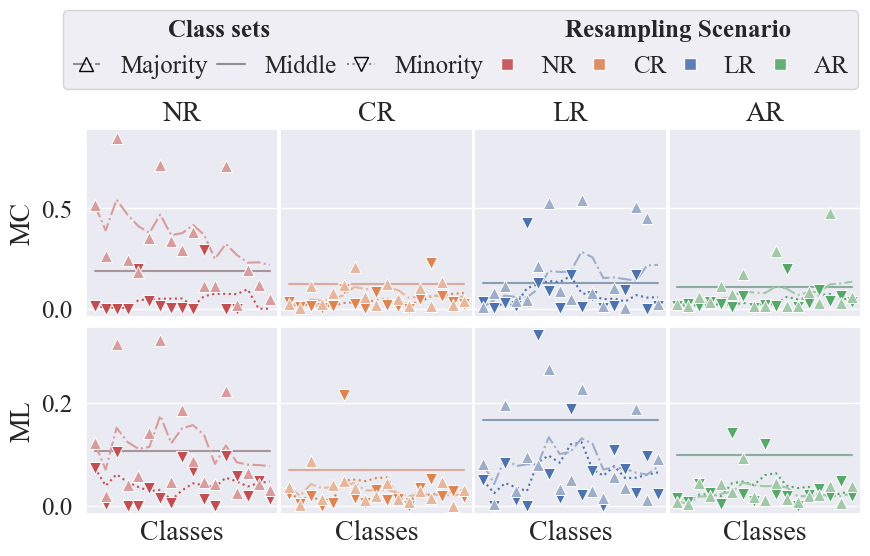

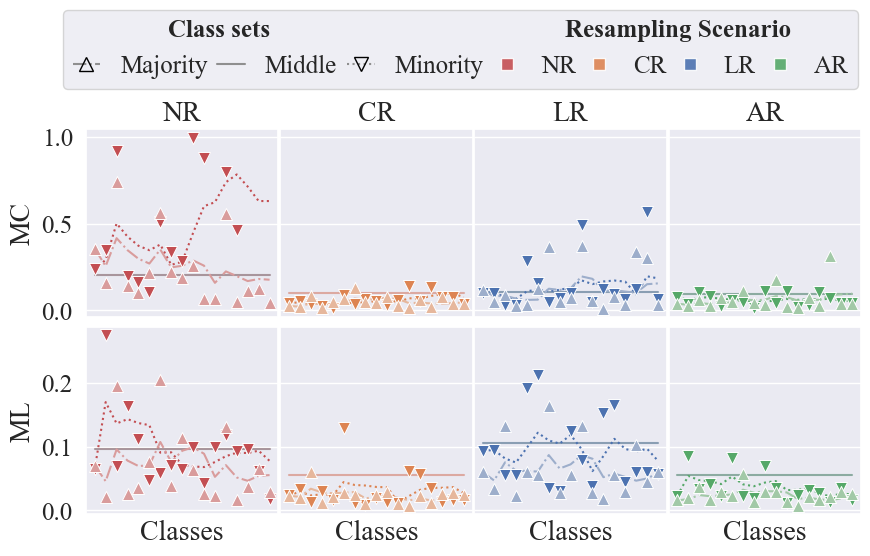

In [400]:
for met in pc_metrics:
    fig = major_minor_class_results_v4(majority_clas_results, minority_clas_results, average_middle_clas_results, met)
    fig.savefig(os.path.join(PLOT_EVALS, f'per_class_{met.split(" ")[-1].lower()}.pdf'), bbox_inches='tight')

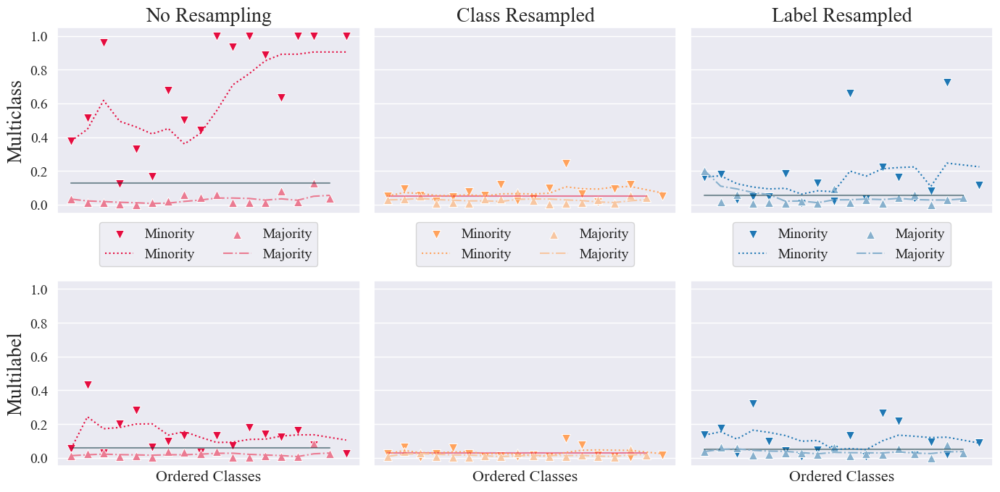

In [ ]:
major_minor_class_results_v4(majority_clas_results, minority_clas_results, average_middle_clas_results, '1 - Class Accuracy');
# plt.savefig(os.path.join(PLOTS, 'article', 'majority_minority_class_accuracy.png'), bbox_inches='tight')

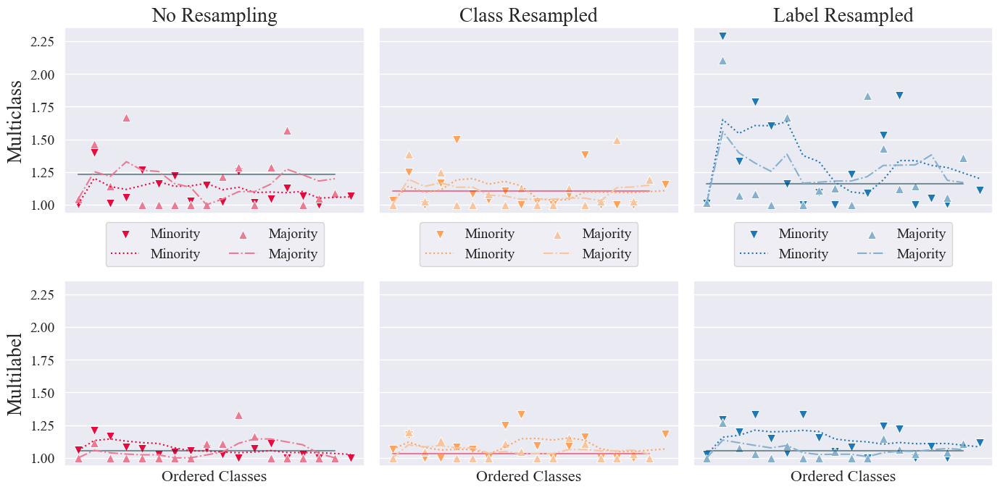

In [ ]:
major_minor_class_results_v3(majority_clas_results, minority_clas_results, average_middle_clas_results, 'Mean Error');
plt.savefig(os.path.join(PLOTS, 'article', 'majority_minority_mean_error_dist.png'), bbox_inches='tight')

#### Figures V5

In [134]:
[display(p) for p in PALS]

[(0.9372549019607843, 0.9176470588235294, 0.9019607843137255),
 (0.8817070357554787, 0.7161245674740484, 0.7107727797001153),
 (0.8248366013071896, 0.5098039215686274, 0.5150326797385621),
 (0.7657977700884275, 0.3054825067281815, 0.32124567474048443),
 (0.5281045751633987, 0.27189542483660134, 0.29411764705882354),
 (0.2847520184544406, 0.23750865051903114, 0.26634371395617074),
 (0.047058823529411764, 0.20392156862745098, 0.23921568627450981)]

[(0.9372549019607843, 0.9176470588235294, 0.9019607843137255),
 (0.914002306805075, 0.7858823529411765, 0.7107727797001153),
 (0.8901960784313726, 0.6509803921568628, 0.5150326797385621),
 (0.8662821991541715, 0.5168166089965398, 0.3215686274509804),
 (0.8339869281045752, 0.44705882352941184, 0.3215686274509804),
 (0.8009227220299885, 0.37564013840830457, 0.3215686274509804),
 (0.7686274509803922, 0.3058823529411765, 0.3215686274509804)]

[(0.9372549019607843, 0.9176470588235294, 0.9019607843137255),
 (0.7266897347174164, 0.762629757785467, 0.8322029988465974),
 (0.5111111111111112, 0.603921568627451, 0.7607843137254902),
 (0.29705497885428683, 0.44610534409842373, 0.6884275278738946),
 (0.21437908496732028, 0.36601307189542487, 0.5398692810457517),
 (0.12973471741637832, 0.28401384083044984, 0.38777393310265285),
 (0.047058823529411764, 0.20392156862745098, 0.23921568627450981)]

[(0.9372549019607843, 0.9176470588235294, 0.9019607843137255),
 (0.7383160322952711, 0.8323875432525951, 0.73919261822376),
 (0.534640522875817, 0.7450980392156863, 0.5725490196078431),
 (0.33221068819684735, 0.657039600153787, 0.4071818531334102),
 (0.23790849673202613, 0.5071895424836601, 0.35163398692810455),
 (0.141361014994233, 0.35377162629757786, 0.29476355247981545),
 (0.047058823529411764, 0.20392156862745098, 0.23921568627450981)]

[None, None, None, None]

In [137]:
BWPAL

[(0.0, 0.0, 0.0),
 (0.07450980392156863, 0.07450980392156863, 0.07450980392156863),
 (0.15294117647058825, 0.15294117647058825, 0.15294117647058825),
 (0.23137254901960785, 0.23137254901960785, 0.23137254901960785),
 (0.3058823529411765, 0.3058823529411765, 0.3058823529411765),
 (0.38431372549019605, 0.38431372549019605, 0.38431372549019605),
 (0.4627450980392157, 0.4627450980392157, 0.4627450980392157),
 (0.5372549019607843, 0.5372549019607843, 0.5372549019607843),
 (0.615686274509804, 0.615686274509804, 0.615686274509804),
 (0.6941176470588235, 0.6941176470588235, 0.6941176470588235),
 (0.7686274509803921, 0.7686274509803921, 0.7686274509803921),
 (0.8470588235294118, 0.8470588235294118, 0.8470588235294118),
 (0.9254901960784314, 0.9254901960784314, 0.9254901960784314),
 (1.0, 1.0, 1.0)]

In [143]:
def major_minor_class_results_v5(major_results, minor_results, avg_middle_results, met, yscaling, axes):
    avg_middle_results = avg_middle_results.reset_index().drop(EVAL_COL, axis=1).set_index([TRAIN_COL, MODEL_COL])
    min_mk = 10 #'^'
    maj_mk = 11 #'v'
    mid_stl = '-' #reference_lines[2]
    
    for t, train in enumerate(major_results[TRAIN_COL].unique()):
        for m, model in enumerate(model_names):
            LEG0 = False # m==0
            LEG1 = False # m==0
            ax = axes[m][t]
            LEG = False

            major = major_results[(major_results[TRAIN_COL] == train) & (major_results[MODEL_COL] == model)].sort_values('Class Rank', ascending=True)
            major = smooth_data(major, met)
            minor = minor_results[(minor_results[TRAIN_COL] == train) & (minor_results[MODEL_COL] == model)].sort_values('Class Rank', ascending=True)
            minor['Class Rank'] = minor['Class Rank'] - 46
            minor = smooth_data(minor, met)
            
            sns.lineplot(x=[1, 17], y=[avg_middle_results.loc[(train, model), met]]*2, ax=ax, linestyle=mid_stl, zorder=2, linewidth=1.5, alpha=0.5,
                         color=PALS[t][3], label='Baseline' if LEG else None, legend=LEG)
            
            sns.scatterplot(data=minor, x='Class Rank', y=met, ax=ax, s=30, marker=min_mk, zorder=1,
                label='Minority' if LEG0 else None, legend=LEG0, alpha=0.75,
                color=PALS[t][4],
                # color='none',
                # linewidth=1.25, edgecolor=PALS[t][4]
                )
            sns.lineplot(data=minor, x='Class Rank', y=f'{met} Smoothed', ax=ax, linestyle=reference_lines[1], zorder=3, linewidth=1.75, alpha=1.,
                label='Minority' if LEG1 else None, color=PALS[t][3], legend=LEG1)
            
            sns.scatterplot(data=major, x='Class Rank', y=met, ax=ax, s=30, marker=maj_mk, zorder=1,
                label='Majority' if LEG0 else None, legend=LEG0, alpha=0.75,
                color=PALS[t][2],
                # color='none',
                # linewidth=1.25, edgecolor=PALS[t][2]
                )
            sns.lineplot(data=major, x='Class Rank', y=f'{met} Smoothed', ax=ax, linestyle=reference_lines[0], zorder=3, linewidth=1.75, alpha=1.,
                label='Majority' if LEG1 else None, color=PALS[t][3], legend=LEG1)
            ax.xaxis.set_major_locator(ticker.MultipleLocator(2))
            ax.set_xlabel('')
            if t == 0:
                # ax.set_ylabel(f"{abbreviations[met]}\n{abbreviations[model]}", fontsize=LBL_SIZE)
                ax.set_ylabel(f"{abbreviations[model]}", fontsize=LBL_SIZE)
            else:
                ax.set_ylabel('')
            ax.set_xticks([])
            ax.tick_params(axis='both', labelsize=TICK_SIZE-2, pad=-3)
          
            # ax = axes[0][0]  
            # top = yscaling[model][train]
            top = yscaling[MC][BASE]
            step = top / 3
            buff = top * 0.05
            ticks = [0, step, step*2]
            labels = ["0.0", "", f"{step*2:.1f}"] if t == 0 else ["", "", ""]
            ax.yaxis.set_major_locator(ticker.MultipleLocator(step, 0))
            ax.set_ylim(-buff, top-buff)
            ax.set_yticks(ticks=ticks, labels=labels)
            
                
    return fig

In [144]:
yscales = {
    cRec: {
        MC: {
            BASE: 1.2,
            CB: 0.3,
            LB: 0.9,
            AB: 0.3
        },
        ML: {
            BASE: 0.6,
            CB: 0.15,
            LB: 0.45,
            AB: 0.3,
        }
    },
    cPrec: {
        MC: {
            BASE: 1.2,
            CB: 0.3,
            LB: 0.6,
            AB: 0.6,
        },
        ML: {
            BASE: 0.45,
            CB: 0.3,
            LB: 0.45,
            AB: 0.3
        }
    },
    cF1: {
        MC: {
            BASE: 1.2,
            CB: 0.3,
            LB: 0.75,
            AB: 0.45,
        },
        ML: {
            BASE: 0.45,
            CB: 0.15,
            LB: 0.3,
            AB: 0.15,
        }
    },
}

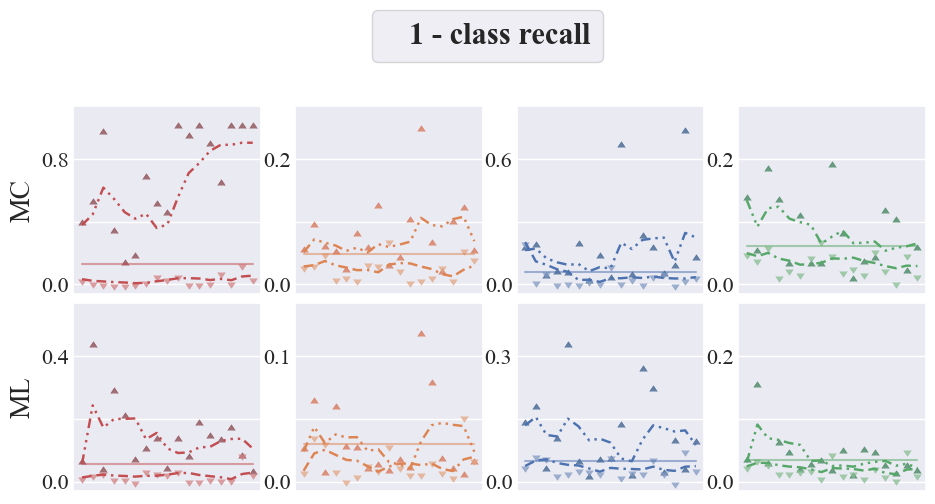

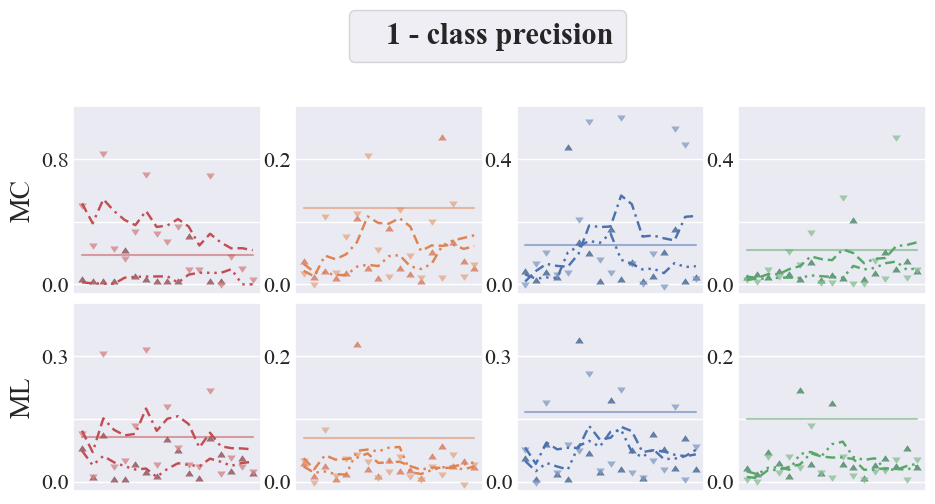

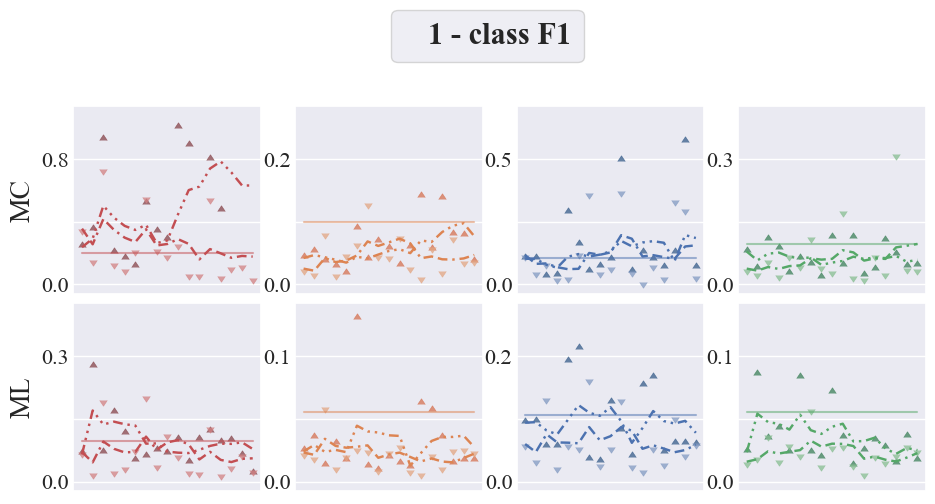

In [300]:

# fig, axes = plt.subplots(6, 4, figsize=(11, 12), sharey=False)


for m, met in enumerate(pc_metrics):
    fig, axes = plt.subplots(2, 4, figsize=(11, 5), sharey=False)
    # sub_axes = axes[2*m:2*m+2, :]
    major_minor_class_results_v5(majority_clas_results, minority_clas_results, average_middle_clas_results, met, yscales[met], axes)
    leg = axes[0, 1].legend(handles=[
        Line2D([0], [0], color='none', label=met),
        ],
        loc='lower center', bbox_to_anchor=(1.025, 1.15),
        handlelength=0,
        fontsize=LBL_LARGE, ncols=1,
        )
    leg.get_texts()[0].set_fontweight('bold')
    plt.subplots_adjust(hspace=0.05, wspace=0.18)
    
# for r, resamp in enumerate(resamplings):
#     axes[0,r].set_title(f"{abbreviations[resamp]}", fontsize=LBL_SIZE)
#     axes[-1,r].set_xlabel(f'Classes', fontsize=LBL_SIZE)
# # Build up legend:
# ax = axes[-1,1]
# hl = 1.55
# htp = 0.4
# cg = 1.5
# lg1 = ax.legend(handles=[
#     Line2D([0], [0], color='none', label="Class sets"),
#     # Line2D([0], [0], color='none', label=TRAIN_COL),
#     ] + [
#         Line2D([0], [0], color=BLACK, marker='v', markersize=11, markeredgecolor=GREY, markeredgewidth=1.5,
#             markerfacecolor='none', linestyle=reference_lines[0], lw=2.1, alpha=1., label="Majority"),
#         Line2D([0], [0], color=GREY, marker='.', markersize=0, markeredgecolor=BLACK, markeredgewidth=1.,
#             markerfacecolor='none', linestyle='-', lw=1.5, alpha=1., label="Middle"),
#         Line2D([0], [0], color=BLACK, marker='^', markersize=11, markeredgecolor=GREY, markeredgewidth=1.5,
#             markerfacecolor='none', linestyle=reference_lines[1], lw=2.1, alpha=1., label="Minority"),
#     ],
#         loc='upper center', bbox_to_anchor=(1.09, -0.15),
#         handlelength=hl, columnspacing=cg, handletextpad=htp,
#         fontsize=TICK_SIZE, ncols=4,
#         )

# legends = [lg1]
# lg1._legend_box.align = "left"


# bold_labels = [MODEL_COL, TRAIN_COL,
#             TRAIN_COL.replace(' ', '\n'), "Class sets"]
# for lts in [leg.get_texts() for leg in legends]:
#     for text in lts:
#         t = text.get_text()
#         if t in bold_labels:
#             text.set_fontweight('bold')
#             text.set_fontsize(TICK_SIZE)
# fig.savefig(os.path.join(PLOT_EVALS, f'per_class_{met.split(" ")[-1].lower()}.pdf'), bbox_inches='tight')

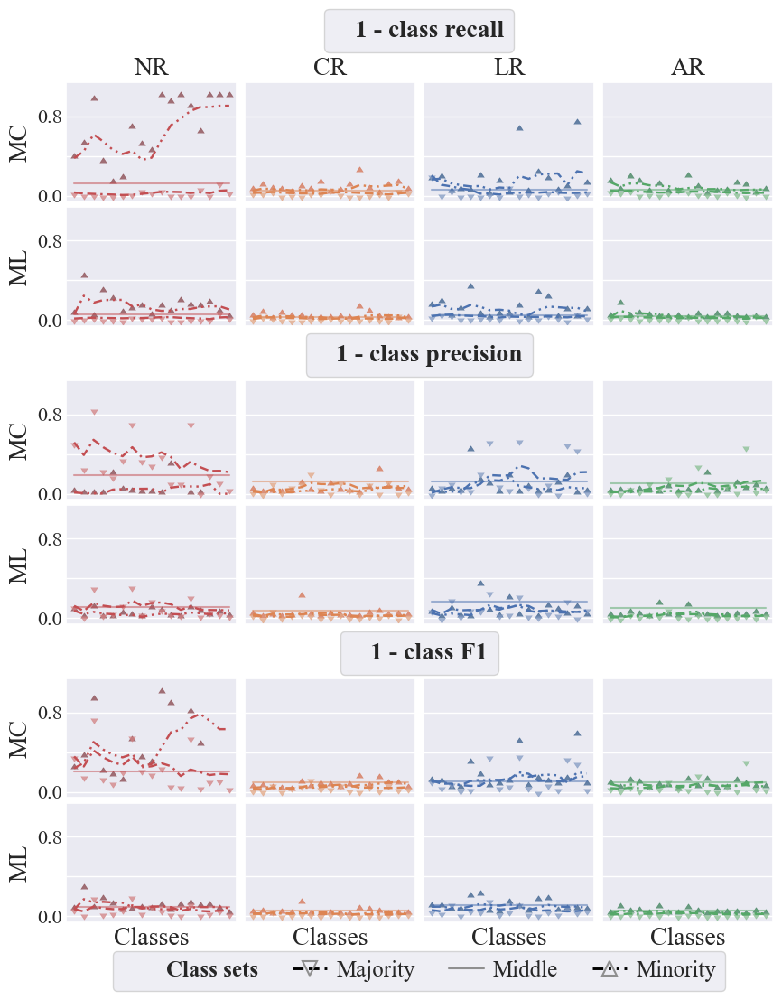

In [149]:

fig = plt.figure(figsize=(9, 11))

m = 0
lspace = 0.1
bsapce = 0.05
lgap = 0.01
bgap = 0.005
bgap_met = 0.055
axw = 0.21
axh = 0.12
axes = []

for m, met in enumerate(pc_metrics):
    top_h = 0.95 - axh - m * (2*axh+bgap+bgap_met)
    ax00 = fig.add_axes([lspace, top_h, axw, axh])
    ax01 = fig.add_axes([lspace+axw+lgap, top_h, axw, axh])
    ax02 = fig.add_axes([lspace+2*axw+2*lgap, top_h, axw, axh]) 
    ax03 = fig.add_axes([lspace+3*axw+3*lgap, top_h, axw, axh])

    ax10 = fig.add_axes([lspace, top_h-bgap-axh, axw, axh])
    ax11 = fig.add_axes([lspace+axw+lgap, top_h-bgap-axh, axw, axh])
    ax12 = fig.add_axes([lspace+2*axw+2*lgap, top_h-bgap-axh, axw, axh]) 
    ax13 = fig.add_axes([lspace+3*axw+3*lgap, top_h-bgap-axh, axw, axh])
    row1 = [ax00, ax01, ax02, ax03]
    row2 = [ax10, ax11, ax12, ax13]
    sub_axes = [row1,row2]
    
    axes.append(row1)
    axes.append(row2)
    
    lg_ht = 1.15 if m == 0 else 0.93
    major_minor_class_results_v5(majority_clas_results, minority_clas_results, average_middle_clas_results, met, yscales[met], sub_axes)
    leg = sub_axes[0][1].legend(handles=[
        Line2D([0], [0], color='none', label=met),
        ],
        loc='lower center', bbox_to_anchor=(1.02, lg_ht),
        handlelength=0,
        fontsize=LBL_SIZE, ncols=1,
        )
    leg.get_texts()[0].set_fontweight('bold')
    
for r, resamp in enumerate(resamplings):
    axes[0][r].set_title(f"{abbreviations[resamp]}", fontsize=LBL_SIZE)
    axes[-1][r].set_xlabel(f'Classes', fontsize=LBL_SIZE)
# Build up legend:
ax = axes[-1][1]
hl = 1.55
htp = 0.4
cg = 1.5
lg1 = ax.legend(handles=[
    Line2D([0], [0], color='none', label="Class sets"),
    # Line2D([0], [0], color='none', label=TRAIN_COL),
    ] + [
        Line2D([0], [0], color=BLACK, marker='v', markersize=11, markeredgecolor=GREY, markeredgewidth=1.5,
            markerfacecolor='none', linestyle=reference_lines[0], lw=2.1, alpha=1., label="Majority"),
        Line2D([0], [0], color=GREY, marker='.', markersize=0, markeredgecolor=BLACK, markeredgewidth=1.,
            markerfacecolor='none', linestyle='-', lw=1.5, alpha=1., label="Middle"),
        Line2D([0], [0], color=BLACK, marker='^', markersize=11, markeredgecolor=GREY, markeredgewidth=1.5,
            markerfacecolor='none', linestyle=reference_lines[1], lw=2.1, alpha=1., label="Minority"),
    ],
        loc='upper center', bbox_to_anchor=(1.02, -0.15),
        handlelength=hl, columnspacing=cg, handletextpad=htp,
        fontsize=TICK_SIZE, ncols=4,
        )

legends = [lg1]
lg1._legend_box.align = "left"


bold_labels = [MODEL_COL, TRAIN_COL,
            TRAIN_COL.replace(' ', '\n'), "Class sets"]
for lts in [leg.get_texts() for leg in legends]:
    for text in lts:
        t = text.get_text()
        if t in bold_labels:
            text.set_fontweight('bold')
            text.set_fontsize(TICK_SIZE)
            
# fig.subplots_adjust(wspace=0.0001)
fig.savefig(os.path.join(PLOT_EVALS, f'per_class_all_shared.pdf'), bbox_inches='tight')

#### Class 0

In [31]:
braille_test_pages = os.path.join('..', '..', 'Datasets', 'braille_angelina', 'test', 'images')
image_files = [t for t in os.walk(braille_test_pages)][0][2]

In [32]:
W = 30
H = 40

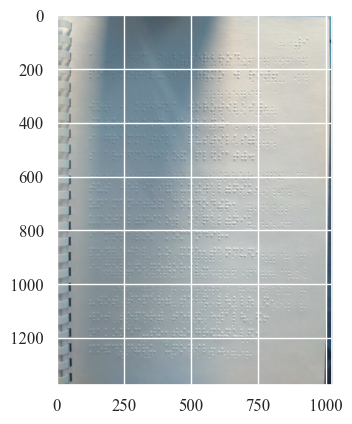

In [33]:
img = cv2.imread(os.path.join(braille_test_pages, image_files[10]))
plt.imshow(img)

In [34]:
img.shape

(1376, 1024, 3)

18.914155321551576


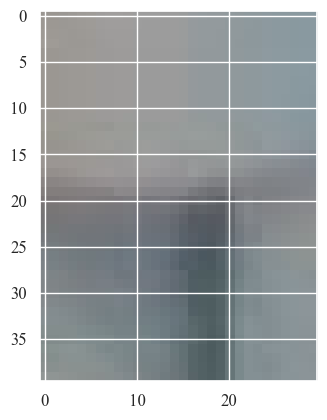

In [35]:
sub_img = img[1300:1340, 0:30]
print(sub_img.std())
plt.imshow(sub_img)

1.4275175625563488


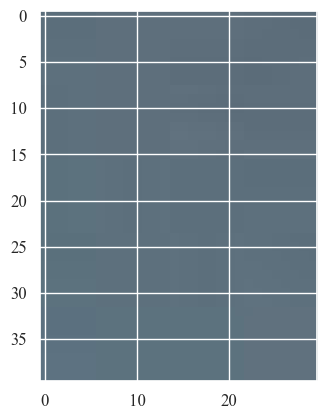

In [36]:
sub_img = img[80:120, 250:280]
print(sub_img.std(axis=(0,1)).mean())
plt.imshow(sub_img)

13.674042002691012


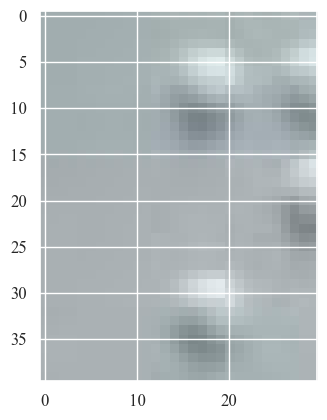

In [37]:
sub_img = img[800:840, 500:530]
print(sub_img.std())
plt.imshow(sub_img)

2.464377315987865


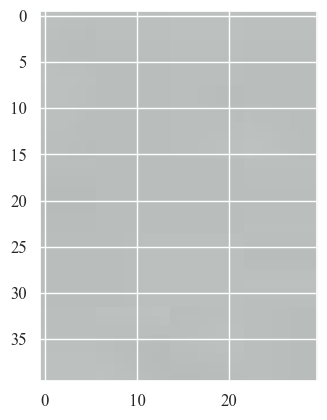

In [38]:
sub_img = img[800:840, 770:800]
print(sub_img.std())
plt.imshow(sub_img)

In [39]:

class0_X = []

for im_file in image_files:
    img = cv2.imread(os.path.join(braille_test_pages, im_file))
    widths = [r for r in range(W, img.shape[1], W)]
    heights = [r for r in range(H, img.shape[0], H)]
    for w in widths:
        for h in heights:
            sub_img = img[h-H:h, w-W:w]
            if sub_img.std(axis=(0,1)).mean() < 2:
                class0_X.append(sub_img)
len(class0_X)

11262

In [40]:
class0_Y = [[0,0,0,0,0,0]]*len(class0_X)

class0_X = np.array(class0_X)
class0_Y = np.array(class0_Y)

class0_X.shape, class0_Y.shape

((11262, 40, 30, 3), (11262, 6))

In [41]:
class0_Y_cat = ml_to_mc(class0_Y)
class0_Y_cat.shape

(11262, 64)

In [42]:
from torch.utils.data import TensorDataset, DataLoader

dev = 'cpu'

In [46]:
mod_names = [
    'NR MC',
    'NR ML',
    'CR MC',
    'CR ML',
    'LR MC',
    'LR ML',
    'AR MC',
    'AR ML'
]
mod_names

['NR MC', 'NR ML', 'CR MC', 'CR ML', 'LR MC', 'LR ML', 'AR MC', 'AR ML']

In [47]:
ml_dataset = DataLoader(
    TensorDataset(torch.Tensor(class0_X).to(dev),
                    torch.Tensor(class0_Y).to(dev)),
    batch_size=500)
mc_dataset = DataLoader(
    TensorDataset(torch.Tensor(class0_X).to(dev),
                    torch.Tensor(class0_Y_cat).to(dev)),
    batch_size=500)

class0_results = pd.DataFrame(columns=[MODEL_COL, cRec, cPrec, cF1])
class0_preds = {}
for m, model in enumerate(models):
    model_name = mod_names[m].replace('Base', 'NR').replace('B', 'R')
    if model.ML:
        ml_pred, ml_prob = model.predict(ml_dataset, return_proba=True, verbose=2)
        mc_pred = ml_to_mc(ml_pred)
    else:
        mc_pred, mc_prob = model.predict(mc_dataset, return_proba=True, verbose=2)
        mc_pred = num_to_cat(mc_pred)
        
    f1, prec, rec = per_class_F1(mc_pred, class0_Y_cat, return_PR=True)
    class0_preds[model_name] = [p.argmax() for p in mc_pred]
    class0_results.loc[m] = [model_name, rec[0], prec[0], f1[0]]
class0_preds = pd.DataFrame(class0_preds)


Obtaining model predictions:   0%|          | 0/23 [00:00<?, ?it/s]c:\Users\User\OneDrive\Uni\Braille Research\Braille ML\venv\Lib\site-packages\torchvision\transforms\functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).
  warnings.warn(
Obtaining model predictions: 100%|██████████| 23/23 [04:12<00:00, 10.98s/it]


In [48]:
class0_results.to_csv(os.path.join(EVAL, 'all_cbr_class0_results.csv'), index=False)
class0_results

,Model,1 - class recall,1 - class precision,1 - class F1
0,NR MC,0.000000,0.0,0.000000
1,NR ML,0.136743,1.0,0.240587
2,CR MC,0.000000,0.0,0.000000
3,CR ML,0.005150,1.0,0.010247
4,LR MC,0.000000,0.0,0.000000
5,LR ML,0.198544,1.0,0.331308
6,AR MC,0.000000,0.0,0.000000
7,AR ML,0.654058,1.0,0.790852


In [49]:
class0_preds.to_csv(os.path.join(EVAL, 'all_cbr_class0_preds.csv'), index=False)
class0_preds

,NR MC,NR ML,CR MC,CR ML,LR MC,LR ML,AR MC,AR ML
0,10,0,63,30,16,32,18,0
1,1,4,63,31,56,12,18,8
2,1,1,63,63,56,36,18,0
3,1,5,63,29,56,36,18,0
4,1,1,63,23,16,32,18,0
...,...,...,...,...,...,...,...,...
11257,10,1,63,31,56,6,18,0
11258,1,3,63,30,16,4,18,4
11259,1,1,63,63,39,32,18,32
11260,1,4,63,63,63,36,18,34


In [50]:
for model in class0_preds.columns:
    print(f"Model {model}")
    vcs = class0_preds[model].value_counts().to_frame()
    vcs.reset_index(drop=False, inplace=True)
    vcs.rename(columns={model: 'Class'}, inplace=True)
    vcs['Label'] = vcs['Class'].apply(num_to_bin_string)
    display(vcs[:10])
    print('-'*100)
    # break

Model NR MC


,Class,count,Label
0,1,6255,100000
1,10,4015,010100
2,17,708,100010
3,9,28,100100
4,13,26,101100
5,36,18,001001
6,5,16,101000
7,60,15,001111
8,25,14,100110
9,2,14,010000


----------------------------------------------------------------------------------------------------
Model NR ML


,Class,count,Label
0,1,6271,100000
1,0,1540,000000
2,5,933,101000
3,2,901,010000
4,3,510,110000
5,4,382,001000
6,6,106,011000
7,7,54,111000
8,9,44,100100
9,10,44,010100


----------------------------------------------------------------------------------------------------
Model CR MC


,Class,count,Label
0,63,10592,111111
1,44,102,001101
2,32,65,000001
3,54,49,011011
4,40,44,000101
5,30,42,011110
6,1,34,100000
7,52,27,001011
8,56,24,000111
9,4,21,001000


----------------------------------------------------------------------------------------------------
Model CR ML


,Class,count,Label
0,63,3234,111111
1,31,2279,111110
2,55,1037,111011
3,23,794,111010
4,62,652,011111
5,30,509,011110
6,61,251,101111
7,54,244,011011
8,22,208,011010
9,29,203,101110


----------------------------------------------------------------------------------------------------
Model LR MC


,Class,count,Label
0,56,6491,000111
1,63,2195,111111
2,16,1185,000010
3,39,329,111001
4,2,285,010000
5,1,209,100000
6,60,132,001111
7,15,57,111100
8,29,44,101110
9,57,30,100111


----------------------------------------------------------------------------------------------------
Model LR ML


,Class,count,Label
0,32,3304,000001
1,0,2236,000000
2,36,1313,001001
3,4,881,001000
4,1,299,100000
5,33,280,100001
6,2,209,010000
7,34,206,010001
8,37,204,101001
9,5,172,101000


----------------------------------------------------------------------------------------------------
Model AR MC


,Class,count,Label
0,18,10701,010010
1,4,124,001000
2,1,53,100000
3,8,39,000100
4,2,34,010000
5,16,30,000010
6,36,22,001001
7,32,20,000001
8,9,19,100100
9,51,12,110011


----------------------------------------------------------------------------------------------------
Model AR ML


,Class,count,Label
0,0,7366,000000
1,2,653,010000
2,4,638,001000
3,1,453,100000
4,16,276,000010
5,32,275,000001
6,8,213,000100
7,6,100,011000
8,36,88,001001
9,18,76,010010


----------------------------------------------------------------------------------------------------


In [51]:
with open(os.path.join('..', 'dicts', 'dataset_distributions.json'), 'r') as dfile:
    dataset_dists = json.loads(dfile.read())

In [55]:
train_freqs = {}

for dataset in dataset_dists.keys():
    if dataset in abbreviations:
        dset = abbreviations[dataset]
        cf = dataset_dists[dataset]['Class Frequencies']
        top_cf = np.argsort(cf)[::-1]
        print(f"Dataset {dset}:")
        print("Top 10 classes", top_cf[:10])
        train_freqs[dset] = cf
        print('-'*50)

Dataset NR:
Top 10 classes [21  1 17 10 30 29 14  7  5 23]
--------------------------------------------------
Dataset LR:
Top 10 classes [53 46  4 32  5 30 51 20 37 44]
--------------------------------------------------
Dataset CR:
Top 10 classes [21 42  8  4 32 10 17 34 30 51]
--------------------------------------------------
Dataset AR:
Top 10 classes [30 14 43  5 25 58 46 29  2 16]
--------------------------------------------------


In [60]:
dot_freqs = {}
dot_cors = {}

for dataset in dataset_dists.keys():
    if dataset in abbreviations:
        dset = abbreviations[dataset]
        df = dataset_dists[dataset]['Dot Frequencies']
        print(f"Dataset {dset}:")
        print("Dot Freqs", np.round(df, 3))
        
        dot_freqs[dset] = df
        dot_cors[dset] = dataset_dists[dataset]['Dot Correlations'][2]
        
        print('-'*50)

Dataset NR:
Dot Freqs [0.658 0.509 0.559 0.474 0.527 0.227]
--------------------------------------------------
Dataset LR:
Dot Freqs [0.489 0.487 0.641 0.441 0.468 0.556]
--------------------------------------------------
Dataset CR:
Dot Freqs [0.446 0.474 0.462 0.468 0.474 0.461]
--------------------------------------------------
Dataset AR:
Dot Freqs [0.502 0.575 0.534 0.543 0.544 0.444]
--------------------------------------------------


In [82]:
model_cfreqs = {
    
}

for model in class0_preds.columns:
    print(f"Model {model}")
    vcs = class0_preds[model].value_counts().to_frame()
    model_cfreqs[model] = vcs
    vcs.reset_index(drop=False, inplace=True)
    vcs.rename(columns={model: 'Class'}, inplace=True)
    vcs['Label'] = vcs['Class'].apply(num_to_bin_string)
    
    print('-'*100)
    # break

Model NR MC
----------------------------------------------------------------------------------------------------
Model NR ML
----------------------------------------------------------------------------------------------------
Model CR MC
----------------------------------------------------------------------------------------------------
Model CR ML
----------------------------------------------------------------------------------------------------
Model LR MC
----------------------------------------------------------------------------------------------------
Model LR ML
----------------------------------------------------------------------------------------------------
Model AR MC
----------------------------------------------------------------------------------------------------
Model AR ML
----------------------------------------------------------------------------------------------------


In [83]:
model_dfreqs = {}
model_dcors = {}

for model in class0_preds.columns:
    print(f"Model {model}")
    preds = class0_preds[model]
    preds_ml = num_to_bin(preds)
    n = len(preds_ml)
    df = preds_ml.sum(axis=0) / n
    _, _, dcor = label_correlations(preds_ml)
    
    model_dfreqs[model] = df
    model_dcors[model] = dcor
    # break

Model NR MC
Model NR ML
Model CR MC
Model CR ML
Model LR MC
Model LR ML
Model AR MC
Model AR ML


In [84]:
class_freqs = pd.DataFrame(train_freqs)
class_freqs

,NR,LR,CR,AR
0,0.000000,0.000000,0.000000,0.000000
1,0.082175,0.004194,0.004465,0.006528
2,0.020905,0.020193,0.009946,0.029794
3,0.018248,0.009272,0.008682,0.020049
4,0.000938,0.040372,0.039865,0.007060
...,...,...,...,...
59,0.000029,0.007686,0.007590,0.008921
60,0.015087,0.020033,0.007088,0.018174
61,0.000058,0.012381,0.012226,0.014824
62,0.015447,0.014301,0.007349,0.017789


In [85]:
n

11262

In [ ]:
for mod, freqs in model_cfreqs.items():
    freqs2 = freqs.set_index('Class')
    freqs2.rename(columns={'count': mod}, inplace=True)
    class_freqs = pd.concat([class_freqs, freqs2[mod]/n], axis=1)
class_freqs.fillna(0.0, inplace=True)

In [89]:
class_freqs

,NR,LR,CR,AR,NR MC,NR ML,CR MC,CR ML,LR MC,LR ML,AR MC,AR ML
0,0.000000,0.000000,0.000000,0.000000,0.000000,0.136743,0.000000,0.005150,0.000000,0.198544,0.000000,0.654058
1,0.082175,0.004194,0.004465,0.006528,0.555408,0.556828,0.003019,0.002309,0.018558,0.026549,0.004706,0.040224
2,0.020905,0.020193,0.009946,0.029794,0.001243,0.080004,0.000266,0.000799,0.025306,0.018558,0.003019,0.057983
3,0.018248,0.009272,0.008682,0.020049,0.000710,0.045285,0.000710,0.000799,0.000444,0.004173,0.000000,0.006127
4,0.000938,0.040372,0.039865,0.007060,0.000977,0.033919,0.001865,0.002664,0.002486,0.078228,0.011010,0.056651
...,...,...,...,...,...,...,...,...,...,...,...,...
59,0.000029,0.007686,0.007590,0.008921,0.000000,0.000266,0.000355,0.014651,0.000089,0.001066,0.000444,0.000533
60,0.015087,0.020033,0.007088,0.018174,0.001332,0.002930,0.000089,0.008347,0.011721,0.002841,0.000444,0.001243
61,0.000058,0.012381,0.012226,0.014824,0.000000,0.000266,0.001332,0.022287,0.000622,0.001154,0.000178,0.004529
62,0.015447,0.014301,0.007349,0.017789,0.000000,0.000178,0.000622,0.057894,0.000622,0.001510,0.000178,0.000710


In [90]:
from scipy import stats

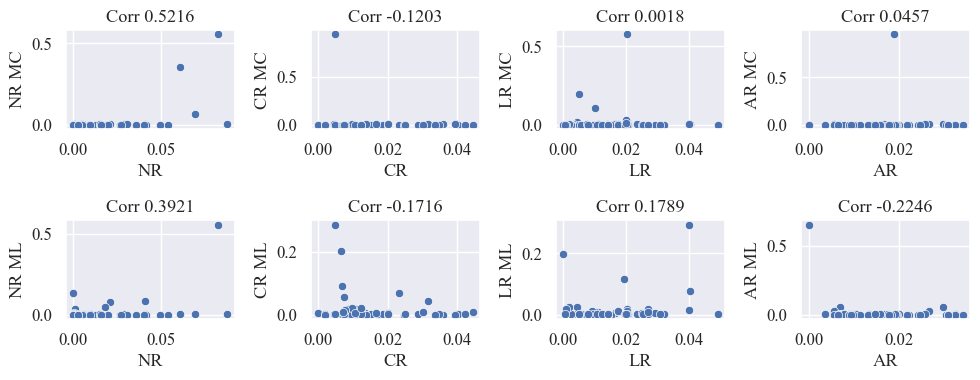

In [94]:
fig, axes = plt.subplots(2, 4, figsize=(10,4))

for r, resamp in enumerate(['NR', 'CR', 'LR', 'AR']):
    for m, mod in enumerate(['MC', 'ML']):
        ax = axes[m,r]
        xs = class_freqs[resamp]
        ys = class_freqs[f"{resamp} {mod}"]
        
        cor = stats.pearsonr(xs, ys)[0]
        sns.scatterplot(x=xs, y=ys, ax=ax)
        ax.set_title(f"Corr {round(cor, 4)}")
plt.tight_layout()

In [99]:
dot_freqs = pd.DataFrame(dot_freqs)
dot_freqs

,NR,LR,CR,AR,AR ML
0,0.658495,0.489055,0.446491,0.502413,0.092968
1,0.509290,0.487372,0.474329,0.574524,0.115788
2,0.559170,0.641139,0.462460,0.533776,0.121026
3,0.474035,0.440670,0.467941,0.543188,0.060291
4,0.526715,0.467666,0.474171,0.543614,0.077073
5,0.227280,0.555539,0.460839,0.444142,0.078583


In [100]:
for mod, freqs in model_dfreqs.items():
    dot_freqs[mod] = freqs
dot_freqs.fillna(0.0, inplace=True)
dot_freqs

,NR,LR,CR,AR,AR ML,NR MC,NR ML,CR MC,CR ML,LR MC,LR ML,AR MC
0,0.658495,0.489055,0.446491,0.502413,0.092968,0.631415,0.713017,0.956846,0.787604,0.267182,0.144291,0.016871
1,0.509290,0.487372,0.474329,0.574524,0.115788,0.364766,0.160273,0.962440,0.872936,0.265761,0.120849,0.964660
2,0.559170,0.641139,0.462460,0.533776,0.121026,0.012076,0.152016,0.970432,0.916800,0.259279,0.332090,0.024063
3,0.474035,0.440670,0.467941,0.543188,0.060291,0.370449,0.026549,0.973007,0.714172,0.808116,0.084798,0.015894
4,0.526715,0.467666,0.474171,0.543614,0.077073,0.072456,0.026017,0.963772,0.945836,0.904369,0.087640,0.964038
5,0.227280,0.555539,0.460839,0.444142,0.078583,0.007192,0.015184,0.979400,0.569082,0.825253,0.581335,0.013497


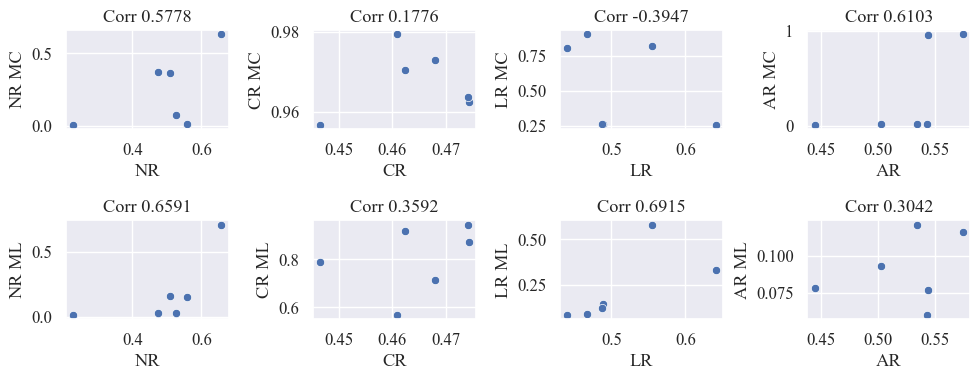

In [101]:
fig, axes = plt.subplots(2, 4, figsize=(10,4))

for r, resamp in enumerate(['NR', 'CR', 'LR', 'AR']):
    for m, mod in enumerate(['MC', 'ML']):
        ax = axes[m,r]
        xs = dot_freqs[resamp]
        ys = dot_freqs[f"{resamp} {mod}"]
        
        cor = stats.pearsonr(xs, ys)[0]
        sns.scatterplot(x=xs, y=ys, ax=ax)
        ax.set_title(f"Corr {round(cor, 4)}")
plt.tight_layout()

In [107]:
dot_correlations = pd.DataFrame()

for res, cor in dot_cors.items():
    dot_correlations[res] = np.array(cor).reshape((-1,))
for mod, cor in model_dcors.items():
    dot_correlations[mod] = cor.reshape((-1,))
dot_correlations.dropna(inplace=True)
dot_correlations

,NR,LR,CR,AR,NR MC,NR ML,CR MC,CR ML,LR MC,LR ML,AR MC,AR ML
1,-0.504238,0.060746,-0.026410,-0.097695,-0.978278,-0.420923,0.738730,0.157754,0.839254,0.125882,-0.274227,0.075255
2,0.079310,-0.078821,0.043484,0.001849,-0.125579,-0.087953,0.627038,0.162955,0.884842,0.070598,0.243604,0.123773
3,-0.403571,-0.100935,-0.154422,-0.030170,-0.966792,-0.234288,0.652079,0.049718,-0.022115,0.177574,0.414295,0.239593
4,0.009177,-0.006472,0.183014,-0.063027,0.316783,-0.294046,0.707985,0.285009,-0.397580,0.127246,-0.297533,0.198857
5,-0.300922,-0.042534,-0.055062,-0.098877,-0.424593,-0.415228,0.523668,0.025797,0.077467,-0.043295,0.363029,0.171345
6,-0.560371,0.060737,-0.026646,-0.095527,-0.973998,-0.276851,0.646728,0.104600,0.836410,0.108319,-0.563643,0.091370
8,-0.037707,-0.049279,-0.091830,-0.095712,-0.160826,-0.025754,0.666842,0.185021,0.875201,0.060459,-0.704869,0.101984
9,0.372000,0.055907,0.083064,0.065723,0.963338,0.306046,0.593595,0.090468,-0.065102,0.207764,-0.571509,0.129110
10,-0.103371,0.009962,-0.118794,-0.032513,-0.340412,0.245429,0.762109,0.413358,-0.458699,0.221790,0.747082,0.156655
11,0.118475,-0.036015,0.102929,-0.048204,-0.006791,0.157914,0.485370,0.023665,0.062199,-0.018314,-0.544376,0.150257


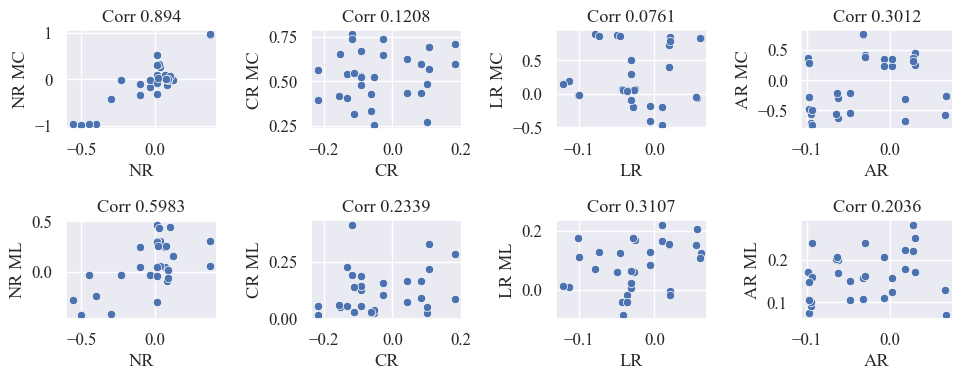

In [108]:
fig, axes = plt.subplots(2, 4, figsize=(10,4))

for r, resamp in enumerate(['NR', 'CR', 'LR', 'AR']):
    for m, mod in enumerate(['MC', 'ML']):
        ax = axes[m,r]
        xs = dot_correlations[resamp]
        ys = dot_correlations[f"{resamp} {mod}"]
        
        cor = stats.pearsonr(xs, ys)[0]
        sns.scatterplot(x=xs, y=ys, ax=ax)
        ax.set_title(f"Corr {round(cor, 4)}")
plt.tight_layout()

**NOTES**

*NR*:

MC model predicts mostly class 1 (100000) and class 10 (010100), and also class 17 (100010). All three these fall in top 4 most frequent classes in training set.  
ML model predicts more mostly class 1 (100000), some predictions for class 0, and moderately for classes 5 (101000), 2 (010000), 3 (110000), 4 (001000), 6 (011000) and 7 (111000). Indicates some bias to first three dot indices.


*CR*:

MC model predicts almost exclusively class 63 (111111), with some for class 44 (001101) and class 32 (000001). Only class 32 features in top 10 of training set.  
ML model predicts more moderately class 63 (111111), class 31 (111110), 55 (111011), 23 (111010), 62 (011111). Some bias to predicting dot presence in all indices.


*LR*:

MC model predicts mostly class 56 (000111), class 63 (111111), class 16 (000010) and class 39 (111001). None feature in top 10 of training set.  
ML model predicts more moderately class 32 (000001), class 0 (000000), 36 (001001) and 4 (001000). Some bias to predicting dot presence in index 4 and 6.

*AR*:

MC model predicts almost exclusively class 18 (010010), some for class 4 (001000) and 1 (100000). None feature in top 10 of training set.  
ML model predicts most prevalent class 0 (000000), some for class 2 (010000), 4 (001000) and 1 (100000). Some bias to predicting dot presence first three indices, rarely predicts more than one present dot.


#### Noise predictions

In [109]:
W = 30
H = 40

In [112]:

ss = 500
sample_x = np.random.uniform(size=(ss*20, H, W, 3)) # sample image data with float RGB values
sample_y = np.round(np.random.uniform(size=(ss*20, 6)), 0).astype(int) # sample multilabel target data
sample_Y_cat = ml_to_mc(sample_y)
ml_dataset = DataLoader(
    TensorDataset(torch.Tensor(sample_x).to(dev),
                    torch.Tensor(sample_y).to(dev)),
    batch_size=ss)
mc_dataset = DataLoader(
    TensorDataset(torch.Tensor(sample_x).to(dev),
                    torch.Tensor(ml_to_mc(sample_y)).to(dev)),
    batch_size=ss)


In [111]:
sample_x.shape, sample_y.shape

((10000, 40, 30, 3), (10000, 6))

In [113]:

noise_preds = {}
for m, model in enumerate(models):
    model_name = mod_names[m].replace('Base', 'NR').replace('B', 'R')
    if model.ML:
        ml_pred, ml_prob = model.predict(ml_dataset, return_proba=True, verbose=2)
        mc_pred = ml_to_mc(ml_pred)
    else:
        mc_pred, mc_prob = model.predict(mc_dataset, return_proba=True, verbose=2)
        mc_pred = num_to_cat(mc_pred)
        
    noise_preds[model_name] = [p.argmax() for p in mc_pred]
noise_preds = pd.DataFrame(noise_preds)


Obtaining model predictions:   0%|          | 0/20 [00:00<?, ?it/s]c:\Users\User\OneDrive\Uni\Braille Research\Braille ML\venv\Lib\site-packages\torchvision\transforms\functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).
  warnings.warn(
Obtaining model predictions: 100%|██████████| 20/20 [04:49<00:00, 14.45s/it]


In [114]:
noise_preds.to_csv(os.path.join(EVAL, 'all_cbr_noise_preds.csv'), index=False)
noise_preds

,NR MC,NR ML,CR MC,CR ML,LR MC,LR ML,AR MC,AR ML
0,1,59,63,63,63,63,15,47
1,1,7,63,63,57,63,15,11
2,1,17,63,55,1,62,39,0
3,1,29,63,55,57,29,63,49
4,10,41,63,23,63,38,39,44
...,...,...,...,...,...,...,...,...
9995,1,11,63,63,56,15,15,31
9996,10,27,63,61,63,63,39,61
9997,1,43,45,47,57,47,63,46
9998,1,29,63,63,1,63,39,63


In [115]:
model_cfreqs = {
    
}

for model in noise_preds.columns:
    print(f"Model {model}")
    vcs = noise_preds[model].value_counts().to_frame()
    model_cfreqs[model] = vcs
    vcs.reset_index(drop=False, inplace=True)
    vcs.rename(columns={model: 'Class'}, inplace=True)
    vcs['Label'] = vcs['Class'].apply(num_to_bin_string)
    
    # print('-'*100)
    # break

Model NR MC
Model NR ML
Model CR MC
Model CR ML
Model LR MC
Model LR ML
Model AR MC
Model AR ML


In [116]:
model_dfreqs = {}
model_dcors = {}

for model in noise_preds.columns:
    print(f"Model {model}")
    preds = noise_preds[model]
    preds_ml = num_to_bin(preds)
    n = len(preds_ml)
    df = preds_ml.sum(axis=0) / n
    _, _, dcor = label_correlations(preds_ml)
    
    model_dfreqs[model] = df
    model_dcors[model] = dcor
    # break

Model NR MC
Model NR ML
Model CR MC
Model CR ML
Model LR MC
Model LR ML
Model AR MC
Model AR ML


In [117]:
class_freqs = pd.DataFrame(train_freqs)
class_freqs

,NR,LR,CR,AR
0,0.000000,0.000000,0.000000,0.000000
1,0.082175,0.004194,0.004465,0.006528
2,0.020905,0.020193,0.009946,0.029794
3,0.018248,0.009272,0.008682,0.020049
4,0.000938,0.040372,0.039865,0.007060
...,...,...,...,...
59,0.000029,0.007686,0.007590,0.008921
60,0.015087,0.020033,0.007088,0.018174
61,0.000058,0.012381,0.012226,0.014824
62,0.015447,0.014301,0.007349,0.017789


In [118]:
n = ss * 20

In [119]:
for mod, freqs in model_cfreqs.items():
    freqs2 = freqs.set_index('Class')
    freqs2.rename(columns={'count': mod}, inplace=True)
    class_freqs = pd.concat([class_freqs, freqs2[mod]/n], axis=1)
class_freqs.fillna(0.0, inplace=True)

In [120]:
class_freqs

,NR,LR,CR,AR,NR MC,NR ML,CR MC,CR ML,LR MC,LR ML,AR MC,AR ML
0,0.000000,0.000000,0.000000,0.000000,0.0000,0.0033,0.0000,0.0002,0.0000,0.0012,0.0000,0.0155
1,0.082175,0.004194,0.004465,0.006528,0.5345,0.0601,0.0000,0.0003,0.1218,0.0017,0.0037,0.0136
2,0.020905,0.020193,0.009946,0.029794,0.0005,0.0074,0.0000,0.0010,0.0318,0.0020,0.0193,0.0115
3,0.018248,0.009272,0.008682,0.020049,0.0001,0.0252,0.0000,0.0037,0.0005,0.0035,0.0000,0.0083
4,0.000938,0.040372,0.039865,0.007060,0.0000,0.0032,0.0002,0.0013,0.0027,0.0020,0.0401,0.0143
...,...,...,...,...,...,...,...,...,...,...,...,...
59,0.000029,0.007686,0.007590,0.008921,0.0000,0.0138,0.0000,0.0430,0.0000,0.0329,0.0000,0.0170
60,0.015087,0.020033,0.007088,0.018174,0.0065,0.0104,0.0000,0.0074,0.0517,0.0142,0.0068,0.0225
61,0.000058,0.012381,0.012226,0.014824,0.0000,0.0154,0.0000,0.0460,0.0002,0.0345,0.0000,0.0194
62,0.015447,0.014301,0.007349,0.017789,0.0000,0.0115,0.0000,0.0416,0.0013,0.0725,0.0000,0.0201


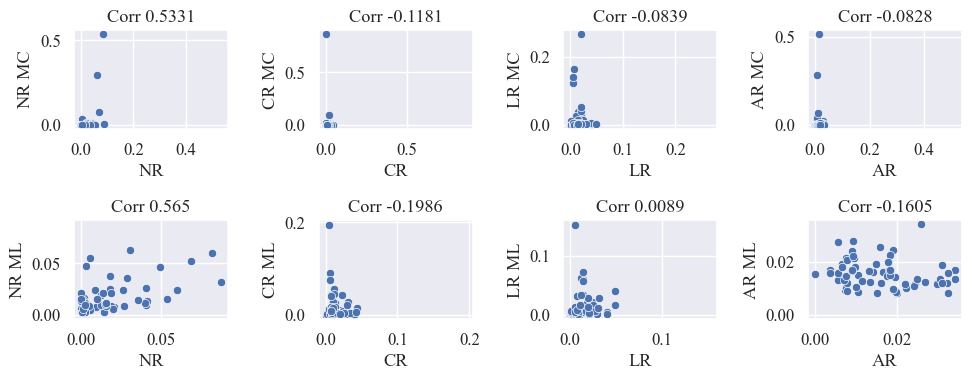

In [129]:
fig, axes = plt.subplots(2, 4, figsize=(10,4))

for r, resamp in enumerate(['NR', 'CR', 'LR', 'AR']):
    for m, mod in enumerate(['MC', 'ML']):
        ax = axes[m,r]
        xs = class_freqs[resamp]
        ys = class_freqs[f"{resamp} {mod}"]
        
        cor = stats.pearsonr(xs, ys)[0]
        sns.scatterplot(x=xs, y=ys, ax=ax)
        ax.set_title(f"Corr {round(cor, 4)}")
        xl = ax.get_xlim()
        yl = ax.get_ylim()
        lims = (min(xl[0], yl[0]), max(xl[1], yl[1]))
        ax.set_xlim(lims)
        ax.set_ylim(lims)
        # ax.set_aspect('equal')
plt.tight_layout()

In [122]:
dot_freqs = pd.DataFrame(dot_freqs)
dot_freqs

,NR,LR,CR,AR,AR ML,NR MC,NR ML,CR MC,CR ML,LR MC,LR ML,AR MC
0,0.658495,0.489055,0.446491,0.502413,0.092968,0.631415,0.713017,0.956846,0.787604,0.267182,0.144291,0.016871
1,0.509290,0.487372,0.474329,0.574524,0.115788,0.364766,0.160273,0.962440,0.872936,0.265761,0.120849,0.964660
2,0.559170,0.641139,0.462460,0.533776,0.121026,0.012076,0.152016,0.970432,0.916800,0.259279,0.332090,0.024063
3,0.474035,0.440670,0.467941,0.543188,0.060291,0.370449,0.026549,0.973007,0.714172,0.808116,0.084798,0.015894
4,0.526715,0.467666,0.474171,0.543614,0.077073,0.072456,0.026017,0.963772,0.945836,0.904369,0.087640,0.964038
5,0.227280,0.555539,0.460839,0.444142,0.078583,0.007192,0.015184,0.979400,0.569082,0.825253,0.581335,0.013497


In [123]:
for mod, freqs in model_dfreqs.items():
    dot_freqs[mod] = freqs
dot_freqs.fillna(0.0, inplace=True)
dot_freqs

,NR,LR,CR,AR,AR ML,NR MC,NR ML,CR MC,CR ML,LR MC,LR ML,AR MC
0,0.658495,0.489055,0.446491,0.502413,0.4464,0.6648,0.7567,0.9895,0.7995,0.5758,0.6679,0.8702
1,0.509290,0.487372,0.474329,0.574524,0.4576,0.3144,0.4349,0.8892,0.8007,0.2990,0.8069,0.8951
2,0.559170,0.641139,0.462460,0.533776,0.5295,0.0371,0.3813,0.9869,0.7983,0.3135,0.8042,0.9174
3,0.474035,0.440670,0.467941,0.543188,0.5072,0.3729,0.6259,0.9961,0.7134,0.7240,0.7063,0.6249
4,0.526715,0.467666,0.474171,0.543614,0.4921,0.1365,0.5009,0.8644,0.7648,0.7155,0.6541,0.0960
5,0.227280,0.555539,0.460839,0.444142,0.6117,0.0199,0.2880,0.8799,0.6481,0.7026,0.6997,0.3599


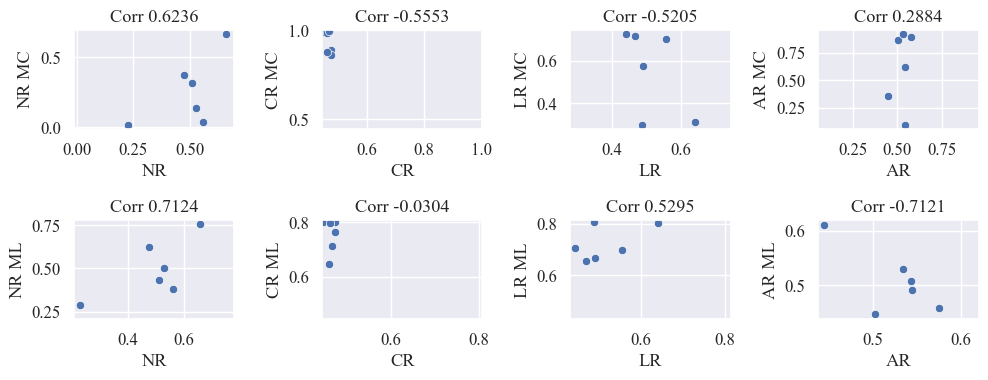

In [130]:
fig, axes = plt.subplots(2, 4, figsize=(10,4))

for r, resamp in enumerate(['NR', 'CR', 'LR', 'AR']):
    for m, mod in enumerate(['MC', 'ML']):
        ax = axes[m,r]
        xs = dot_freqs[resamp]
        ys = dot_freqs[f"{resamp} {mod}"]
        
        cor = stats.pearsonr(xs, ys)[0]
        sns.scatterplot(x=xs, y=ys, ax=ax)
        ax.set_title(f"Corr {round(cor, 4)}")
        xl = ax.get_xlim()
        yl = ax.get_ylim()
        lims = (min(xl[0], yl[0]), max(xl[1], yl[1]))
        ax.set_xlim(lims)
        ax.set_ylim(lims)
plt.tight_layout()

In [125]:
dot_correlations = pd.DataFrame()

for res, cor in dot_cors.items():
    dot_correlations[res] = np.array(cor).reshape((-1,))
for mod, cor in model_dcors.items():
    dot_correlations[mod] = cor.reshape((-1,))
dot_correlations.dropna(inplace=True)
dot_correlations

,NR,LR,CR,AR,NR MC,NR ML,CR MC,CR ML,LR MC,LR ML,AR MC,AR ML
1,-0.504238,0.060746,-0.026410,-0.097695,-0.879196,-0.213576,0.077511,-0.033586,0.338436,-0.054736,0.914671,0.035968
2,0.079310,-0.078821,0.043484,0.001849,0.115776,-0.062014,0.646828,0.037009,0.277796,-0.009051,0.883887,-0.058077
3,-0.403571,-0.100935,-0.154422,-0.030170,-0.890348,-0.119661,0.349839,-0.027210,-0.214084,0.009459,0.156621,0.066758
4,0.009177,-0.006472,0.183014,-0.063027,0.051369,-0.028924,0.069755,0.068058,-0.289276,0.044316,-0.183665,0.086128
5,-0.300922,-0.042534,-0.055062,-0.098877,-0.037404,-0.151810,0.078911,0.038340,-0.173996,-0.014419,0.151559,-0.028473
6,-0.560371,0.060737,-0.026646,-0.095527,-0.850441,-0.285103,0.735013,-0.033435,0.290418,-0.038450,0.760358,0.036125
8,-0.037707,-0.049279,-0.091830,-0.095712,-0.278926,-0.062428,0.537462,-0.045329,0.725607,0.039317,0.599590,0.038939
9,0.372000,0.055907,0.083064,0.065723,0.836707,0.135367,-0.059751,0.015556,-0.106974,0.045249,0.090239,0.007223
10,-0.103371,0.009962,-0.118794,-0.032513,-0.301317,-0.044966,0.817109,0.012367,-0.214848,0.009753,-0.106351,0.066877
11,0.118475,-0.036015,0.102929,-0.048204,0.325238,0.081191,0.788192,0.049838,-0.066892,0.002437,0.118302,-0.021530


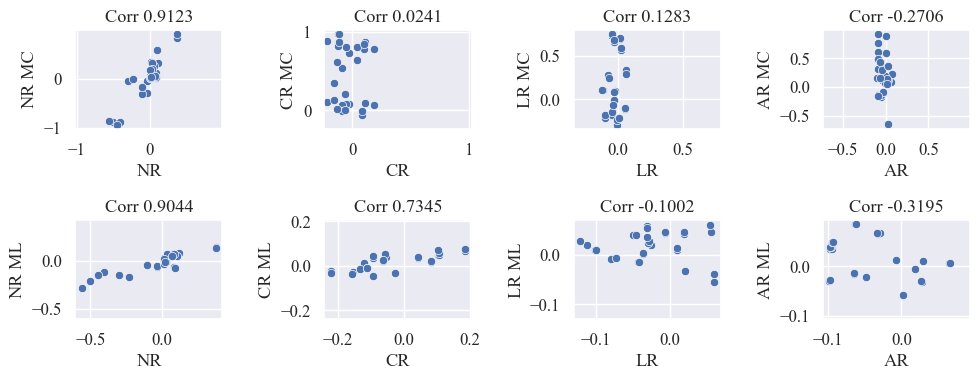

In [131]:
fig, axes = plt.subplots(2, 4, figsize=(10,4))

for r, resamp in enumerate(['NR', 'CR', 'LR', 'AR']):
    for m, mod in enumerate(['MC', 'ML']):
        ax = axes[m,r]
        xs = dot_correlations[resamp]
        ys = dot_correlations[f"{resamp} {mod}"]
        
        cor = stats.pearsonr(xs, ys)[0]
        sns.scatterplot(x=xs, y=ys, ax=ax)
        ax.set_title(f"Corr {round(cor, 4)}")
        xl = ax.get_xlim()
        yl = ax.get_ylim()
        lims = (min(xl[0], yl[0]), max(xl[1], yl[1]))
        ax.set_xlim(lims)
        ax.set_ylim(lims)
plt.tight_layout()

### Blank and Noise preds

In [133]:
blank_preds = pd.read_csv(os.path.join(EVAL, 'all_cbr_class0_preds.csv'))
noise_preds = pd.read_csv(os.path.join(EVAL, 'all_cbr_noise_preds.csv'))

all_preds = pd.concat([blank_preds, noise_preds], axis=0)
AP_N = all_preds.shape[0]
all_preds

,NR MC,NR ML,CR MC,CR ML,LR MC,LR ML,AR MC,AR ML
0,10,0,63,30,16,32,18,0
1,1,4,63,31,56,12,18,8
2,1,1,63,63,56,36,18,0
3,1,5,63,29,56,36,18,0
4,1,1,63,23,16,32,18,0
...,...,...,...,...,...,...,...,...
9995,1,11,63,63,56,15,15,31
9996,10,27,63,61,63,63,39,61
9997,1,43,45,47,57,47,63,46
9998,1,29,63,63,1,63,39,63


In [140]:
class_freqs = pd.DataFrame(train_freqs)
dot_freqs = pd.DataFrame(dot_freqs)
dot_correlations = pd.DataFrame()
for res, cor in dot_cors.items():
    dot_correlations[res] = np.array(cor).reshape((-1,))

for model in all_preds.columns:
    print(f"Model {model}")
    preds = all_preds[model]
    cf = preds.value_counts().to_frame()
    cf.rename(columns={'count': model}, inplace=True)
    class_freqs = pd.concat([class_freqs, cf[model]/AP_N], axis=1)
    
    preds_ml = num_to_bin(preds)
    df = preds_ml.sum(axis=0) / AP_N
    _, _, dcor = label_correlations(preds_ml)
    dot_freqs[model] = df
    dot_correlations[model] = dcor.reshape((-1,))
    
class_freqs.fillna(0.0, inplace=True)
dot_freqs.fillna(0.0, inplace=True)
dot_correlations.dropna(inplace=True)

Model NR MC
Model NR ML
Model CR MC
Model CR ML
Model LR MC
Model LR ML
Model AR MC
Model AR ML


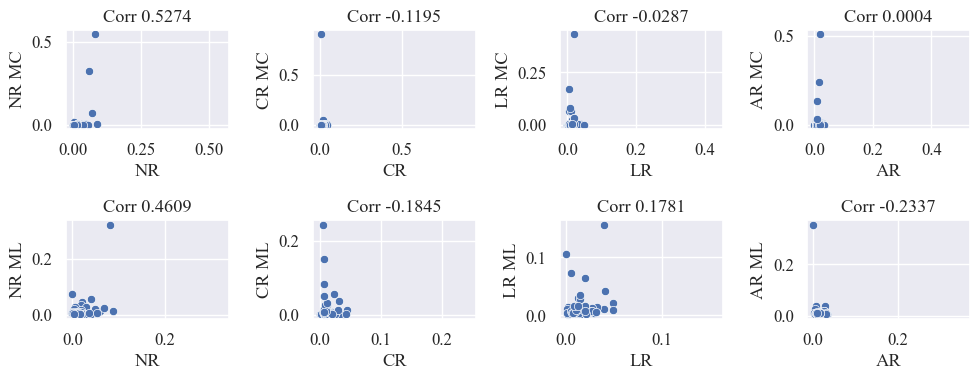

In [142]:
fig, axes = plt.subplots(2, 4, figsize=(10,4))

for r, resamp in enumerate(['NR', 'CR', 'LR', 'AR']):
    for m, mod in enumerate(['MC', 'ML']):
        ax = axes[m,r]
        xs = class_freqs[resamp]
        ys = class_freqs[f"{resamp} {mod}"]
        
        cor = stats.pearsonr(xs, ys)[0]
        sns.scatterplot(x=xs, y=ys, ax=ax)
        ax.set_title(f"Corr {round(cor, 4)}")
        xl = ax.get_xlim()
        yl = ax.get_ylim()
        lims = (min(xl[0], yl[0]), max(xl[1], yl[1]))
        ax.set_xlim(lims)
        ax.set_ylim(lims)
        # ax.set_aspect('equal')
plt.tight_layout()

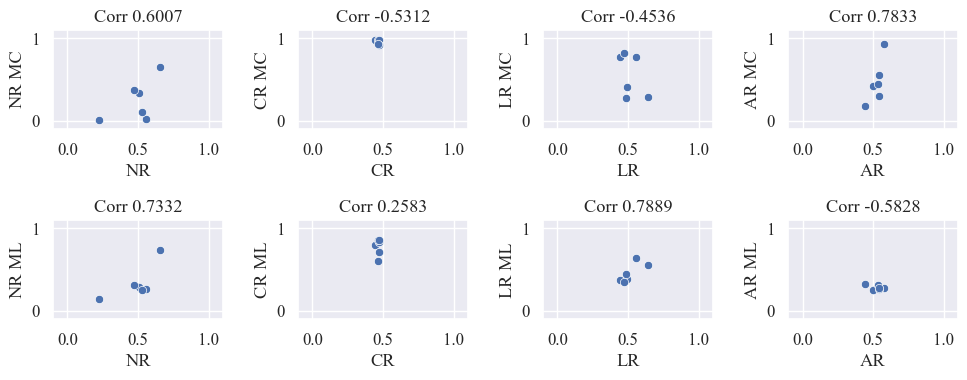

In [146]:
fig, axes = plt.subplots(2, 4, figsize=(10,4))

for r, resamp in enumerate(['NR', 'CR', 'LR', 'AR']):
    for m, mod in enumerate(['MC', 'ML']):
        ax = axes[m,r]
        xs = dot_freqs[resamp]
        ys = dot_freqs[f"{resamp} {mod}"]
        
        cor = stats.pearsonr(xs, ys)[0]
        sns.scatterplot(x=xs, y=ys, ax=ax)
        ax.set_title(f"Corr {round(cor, 4)}")
        xl = ax.get_xlim()
        yl = ax.get_ylim()
        lims = (min(xl[0], yl[0]), max(xl[1], yl[1]))
        ax.set_xlim((-.1,1.1))
        ax.set_ylim((-.1,1.1))
plt.tight_layout()

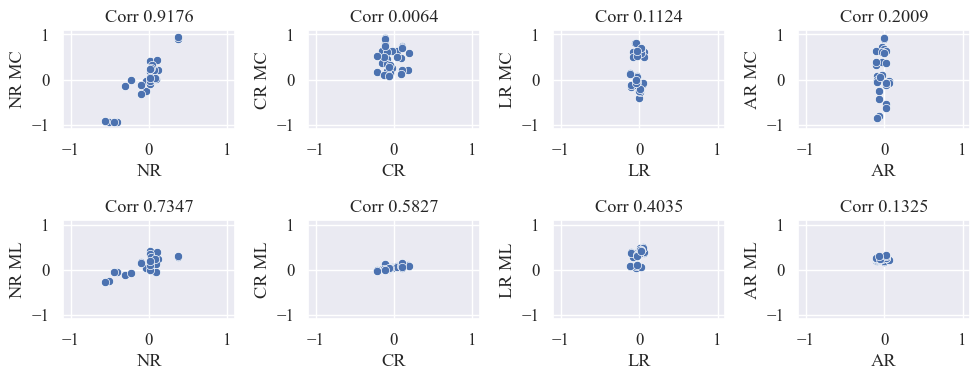

In [147]:
fig, axes = plt.subplots(2, 4, figsize=(10,4))

for r, resamp in enumerate(['NR', 'CR', 'LR', 'AR']):
    for m, mod in enumerate(['MC', 'ML']):
        ax = axes[m,r]
        xs = dot_correlations[resamp]
        ys = dot_correlations[f"{resamp} {mod}"]
        
        cor = stats.pearsonr(xs, ys)[0]
        sns.scatterplot(x=xs, y=ys, ax=ax)
        ax.set_title(f"Corr {round(cor, 4)}")
        xl = ax.get_xlim()
        yl = ax.get_ylim()
        lims = (min(xl[0], yl[0]), max(xl[1], yl[1]))
        ax.set_xlim((-1.1,1.1))
        ax.set_ylim((-1.1,1.1))
plt.tight_layout()

### Experiments Highlights

In [46]:
per_rotation_metrics

,Resampling Scenario,Model,Rotation,Absolute Rotation,Evaluation,Class error,Label error,Error distance,1 - class recall,1 - class precision,1 - class F1,1 - label recall,1 - label precision,1 - label F1
102,No Resampling,Multiclass,-25.000,25.000,Rotation Augmented,0.583771,0.153227,1.575105,0.708216,0.632099,0.584363,0.278561,0.098534,0.218551
103,No Resampling,Multiclass,-21.875,21.875,Rotation Augmented,0.468255,0.115715,1.482402,0.627242,0.507402,0.494375,0.223890,0.061952,0.163536
104,No Resampling,Multiclass,-18.750,18.750,Rotation Augmented,0.350491,0.081255,1.391227,0.505347,0.383227,0.382227,0.167936,0.035932,0.114454
105,No Resampling,Multiclass,-15.625,15.625,Rotation Augmented,0.241426,0.054412,1.351819,0.374728,0.273913,0.295385,0.112150,0.025421,0.074169
106,No Resampling,Multiclass,-12.500,12.500,Rotation Augmented,0.162829,0.035770,1.316522,0.309189,0.199302,0.212182,0.074148,0.015652,0.047430
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29,Adaptive Resampled,Multilabel,12.500,12.500,Rotation Augmented,0.134421,0.024342,1.085584,0.166347,0.331391,0.178244,0.040497,0.011369,0.026371
30,Adaptive Resampled,Multilabel,15.625,15.625,Rotation Augmented,0.313025,0.060914,1.168547,0.337062,0.486579,0.362593,0.101664,0.023778,0.066267
31,Adaptive Resampled,Multilabel,18.750,18.750,Rotation Augmented,0.529040,0.114574,1.299340,0.548141,0.619811,0.548970,0.199444,0.041628,0.135085
32,Adaptive Resampled,Multilabel,21.875,21.875,Rotation Augmented,0.695773,0.174086,1.501389,0.697332,0.707511,0.678346,0.302950,0.077872,0.223713


In [47]:
per_abs_rotation_metrics

,Resampling Scenario,Model,Absolute Rotation,Rotation,Evaluation,Class error,Label error,Error distance,1 - class recall,1 - class precision,1 - class F1,1 - label recall,1 - label precision,1 - label F1
54,No Resampling,Multiclass,0.000,0.0,Rotation Augmented,0.049510,0.011144,1.351048,0.114196,0.057648,0.066478,0.021165,0.005774,0.013674
55,No Resampling,Multiclass,3.125,0.0,Rotation Augmented,0.053099,0.011512,1.300402,0.126359,0.063687,0.070980,0.022072,0.005900,0.014237
56,No Resampling,Multiclass,6.250,0.0,Rotation Augmented,0.072812,0.015554,1.282851,0.147550,0.077797,0.092075,0.030125,0.007470,0.019230
57,No Resampling,Multiclass,9.375,0.0,Rotation Augmented,0.115690,0.024267,1.261719,0.214117,0.132358,0.145452,0.046010,0.012762,0.030470
58,No Resampling,Multiclass,12.500,0.0,Rotation Augmented,0.191484,0.040623,1.277775,0.298658,0.215078,0.226793,0.077325,0.018624,0.051102
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13,Adaptive Resampled,Multilabel,12.500,0.0,Rotation Augmented,0.159644,0.029318,1.099352,0.192836,0.345681,0.206841,0.049531,0.015408,0.033300
14,Adaptive Resampled,Multilabel,15.625,0.0,Rotation Augmented,0.332917,0.066731,1.201166,0.360394,0.489325,0.388338,0.115748,0.032702,0.078519
15,Adaptive Resampled,Multilabel,18.750,0.0,Rotation Augmented,0.541834,0.121672,1.346291,0.573073,0.615331,0.561370,0.216091,0.057891,0.153031
16,Adaptive Resampled,Multilabel,21.875,0.0,Rotation Augmented,0.708843,0.177910,1.506050,0.720515,0.705077,0.682089,0.313569,0.093866,0.238358


In [48]:
sterr_brightness_metrics.head()

,Resampling Scenario,Model,Evaluation,Class error,Label error,Error distance,1 - class recall,1 - class precision,1 - class F1,1 - label recall,1 - label precision,1 - label F1
6,No Resampling,Multiclass,Brightness Augmented,0.001330,0.000340,0.017098,0.011669,0.013188,0.006627,0.000864,0.000231,0.000485
7,No Resampling,Multilabel,Brightness Augmented,0.001425,0.000356,0.018970,0.014944,0.010325,0.010225,0.000377,0.000828,0.000454
2,Class Resampled,Multiclass,Brightness Augmented,0.003199,0.001148,0.014219,0.015073,0.018105,0.009194,0.002119,0.000957,0.001583
3,Class Resampled,Multilabel,Brightness Augmented,0.002494,0.000790,0.021718,0.016348,0.007796,0.007516,0.001740,0.000145,0.000903
4,Label Resampled,Multiclass,Brightness Augmented,0.002244,0.000829,0.023044,0.013114,0.011538,0.005740,0.000857,0.001616,0.001013


In [49]:
all_experiments_sterrs = pd.concat(
    [sterr_brightness_metrics,
    sterr_rotation_metrics,
    sterr_noise_metrics,
    sterr_blur_metrics]
    ).melt(
    id_vars=[EVAL_COL, TRAIN_COL, MODEL_COL],
    var_name=MET_COL, value_name=VAL_COL
)
all_experiments_sterrs[MG_COL] = all_experiments_sterrs[MET_COL].apply(
    lambda m: ('error' if m in met_group_lists['error'] else
            'class' if m in met_group_lists['class'] else
            'label')
)

all_experiments_sterrs.head()

,Evaluation,Resampling Scenario,Model,Metric,Value,Metric Type
0,Brightness Augmented,No Resampling,Multiclass,Class error,0.001330,error
1,Brightness Augmented,No Resampling,Multilabel,Class error,0.001425,error
2,Brightness Augmented,Class Resampled,Multiclass,Class error,0.003199,error
3,Brightness Augmented,Class Resampled,Multilabel,Class error,0.002494,error
4,Brightness Augmented,Label Resampled,Multiclass,Class error,0.002244,error


In [50]:
all_experiments_results = all_results[all_results[EVAL_COL].isin(exp_evals)].melt(
    id_vars=[EVAL_COL, TRAIN_COL, MODEL_COL],
    var_name=MET_COL, value_name=VAL_COL
)
all_experiments_results[MG_COL] = all_experiments_results[MET_COL].apply(
    lambda m: ('error' if m in met_group_lists['error'] else
            'class' if m in met_group_lists['class'] else
            'label')
)

all_experiments_results.head()

,Evaluation,Resampling Scenario,Model,Metric,Value,Metric Type
0,Brightness Augmented,No Resampling,Multiclass,Class error,0.105759,error
1,Brightness Augmented,No Resampling,Multilabel,Class error,0.059842,error
2,Brightness Augmented,Class Resampled,Multiclass,Class error,0.304078,error
3,Brightness Augmented,Class Resampled,Multilabel,Class error,0.074029,error
4,Brightness Augmented,Label Resampled,Multiclass,Class error,0.101243,error


In [51]:
list(zip(article_metrics, metrics))

[('1 - Class Accuracy', 'Class Accuracy'),
 ('1 - Label Accuracy', 'Label Accuracy'),
 ('Mean Error', 'Mean Error'),
 ('1 - Class Recall', 'Class Recall'),
 ('1 - Class Precision', 'Class Precision'),
 ('1 - Class F1', 'Class F1'),
 ('1 - Label Recall', 'Label Recall'),
 ('1 - Label Precision', 'Label Precision'),
 ('1 - Label F1', 'Label F1')]

#### Tables

In [52]:
hi = "High"
lo = "Low"
GR

NameError: name 'GR' is not defined

In [53]:
brt_lo = [1.0, 1.02, 1.04]
brt_hi = [1.26, 1.28, 1.3]

nse_lo = [0.0, 0.00625, 0.01250]
nse_hi = [0.08750, 0.09375, 0.1]

rot_lo = [0.0, 3.125, 6.25]
rot_hi = [18.75, 21.875, 25.0]

blr_lo = [0.0, 0.2, 0.4]
blr_hi = [2.6, 2.8, 3.0]

In [207]:

h = [TRAIN_COL, MODEL_COL, 'Brightness']
per_brightness_table = per_brightness_metrics[per_brightness_metrics['Brightness'].isin(
    brt_lo + brt_hi
    )][h + article_metric_names]

per_brightness_table['Brightness'] = per_brightness_table['Brightness'].apply(
    round, ndigits=1
    ).apply(
    lambda x: lo if x == 1 else hi
    )
per_brightness_table = per_brightness_table.groupby(h).agg('mean')
per_brightness_table.head(10)

C:\Users\User\AppData\Local\Temp\ipykernel_27620\2055700448.py:11: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  per_brightness_table = per_brightness_table.groupby(h).agg('mean')


Class error  Label error  \
Resampling Scenario Model      Brightness                             
No Resampling       Multiclass High           0.270541     0.078221   
                               Low            0.044574     0.009899   
                    Multilabel High           0.152820     0.038768   
                               Low            0.016581     0.003276   
Class Resampled     Multiclass High           0.797422     0.262545   
                               Low            0.014773     0.003163   
                    Multilabel High           0.237109     0.069035   
                               Low            0.013358     0.002675   
Label Resampled     Multiclass High           0.342575     0.097971   
                               Low            0.016312     0.003478   

                                           Error distance  1 - class recall  \
Resampling Scenario Model      Brightness                                     
No Resampling       Multiclass High              1.723300          0.437481   
                               Low               1.332252          0.112299   
                    Multilabel High              1.520437          0.214250   
                               Low               1.182575          0.031139   
Class Resampled     Multiclass High              1.972711          0.895074   
                               Low               1.272074          0.024672   
                    Multilabel High              1.735100          0.282440   
                               Low               1.204531          0.019232   
Label Resampled     Multiclass High              1.669120          0.399424   
                               Low               1.298096          0.019675   

                                           1 - class precision  1 - class F1  \
Resampling Scenario Model      Brightness                                      
No Resampling       Multiclass High                   0.145336      0.282752   
                               Low                    0.051514      0.063719   
                    Multilabel High                   0.294925      0.192870   
                               Low                    0.052240      0.027097   
Class Resampled     Multiclass High                   0.485859      0.692264   
                               Low                    0.046859      0.022671   
                    Multilabel High                   0.376057      0.246681   
                               Low                    0.067892      0.021744   
Label Resampled     Multiclass High                   0.366441      0.357028   
                               Low                    0.050314      0.022489   

                                           1 - label recall  \
Resampling Scenario Model      Brightness                     
No Resampling       Multiclass High                0.171121   
                               Low                 0.018878   
                    Multilabel High                0.018369   
                               Low                 0.006293   
Class Resampled     Multiclass High                0.388613   
                               Low                 0.003947   
                    Multilabel High                0.140430   
                               Low                 0.003657   
Label Resampled     Multiclass High                0.092213   
                               Low                 0.003854   

                                           1 - label precision  1 - label F1  
Resampling Scenario Model      Brightness                                     
No Resampling       Multiclass High                   0.014624      0.107363  
                               Low                    0.005166      0.012187  
                    Multilabel High                   0.069473      0.047560  
                               Low                    0.001333      0.003830  
Class Resampled     Multiclass High              

In [208]:
h = [TRAIN_COL, MODEL_COL, 'Noise']
per_noise_table = per_noise_metrics[per_noise_metrics['Noise'].isin(
    nse_lo + nse_hi
    )][h + article_metric_names]
per_noise_table['Noise'] = per_noise_table['Noise'].apply(
    round, ndigits=1
    ).apply(
    lambda x: lo if x == 0 else hi
    )
per_noise_table = per_noise_table.groupby(h).agg('mean')
per_noise_table.head(10)

C:\Users\User\AppData\Local\Temp\ipykernel_27620\2436111739.py:10: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  per_noise_table = per_noise_table.groupby(h).agg('mean')


Class error  Label error  \
Resampling Scenario Model      Noise                             
No Resampling       Multiclass High      0.131031     0.032663   
                               Low       0.046903     0.010400   
                    Multilabel High      0.066920     0.014281   
                               Low       0.015163     0.002842   
Class Resampled     Multiclass High      0.385144     0.128219   
                               Low       0.013513     0.002684   
                    Multilabel High      0.096024     0.023195   
                               Low       0.013443     0.002528   
Label Resampled     Multiclass High      0.125940     0.030296   
                               Low       0.018059     0.003776   

                                      Error distance  1 - class recall  \
Resampling Scenario Model      Noise                                     
No Resampling       Multiclass High         1.496920          0.254587   
                               Low          1.328972          0.111894   
                    Multilabel High         1.278262          0.123766   
                               Low          1.115634          0.028440   
Class Resampled     Multiclass High         1.986995          0.464213   
                               Low          1.192784          0.019916   
                    Multilabel High         1.447889          0.131843   
                               Low          1.127981          0.015627   
Label Resampled     Multiclass High         1.443770          0.155046   
                               Low          1.258314          0.019630   

                                      1 - class precision  1 - class F1  \
Resampling Scenario Model      Noise                                      
No Resampling       Multiclass High              0.132356      0.154874   
                               Low               0.053497      0.065436   
                    Multilabel High              0.174275      0.102077   
                               Low               0.046316      0.024030   
Class Resampled     Multiclass High              0.320539      0.364003   
                               Low               0.042836      0.019489   
                    Multilabel High              0.241836      0.133502   
                               Low               0.054443      0.021878   
Label Resampled     Multiclass High              0.238484      0.150270   
                               Low               0.054112      0.022953   

                                      1 - label recall  1 - label precision  \
Resampling Scenario Model      Noise                                          
No Resampling       Multiclass High           0.061365             0.015207   
                               Low            0.019816             0.005517   
                    Multilabel High           0.015613             0.015884   
                               Low            0.005511             0.001159   
Class Resampled     Multiclass High           0.016391             0.208053   
                               Low            0.002890             0.003280   
                    Multilabel High           0.005241             0.043918   
                               Low            0.002928             0.002724   
Label Resampled     Multiclass High           0.018147             0.046935   
                               Low            0.003908             0.004412   

                                      1 - label F1  
Resampling Scenario Model      Noise                
No Resampling       Multiclass High       0.039840  
                               Low        0.012861  
                    Multilabel High       0.015824  
                               Low        0.003349  
Class Resampled     Multiclass High       0.124742  
                               Low        0.003092  
                    Multilabel High       0.025058  
                             

In [209]:
h = [TRAIN_COL, MODEL_COL, 'Absolute Rotation']
per_abs_rotation_table = per_abs_rotation_metrics[per_abs_rotation_metrics['Absolute Rotation'].isin(
    rot_lo + rot_hi
    )][h + article_metric_names]

per_abs_rotation_table['Absolute Rotation'] = per_abs_rotation_table['Absolute Rotation'].apply(
    lambda x: round(x * 4, -2) / 100
    ).apply(
    lambda x: lo if x == 0 else hi
    )
per_abs_rotation_table = per_abs_rotation_table.groupby(h).agg('mean')
per_abs_rotation_table.head(10)

C:\Users\User\AppData\Local\Temp\ipykernel_27620\1525499091.py:11: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  per_abs_rotation_table = per_abs_rotation_table.groupby(h).agg('mean')


Class error  Label error  \
Resampling Scenario Model      Absolute Rotation                             
No Resampling       Multiclass High                  0.525223     0.131351   
                               Low                   0.058474     0.012737   
                    Multilabel High                  0.500515     0.106903   
                               Low                   0.021418     0.004021   
Class Resampled     Multiclass High                  0.524530     0.128320   
                               Low                   0.016266     0.003386   
                    Multilabel High                  0.604025     0.152153   
                               Low                   0.018012     0.003464   
Label Resampled     Multiclass High                  0.592535     0.164580   
                               Low                   0.026090     0.005339   

                                                  Error distance  \
Resampling Scenario Model      Absolute Rotation                   
No Resampling       Multiclass High                     1.485141   
                               Low                      1.311434   
                    Multilabel High                     1.269964   
                               Low                      1.148458   
Class Resampled     Multiclass High                     1.435189   
                               Low                      1.251107   
                    Multilabel High                     1.465507   
                               Low                      1.168967   
Label Resampled     Multiclass High                     1.631241   
                               Low                      1.230429   

                                                  1 - class recall  \
Resampling Scenario Model      Absolute Rotation                     
No Resampling       Multiclass High                       0.633774   
                               Low                        0.129368   
                    Multilabel High                       0.547218   
                               Low                        0.039091   
Class Resampled     Multiclass High                       0.555751   
                               Low                        0.024383   
                    Multilabel High                       0.637532   
                               Low                        0.023135   
Label Resampled     Multiclass High                       0.618085   
                               Low                        0.033519   

                                                  1 - class precision  \
Resampling Scenario Model      Absolute Rotation                        
No Resampling       Multiclass High                          0.538250   
                               Low                           0.066377   
                    Multilabel High                          0.564588   
                               Low                           0.058735   
Class Resampled     Multiclass High                          0.620581   
                               Low                           0.053004   
                    Multilabel High                          0.666073   
                               Low                           0.074548   
Label Resampled     Multiclass High                          0.669677   
                               Low                           0.075233   

                                                  1 - class F1  \
Resampling Scenario Model      Absolute Rotation                 
No Resampling       Multiclass High                   0.537753   
                               Low                    0.076511   
                    Multilabel High                   0.510718   
                               Low                    0.033495   
Class Resampled     Multiclass High                   0.528762   
                               Low                    0.023111   
                    Multilabel High               

In [210]:
h = [TRAIN_COL, MODEL_COL, 'Blur']
per_blur_table = per_blur_metrics[per_blur_metrics['Blur'].apply(round, 1).isin(
    blr_lo + blr_hi
    )][h + article_metric_names]
per_blur_table['Blur'] = per_blur_table['Blur'].apply(round, ndigits=0).apply(
    lambda x: lo if x == 0 else hi
    )
per_blur_table = per_blur_table.groupby(h).agg('mean')
per_blur_table.head(10)

C:\Users\User\AppData\Local\Temp\ipykernel_27620\206201900.py:2: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  per_blur_table = per_blur_metrics[per_blur_metrics['Blur'].apply(round, 1).isin(
C:\Users\User\AppData\Local\Temp\ipykernel_27620\206201900.py:8: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  per_blur_table = per_blur_table.groupby(h).agg('mean')


Class error  Label error  Error distance  \
Resampling Scenario Model      Blur                                             
No Resampling       Multiclass High     0.308193     0.086635        1.675707   
                               Low      0.045459     0.010281        1.356224   
                    Multilabel High     0.185679     0.040094        1.282170   
                               Low      0.015425     0.002913        1.128444   
Class Resampled     Multiclass High     0.090746     0.019839        1.301444   
                               Low      0.013512     0.002706        1.192709   
                    Multilabel High     0.124876     0.027147        1.277900   
                               Low      0.013861     0.002623        1.125891   
Label Resampled     Multiclass High     0.064387     0.012813        1.198147   
                               Low      0.019293     0.003883        1.210703   

                                     1 - class recall  1 - class precision  \
Resampling Scenario Model      Blur                                          
No Resampling       Multiclass High          0.475008             0.179574   
                               Low           0.113484             0.051351   
                    Multilabel High          0.241692             0.307282   
                               Low           0.027840             0.046672   
Class Resampled     Multiclass High          0.171608             0.184109   
                               Low           0.022400             0.039483   
                    Multilabel High          0.146381             0.270923   
                               Low           0.018325             0.067418   
Label Resampled     Multiclass High          0.090377             0.155273   
                               Low           0.021591             0.056979   

                                     1 - class F1  1 - label recall  \
Resampling Scenario Model      Blur                                   
No Resampling       Multiclass High      0.317440          0.187696   
                               Low       0.061934          0.019187   
                    Multilabel High      0.232839          0.082827   
                               Low       0.024695          0.005567   
Class Resampled     Multiclass High      0.124374          0.032943   
                               Low       0.019437          0.002766   
                    Multilabel High      0.147667          0.057635   
                               Low       0.021124          0.003189   
Label Resampled     Multiclass High      0.085123          0.013932   
                               Low       0.025467          0.004050   

                                     1 - label precision  1 - label F1  
Resampling Scenario Model      Blur                                     
No Resampling       Multiclass High             0.016289      0.119574  
                               Low              0.005471      0.012487  
                    Multilabel High             0.005201      0.046793  
                               Low              0.001080      0.003337  
Class Resampled     Multiclass High             0.011383      0.022387  
                               Low              0.003254      0.003016  
                    Multilabel High             0.005490      0.032733  
                               Low              0.002829      0.003015  
Label Resampled     Multiclass High             0.015068      0.014558  
                               Low              0.004611      0.004341

In [211]:
for res in resamplings:
    for model in model_style.keys():
        group = per_noise_table.loc[(res, model)]
        increase = (group.loc[hi] / group.loc[lo])
        per_noise_table.loc[(res, model, GR)] = increase
        
        group = per_abs_rotation_table.loc[(res, model)]
        increase = (group.loc[hi] / group.loc[lo])
        per_abs_rotation_table.loc[(res, model, GR)] = increase
        
        # group = per_abs_rotation_table_v2.loc[(res, model)]
        # increase = (group.loc[hi] / group.loc[lo])
        # per_abs_rotation_table_v2.loc[(res, model, GR)] = increase
        
        group = per_brightness_table.loc[(res, model)]
        increase = (group.loc[hi] / group.loc[lo])
        per_brightness_table.loc[(res, model, GR)] = increase
        
        group = per_blur_table.loc[(res, model)]
        increase = (group.loc[hi] / group.loc[lo])
        per_blur_table.loc[(res, model, GR)] = increase
        
        

C:\Users\User\AppData\Local\Temp\ipykernel_27620\2621229043.py:3: PerformanceWarning: indexing past lexsort depth may impact performance.
  group = per_noise_table.loc[(res, model)]
C:\Users\User\AppData\Local\Temp\ipykernel_27620\2621229043.py:7: PerformanceWarning: indexing past lexsort depth may impact performance.
  group = per_abs_rotation_table.loc[(res, model)]
C:\Users\User\AppData\Local\Temp\ipykernel_27620\2621229043.py:15: PerformanceWarning: indexing past lexsort depth may impact performance.
  group = per_brightness_table.loc[(res, model)]
C:\Users\User\AppData\Local\Temp\ipykernel_27620\2621229043.py:19: PerformanceWarning: indexing past lexsort depth may impact performance.
  group = per_blur_table.loc[(res, model)]
C:\Users\User\AppData\Local\Temp\ipykernel_27620\2621229043.py:3: PerformanceWarning: indexing past lexsort depth may impact performance.
  group = per_noise_table.loc[(res, model)]
C:\Users\User\AppData\Local\Temp\ipykernel_27620\2621229043.py:7: Performance

In [212]:
R = 3

In [238]:
per_brightness_table[per_brightness_table.index.get_level_values(2) == GR].sort_index().T[resamplings].round(R)

Resampling Scenario        No Resampling                       \
Model                         Multiclass           Multilabel   
Brightness          Generalisation Ratio Generalisation Ratio   
Class error                        6.070                9.216   
Label error                        7.902               11.832   
Error distance                     1.294                1.286   
1 - class recall                   3.896                6.880   
1 - class precision                2.821                5.646   
1 - class F1                       4.437                7.118   
1 - label recall                   9.065                2.919   
1 - label precision                2.831               52.116   
1 - label F1                       8.810               12.419   

Resampling Scenario      Class Resampled                       \
Model                         Multiclass           Multilabel   
Brightness          Generalisation Ratio Generalisation Ratio   
Class error                       53.979               17.750   
Label error                       83.008               25.808   
Error distance                     1.551                1.440   
1 - class recall                  36.278               14.686   
1 - class precision               10.368                5.539   
1 - class F1                      30.536               11.345   
1 - label recall                  98.463               38.401   
1 - label precision               45.826                0.943   
1 - label F1                     103.724               25.053   

Resampling Scenario      Label Resampled                       \
Model                         Multiclass           Multilabel   
Brightness          Generalisation Ratio Generalisation Ratio   
Class error                       21.002                1.154   
Label error                       28.171                1.127   
Error distance                     1.286                0.975   
1 - class recall                  20.301                1.240   
1 - class precision                7.283                1.136   
1 - class F1                      15.876                1.042   
1 - label recall                  23.925                1.247   
1 - label precision               28.598                1.122   
1 - label F1                      27.735                1.155   

Resampling Scenario   Adaptive Resampled                       
Model                         Multiclass           Multilabel  
Brightness          Generalisation Ratio Generalisation Ratio  
Class error                       25.549                1.562  
Label error                       33.633                1.545  
Error distance                     1.293                0.995  
1 - class recall                  17.690                1.594  
1 - class precision                4.836                1.416  
1 - class F1                      14.164                1.509  
1 - label recall                  29.704                2.084  
1 - label precision               30.527                0.951  
1 - label F1                      32.593                1.597

In [239]:
per_brightness_table[per_brightness_table.index.get_level_values(2) == GR].sort_index().T[resamplings].apply(stats.sem).round(R).to_frame().T

Resampling Scenario        No Resampling                       \
Model                         Multiclass           Multilabel   
Brightness          Generalisation Ratio Generalisation Ratio   
0                                  0.949                5.143   

Resampling Scenario      Class Resampled                       \
Model                         Multiclass           Multilabel   
Brightness          Generalisation Ratio Generalisation Ratio   
0                                  12.26                4.173   

Resampling Scenario      Label Resampled                       \
Model                         Multiclass           Multilabel   
Brightness          Generalisation Ratio Generalisation Ratio   
0                                  3.211                0.029   

Resampling Scenario   Adaptive Resampled                       
Model                         Multiclass           Multilabel  
Brightness          Generalisation Ratio Generalisation Ratio  
0                                  4.063                0.113

In [240]:
per_noise_table[per_noise_table.index.get_level_values(2) == GR].sort_index().T[resamplings].round(R)

Resampling Scenario        No Resampling                       \
Model                         Multiclass           Multilabel   
Noise               Generalisation Ratio Generalisation Ratio   
Class error                        2.794                4.413   
Label error                        3.141                5.024   
Error distance                     1.126                1.146   
1 - class recall                   2.275                4.352   
1 - class precision                2.474                3.763   
1 - class F1                       2.367                4.248   
1 - label recall                   3.097                2.833   
1 - label precision                2.756               13.700   
1 - label F1                       3.098                4.724   

Resampling Scenario      Class Resampled                       \
Model                         Multiclass           Multilabel   
Noise               Generalisation Ratio Generalisation Ratio   
Class error                       28.502                7.143   
Label error                       47.776                9.176   
Error distance                     1.666                1.284   
1 - class recall                  23.309                8.437   
1 - class precision                7.483                4.442   
1 - class F1                      18.678                6.102   
1 - label recall                   5.672                1.790   
1 - label precision               63.424               16.124   
1 - label F1                      40.340                8.847   

Resampling Scenario      Label Resampled                       \
Model                         Multiclass           Multilabel   
Noise               Generalisation Ratio Generalisation Ratio   
Class error                        6.974                6.202   
Label error                        8.023                7.594   
Error distance                     1.147                1.225   
1 - class recall                   7.898                6.522   
1 - class precision                4.407                5.017   
1 - class F1                       6.547                5.865   
1 - label recall                   4.644                1.917   
1 - label precision               10.639               10.107   
1 - label F1                       7.912                7.929   

Resampling Scenario   Adaptive Resampled                       
Model                         Multiclass           Multilabel  
Noise               Generalisation Ratio Generalisation Ratio  
Class error                       10.967                4.329  
Label error                       15.441                4.870  
Error distance                     1.404                1.121  
1 - class recall                  11.723                4.375  
1 - class precision                5.443                3.081  
1 - class F1                       8.286                3.797  
1 - label recall                   8.703                2.459  
1 - label precision               20.992                9.764  
1 - label F1                      15.066                5.412

In [241]:
per_noise_table[per_noise_table.index.get_level_values(2) == GR].sort_index().T[resamplings].apply(stats.sem).round(R).to_frame().T

Resampling Scenario        No Resampling                       \
Model                         Multiclass           Multilabel   
Noise               Generalisation Ratio Generalisation Ratio   
0                                   0.21                1.167   

Resampling Scenario      Class Resampled                       \
Model                         Multiclass           Multilabel   
Noise               Generalisation Ratio Generalisation Ratio   
0                                  6.967                1.494   

Resampling Scenario      Label Resampled                       \
Model                         Multiclass           Multilabel   
Noise               Generalisation Ratio Generalisation Ratio   
0                                  0.914                 0.94   

Resampling Scenario   Adaptive Resampled                       
Model                         Multiclass           Multilabel  
Noise               Generalisation Ratio Generalisation Ratio  
0                                  1.944                0.805

In [242]:
per_abs_rotation_table[per_abs_rotation_table.index.get_level_values(2) == GR].sort_index().T[resamplings].round(R)

Resampling Scenario        No Resampling                       \
Model                         Multiclass           Multilabel   
Absolute Rotation   Generalisation Ratio Generalisation Ratio   
Class error                        8.982               23.368   
Label error                       10.313               26.586   
Error distance                     1.132                1.106   
1 - class recall                   4.899               13.998   
1 - class precision                8.109                9.612   
1 - class F1                       7.028               15.248   
1 - label recall                   9.625               24.731   
1 - label precision               12.384               38.910   
1 - label F1                      11.886               32.224   

Resampling Scenario      Class Resampled                       \
Model                         Multiclass           Multilabel   
Absolute Rotation   Generalisation Ratio Generalisation Ratio   
Class error                       32.246               33.535   
Label error                       37.894               43.930   
Error distance                     1.147                1.254   
1 - class recall                  22.793               27.557   
1 - class precision               11.708                8.935   
1 - class F1                      22.879               21.563   
1 - label recall                  55.591               58.511   
1 - label precision               24.963               26.625   
1 - label F1                      41.979               52.181   

Resampling Scenario      Label Resampled                       \
Model                         Multiclass           Multilabel   
Absolute Rotation   Generalisation Ratio Generalisation Ratio   
Class error                       22.711               24.994   
Label error                       30.824               29.445   
Error distance                     1.326                1.150   
1 - class recall                  18.440               21.777   
1 - class precision                8.901               10.377   
1 - class F1                      16.505               18.442   
1 - label recall                  42.004               59.936   
1 - label precision               22.312               17.211   
1 - label F1                      33.901               32.041   

Resampling Scenario   Adaptive Resampled                       
Model                         Multiclass           Multilabel  
Absolute Rotation   Generalisation Ratio Generalisation Ratio  
Class error                       35.314               39.144  
Label error                       44.491               51.643  
Error distance                     1.230                1.292  
1 - class recall                  26.247               31.849  
1 - class precision               10.960                9.958  
1 - class F1                      24.623               25.236  
1 - label recall                  57.598               67.808  
1 - label precision               35.600               36.730  
1 - label F1                      50.569               65.603

In [243]:
per_abs_rotation_table[per_abs_rotation_table.index.get_level_values(2) == GR].sort_index().T[resamplings].apply(stats.sem).round(R).to_frame().T

Resampling Scenario        No Resampling                       \
Model                         Multiclass           Multilabel   
Absolute Rotation   Generalisation Ratio Generalisation Ratio   
0                                  1.181                3.916   

Resampling Scenario      Class Resampled                       \
Model                         Multiclass           Multilabel   
Absolute Rotation   Generalisation Ratio Generalisation Ratio   
0                                  5.428                6.312   

Resampling Scenario      Label Resampled                       \
Model                         Multiclass           Multilabel   
Absolute Rotation   Generalisation Ratio Generalisation Ratio   
0                                  4.187                5.498   

Resampling Scenario   Adaptive Resampled                       
Model                         Multiclass           Multilabel  
Absolute Rotation   Generalisation Ratio Generalisation Ratio  
0                                  6.075                7.598

In [246]:
per_blur_table[per_blur_table.index.get_level_values(2) == GR].sort_index().T[resamplings].round(4)

Resampling Scenario        No Resampling                       \
Model                         Multiclass           Multilabel   
Blur                Generalisation Ratio Generalisation Ratio   
Class error                       6.7796              12.0375   
Label error                       8.4270              13.7651   
Error distance                    1.2356               1.1362   
1 - class recall                  4.1857               8.6816   
1 - class precision               3.4970               6.5839   
1 - class F1                      5.1254               9.4287   
1 - label recall                  9.7824              14.8788   
1 - label precision               2.9774               4.8169   
1 - label F1                      9.5758              14.0217   

Resampling Scenario      Class Resampled                       \
Model                         Multiclass           Multilabel   
Blur                Generalisation Ratio Generalisation Ratio   
Class error                       6.7162               9.0093   
Label error                       7.3315              10.3490   
Error distance                    1.0912               1.1350   
1 - class recall                  7.6612               7.9881   
1 - class precision               4.6630               4.0186   
1 - class F1                      6.3988               6.9904   
1 - label recall                 11.9106              18.0755   
1 - label precision               3.4982               1.9407   
1 - label F1                      7.4226              10.8553   

Resampling Scenario      Label Resampled                       \
Model                         Multiclass           Multilabel   
Blur                Generalisation Ratio Generalisation Ratio   
Class error                       3.3374               3.2489   
Label error                       3.2993               3.0562   
Error distance                    0.9896               0.9453   
1 - class recall                  4.1858               3.3512   
1 - class precision               2.7251               2.8193   
1 - class F1                      3.3425               3.3715   
1 - label recall                  3.4403               5.8924   
1 - label precision               3.2676               2.5164   
1 - label F1                      3.3539               3.4047   

Resampling Scenario   Adaptive Resampled                       
Model                         Multiclass           Multilabel  
Blur                Generalisation Ratio Generalisation Ratio  
Class error                       7.9720               6.1512  
Label error                       9.7619               6.2176  
Error distance                    1.1942               1.0061  
1 - class recall                  7.9434               4.9424  
1 - class precision               4.0985               3.2859  
1 - class F1                      6.3453               5.2306  
1 - label recall                 16.5205               9.0289  
1 - label precision               1.8943               3.4434  
1 - label F1                      9.8111               6.7500

In [245]:
per_blur_table[per_blur_table.index.get_level_values(2) == GR].sort_index().T[resamplings].apply(stats.sem).round(R).to_frame().T

Resampling Scenario        No Resampling                       \
Model                         Multiclass           Multilabel   
Blur                Generalisation Ratio Generalisation Ratio   
0                                  1.021                1.559   

Resampling Scenario      Class Resampled                       \
Model                         Multiclass           Multilabel   
Blur                Generalisation Ratio Generalisation Ratio   
0                                   1.01                1.735   

Resampling Scenario      Label Resampled                       \
Model                         Multiclass           Multilabel   
Blur                Generalisation Ratio Generalisation Ratio   
0                                  0.292                0.426   

Resampling Scenario   Adaptive Resampled                       
Model                         Multiclass           Multilabel  
Blur                Generalisation Ratio Generalisation Ratio  
0                                  1.563                0.776

In [213]:

per_brightness_melt = pd.melt(per_brightness_table.reset_index(), id_vars=[TRAIN_COL, MODEL_COL, "Brightness"], var_name=MET_COL, value_name=VAL_COL)

per_brightness_melt[MG_COL] = per_brightness_melt[MET_COL].apply(
    lambda m: ('error' if m in met_group_lists['error'] else
            'class' if m in met_group_lists['class'] else
            'label')
)

per_noise_melt = pd.melt(per_noise_table.reset_index(), id_vars=[TRAIN_COL, MODEL_COL, "Noise"], var_name=MET_COL, value_name=VAL_COL)

per_noise_melt[MG_COL] = per_noise_melt[MET_COL].apply(
    lambda m: ('error' if m in met_group_lists['error'] else
            'class' if m in met_group_lists['class'] else
            'label')
)

per_abs_rotation_melt = pd.melt(per_abs_rotation_table.reset_index(), id_vars=[TRAIN_COL, MODEL_COL, "Absolute Rotation"], var_name=MET_COL, value_name=VAL_COL)

per_abs_rotation_melt[MG_COL] = per_abs_rotation_melt[MET_COL].apply(
    lambda m: ('error' if m in met_group_lists['error'] else
            'class' if m in met_group_lists['class'] else
            'label')
)

per_blur_melt = pd.melt(per_blur_table.reset_index(), id_vars=[TRAIN_COL, MODEL_COL, "Blur"], var_name=MET_COL, value_name=VAL_COL)

per_blur_melt[MG_COL] = per_blur_melt[MET_COL].apply(
    lambda m: ('error' if m in met_group_lists['error'] else
            'class' if m in met_group_lists['class'] else
            'label')
)

per_brightness_melt.tail(10)

,Resampling Scenario,Model,Brightness,Metric,Value,Metric Type
206,Adaptive Resampled,Multilabel,High,1 - label F1,0.004165,label
207,Adaptive Resampled,Multilabel,Low,1 - label F1,0.002607,label
208,No Resampling,Multiclass,Generalisation Ratio,1 - label F1,8.809767,label
209,No Resampling,Multilabel,Generalisation Ratio,1 - label F1,12.419246,label
210,Class Resampled,Multiclass,Generalisation Ratio,1 - label F1,103.723538,label
211,Class Resampled,Multilabel,Generalisation Ratio,1 - label F1,25.053028,label
212,Label Resampled,Multiclass,Generalisation Ratio,1 - label F1,27.735481,label
213,Label Resampled,Multilabel,Generalisation Ratio,1 - label F1,1.155365,label
214,Adaptive Resampled,Multiclass,Generalisation Ratio,1 - label F1,32.593398,label
215,Adaptive Resampled,Multilabel,Generalisation Ratio,1 - label F1,1.597280,label


In [214]:
brt_df = per_brightness_melt[per_brightness_melt["Brightness"] == GR].drop(columns=["Brightness"])
brt_df[EVAL_COL] = BRIGHT

nse_df = per_noise_melt[per_noise_melt["Noise"] == GR].drop(columns=["Noise"])
nse_df[EVAL_COL] = NOISE

rot_df = per_abs_rotation_melt[per_abs_rotation_melt["Absolute Rotation"] == GR].drop(columns=["Absolute Rotation"])
rot_df[EVAL_COL] = ROT

blr_df = per_blur_melt[per_blur_melt["Blur"] == GR].drop(columns=["Blur"])
blr_df[EVAL_COL] = BLUR

all_experiments = pd.concat([
    brt_df,
    nse_df,
    rot_df,
    blr_df
])

all_experiments[f"{VAL_COL} Log"] = all_experiments[VAL_COL].apply(np.log10)
all_experiments.head()

,Resampling Scenario,Model,Metric,Value,Metric Type,Evaluation,Value Log
16,No Resampling,Multiclass,Class error,6.069511,error,Brightness Augmented,0.783154
17,No Resampling,Multilabel,Class error,9.216497,error,Brightness Augmented,0.964566
18,Class Resampled,Multiclass,Class error,53.979238,error,Brightness Augmented,1.732227
19,Class Resampled,Multilabel,Class error,17.750349,error,Brightness Augmented,1.249207
20,Label Resampled,Multiclass,Class error,21.001648,error,Brightness Augmented,1.322253


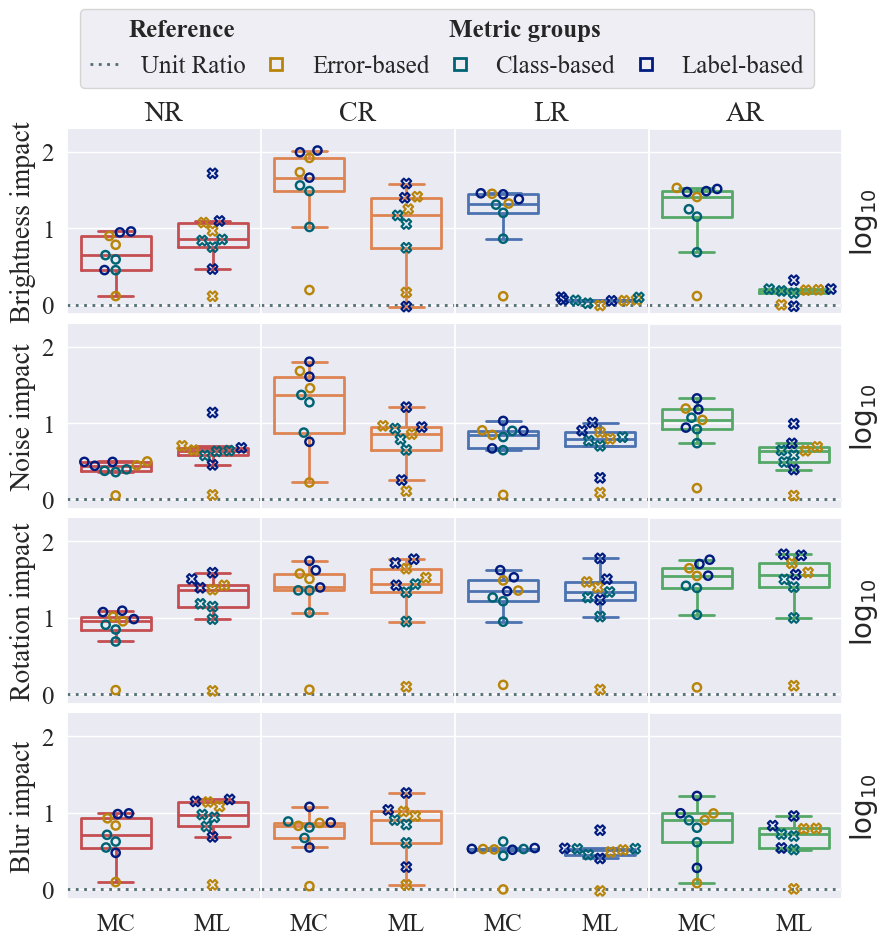

In [425]:
mg_palette = [TPAL[m] for k, m in met_group_color.items()]

cat = sns.catplot(
    data=all_experiments, kind="swarm",
    x=MODEL_COL, y=f"{VAL_COL} Log", hue=MG_COL, #hue_order=met_group_lists,
    col=TRAIN_COL, row=EVAL_COL,
    palette=mg_palette, hue_order=met_group_color,
    dodge=False, legend=False,
    height=2.5, aspect=1.,
    s=35, linewidth=1.75, zorder=3,
    facet_kws={
        'gridspec_kws': {
            'wspace': 0.,
            'hspace': 0.05
        }
    }
)
cat.set_titles("{col_name}")
axes = cat.axes

for row, exp_eval in enumerate(exp_evals):
    for col, ax in enumerate(axes[row]):
        res = ax.title.get_text()
        for c, collection in enumerate(ax.collections):
            model = model_names[c]
            color = collection.get_facecolor()
            collection.set_paths([markers[c]])
            collection.set_facecolor('none')
            collection.set_edgecolor(color)
            collection.set_sizes([marker_size[model]//2])
            if c == 1:
                collection.set_linewidth(1.5)
        box = sns.boxplot(data=all_experiments[
                            (all_experiments[TRAIN_COL] == res) & 
                            (all_experiments[EVAL_COL] == exp_eval)],
                        x=MODEL_COL, y=f"{VAL_COL} Log",
                        width=0.85, gap=0.15,
                        fill=None,
                        linewidth=2, ax=ax,
                        color=CPAL[col],
                        showfliers=False, zorder=2,
                    )
        xl = ax.get_xlim()
        ax.set_xlim(xl)
        yl = ax.get_ylim()
        ax.set_ylim(yl[0], 2.3)
        sns.lineplot(x=list(xl), y=[0, 0], color=DARK, alpha=0.7, linewidth=2, linestyle=reference_lines[-1], ax=ax, zorder=1)
        ax.set_ylabel(f"{exp_eval.split(' ')[0]} impact", fontsize=LBL_SIZE)
        ax.set_xlabel('', fontsize=LBL_SIZE)
        if col == 3:
            ax2 = ax.twinx()
            ax2.tick_params(axis='y', which='both', right=False, left=False, labelright=False, labelleft=False)
            ax.tick_params(axis='y', which='both', right=False, left=False)
            ax2.set_ylabel("$\log_{10}$", fontsize=LBL_SIZE)
            ax2.grid(False)
        
        if row == 0:
            ax.set_title(abbreviations[res], fontsize=LBL_SIZE)
        else:
            ax.set_title('', fontsize=LBL_SIZE)            
        ax.tick_params(axis='both', labelsize=TICK_SIZE)
        if row == 3 and col == 0:
            ticks = [mtext.Text(t, 0, abbreviations[tick.get_text()]) for t, tick in enumerate(ax.get_xticklabels())]
            ax.set_xticklabels(ticks)
        if row == 0 and col == 0:
            top_line = [
                Line2D([0], [0], color='none', label='Reference'),
                Line2D([0], [0], color='none', label='Metric groups')
            ]
            bot_line = [
                Line2D([0], [0], color=DARK, linestyle=reference_lines[-1], alpha=0.7, lw=2, label='Unit Ratio')
            ]
            for i, mg in enumerate(met_group_color.keys()):
                bot_line.append(Line2D([0], [0], color='none', alpha=1,
                                        marker='s', markersize=8,
                                        lw=0, markeredgecolor=TPAL[met_group_color[mg]], markeredgewidth=2.,
                                        label="{}-based".format(
                                            mg.capitalize()
                                        )))

            lg1 = ax.legend(handles=top_line, labels=[h.get_label() for h in top_line],
                    loc='lower left', bbox_to_anchor=(0., 1.15),
                    handlelength=.75, columnspacing=7.,
                    fontsize=TICK_SIZE, ncols=2,
                    #   frameon=False
                    )
            lg2 = mlegend.Legend(ax,
                                handles=bot_line,
                                labels=[h.get_label() for h in bot_line],
                                fontsize=TICK_SIZE, handlelength=1.25, columnspacing=0.6,
                                # loc='upper left', bbox_to_anchor=(1., 0.9),
                                ncol=4, frameon=False)

            for child in lg2._legend_box._children:
                lg1._legend_box._children.append(child)
            lg1._legend_box.align = "left"

            # Make only the desired labels bold
            bold_labels = [MODEL_COL, 'Metric groups', 'Reference']
            for text in (lg1.get_texts() + lg2.get_texts()):
                t = text.get_text()
                if t in bold_labels:
                    text.set_fontweight('bold')
                    text.set_fontsize(TICK_SIZE)
                if t in abbreviations:
                    text.set_text(abbreviations[t])

plt.savefig(os.path.join(PLOT_EVALS, 'experiment_generalisation_all.pdf'), bbox_inches='tight')


In [ ]:
axes[0]

array([<Axes: title={'center': 'No Resampling'}, ylabel='Value Log'>,
       <Axes: title={'center': 'Class Resampled'}>,
       <Axes: title={'center': 'Label Resampled'}>,
       <Axes: title={'center': 'Adaptive Resampled'}>], dtype=object)

#### Stats tests

In [54]:
from scipy.stats import friedmanchisquare, wilcoxon, shapiro, kruskal
import scikit_posthocs as sp


In [55]:
def sidak_adjust_alpha(a, m):
    return 1-pow(1-a, 1. / m)

def sidak_adjust_p(p, m):
    return 1 - pow(1 - p, m)



In [56]:
alpha = 0.05
num_compares = 3
alpha_adj = sidak_adjust_alpha(alpha, num_compares)
alpha_adj

0.016952427508441503

In [57]:
def mc_ml_stats_test(results, metric, indexing=[TRAIN_COL, EVAL_COL], use_errors=False, a=alpha):
    print(f"Metric: {metric}")
    alt = 'greater' if 'Error' in metric or use_errors else 'less'
    h0 = 'ML >= MC' if 'Error' in metric or use_errors else 'MC >= ML'
    metric_table = pd.pivot_table(data=results, values=metric, index=indexing, columns=MODEL_COL, observed=False)
    print(f"Number of paired samples: {metric_table.shape[0]}")
    
    shap_ml = shapiro(metric_table[ML])
    shap_mc = shapiro(metric_table[MC])
    print(f"Normality Test Multiclass. P-value {shap_mc.pvalue}. Reject H0 (normality) - {shap_mc.pvalue < a}")
    print(f"Normality Test Multilabel. P-value {shap_ml.pvalue}. Reject H0 (normality) - {shap_ml.pvalue < a}")
    wicox = wilcoxon(metric_table[MC], metric_table[ML], alternative=alt)
    print(f"Wilcoxon signed rank test. H0: {h0}. P-value {wicox.pvalue}. Reject H0 - {wicox.pvalue < a}")
    print('-'*50)
    
    return wicox

In [58]:
def mc_ml_stats_test_across_all(results, metrics, indexing=[TRAIN_COL, EVAL_COL], use_errors=True, a=alpha):
    alt = 'greater' if  use_errors else 'less'
    h0 = 'ML >= MC' if  use_errors else 'MC >= ML'
    metric_table = pd.concat([
        pd.pivot_table(data=results, values=metric, index=indexing, columns=MODEL_COL, observed=False)
        for metric in metrics])
    print(f"Number of paired samples: {metric_table.shape[0]}")
    
    shap_ml = shapiro(metric_table[ML])
    shap_mc = shapiro(metric_table[MC])
    print(f"Normality Test Multiclass. P-value {shap_mc.pvalue}. Reject H0 (normality) - {shap_mc.pvalue < a}")
    print(f"Normality Test Multilabel. P-value {shap_ml.pvalue}. Reject H0 (normality) - {shap_ml.pvalue < a}")
    wicox = wilcoxon(metric_table[MC], metric_table[ML], alternative=alt)
    print(f"Wilcoxon signed rank test. H0: {h0}. P-value {wicox.pvalue}. Reject H0 - {wicox.pvalue < a}")
    print('-'*50)
    return wicox

In [76]:

def resampling_stats_test(results, metric, indexing=[MODEL_COL, EVAL_COL], a=alpha):
    print(f"Metric: {metric}")
    metric_table = pd.pivot_table(data=results, values=metric, index=indexing, columns=TRAIN_COL, observed=False)[resamplings]
    # print(f"Number of paired samples: {metric_table.shape[0]}")
    
    shap_base = shapiro(metric_table[BASE])
    shap_cb = shapiro(metric_table[CB])
    shap_lb = shapiro(metric_table[LB])
    shap_ab = shapiro(metric_table[AB])
    # print(f"Normality Test No Resampling. P-value {shap_base.pvalue}. Reject H0 (normality) - {shap_base.pvalue < a}")
    # print(f"Normality Test Class Resampling. P-value {shap_cb.pvalue}. Reject H0 (normality) - {shap_cb.pvalue < a}")
    # print(f"Normality Test Label Resampling. P-value {shap_lb.pvalue}. Reject H0 (normality) - {shap_lb.pvalue < a}")
    # print(f"Normality Test Adaptive Resampling. P-value {shap_ab.pvalue}. Reject H0 (normality) - {shap_ab.pvalue < a}")
    fried = friedmanchisquare(*metric_table.to_numpy().T)
    reject = fried.pvalue < a
    print(f"Friedman Chi-square test. H0: All resampling equivalent. P-value {fried.pvalue}. Reject H0 - {reject}")
    nemenyi = pd.DataFrame()
    if reject:
        nemenyi = sp.posthoc_nemenyi_friedman(metric_table.to_numpy())
        print("Nemenyi posthoc test for pairwise comparison.")
        nemenyi.columns = resamplings
        nemenyi.index = resamplings
        display(nemenyi)
    print('-'*50)
    
    return fried.pvalue, nemenyi
    

In [60]:

def resampling_stats_test_across_all(results, metrics, indexing=[MODEL_COL, EVAL_COL], a=alpha):
    metric_table = pd.concat([
        pd.pivot_table(data=results, values=metric, index=indexing, columns=TRAIN_COL, observed=False)[resamplings]
        for metric in metrics])
    print(f"Number of paired samples: {metric_table.shape[0]}")
    
    shap_base = shapiro(metric_table[BASE])
    shap_cb = shapiro(metric_table[CB])
    shap_lb = shapiro(metric_table[LB])
    shap_ab = shapiro(metric_table[AB])
    print(f"Normality Test No Resampling. P-value {shap_base.pvalue}. Reject H0 (normality) - {shap_base.pvalue < a}")
    print(f"Normality Test Class Resampling. P-value {shap_cb.pvalue}. Reject H0 (normality) - {shap_cb.pvalue < a}")
    print(f"Normality Test Label Resampling. P-value {shap_lb.pvalue}. Reject H0 (normality) - {shap_lb.pvalue < a}")
    print(f"Normality Test Adaptive Resampling. P-value {shap_ab.pvalue}. Reject H0 (normality) - {shap_ab.pvalue < a}")
    fried = friedmanchisquare(*metric_table.to_numpy().T)
    reject = fried.pvalue < a
    print(f"Friedman Chi-square test. H0: All resampling equivalent. P-value {fried.pvalue}. Reject H0 - {reject}")
    nemenyi = pd.DataFrame()
    if reject:
        nemenyi = sp.posthoc_nemenyi_friedman(metric_table.to_numpy())
        print("Nemenyi posthoc test for pairwise comparison.")
        nemenyi.columns = resamplings
        nemenyi.index = resamplings
        display(nemenyi)
    print('-'*50)
    
    return fried.pvalue, nemenyi
    

##### MC ML Compare

In [61]:
per_blur_metrics.head()

,Resampling Scenario,Model,Blur,Evaluation,Class error,Label error,Error distance,1 - class recall,1 - class precision,1 - class F1,1 - label recall,1 - label precision,1 - label F1
96,No Resampling,Multiclass,0.0,Blur Augmented,0.047533,0.010408,1.310674,0.127121,0.051911,0.066611,0.018916,0.005885,0.012551
97,No Resampling,Multiclass,0.2,Blur Augmented,0.045525,0.010637,1.398741,0.107426,0.051999,0.061112,0.020532,0.005059,0.012978
98,No Resampling,Multiclass,0.4,Blur Augmented,0.043318,0.009797,1.359259,0.105905,0.050141,0.058081,0.018113,0.005469,0.011932
99,No Resampling,Multiclass,0.6,Blur Augmented,0.048833,0.011146,1.361339,0.105630,0.053842,0.067440,0.021097,0.005958,0.013736
100,No Resampling,Multiclass,0.8,Blur Augmented,0.056640,0.012208,1.289182,0.131298,0.066717,0.076779,0.023631,0.006161,0.015139


In [62]:
model_experiment_stats = {
    BRIGHT: {},
    NOISE: {},
    ROT: {},
    BLUR: {},
}
for metric in article_metric_names:
    print(f"Evaliation: {BRIGHT}")
    wc = mc_ml_stats_test(per_brightness_metrics, metric, indexing=[TRAIN_COL, EVAL_COL, 'Brightness'], use_errors=True, a=sidak_adjust_alpha(alpha, len(article_metric_names)))
    model_experiment_stats[BRIGHT][metric] = wc.pvalue
    print(f"Evaliation: {NOISE}")
    wc = mc_ml_stats_test(per_noise_metrics, metric, indexing=[TRAIN_COL, EVAL_COL, 'Noise'], use_errors=True, a=sidak_adjust_alpha(alpha, len(article_metric_names)))
    model_experiment_stats[NOISE][metric] = wc.pvalue
    print(f"Evaliation: {ROT}")
    wc = mc_ml_stats_test(per_abs_rotation_metrics, metric, indexing=[TRAIN_COL, EVAL_COL, 'Absolute Rotation'], use_errors=True, a=sidak_adjust_alpha(alpha, len(article_metric_names)))
    model_experiment_stats[ROT][metric] = wc.pvalue
    print(f"Evaliation: {BLUR}")
    wc = mc_ml_stats_test(per_blur_metrics, metric, indexing=[TRAIN_COL, EVAL_COL, 'Blur'], use_errors=True, a=sidak_adjust_alpha(alpha, len(article_metric_names)))
    model_experiment_stats[BLUR][metric] = wc.pvalue

Evaliation: Brightness Augmented
Metric: Class error
Number of paired samples: 64
Normality Test Multiclass. P-value 6.069645307584667e-10. Reject H0 (normality) - True
Normality Test Multilabel. P-value 8.433901636566469e-13. Reject H0 (normality) - True
Wilcoxon signed rank test. H0: ML >= MC. P-value 3.744352281607319e-12. Reject H0 - True
--------------------------------------------------
Evaliation: Noise Augmented
Metric: Class error
Number of paired samples: 68
Normality Test Multiclass. P-value 6.473541052293185e-10. Reject H0 (normality) - True
Normality Test Multilabel. P-value 4.0961547652140716e-07. Reject H0 (normality) - True
Wilcoxon signed rank test. H0: ML >= MC. P-value 1.10303751638502e-12. Reject H0 - True
--------------------------------------------------
Evaliation: Rotation Augmented
Metric: Class error
Number of paired samples: 36
Normality Test Multiclass. P-value 9.497860139059394e-05. Reject H0 (normality) - True
Normality Test Multilabel. P-value 4.576237085

In [65]:
print(f"Evaliation: {ROT}")
for metric in article_metric_names:
    mc_ml_stats_test(per_abs_rotation_metrics, metric, indexing=[TRAIN_COL, EVAL_COL, 'Absolute Rotation'], use_errors=False, a=sidak_adjust_alpha(alpha, len(article_metric_names)))
    

Evaliation: Rotation Augmented
Metric: Class error
Number of paired samples: 36
Normality Test Multiclass. P-value 9.497860139059394e-05. Reject H0 (normality) - True
Normality Test Multilabel. P-value 4.576237085260307e-05. Reject H0 (normality) - True
Wilcoxon signed rank test. H0: MC >= ML. P-value 0.570817283631186. Reject H0 - False
--------------------------------------------------
Metric: Label error
Number of paired samples: 36
Normality Test Multiclass. P-value 2.792591220649596e-05. Reject H0 (normality) - True
Normality Test Multilabel. P-value 1.0007188776115278e-05. Reject H0 (normality) - True
Wilcoxon signed rank test. H0: MC >= ML. P-value 0.853622691516648. Reject H0 - False
--------------------------------------------------
Metric: Error distance
Number of paired samples: 36
Normality Test Multiclass. P-value 0.0004203579554326331. Reject H0 (normality) - True
Normality Test Multilabel. P-value 7.842025094322659e-06. Reject H0 (normality) - True
Wilcoxon signed rank t

In [ ]:
print(f"Evaliation: {ROT}")
for metric in article_metric_names:
    mc_ml_stats_test(per_brightness_metrics, metric, indexing=[TRAIN_COL, EVAL_COL, 'Brightness'], use_errors=False, a=sidak_adjust_alpha(alpha, len(article_metric_names)))


Evaliation: Rotation Augmented
Metric: Class error
Number of paired samples: 64
Normality Test Multiclass. P-value 6.069645307584667e-10. Reject H0 (normality) - True
Normality Test Multilabel. P-value 8.433901636566469e-13. Reject H0 (normality) - True
Wilcoxon signed rank test. H0: MC >= ML. P-value 0.9999999999962557. Reject H0 - False
--------------------------------------------------
Metric: Label error
Number of paired samples: 64
Normality Test Multiclass. P-value 7.707213693205532e-11. Reject H0 (normality) - True
Normality Test Multilabel. P-value 2.385196671419022e-13. Reject H0 (normality) - True
Wilcoxon signed rank test. H0: MC >= ML. P-value 0.999999999998062. Reject H0 - False
--------------------------------------------------
Metric: Error distance
Number of paired samples: 64
Normality Test Multiclass. P-value 1.6975653130719822e-05. Reject H0 (normality) - True
Normality Test Multilabel. P-value 1.3241079373615124e-08. Reject H0 (normality) - True
Wilcoxon signed rank

In [70]:
# wc = mc_ml_stats_test_across_all(all_results_filt, article_metric_names, use_errors=True)
# model_all_stats["All"] = wc.pvalue

print(f"Evaliation: {BRIGHT}")
wc = mc_ml_stats_test_across_all(per_brightness_metrics, article_metric_names, indexing=[TRAIN_COL, EVAL_COL, 'Brightness'], use_errors=True)
model_experiment_stats[BRIGHT]["All"] = wc.pvalue
print(f"Evaliation: {NOISE}")
wc = mc_ml_stats_test_across_all(per_noise_metrics, article_metric_names, indexing=[TRAIN_COL, EVAL_COL, 'Noise'], use_errors=True)
model_experiment_stats[NOISE]["All"] = wc.pvalue
print(f"Evaliation: {ROT}")
wc = mc_ml_stats_test_across_all(per_abs_rotation_metrics, article_metric_names, indexing=[TRAIN_COL, EVAL_COL, 'Absolute Rotation'], use_errors=True)
model_experiment_stats[ROT]["All"] = wc.pvalue
print(f"Evaliation: {BLUR}")
wc = mc_ml_stats_test_across_all(per_blur_metrics, article_metric_names, indexing=[TRAIN_COL, EVAL_COL, 'Blur'], use_errors=True)
model_experiment_stats[BLUR]["All"] = wc.pvalue

Evaliation: Brightness Augmented
Number of paired samples: 576
Normality Test Multiclass. P-value 2.017022515610658e-34. Reject H0 (normality) - True
Normality Test Multilabel. P-value 5.120845938703558e-38. Reject H0 (normality) - True
Wilcoxon signed rank test. H0: ML >= MC. P-value 4.556335797768171e-77. Reject H0 - True
--------------------------------------------------
Evaliation: Noise Augmented
Number of paired samples: 612
Normality Test Multiclass. P-value 4.713575332346466e-38. Reject H0 (normality) - True
Normality Test Multilabel. P-value 2.5176926622179563e-39. Reject H0 (normality) - True
Wilcoxon signed rank test. H0: ML >= MC. P-value 3.3048639647321973e-87. Reject H0 - True
--------------------------------------------------
Evaliation: Rotation Augmented
Number of paired samples: 324
Normality Test Multiclass. P-value 4.293820874130871e-23. Reject H0 (normality) - True
Normality Test Multilabel. P-value 1.7056794235198876e-22. Reject H0 (normality) - True
Wilcoxon sign

In [72]:
pd.DataFrame(model_experiment_stats)

,Brightness Augmented,Noise Augmented,Rotation Augmented,Blur Augmented
Class error,3.744352e-12,1.103038e-12,4.352852e-01,1.453983e-07
Label error,1.938008e-12,4.367002e-13,1.500147e-01,1.220848e-08
Error distance,1.762749e-12,4.367002e-13,6.271875e-08,1.188067e-11
1 - class recall,3.253875e-12,8.859640e-13,1.290622e-01,2.564720e-11
1 - class precision,4.034166e-04,1.715308e-05,9.875292e-01,8.882218e-01
1 - class F1,3.573308e-12,3.861479e-12,4.783457e-01,3.253913e-07
1 - label recall,2.233368e-12,8.478782e-13,3.870027e-01,1.908869e-06
1 - label precision,7.115123e-04,1.752498e-11,6.257324e-10,7.380587e-09
1 - label F1,1.848343e-12,3.820527e-13,1.895833e-01,1.220848e-08
All,4.556336e-77,3.304864e-87,4.775082e-05,1.006760e-45


##### All models

In [69]:
test = [1.307705, 1.228362, 1.292341, 1.231213]
np.argsort(np.argsort(test))

array([3, 0, 2, 1], dtype=int64)

In [77]:
for metric in article_metric_names:
    print(f"Evaliation: {BRIGHT}")
    print(f"Metric: {metric}")
    ranks = pd.pivot_table(
                data=per_brightness_metrics,
                values=metric,
                index=[MODEL_COL, EVAL_COL, 'Brightness'],
                
                columns=TRAIN_COL, observed=False)[resamplings].apply(
                    lambda row: np.argsort(np.argsort(row)), axis=1
            ).mean(axis=0).to_frame().T
    display(ranks)
    
    print(f"Evaliation: {NOISE}")
    print(f"Metric: {metric}")
    ranks = pd.pivot_table(
                data=per_noise_metrics,
                values=metric,
                index=[MODEL_COL, EVAL_COL, 'Noise'],
                
                columns=TRAIN_COL, observed=False)[resamplings].apply(
                    lambda row: np.argsort(np.argsort(row)), axis=1
            ).mean(axis=0).to_frame().T
    display(ranks)
    
    print(f"Evaliation: {ROT}")
    print(f"Metric: {metric}")
    ranks = pd.pivot_table(
                data=per_abs_rotation_metrics,
                values=metric,
                index=[MODEL_COL, EVAL_COL, 'Absolute Rotation'],
                
                columns=TRAIN_COL, observed=False)[resamplings].apply(
                    lambda row: np.argsort(np.argsort(row)), axis=1
            ).mean(axis=0).to_frame().T
    display(ranks)
    
    print(f"Evaliation: {BLUR}")
    print(f"Metric: {metric}")
    ranks = pd.pivot_table(
                data=per_blur_metrics,
                values=metric,
                index=[MODEL_COL, EVAL_COL, 'Blur'],
                
                columns=TRAIN_COL, observed=False)[resamplings].apply(
                    lambda row: np.argsort(np.argsort(row)), axis=1
            ).mean(axis=0).to_frame().T
    display(ranks)
    print("#"*100)

Evaliation: Brightness Augmented
Metric: Class error


Resampling Scenario,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
0,2.25,2.15625,0.78125,0.8125


Evaliation: Noise Augmented
Metric: Class error


Resampling Scenario,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
0,2.029412,1.529412,1.911765,0.529412


Evaliation: Rotation Augmented
Metric: Class error


Resampling Scenario,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
0,1.944444,0.833333,1.833333,1.388889


Evaliation: Blur Augmented
Metric: Class error


Resampling Scenario,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
0,2.875,1.03125,1.46875,0.625


####################################################################################################
Evaliation: Brightness Augmented
Metric: Label error


Resampling Scenario,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
0,2.21875,2.1875,0.84375,0.75


Evaliation: Noise Augmented
Metric: Label error


Resampling Scenario,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
0,1.911765,1.647059,1.852941,0.588235


Evaliation: Rotation Augmented
Metric: Label error


Resampling Scenario,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
0,1.944444,0.833333,1.833333,1.388889


Evaliation: Blur Augmented
Metric: Label error


Resampling Scenario,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
0,2.84375,0.96875,1.53125,0.65625


####################################################################################################
Evaliation: Brightness Augmented
Metric: Error distance


Resampling Scenario,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
0,1.84375,2.46875,1.0625,0.625


Evaliation: Noise Augmented
Metric: Error distance


Resampling Scenario,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
0,1.264706,2.117647,1.617647,1.0


Evaliation: Rotation Augmented
Metric: Error distance


Resampling Scenario,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
0,1.555556,1.222222,1.777778,1.444444


Evaliation: Blur Augmented
Metric: Error distance


Resampling Scenario,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
0,2.09375,1.28125,1.375,1.25


####################################################################################################
Evaliation: Brightness Augmented
Metric: 1 - class recall


Resampling Scenario,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
0,2.4375,2.15625,0.5,0.90625


Evaliation: Noise Augmented
Metric: 1 - class recall


Resampling Scenario,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
0,2.558824,1.529412,1.264706,0.647059


Evaliation: Rotation Augmented
Metric: 1 - class recall


Resampling Scenario,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
0,2.333333,0.722222,1.555556,1.388889


Evaliation: Blur Augmented
Metric: 1 - class recall


Resampling Scenario,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
0,3.0,1.46875,0.90625,0.625


####################################################################################################
Evaliation: Brightness Augmented
Metric: 1 - class precision


Resampling Scenario,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
0,1.1875,2.46875,0.78125,1.5625


Evaliation: Noise Augmented
Metric: 1 - class precision


Resampling Scenario,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
0,0.705882,2.029412,1.852941,1.411765


Evaliation: Rotation Augmented
Metric: 1 - class precision


Resampling Scenario,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
0,0.555556,1.388889,2.055556,2.0


Evaliation: Blur Augmented
Metric: 1 - class precision


Resampling Scenario,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
0,1.84375,1.53125,0.875,1.75


####################################################################################################
Evaliation: Brightness Augmented
Metric: 1 - class F1


Resampling Scenario,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
0,2.1875,2.25,0.5625,1.0


Evaliation: Noise Augmented
Metric: 1 - class F1


Resampling Scenario,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
0,2.117647,1.676471,1.911765,0.294118


Evaliation: Rotation Augmented
Metric: 1 - class F1


Resampling Scenario,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
0,2.055556,0.777778,1.722222,1.444444


Evaliation: Blur Augmented
Metric: 1 - class F1


Resampling Scenario,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
0,2.9375,1.28125,1.125,0.65625


####################################################################################################
Evaliation: Brightness Augmented
Metric: 1 - label recall


Resampling Scenario,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
0,2.375,2.5,0.15625,0.96875


Evaliation: Noise Augmented
Metric: 1 - label recall


Resampling Scenario,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
0,3.0,0.941176,0.882353,1.176471


Evaliation: Rotation Augmented
Metric: 1 - label recall


Resampling Scenario,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
0,2.277778,1.055556,1.166667,1.5


Evaliation: Blur Augmented
Metric: 1 - label recall


Resampling Scenario,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
0,3.0,1.375,0.40625,1.21875


####################################################################################################
Evaliation: Brightness Augmented
Metric: 1 - label precision


Resampling Scenario,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
0,1.75,1.78125,1.6875,0.78125


Evaliation: Noise Augmented
Metric: 1 - label precision


Resampling Scenario,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
0,0.558824,2.0,2.235294,1.205882


Evaliation: Rotation Augmented
Metric: 1 - label precision


Resampling Scenario,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
0,0.555556,1.277778,2.888889,1.277778


Evaliation: Blur Augmented
Metric: 1 - label precision


Resampling Scenario,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
0,1.53125,1.28125,2.5,0.6875


####################################################################################################
Evaliation: Brightness Augmented
Metric: 1 - label F1


Resampling Scenario,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
0,2.40625,2.3125,0.6875,0.59375


Evaliation: Noise Augmented
Metric: 1 - label F1


Resampling Scenario,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
0,2.058824,1.735294,1.852941,0.352941


Evaliation: Rotation Augmented
Metric: 1 - label F1


Resampling Scenario,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
0,2.222222,0.944444,1.666667,1.166667


Evaliation: Blur Augmented
Metric: 1 - label F1


Resampling Scenario,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
0,2.90625,1.125,1.375,0.59375


####################################################################################################


In [74]:
pd.pivot_table(
    data=per_noise_metrics,
    values=errDist,
    index=[MODEL_COL, EVAL_COL, 'Noise'],
    
    columns=TRAIN_COL, observed=False)[resamplings].apply(
        lambda row: np.argsort(np.argsort(row)), axis=1
    ).mean(axis=0).to_frame().T

Resampling Scenario,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
0,1.264706,2.117647,1.617647,1.0


In [78]:
resample_experiment_stats = {
    BRIGHT: {},
    NOISE: {},
    ROT: {},
    BLUR: {},
}
resample_experiment_posthocs = {
    BRIGHT: {},
    NOISE: {},
    ROT: {},
    BLUR: {},
}
for metric in article_metric_names:
    print(f"Evaliation: {BRIGHT}")
    pval, phoc = resampling_stats_test(per_brightness_metrics, metric, indexing=[MODEL_COL, EVAL_COL, 'Brightness'], a=sidak_adjust_alpha(alpha, len(article_metric_names)))
    resample_experiment_stats[BRIGHT][metric] = pval
    resample_experiment_posthocs[BRIGHT][metric] = phoc
    
    print(f"Evaliation: {NOISE}")
    pval, phoc = resampling_stats_test(per_noise_metrics, metric, indexing=[MODEL_COL, EVAL_COL, 'Noise'], a=sidak_adjust_alpha(alpha, len(article_metric_names)))
    resample_experiment_stats[NOISE][metric] = pval
    resample_experiment_posthocs[NOISE][metric] = phoc
    
    print(f"Evaliation: {ROT}")
    pval, phoc = resampling_stats_test(per_abs_rotation_metrics, metric, indexing=[MODEL_COL, EVAL_COL, 'Absolute Rotation'], a=sidak_adjust_alpha(alpha, len(article_metric_names)))
    resample_experiment_stats[ROT][metric] = pval
    resample_experiment_posthocs[ROT][metric] = phoc
    
    print(f"Evaliation: {BLUR}")
    pval, phoc = resampling_stats_test(per_blur_metrics, metric, indexing=[MODEL_COL, EVAL_COL, 'Blur'], a=sidak_adjust_alpha(alpha, len(article_metric_names)))
    resample_experiment_stats[BLUR][metric] = pval
    resample_experiment_posthocs[BLUR][metric] = phoc
    print("#"*100)

Evaliation: Brightness Augmented
Metric: Class error
Friedman Chi-square test. H0: All resampling equivalent. P-value 2.7416553038231576e-08. Reject H0 - True
Nemenyi posthoc test for pairwise comparison.


,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
No Resampling,1.000000,0.991470,0.000032,0.000050
Class Resampled,0.991470,1.000000,0.000120,0.000184
Label Resampled,0.000032,0.000120,1.000000,0.999675
Adaptive Resampled,0.000050,0.000184,0.999675,1.000000


--------------------------------------------------
Evaliation: Noise Augmented
Metric: Class error
Friedman Chi-square test. H0: All resampling equivalent. P-value 2.9764788384491662e-06. Reject H0 - True
Nemenyi posthoc test for pairwise comparison.


,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
No Resampling,1.000000,0.380357,0.981925,0.000010
Class Resampled,0.380357,1.000000,0.613363,0.007668
Label Resampled,0.981925,0.613363,1.000000,0.000060
Adaptive Resampled,0.000010,0.007668,0.000060,1.000000


--------------------------------------------------
Evaliation: Rotation Augmented
Metric: Class error
Friedman Chi-square test. H0: All resampling equivalent. P-value 0.04081031011468603. Reject H0 - False
--------------------------------------------------
Evaliation: Blur Augmented
Metric: Class error
Friedman Chi-square test. H0: All resampling equivalent. P-value 6.110060258517784e-12. Reject H0 - True
Nemenyi posthoc test for pairwise comparison.


,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
No Resampling,1.000000e+00,6.664229e-08,0.000078,1.883060e-11
Class Resampled,6.664229e-08,1.000000e+00,0.527434,5.893340e-01
Label Resampled,7.772105e-05,5.274344e-01,1.000000,4.429145e-02
Adaptive Resampled,1.883060e-11,5.893340e-01,0.044291,1.000000e+00


--------------------------------------------------
####################################################################################################
Evaliation: Brightness Augmented
Metric: Label error
Friedman Chi-square test. H0: All resampling equivalent. P-value 2.7416553038231576e-08. Reject H0 - True
Nemenyi posthoc test for pairwise comparison.


,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
No Resampling,1.000000,0.999675,0.000120,0.000032
Class Resampled,0.999675,1.000000,0.000184,0.000050
Label Resampled,0.000120,0.000184,1.000000,0.991470
Adaptive Resampled,0.000032,0.000050,0.991470,1.000000


--------------------------------------------------
Evaliation: Noise Augmented
Metric: Label error
Friedman Chi-square test. H0: All resampling equivalent. P-value 3.332702938722416e-05. Reject H0 - True
Nemenyi posthoc test for pairwise comparison.


,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
No Resampling,1.000000,0.832718,0.997650,0.000139
Class Resampled,0.832718,1.000000,0.912928,0.004017
Label Resampled,0.997650,0.912928,1.000000,0.000313
Adaptive Resampled,0.000139,0.004017,0.000313,1.000000


--------------------------------------------------
Evaliation: Rotation Augmented
Metric: Label error
Friedman Chi-square test. H0: All resampling equivalent. P-value 0.04081031011468603. Reject H0 - False
--------------------------------------------------
Evaliation: Blur Augmented
Metric: Label error
Friedman Chi-square test. H0: All resampling equivalent. P-value 1.2531395525218173e-11. Reject H0 - True
Nemenyi posthoc test for pairwise comparison.


,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
No Resampling,1.000000e+00,3.755726e-08,0.000278,7.324197e-11
Class Resampled,3.755726e-08,1.000000e+00,0.301449,7.675424e-01
Label Resampled,2.784560e-04,3.014494e-01,1.000000,3.390444e-02
Adaptive Resampled,7.324197e-11,7.675424e-01,0.033904,1.000000e+00


--------------------------------------------------
####################################################################################################
Evaliation: Brightness Augmented
Metric: Error distance
Friedman Chi-square test. H0: All resampling equivalent. P-value 2.0462384326140423e-08. Reject H0 - True
Nemenyi posthoc test for pairwise comparison.


,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
No Resampling,1.000000,2.127483e-01,0.073222,9.160123e-04
Class Resampled,0.212748,1.000000e+00,0.000078,6.664229e-08
Label Resampled,0.073222,7.772105e-05,1.000000,5.274344e-01
Adaptive Resampled,0.000916,6.664229e-08,0.527434,1.000000e+00


--------------------------------------------------
Evaliation: Noise Augmented
Metric: Error distance
Friedman Chi-square test. H0: All resampling equivalent. P-value 0.0025309530682664323. Reject H0 - True
Nemenyi posthoc test for pairwise comparison.


,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
No Resampling,1.000000,0.032685,0.672689,0.832718
Class Resampled,0.032685,1.000000,0.380357,0.002028
Label Resampled,0.672689,0.380357,1.000000,0.198365
Adaptive Resampled,0.832718,0.002028,0.198365,1.000000


--------------------------------------------------
Evaliation: Rotation Augmented
Metric: Error distance
Friedman Chi-square test. H0: All resampling equivalent. P-value 0.6295486369494612. Reject H0 - False
--------------------------------------------------
Evaliation: Blur Augmented
Metric: Error distance
Friedman Chi-square test. H0: All resampling equivalent. P-value 0.026899100898809838. Reject H0 - False
--------------------------------------------------
####################################################################################################
Evaliation: Brightness Augmented
Metric: 1 - class recall
Friedman Chi-square test. H0: All resampling equivalent. P-value 4.6294108232872864e-11. Reject H0 - True
Nemenyi posthoc test for pairwise comparison.


,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
No Resampling,1.000000e+00,0.819657,1.160432e-08,0.000012
Class Resampled,8.196568e-01,1.000000,1.715107e-06,0.000622
Label Resampled,1.160432e-08,0.000002,1.000000e+00,0.589334
Adaptive Resampled,1.243484e-05,0.000622,5.893340e-01,1.000000


--------------------------------------------------
Evaliation: Noise Augmented
Metric: 1 - class recall
Friedman Chi-square test. H0: All resampling equivalent. P-value 1.8593973008046117e-08. Reject H0 - True
Nemenyi posthoc test for pairwise comparison.


,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
No Resampling,1.000000e+00,0.005576,0.000210,6.137728e-09
Class Resampled,5.576279e-03,1.000000,0.832718,2.493516e-02
Label Resampled,2.095214e-04,0.832718,1.000000,1.983655e-01
Adaptive Resampled,6.137728e-09,0.024935,0.198365,1.000000e+00


--------------------------------------------------
Evaliation: Rotation Augmented
Metric: 1 - class recall
Friedman Chi-square test. H0: All resampling equivalent. P-value 0.002645179989245613. Reject H0 - True
Nemenyi posthoc test for pairwise comparison.


,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
No Resampling,1.000000,0.001040,0.269748,0.124650
Class Resampled,0.001040,1.000000,0.212748,0.408050
Label Resampled,0.269748,0.212748,1.000000,0.980268
Adaptive Resampled,0.124650,0.408050,0.980268,1.000000


--------------------------------------------------
Evaliation: Blur Augmented
Metric: 1 - class recall
Friedman Chi-square test. H0: All resampling equivalent. P-value 5.850630254885687e-14. Reject H0 - True
Nemenyi posthoc test for pairwise comparison.


,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
No Resampling,1.000000e+00,0.000012,5.243732e-10,1.114331e-12
Class Resampled,1.243484e-05,1.000000,3.014494e-01,4.429145e-02
Label Resampled,5.243732e-10,0.301449,1.000000e+00,8.196568e-01
Adaptive Resampled,1.114331e-12,0.044291,8.196568e-01,1.000000e+00


--------------------------------------------------
####################################################################################################
Evaliation: Brightness Augmented
Metric: 1 - class precision
Friedman Chi-square test. H0: All resampling equivalent. P-value 1.45733689586668e-06. Reject H0 - True
Nemenyi posthoc test for pairwise comparison.


,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
No Resampling,1.000000,0.000418,0.589334,0.650954
Class Resampled,0.000418,1.000000,0.000001,0.025683
Label Resampled,0.589334,0.000001,1.000000,0.073222
Adaptive Resampled,0.650954,0.025683,0.073222,1.000000


--------------------------------------------------
Evaliation: Noise Augmented
Metric: 1 - class precision
Friedman Chi-square test. H0: All resampling equivalent. P-value 9.197640047258878e-05. Reject H0 - True
Nemenyi posthoc test for pairwise comparison.


,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
No Resampling,1.000000,0.000139,0.001421,0.108925
Class Resampled,0.000139,1.000000,0.942832,0.198365
Label Resampled,0.001421,0.942832,1.000000,0.493637
Adaptive Resampled,0.108925,0.198365,0.493637,1.000000


--------------------------------------------------
Evaliation: Rotation Augmented
Metric: 1 - class precision
Friedman Chi-square test. H0: All resampling equivalent. P-value 0.0012462261766236645. Reject H0 - True
Nemenyi posthoc test for pairwise comparison.


,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
No Resampling,1.000000,0.212748,0.002763,0.004388
Class Resampled,0.212748,1.000000,0.408050,0.486687
Label Resampled,0.002763,0.408050,1.000000,0.999232
Adaptive Resampled,0.004388,0.486687,0.999232,1.000000


--------------------------------------------------
Evaliation: Blur Augmented
Metric: 1 - class precision
Friedman Chi-square test. H0: All resampling equivalent. P-value 0.011793660188072493. Reject H0 - False
--------------------------------------------------
####################################################################################################
Evaliation: Brightness Augmented
Metric: 1 - class F1
Friedman Chi-square test. H0: All resampling equivalent. P-value 4.998692722003246e-09. Reject H0 - True
Nemenyi posthoc test for pairwise comparison.


,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
No Resampling,1.000000,0.997428,0.000003,0.001336
Class Resampled,0.997428,1.000000,0.000001,0.000622
Label Resampled,0.000003,0.000001,1.000000,0.527434
Adaptive Resampled,0.001336,0.000622,0.527434,1.000000


--------------------------------------------------
Evaliation: Noise Augmented
Metric: 1 - class F1
Friedman Chi-square test. H0: All resampling equivalent. P-value 5.020285341700327e-09. Reject H0 - True
Nemenyi posthoc test for pairwise comparison.


,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
No Resampling,1.000000e+00,0.493637,0.912928,3.445758e-08
Class Resampled,4.936369e-01,1.000000,0.876074,5.969319e-05
Label Resampled,9.129285e-01,0.876074,1.000000,1.426263e-06
Adaptive Resampled,3.445758e-08,0.000060,0.000001,1.000000e+00


--------------------------------------------------
Evaliation: Rotation Augmented
Metric: 1 - class F1
Friedman Chi-square test. H0: All resampling equivalent. P-value 0.022979381032169177. Reject H0 - False
--------------------------------------------------
Evaliation: Blur Augmented
Metric: 1 - class F1
Friedman Chi-square test. H0: All resampling equivalent. P-value 2.617687300429788e-12. Reject H0 - True
Nemenyi posthoc test for pairwise comparison.


,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
No Resampling,1.000000e+00,0.000002,1.171704e-07,9.417245e-12
Class Resampled,1.715107e-06,1.000000,9.626439e-01,2.127483e-01
Label Resampled,1.171704e-07,0.962644,1.000000e+00,4.666088e-01
Adaptive Resampled,9.417245e-12,0.212748,4.666088e-01,1.000000e+00


--------------------------------------------------
####################################################################################################
Evaliation: Brightness Augmented
Metric: 1 - label recall
Friedman Chi-square test. H0: All resampling equivalent. P-value 5.97163099570106e-16. Reject H0 - True
Nemenyi posthoc test for pairwise comparison.


,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
No Resampling,1.000000e+00,9.802685e-01,3.730882e-11,0.000078
Class Resampled,9.802685e-01,1.000000e+00,2.290945e-12,0.000012
Label Resampled,3.730882e-11,2.290945e-12,1.000000e+00,0.057253
Adaptive Resampled,7.772105e-05,1.243484e-05,5.725272e-02,1.000000


--------------------------------------------------
Evaliation: Noise Augmented
Metric: 1 - label recall
Friedman Chi-square test. H0: All resampling equivalent. P-value 2.0026860396224049e-13. Reject H0 - True
Nemenyi posthoc test for pairwise comparison.


,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
No Resampling,1.000000e+00,2.911597e-10,8.096201e-11,3.445758e-08
Class Resampled,2.911597e-10,1.000000e+00,9.976497e-01,8.760740e-01
Label Resampled,8.096201e-11,9.976497e-01,1.000000e+00,7.836415e-01
Adaptive Resampled,3.445758e-08,8.760740e-01,7.836415e-01,1.000000e+00


--------------------------------------------------
Evaliation: Rotation Augmented
Metric: 1 - label recall
Friedman Chi-square test. H0: All resampling equivalent. P-value 0.019734191813494874. Reject H0 - False
--------------------------------------------------
Evaliation: Blur Augmented
Metric: 1 - label recall
Friedman Chi-square test. H0: All resampling equivalent. P-value 1.151089513980786e-14. Reject H0 - True
Nemenyi posthoc test for pairwise comparison.


,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
No Resampling,1.000000e+00,0.000003,5.662137e-15,2.041256e-07
Class Resampled,2.853607e-06,1.000000,1.428767e-02,9.626439e-01
Label Resampled,5.662137e-15,0.014288,1.000000e+00,5.725272e-02
Adaptive Resampled,2.041256e-07,0.962644,5.725272e-02,1.000000e+00


--------------------------------------------------
####################################################################################################
Evaliation: Brightness Augmented
Metric: 1 - label precision
Friedman Chi-square test. H0: All resampling equivalent. P-value 0.004007309742325411. Reject H0 - True
Nemenyi posthoc test for pairwise comparison.


,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
No Resampling,1.000000,0.999675,0.997428,0.014288
Class Resampled,0.999675,1.000000,0.991470,0.010494
Label Resampled,0.997428,0.991470,1.000000,0.025683
Adaptive Resampled,0.014288,0.010494,0.025683,1.000000


--------------------------------------------------
Evaliation: Noise Augmented
Metric: 1 - label precision
Friedman Chi-square test. H0: All resampling equivalent. P-value 7.618152782628162e-08. Reject H0 - True
Nemenyi posthoc test for pairwise comparison.


,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
No Resampling,1.000000e+00,0.000025,5.140555e-07,0.164144
Class Resampled,2.473143e-05,1.000000,8.760740e-01,0.054519
Label Resampled,5.140555e-07,0.876074,1.000000e+00,0.005576
Adaptive Resampled,1.641439e-01,0.054519,5.576279e-03,1.000000


--------------------------------------------------
Evaliation: Rotation Augmented
Metric: 1 - label precision
Friedman Chi-square test. H0: All resampling equivalent. P-value 6.563248456954772e-07. Reject H0 - True
Nemenyi posthoc test for pairwise comparison.


,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
No Resampling,1.000000e+00,0.33517,3.523600e-07,0.33517
Class Resampled,3.351698e-01,1.00000,1.040040e-03,1.00000
Label Resampled,3.523600e-07,0.00104,1.000000e+00,0.00104
Adaptive Resampled,3.351698e-01,1.00000,1.040040e-03,1.00000


--------------------------------------------------
Evaliation: Blur Augmented
Metric: 1 - label precision
Friedman Chi-square test. H0: All resampling equivalent. P-value 3.5277151111900694e-07. Reject H0 - True
Nemenyi posthoc test for pairwise comparison.


,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
No Resampling,1.000000,0.865978,1.428767e-02,4.429145e-02
Class Resampled,0.865978,1.000000,9.160123e-04,2.546860e-01
Label Resampled,0.014288,0.000916,1.000000e+00,1.171704e-07
Adaptive Resampled,0.044291,0.254686,1.171704e-07,1.000000e+00


--------------------------------------------------
####################################################################################################
Evaliation: Brightness Augmented
Metric: 1 - label F1
Friedman Chi-square test. H0: All resampling equivalent. P-value 2.7159843997850175e-12. Reject H0 - True
Nemenyi posthoc test for pairwise comparison.


,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
No Resampling,1.000000e+00,9.914703e-01,6.026758e-07,1.171704e-07
Class Resampled,9.914703e-01,1.000000e+00,2.853607e-06,6.026758e-07
Label Resampled,6.026758e-07,2.853607e-06,1.000000e+00,9.914703e-01
Adaptive Resampled,1.171704e-07,6.026758e-07,9.914703e-01,1.000000e+00


--------------------------------------------------
Evaliation: Noise Augmented
Metric: 1 - label F1
Friedman Chi-square test. H0: All resampling equivalent. P-value 4.872793077512635e-08. Reject H0 - True
Nemenyi posthoc test for pairwise comparison.


,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
No Resampling,1.000000e+00,0.729889,0.912928,3.046320e-07
Class Resampled,7.298894e-01,1.000000,0.981925,5.969319e-05
Label Resampled,9.129285e-01,0.981925,1.000000,9.893775e-06
Adaptive Resampled,3.046320e-07,0.000060,0.000010,1.000000e+00


--------------------------------------------------
Evaliation: Rotation Augmented
Metric: 1 - label F1
Friedman Chi-square test. H0: All resampling equivalent. P-value 0.014988729615391914. Reject H0 - False
--------------------------------------------------
Evaliation: Blur Augmented
Metric: 1 - label F1
Friedman Chi-square test. H0: All resampling equivalent. P-value 2.9237835738695227e-12. Reject H0 - True
Nemenyi posthoc test for pairwise comparison.


,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
No Resampling,1.000000e+00,2.041256e-07,0.000012,4.666156e-12
Class Resampled,2.041256e-07,1.000000e+00,0.865978,3.527442e-01
Label Resampled,1.243484e-05,8.659776e-01,1.000000,7.322205e-02
Adaptive Resampled,4.666156e-12,3.527442e-01,0.073222,1.000000e+00


--------------------------------------------------
####################################################################################################


In [ ]:

print(f"ADJUSTED ALPHA {round(sidak_adjust_alpha(alpha, 3), 5)}")
for g, mg in met_group_lists.items():
    print(f"{g.capitalize()}-based metrics")
    # pval, phoc = resampling_stats_test_across_all(all_results_filt, mg, a=sidak_adjust_alpha(alpha, 3))
    pval, phoc = resampling_stats_test_across_all(all_results_filt, mg, a=alpha)
    resample_all_stats[g] = (pval, phoc)
    print('-'*100)

ADJUSTED ALPHA 0.01695
Error-based metrics
Number of paired samples: 36
Normality Test No Resampling. P-value 5.893697434749919e-07. Reject H0 (normality) - True
Normality Test Class Resampling. P-value 9.778875081572773e-07. Reject H0 (normality) - True
Normality Test Label Resampling. P-value 2.7606914490045365e-07. Reject H0 (normality) - True
Normality Test Adaptive Resampling. P-value 3.5619063289091034e-07. Reject H0 (normality) - True
Friedman Chi-square test. H0: All resampling equivalent. P-value 0.031117170455882037. Reject H0 - True
Nemenyi posthoc test for pairwise comparison.


C:\Users\User\AppData\Local\Temp\ipykernel_27620\892267968.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  pd.pivot_table(data=results, values=metric, index=[MODEL_COL, EVAL_COL], columns=TRAIN_COL)[resamplings]
C:\Users\User\AppData\Local\Temp\ipykernel_27620\892267968.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  pd.pivot_table(data=results, values=metric, index=[MODEL_COL, EVAL_COL], columns=TRAIN_COL)[resamplings]
C:\Users\User\AppData\Local\Temp\ipykernel_27620\892267968.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning

,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
No Resampling,1.000000,0.983361,0.797991,0.031364
Class Resampled,0.983361,1.000000,0.947190,0.082221
Label Resampled,0.797991,0.947190,1.000000,0.261119
Adaptive Resampled,0.031364,0.082221,0.261119,1.000000


--------------------------------------------------
----------------------------------------------------------------------------------------------------
Class-based metrics
Number of paired samples: 36
Normality Test No Resampling. P-value 0.03037267287709985. Reject H0 (normality) - True
Normality Test Class Resampling. P-value 0.0053496654617761884. Reject H0 (normality) - True
Normality Test Label Resampling. P-value 0.00010000485522070805. Reject H0 (normality) - True
Normality Test Adaptive Resampling. P-value 0.00017758826906017367. Reject H0 (normality) - True
Friedman Chi-square test. H0: All resampling equivalent. P-value 0.1165781064917745. Reject H0 - False
--------------------------------------------------
----------------------------------------------------------------------------------------------------
Label-based metrics
Number of paired samples: 36
Normality Test No Resampling. P-value 0.00011954067342401922. Reject H0 (normality) - True
Normality Test Class Resampling.

C:\Users\User\AppData\Local\Temp\ipykernel_27620\892267968.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  pd.pivot_table(data=results, values=metric, index=[MODEL_COL, EVAL_COL], columns=TRAIN_COL)[resamplings]
C:\Users\User\AppData\Local\Temp\ipykernel_27620\892267968.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  pd.pivot_table(data=results, values=metric, index=[MODEL_COL, EVAL_COL], columns=TRAIN_COL)[resamplings]
C:\Users\User\AppData\Local\Temp\ipykernel_27620\892267968.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning

Nemenyi posthoc test for pairwise comparison.


,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
No Resampling,1.000000,0.220784,0.406467,0.010313
Class Resampled,0.220784,1.000000,0.983361,0.635254
Label Resampled,0.406467,0.983361,1.000000,0.406467
Adaptive Resampled,0.010313,0.635254,0.406467,1.000000


--------------------------------------------------
----------------------------------------------------------------------------------------------------


In [81]:

print(f"Evaliation: {BRIGHT}")
ranks = pd.concat([
                pd.pivot_table(data=per_brightness_metrics, values=metric, index=[MODEL_COL, EVAL_COL, 'Brightness']
                                , columns=TRAIN_COL, observed=False)[resamplings].apply(
                                lambda row: np.argsort(np.argsort(row)), axis=1
                        )
                for metric in article_metric_names]
        ).mean(axis=0).to_frame().T
display(ranks)
    
print(f"Evaliation: {NOISE}")
ranks = pd.concat([
                pd.pivot_table(data=per_noise_metrics, values=metric, index=[MODEL_COL, EVAL_COL, 'Noise']
                                , columns=TRAIN_COL, observed=False)[resamplings].apply(
                                lambda row: np.argsort(np.argsort(row)), axis=1
                        )
                for metric in article_metric_names]
        ).mean(axis=0).to_frame().T
display(ranks)

print(f"Evaliation: {ROT}")
ranks = pd.concat([
                pd.pivot_table(data=per_abs_rotation_metrics, values=metric, index=[MODEL_COL, EVAL_COL, 'Absolute Rotation']
                                , columns=TRAIN_COL, observed=False)[resamplings].apply(
                                lambda row: np.argsort(np.argsort(row)), axis=1
                        )
                for metric in article_metric_names]
        ).mean(axis=0).to_frame().T
display(ranks)

print(f"Evaliation: {BLUR}")
ranks = pd.concat([
                pd.pivot_table(data=per_blur_metrics, values=metric, index=[MODEL_COL, EVAL_COL, 'Blur']
                                , columns=TRAIN_COL, observed=False)[resamplings].apply(
                                lambda row: np.argsort(np.argsort(row)), axis=1
                        )
                for metric in article_metric_names]
        ).mean(axis=0).to_frame().T
display(ranks)
print("#"*100)

Evaliation: Brightness Augmented


Resampling Scenario,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
0,2.072917,2.253472,0.784722,0.888889


Evaliation: Noise Augmented


Resampling Scenario,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
0,1.800654,1.689542,1.70915,0.800654


Evaliation: Rotation Augmented


Resampling Scenario,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
0,1.716049,1.006173,1.833333,1.444444


Evaliation: Blur Augmented


Resampling Scenario,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
0,2.559028,1.260417,1.284722,0.895833


####################################################################################################


In [77]:
# pval, phoc = resampling_stats_test_across_all(all_results_filt, article_metric_names)
# resample_all_stats['All'] = (pval, phoc)

print(f"Evaliation: {BRIGHT}")
pval, phoc = resampling_stats_test_across_all(per_brightness_metrics, article_metric_names, indexing=[MODEL_COL, EVAL_COL, 'Brightness'])
resample_experiment_stats[BRIGHT]["All"] = pval
resample_experiment_posthocs[BRIGHT]["All"] = phoc

print(f"Evaliation: {NOISE}")
pval, phoc = resampling_stats_test_across_all(per_noise_metrics, article_metric_names, indexing=[MODEL_COL, EVAL_COL, 'Noise'])
resample_experiment_stats[NOISE]["All"] = pval
resample_experiment_posthocs[NOISE]["All"] = phoc

print(f"Evaliation: {ROT}")
pval, phoc = resampling_stats_test_across_all(per_abs_rotation_metrics, article_metric_names, indexing=[MODEL_COL, EVAL_COL, 'Absolute Rotation'])
resample_experiment_stats[ROT]["All"] = pval
resample_experiment_posthocs[ROT]["All"] = phoc

print(f"Evaliation: {BLUR}")
pval, phoc = resampling_stats_test_across_all(per_blur_metrics, article_metric_names, indexing=[MODEL_COL, EVAL_COL, 'Blur'])
resample_experiment_stats[BLUR]["All"] = pval
resample_experiment_posthocs[BLUR]["All"] = phoc

Evaliation: Brightness Augmented
Number of paired samples: 288
Normality Test No Resampling. P-value 1.966174449126702e-27. Reject H0 (normality) - True
Normality Test Class Resampling. P-value 2.7779065534171116e-24. Reject H0 (normality) - True
Normality Test Label Resampling. P-value 5.994920920271708e-28. Reject H0 (normality) - True
Normality Test Adaptive Resampling. P-value 1.5162815542052984e-27. Reject H0 (normality) - True
Friedman Chi-square test. H0: All resampling equivalent. P-value 2.0781385071260632e-66. Reject H0 - True
Nemenyi posthoc test for pairwise comparison.


,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
No Resampling,1.00000,0.33517,0.000000,0.000000
Class Resampled,0.33517,1.00000,0.000000,0.000000
Label Resampled,0.00000,0.00000,1.000000,0.767542
Adaptive Resampled,0.00000,0.00000,0.767542,1.000000


--------------------------------------------------
Evaliation: Noise Augmented
Number of paired samples: 306
Normality Test No Resampling. P-value 5.20009492067396e-29. Reject H0 (normality) - True
Normality Test Class Resampling. P-value 5.251617129183036e-28. Reject H0 (normality) - True
Normality Test Label Resampling. P-value 3.8811176334235296e-29. Reject H0 (normality) - True
Normality Test Adaptive Resampling. P-value 3.317376915096936e-29. Reject H0 (normality) - True
Friedman Chi-square test. H0: All resampling equivalent. P-value 4.654136976220358e-26. Reject H0 - True
Nemenyi posthoc test for pairwise comparison.


,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
No Resampling,1.000000,7.111414e-01,0.816948,0.000000e+00
Class Resampled,0.711141,1.000000e+00,0.997650,2.220446e-16
Label Resampled,0.816948,9.976497e-01,1.000000,0.000000e+00
Adaptive Resampled,0.000000,2.220446e-16,0.000000,1.000000e+00


--------------------------------------------------
Evaliation: Rotation Augmented
Number of paired samples: 162
Normality Test No Resampling. P-value 2.532000014098185e-16. Reject H0 (normality) - True
Normality Test Class Resampling. P-value 2.650787721859351e-16. Reject H0 (normality) - True
Normality Test Label Resampling. P-value 3.250675761019637e-16. Reject H0 (normality) - True
Normality Test Adaptive Resampling. P-value 1.2935047780082027e-15. Reject H0 (normality) - True
Friedman Chi-square test. H0: All resampling equivalent. P-value 1.4698541085682643e-08. Reject H0 - True
Nemenyi posthoc test for pairwise comparison.


,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
No Resampling,1.000000,4.452120e-06,8.461733e-01,0.230781
Class Resampled,0.000004,1.000000e+00,4.851519e-08,0.012052
Label Resampled,0.846173,4.851519e-08,1.000000e+00,0.033904
Adaptive Resampled,0.230781,1.205203e-02,3.390444e-02,1.000000


--------------------------------------------------
Evaliation: Blur Augmented
Number of paired samples: 288
Normality Test No Resampling. P-value 5.9058935440201236e-27. Reject H0 (normality) - True
Normality Test Class Resampling. P-value 1.0614313448472263e-28. Reject H0 (normality) - True
Normality Test Label Resampling. P-value 2.9756020324549123e-29. Reject H0 (normality) - True
Normality Test Adaptive Resampling. P-value 9.400367044301114e-29. Reject H0 (normality) - True
Friedman Chi-square test. H0: All resampling equivalent. P-value 2.818752636206695e-59. Reject H0 - True
Nemenyi posthoc test for pairwise comparison.


,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
No Resampling,1.0,0.000000,0.000000,0.000000
Class Resampled,0.0,1.000000,0.995937,0.003915
Label Resampled,0.0,0.995937,1.000000,0.001710
Adaptive Resampled,0.0,0.003915,0.001710,1.000000


--------------------------------------------------


In [78]:
pd.DataFrame(resample_experiment_stats)

,Brightness Augmented,Noise Augmented,Rotation Augmented,Blur Augmented
Class error,2.741655e-08,2.976479e-06,4.081031e-02,6.110060e-12
Label error,2.741655e-08,3.332703e-05,4.081031e-02,1.253140e-11
Error distance,2.046238e-08,2.530953e-03,6.295486e-01,2.689910e-02
1 - class recall,4.629411e-11,1.859397e-08,2.645180e-03,5.850630e-14
1 - class precision,1.457337e-06,9.197640e-05,1.246226e-03,1.179366e-02
1 - class F1,4.998693e-09,5.020285e-09,2.297938e-02,2.617687e-12
1 - label recall,5.971631e-16,2.002686e-13,1.973419e-02,1.151090e-14
1 - label precision,4.007310e-03,7.618153e-08,6.563248e-07,3.527715e-07
1 - label F1,2.715984e-12,4.872793e-08,1.498873e-02,2.923784e-12
All,2.078139e-66,4.654137e-26,1.469854e-08,2.818753e-59


##### MC Only

In [ ]:
print("MC MODELS ONLY\n", "#"*50)
print(f"ADJUSTED ALPHA {round(sidak_adjust_alpha(alpha, len(article_metric_names)), 5)}")
resample_mc_stats = {}
for metric in article_metric_names:
    pval, phoc = resampling_stats_test(all_results_filt[all_results_filt[MODEL_COL] == MC], metric, a=sidak_adjust_alpha(alpha, len(article_metric_names)))
    # pval, phoc = resampling_stats_test(all_results_filt[all_results_filt[MODEL_COL] == MC], metric, a=alpha)
    resample_mc_stats[metric] = (pval, phoc)

MC MODELS ONLY
 ##################################################
ADJUSTED ALPHA 0.00568
Metric: Class error
Number of paired samples: 6
Normality Test No Resampling. P-value 0.12176959232071655. Reject H0 (normality) - False
Normality Test Class Resampling. P-value 0.345250245095577. Reject H0 (normality) - False
Normality Test Label Resampling. P-value 0.06927841762618095. Reject H0 (normality) - False
Normality Test Adaptive Resampling. P-value 0.1207317128463885. Reject H0 (normality) - False
Friedman Chi-square test. H0: All resampling equivalent. P-value 0.1327783580222304. Reject H0 - False
--------------------------------------------------
Metric: Label error
Number of paired samples: 6
Normality Test No Resampling. P-value 0.7712569048588205. Reject H0 (normality) - False
Normality Test Class Resampling. P-value 0.27821839014428085. Reject H0 (normality) - False
Normality Test Label Resampling. P-value 0.054952672039737714. Reject H0 (normality) - False
Normality Test Adaptiv

C:\Users\User\AppData\Local\Temp\ipykernel_27620\4259523407.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  metric_table = pd.pivot_table(data=results, values=metric, index=[MODEL_COL, EVAL_COL], columns=TRAIN_COL)[resamplings]
C:\Users\User\AppData\Local\Temp\ipykernel_27620\4259523407.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  metric_table = pd.pivot_table(data=results, values=metric, index=[MODEL_COL, EVAL_COL], columns=TRAIN_COL)[resamplings]
C:\Users\User\AppData\Local\Temp\ipykernel_27620\4259523407.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify obser

In [ ]:

print(f"ADJUSTED ALPHA {round(sidak_adjust_alpha(alpha, 3), 5)}")
for g, mg in met_group_lists.items():
    print(f"{g.capitalize()}-based metrics")
    # pval, phoc = resampling_stats_test_across_all(all_results_filt[all_results_filt[MODEL_COL] == MC], mg, a=sidak_adjust_alpha(alpha, 3))
    pval, phoc = resampling_stats_test_across_all(all_results_filt[all_results_filt[MODEL_COL] == MC], mg, a=alpha)
    resample_mc_stats[g] = (pval, phoc)
    print('-'*100)

ADJUSTED ALPHA 0.01695
Error-based metrics
Number of paired samples: 18
Normality Test No Resampling. P-value 0.0001487703667860792. Reject H0 (normality) - True
Normality Test Class Resampling. P-value 0.0002957525612119527. Reject H0 (normality) - True
Normality Test Label Resampling. P-value 8.76655216184941e-05. Reject H0 (normality) - True
Normality Test Adaptive Resampling. P-value 7.13642925256895e-05. Reject H0 (normality) - True
Friedman Chi-square test. H0: All resampling equivalent. P-value 0.07189777249646509. Reject H0 - False
--------------------------------------------------
----------------------------------------------------------------------------------------------------
Class-based metrics
Number of paired samples: 18
Normality Test No Resampling. P-value 0.5380564942107435. Reject H0 (normality) - False
Normality Test Class Resampling. P-value 0.11222380364386308. Reject H0 (normality) - False
Normality Test Label Resampling. P-value 0.016461520268075965. Reject H0 

C:\Users\User\AppData\Local\Temp\ipykernel_27620\892267968.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  pd.pivot_table(data=results, values=metric, index=[MODEL_COL, EVAL_COL], columns=TRAIN_COL)[resamplings]
C:\Users\User\AppData\Local\Temp\ipykernel_27620\892267968.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  pd.pivot_table(data=results, values=metric, index=[MODEL_COL, EVAL_COL], columns=TRAIN_COL)[resamplings]
C:\Users\User\AppData\Local\Temp\ipykernel_27620\892267968.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning

,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
No Resampling,1.000000,0.092643,0.269748,0.010494
Class Resampled,0.092643,1.000000,0.955198,0.865978
Label Resampled,0.269748,0.955198,1.000000,0.568662
Adaptive Resampled,0.010494,0.865978,0.568662,1.000000


--------------------------------------------------
----------------------------------------------------------------------------------------------------


In [ ]:
pval, phoc = resampling_stats_test_across_all(all_results_filt[all_results_filt[MODEL_COL] == MC], article_metric_names)
resample_mc_stats['All'] = (pval, phoc)

Number of paired samples: 54
Normality Test No Resampling. P-value 3.76422984531777e-11. Reject H0 (normality) - True
Normality Test Class Resampling. P-value 3.8855643289313845e-11. Reject H0 (normality) - True
Normality Test Label Resampling. P-value 1.564181526761762e-11. Reject H0 (normality) - True
Normality Test Adaptive Resampling. P-value 1.1884064645039213e-11. Reject H0 (normality) - True
Friedman Chi-square test. H0: All resampling equivalent. P-value 0.0017977566794674291. Reject H0 - True
Nemenyi posthoc test for pairwise comparison.


C:\Users\User\AppData\Local\Temp\ipykernel_27620\892267968.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  pd.pivot_table(data=results, values=metric, index=[MODEL_COL, EVAL_COL], columns=TRAIN_COL)[resamplings]
C:\Users\User\AppData\Local\Temp\ipykernel_27620\892267968.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  pd.pivot_table(data=results, values=metric, index=[MODEL_COL, EVAL_COL], columns=TRAIN_COL)[resamplings]
C:\Users\User\AppData\Local\Temp\ipykernel_27620\892267968.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning

,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
No Resampling,1.000000,0.054805,0.036648,0.001112
Class Resampled,0.054805,1.000000,0.998820,0.631550
Label Resampled,0.036648,0.998820,1.000000,0.723805
Adaptive Resampled,0.001112,0.631550,0.723805,1.000000


--------------------------------------------------


##### ML Only

In [ ]:
print("ML MODELS ONLY\n", "#"*50)
print(f"ADJUSTED ALPHA {round(sidak_adjust_alpha(alpha, len(article_metric_names)), 5)}")
resample_ml_stats = {}
for metric in article_metric_names:
    pval, phoc = resampling_stats_test(all_results_filt[all_results_filt[MODEL_COL] == ML], metric, a=sidak_adjust_alpha(alpha, len(article_metric_names)))
    # pval, phoc = resampling_stats_test(all_results_filt[all_results_filt[MODEL_COL] == ML], metric, a=alpha)
    resample_ml_stats[metric] = (pval, phoc)
    
# pval, phoc = resampling_stats_test_across_all(all_results_filt[all_results_filt[MODEL_COL] == ML], article_metric_names)
# resample_ml_stats['All'] = (pval, phoc)

ML MODELS ONLY
 ##################################################
ADJUSTED ALPHA 0.00568
Metric: Class error
Number of paired samples: 6
Normality Test No Resampling. P-value 0.00668590914339353. Reject H0 (normality) - False
Normality Test Class Resampling. P-value 0.005136307814683545. Reject H0 (normality) - True
Normality Test Label Resampling. P-value 0.004824031485865157. Reject H0 (normality) - True
Normality Test Adaptive Resampling. P-value 9.895281549392862e-05. Reject H0 (normality) - True
Friedman Chi-square test. H0: All resampling equivalent. P-value 0.5319483712104878. Reject H0 - False
--------------------------------------------------
Metric: Label error
Number of paired samples: 6
Normality Test No Resampling. P-value 0.011326068061092614. Reject H0 (normality) - False
Normality Test Class Resampling. P-value 0.008945296245434001. Reject H0 (normality) - False
Normality Test Label Resampling. P-value 0.0030805431759682407. Reject H0 (normality) - True
Normality Test 

C:\Users\User\AppData\Local\Temp\ipykernel_27620\4259523407.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  metric_table = pd.pivot_table(data=results, values=metric, index=[MODEL_COL, EVAL_COL], columns=TRAIN_COL)[resamplings]
C:\Users\User\AppData\Local\Temp\ipykernel_27620\4259523407.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  metric_table = pd.pivot_table(data=results, values=metric, index=[MODEL_COL, EVAL_COL], columns=TRAIN_COL)[resamplings]
C:\Users\User\AppData\Local\Temp\ipykernel_27620\4259523407.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify obser

Friedman Chi-square test. H0: All resampling equivalent. P-value 0.016940373522533844. Reject H0 - False
--------------------------------------------------
Metric: 1 - label precision
Number of paired samples: 6
Normality Test No Resampling. P-value 0.09001790202371214. Reject H0 (normality) - False
Normality Test Class Resampling. P-value 0.1045164328499143. Reject H0 (normality) - False
Normality Test Label Resampling. P-value 0.14258830476930046. Reject H0 (normality) - False
Normality Test Adaptive Resampling. P-value 0.004035910123424981. Reject H0 (normality) - True
Friedman Chi-square test. H0: All resampling equivalent. P-value 0.02929088653488826. Reject H0 - False
--------------------------------------------------
Metric: 1 - label F1
Number of paired samples: 6
Normality Test No Resampling. P-value 0.013033787909929678. Reject H0 (normality) - False
Normality Test Class Resampling. P-value 0.004859061743915253. Reject H0 (normality) - True
Normality Test Label Resampling. P-

C:\Users\User\AppData\Local\Temp\ipykernel_27620\4259523407.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  metric_table = pd.pivot_table(data=results, values=metric, index=[MODEL_COL, EVAL_COL], columns=TRAIN_COL)[resamplings]
C:\Users\User\AppData\Local\Temp\ipykernel_27620\4259523407.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  metric_table = pd.pivot_table(data=results, values=metric, index=[MODEL_COL, EVAL_COL], columns=TRAIN_COL)[resamplings]


In [ ]:

print(f"ADJUSTED ALPHA {round(sidak_adjust_alpha(alpha, 3), 5)}")
for g, mg in met_group_lists.items():
    print(f"{g.capitalize()}-based metrics")
    # pval, phoc = resampling_stats_test_across_all(all_results_filt[all_results_filt[MODEL_COL] == ML], mg, a=sidak_adjust_alpha(alpha, 3))
    pval, phoc = resampling_stats_test_across_all(all_results_filt[all_results_filt[MODEL_COL] == ML], mg, a=0.075)
    resample_ml_stats[g] = (pval, phoc)
    print('-'*100)

ADJUSTED ALPHA 0.01695
Error-based metrics
Number of paired samples: 18
Normality Test No Resampling. P-value 6.194913237052726e-05. Reject H0 (normality) - True
Normality Test Class Resampling. P-value 0.00010587214250747073. Reject H0 (normality) - True
Normality Test Label Resampling. P-value 4.3200973033516804e-05. Reject H0 (normality) - True
Normality Test Adaptive Resampling. P-value 7.861613662044275e-05. Reject H0 (normality) - True
Friedman Chi-square test. H0: All resampling equivalent. P-value 0.05033109785985302. Reject H0 - True
Nemenyi posthoc test for pairwise comparison.


C:\Users\User\AppData\Local\Temp\ipykernel_27620\892267968.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  pd.pivot_table(data=results, values=metric, index=[MODEL_COL, EVAL_COL], columns=TRAIN_COL)[resamplings]
C:\Users\User\AppData\Local\Temp\ipykernel_27620\892267968.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  pd.pivot_table(data=results, values=metric, index=[MODEL_COL, EVAL_COL], columns=TRAIN_COL)[resamplings]
C:\Users\User\AppData\Local\Temp\ipykernel_27620\892267968.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning

,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
No Resampling,1.000000,0.650954,0.865978,0.486687
Class Resampled,0.650954,1.000000,0.980268,0.048305
Label Resampled,0.865978,0.980268,1.000000,0.124650
Adaptive Resampled,0.486687,0.048305,0.124650,1.000000


--------------------------------------------------
----------------------------------------------------------------------------------------------------
Class-based metrics
Number of paired samples: 18
Normality Test No Resampling. P-value 0.042983876523378255. Reject H0 (normality) - True
Normality Test Class Resampling. P-value 0.04862133424368359. Reject H0 (normality) - True
Normality Test Label Resampling. P-value 0.0016582958752979005. Reject H0 (normality) - True
Normality Test Adaptive Resampling. P-value 0.0005805819827971799. Reject H0 (normality) - True
Friedman Chi-square test. H0: All resampling equivalent. P-value 0.10530042407332542. Reject H0 - False
--------------------------------------------------
----------------------------------------------------------------------------------------------------
Label-based metrics


C:\Users\User\AppData\Local\Temp\ipykernel_27620\892267968.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  pd.pivot_table(data=results, values=metric, index=[MODEL_COL, EVAL_COL], columns=TRAIN_COL)[resamplings]
C:\Users\User\AppData\Local\Temp\ipykernel_27620\892267968.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  pd.pivot_table(data=results, values=metric, index=[MODEL_COL, EVAL_COL], columns=TRAIN_COL)[resamplings]
C:\Users\User\AppData\Local\Temp\ipykernel_27620\892267968.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning

Number of paired samples: 18
Normality Test No Resampling. P-value 9.502545833610902e-05. Reject H0 (normality) - True
Normality Test Class Resampling. P-value 2.9898611280129038e-05. Reject H0 (normality) - True
Normality Test Label Resampling. P-value 8.613778091662614e-05. Reject H0 (normality) - True
Normality Test Adaptive Resampling. P-value 9.176942095480584e-07. Reject H0 (normality) - True
Friedman Chi-square test. H0: All resampling equivalent. P-value 0.6149349357825349. Reject H0 - False
--------------------------------------------------
----------------------------------------------------------------------------------------------------


In [ ]:
pval, phoc = resampling_stats_test_across_all(all_results_filt[all_results_filt[MODEL_COL] == ML], article_metric_names)
resample_ml_stats['All'] = (pval, phoc)

Number of paired samples: 54
Normality Test No Resampling. P-value 2.0719634256588614e-11. Reject H0 (normality) - True
Normality Test Class Resampling. P-value 2.0138879060987645e-11. Reject H0 (normality) - True
Normality Test Label Resampling. P-value 9.115506150725171e-12. Reject H0 (normality) - True
Normality Test Adaptive Resampling. P-value 1.8321202286277623e-11. Reject H0 (normality) - True
Friedman Chi-square test. H0: All resampling equivalent. P-value 0.03441147779443683. Reject H0 - True
Nemenyi posthoc test for pairwise comparison.


C:\Users\User\AppData\Local\Temp\ipykernel_27620\892267968.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  pd.pivot_table(data=results, values=metric, index=[MODEL_COL, EVAL_COL], columns=TRAIN_COL)[resamplings]
C:\Users\User\AppData\Local\Temp\ipykernel_27620\892267968.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  pd.pivot_table(data=results, values=metric, index=[MODEL_COL, EVAL_COL], columns=TRAIN_COL)[resamplings]
C:\Users\User\AppData\Local\Temp\ipykernel_27620\892267968.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning

,No Resampling,Class Resampled,Label Resampled,Adaptive Resampled
No Resampling,1.000000,0.998820,0.678388,0.044957
Class Resampled,0.998820,1.000000,0.767138,0.066389
Label Resampled,0.678388,0.767138,1.000000,0.443088
Adaptive Resampled,0.044957,0.066389,0.443088,1.000000


--------------------------------------------------


#### Exponential regression plots

For exponential best fit $y=Ae^{kx}$, compute $w=ln(y)$ and obtain $a$, $b$ such that $w=a+bx$ the line of best fit.  
Then $A = e^a$ and $k=b$.

In [ ]:
agg_data = per_brightness_metrics[
    (per_brightness_all_trials.Training == CB)
    & (per_brightness_all_trials.Model == MC)
]

all_data = per_brightness_all_trials[
    (per_brightness_all_trials.Training == CB)
    & (per_brightness_all_trials.Model == MC)
]

display(agg_data.head())
display(all_data.head())


,Training,Model,Brightness,Class Accuracy,Label Accuracy,Label Recall,Label Precision,Label F1,Mean Hamming Distance,Mean Error,Evaluation,1 - Class Accuracy,1 - Label Accuracy,1 - Label Recall,1 - Label Precision,1 - Label F1
32,Class-resampled,Multiclass,1.00,0.987357,0.997411,0.997793,0.996973,0.997382,0.015531,1.209131,Brightness Augmented,0.012643,0.002589,0.002207,0.003027,0.002618
33,Class-resampled,Multiclass,1.02,0.984508,0.996573,0.996336,0.996779,0.996557,0.020560,1.317242,Brightness Augmented,0.015492,0.003427,0.003664,0.003221,0.003443
34,Class-resampled,Multiclass,1.04,0.983817,0.996527,0.995859,0.997061,0.996459,0.020841,1.289850,Brightness Augmented,0.016183,0.003473,0.004141,0.002939,0.003541
35,Class-resampled,Multiclass,1.06,0.981251,0.996033,0.995544,0.996418,0.995980,0.023802,1.269132,Brightness Augmented,0.018749,0.003967,0.004456,0.003582,0.004020
36,Class-resampled,Multiclass,1.08,0.970656,0.993395,0.991709,0.994882,0.993293,0.039628,1.350016,Brightness Augmented,0.029344,0.006605,0.008291,0.005118,0.006707


,Brightness,Class Accuracy,Label Accuracy,Label Recall,Label Precision,Label F1,Mean Hamming Distance,Mean Error,Trial,Training,Model,Evaluation,1 - Class Accuracy,1 - Label Accuracy,1 - Label Recall,1 - Label Precision,1 - Label F1
32,1.00,0.986559,0.997312,0.997244,0.997244,0.997244,0.016129,1.200000,0,Class-resampled,Multiclass,Brightness Augmented,0.013441,0.002688,0.002756,0.002756,0.002756
33,1.02,0.981297,0.996052,0.997518,0.994637,0.996075,0.023691,1.266667,0,Class-resampled,Multiclass,Brightness Augmented,0.018703,0.003948,0.002482,0.005363,0.003925
34,1.04,0.979592,0.995692,0.997166,0.993879,0.995520,0.025850,1.266667,0,Class-resampled,Multiclass,Brightness Augmented,0.020408,0.004308,0.002834,0.006121,0.004480
35,1.06,0.979167,0.995602,0.994767,0.996189,0.995477,0.026389,1.266667,0,Class-resampled,Multiclass,Brightness Augmented,0.020833,0.004398,0.005233,0.003811,0.004523
36,1.08,0.980443,0.995871,0.994702,0.996903,0.995801,0.024772,1.266667,0,Class-resampled,Multiclass,Brightness Augmented,0.019557,0.004129,0.005298,0.003097,0.004199


In [ ]:
EPS = 1e-4
EPS

0.0001

In [ ]:
np.log2(np.pow(2, 5))

np.float64(5.0)

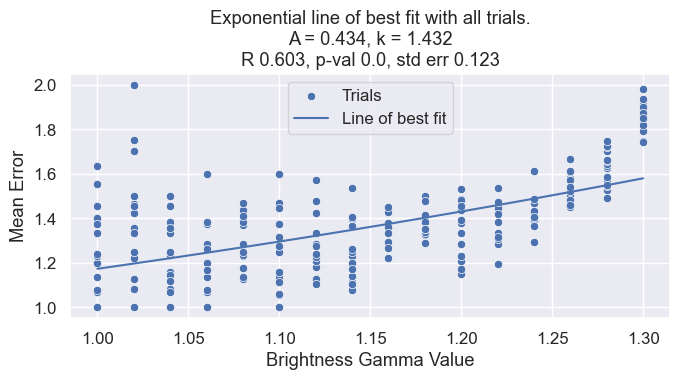

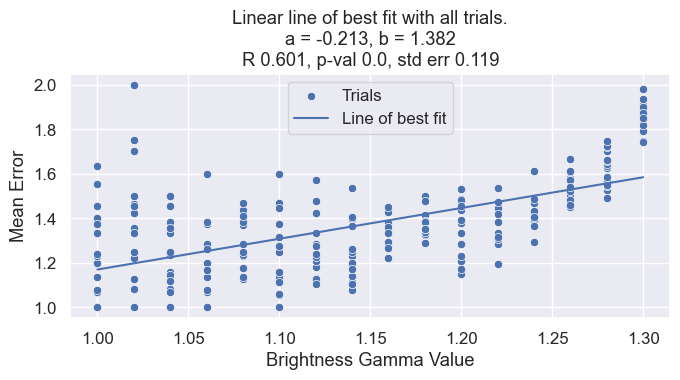

In [ ]:
metric = 'Mean Error'
x_measure = 'Brightness'

agg_data = per_brightness_metrics[
    (per_brightness_all_trials.Training == LB)
    & (per_brightness_all_trials.Model == MC)
]
all_data = per_brightness_all_trials[
    (per_brightness_all_trials.Training == LB)
    & (per_brightness_all_trials.Model == MC)
]
all_data.loc[all_data[metric] == 0.0, metric] = EPS

x_range = agg_data[x_measure].sort_values().unique()

agg_y = agg_data[metric]
agg_y_ln = agg_y.apply(np.log2)
agg_x = agg_data[x_measure]

all_y = all_data[metric]
all_y_ln = all_y.apply(np.log2)
all_x = all_data[x_measure]

b1, a1, r1, p1, e1 = stats.linregress(agg_x, agg_y_ln)
b2, a2, r2, p2, e2 = stats.linregress(all_x, all_y_ln)
b3, a3, r3, p3, e3 = stats.linregress(all_x, all_y)

agg_y_estim = a1 + b1 * x_range
all_y_estim = a2 + b2 * x_range
lin_y_estim = a3 + b3 * x_range

# plt.figure(figsize=(7,4))
# sns.scatterplot(x=agg_x, y=agg_y, color=CPAL[0], label='Trials')
# sns.lineplot(x=x_range, y=np.exp(agg_y_estim), label='Line of best fit')
# plt.xlabel('Brightness Gamma Value')
# plt.title(f"Exponential line of best fit with aggregated data.\nA = {round(np.exp(a1), 3)}, k = {round(b1, 3)}")
# plt.tight_layout()
# plt.show()

plt.figure(figsize=(7,4))
sns.scatterplot(x=all_x, y=all_y, label='Trials')
sns.lineplot(x=x_range, y=np.power(2, all_y_estim), label='Line of best fit')
plt.xlabel('Brightness Gamma Value')
plt.title(f"Exponential line of best fit with all trials.\nA = {round(np.power(2, a2), 3)}, k = {round(b2, 3)}\nR {round(r2, 3)}, p-val {round(p2, 3)}, std err {round(e2, 3)}")
plt.tight_layout()
plt.show()

plt.figure(figsize=(7,4))
sns.scatterplot(x=all_x, y=all_y, label='Trials')
sns.lineplot(x=x_range, y=lin_y_estim, label='Line of best fit')
plt.xlabel('Brightness Gamma Value')
plt.title(f"Linear line of best fit with all trials.\na = {round(a3, 3)}, b = {round(b3, 3)}\nR {round(r3, 3)}, p-val {round(p3, 3)}, std err {round(e3, 3)}")
plt.tight_layout()
plt.show()

In [ ]:
all_y_estim

array([0.22939934, 0.25804007, 0.28668081, 0.31532154, 0.34396227,
       0.372603  , 0.40124373, 0.42988446, 0.45852519, 0.48716593,
       0.51580666, 0.54444739, 0.57308812, 0.60172885, 0.63036958,
       0.65901031])

In [ ]:
from sklearn.preprocessing import MinMaxScaler

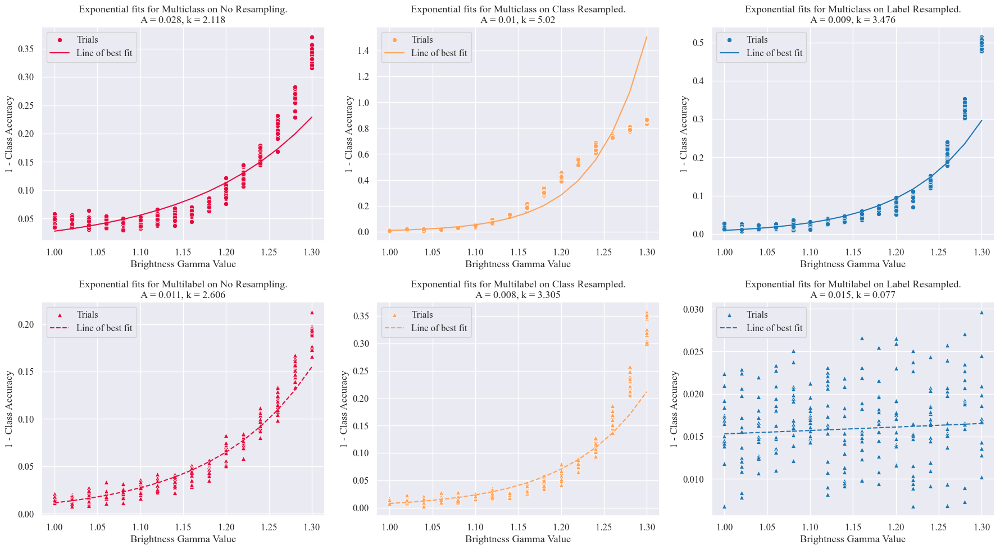

In [ ]:
# Regression for Class Resampled, Multiclass model on Brightness Experiment
x_measure = 'Brightness'
x_range = per_brightness_all_trials[x_measure].unique()
model_scatters = {
    MC: 'o',
    ML: '^'
}

scaler = MinMaxScaler()
x_scaled = scaler.fit_transform(x_range.reshape(-1, 1)).reshape(-1)
            
for met, metric in enumerate(article_metrics):
    fig, axes = plt.subplots(2, 3, figsize=(18,10))
    for mod, model in enumerate(model_style.keys()):
        for res, resample in enumerate(resamplings):
            all_data = per_brightness_all_trials[
                (per_brightness_all_trials[TRAIN_COL] == resample)
                & (per_brightness_all_trials[MODEL_COL] == model)
            ]
            all_data.loc[all_data[metric] == 0.0, metric] = EPS
            ax = axes[mod, res]

            all_y = all_data[metric]
            all_y_ln = all_y.apply(np.log)
            all_x = all_data[x_measure]
            all_x_scaled = scaler.transform(all_x.to_numpy().reshape(-1, 1)).reshape(-1)

            b, a, r, p, e = stats.linregress(all_x_scaled, all_y_ln)
            all_y_estim = a + b * x_scaled

            sns.scatterplot(x=all_x, y=all_y, marker=model_scatters[model], color=CPAL[res], label='Trials', ax=ax)
            sns.lineplot(x=x_range, y=np.exp(all_y_estim), linestyle=model_style[model], color=CPAL[res], label='Line of best fit', ax=ax)
            ax.set_xlabel('Brightness Gamma Value')
            ax.set_ylabel(metric)
            ax.set_title(f"Exponential fits for {model} on {resample}.\nA = {round(np.exp(a), 3)}, k = {round(b, 3)}")
    plt.tight_layout()
    plt.show()
    break

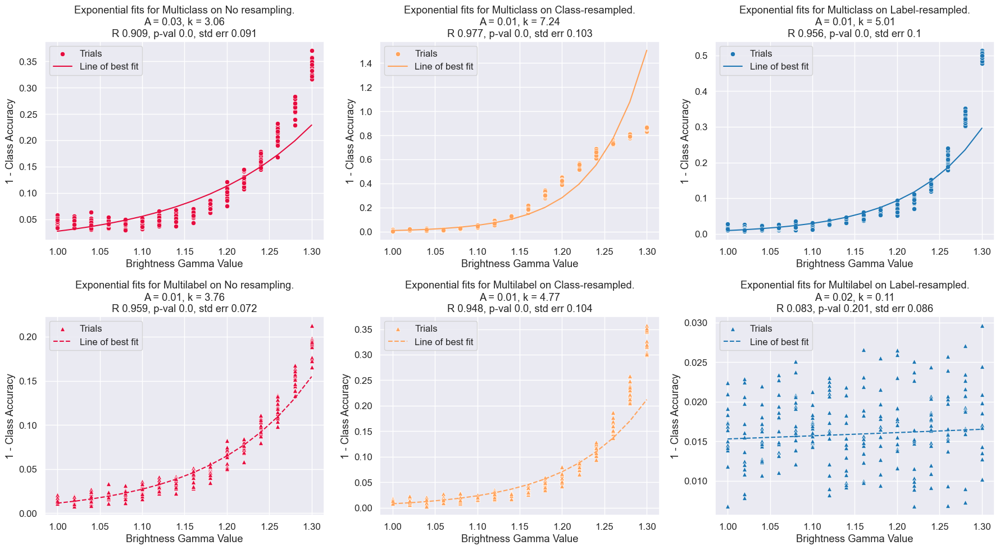

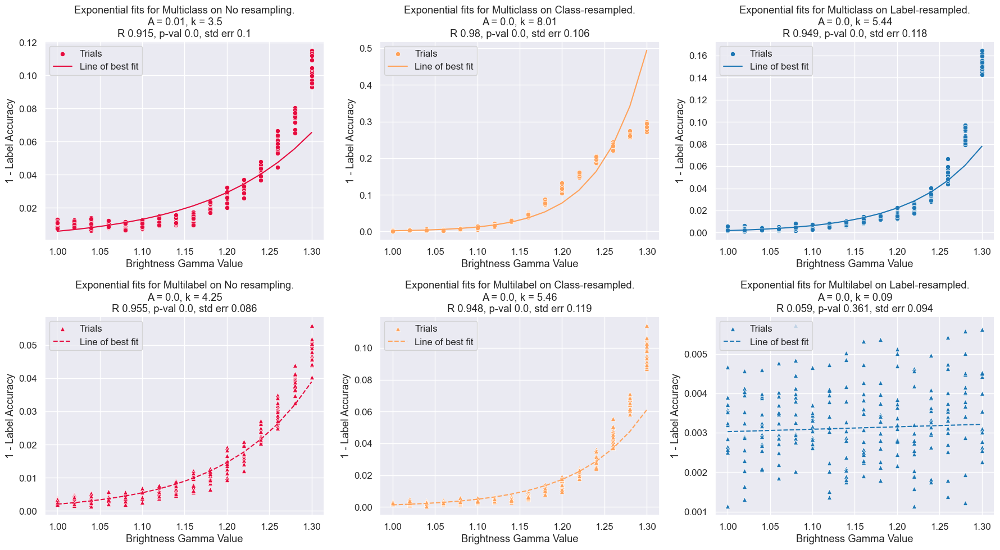

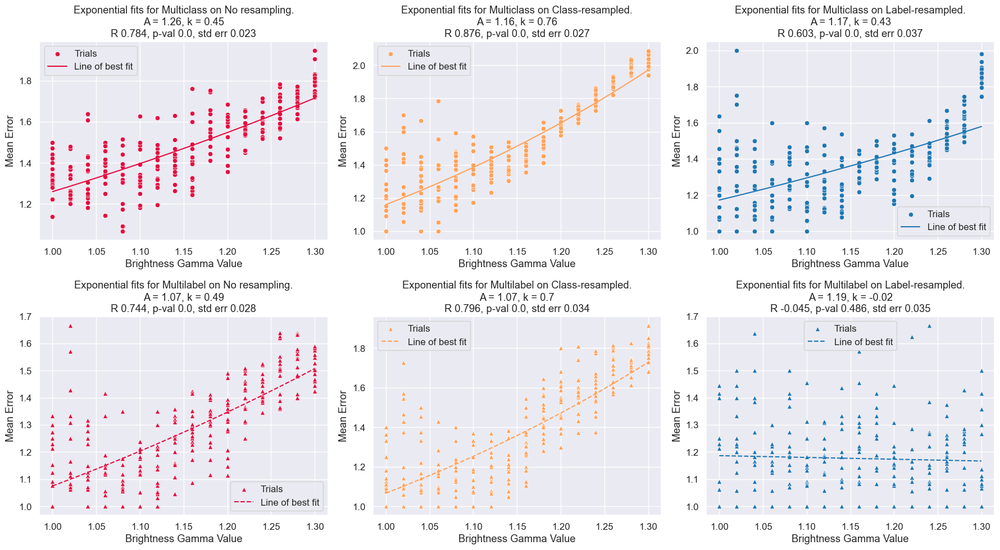

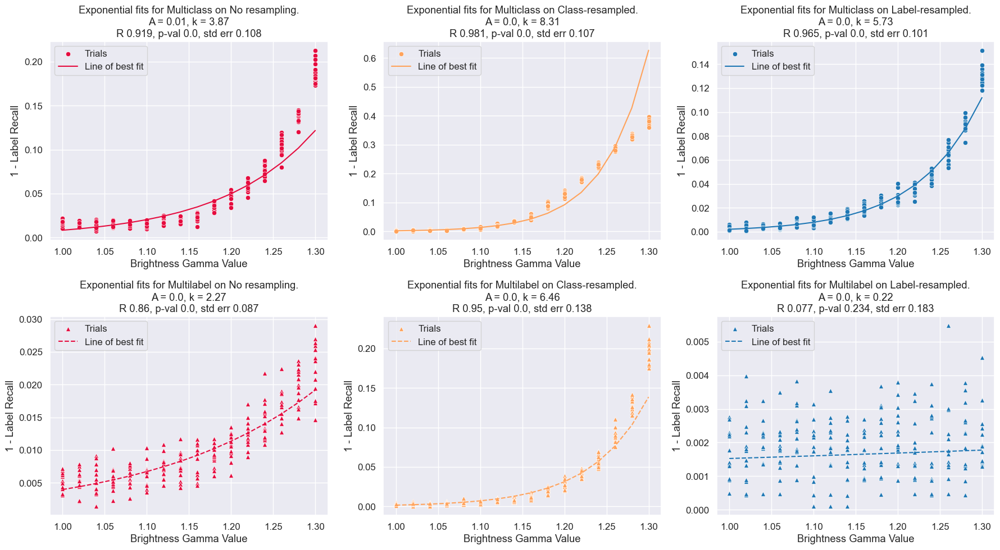

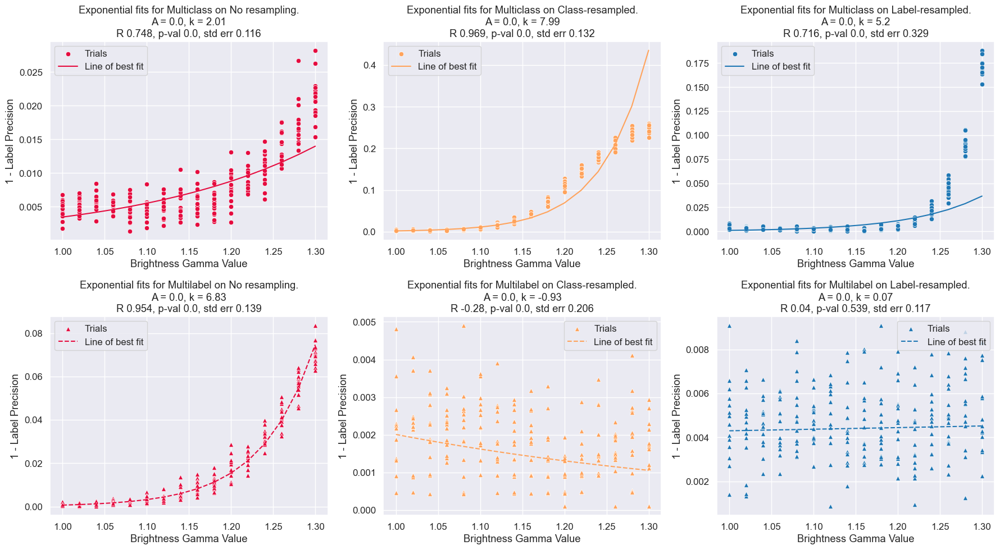

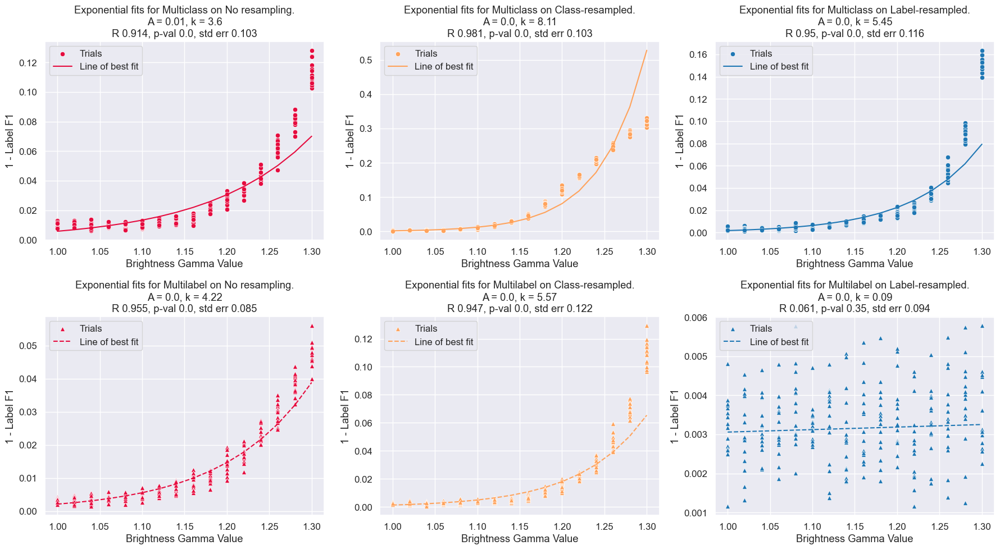

In [ ]:
# Regression for Class Resampled, Multiclass model on Brightness Experiment
x_measure = 'Brightness'
x_range = per_brightness_all_trials[x_measure].unique()
model_scatters = {
    MC: 'o',
    ML: '^'
}

scaler = MinMaxScaler()
x_scaled = scaler.fit_transform(x_range.reshape(-1, 1)).reshape(-1)      
            
for met, metric in enumerate(article_metrics):
    fig, axes = plt.subplots(2, 3, figsize=(18,10))
    for mod, model in enumerate(model_style.keys()):
        for res, resample in enumerate(resamplings):
            all_data = per_brightness_all_trials[
                (per_brightness_all_trials.Training == resample)
                & (per_brightness_all_trials.Model == model)
            ]
            all_data.loc[all_data[metric] == 0.0, metric] = EPS
            ax = axes[mod, res]

            all_y = all_data[metric]
            all_y_ln = all_y.apply(np.log2)
            all_x = all_data[x_measure]
            all_x_scaled = scaler.transform(all_x.to_numpy().reshape(-1, 1)).reshape(-1)

            b, a, r, p, e = stats.linregress(all_x_scaled, all_y_ln)
            all_y_estim = a + b * x_scaled

            sns.scatterplot(x=all_x, y=all_y, marker=model_scatters[model], color=CPAL[res], label='Trials', ax=ax)
            sns.lineplot(x=x_range, y=np.power(2, all_y_estim), linestyle=model_style[model], color=CPAL[res], label='Line of best fit', ax=ax)
            ax.set_xlabel('Brightness Gamma Value')
            ax.set_ylabel(metric)
            ax.set_title(f"Exponential fits for {model} on {resample}.\nA = {round(np.power(2, a), 2)}, k = {round(b, 2)}\nR {round(r, 3)}, p-val {round(p, 3)}, std err {round(e, 3)}")
    plt.tight_layout()
    plt.show()

In [ ]:
round(0.0005, 3)
# p-val of 0.0 when rounded to 3 decimals, indicates significance up to alpha = 0.0005 (i.e. .05%)

0.0

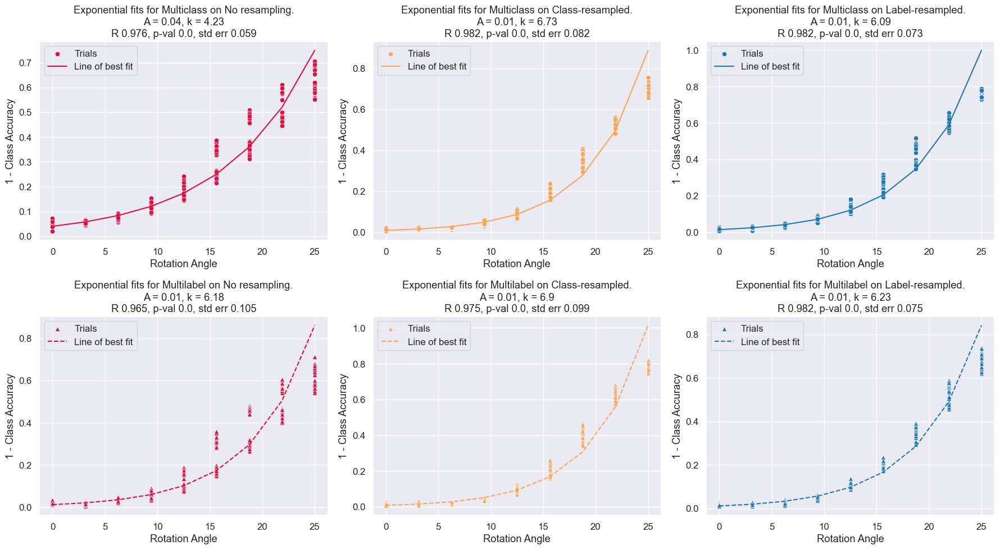

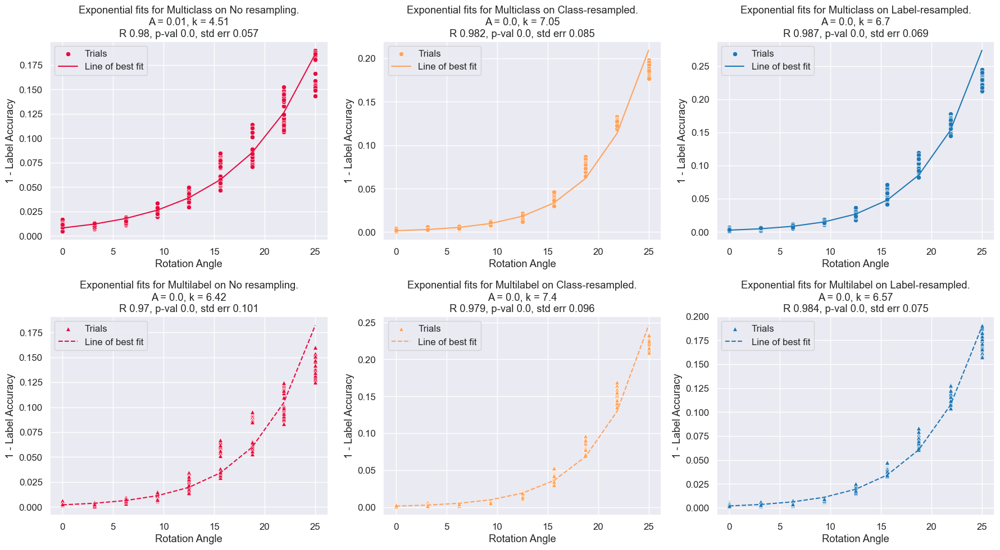

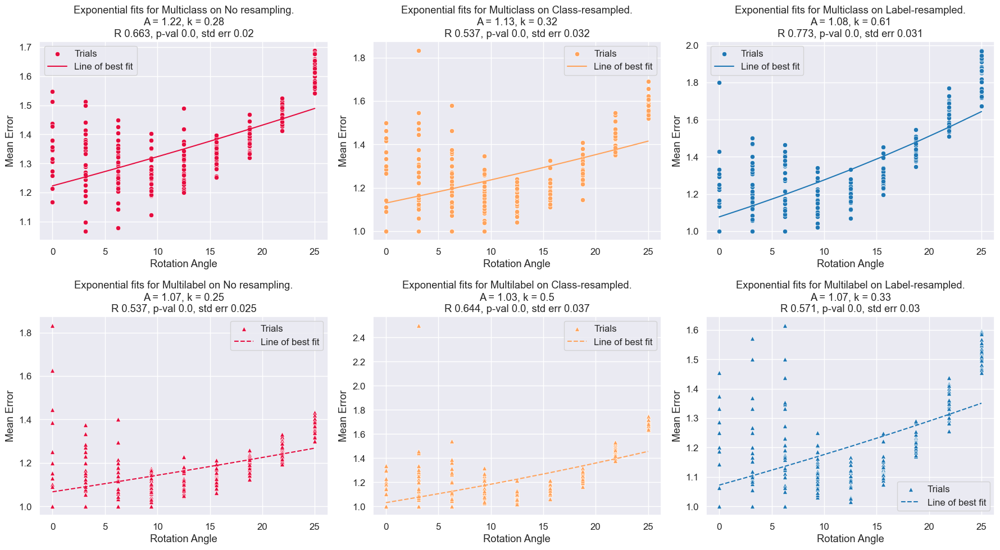

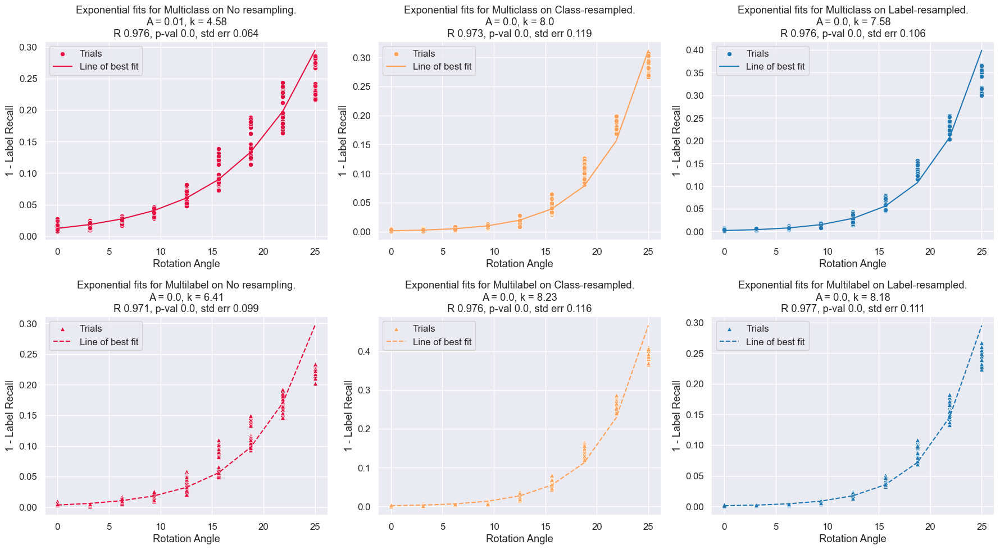

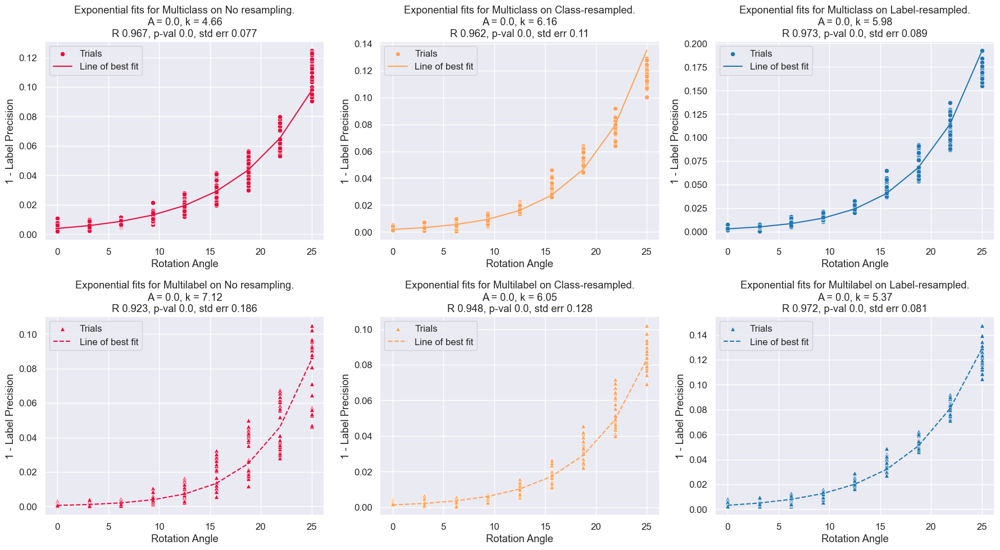

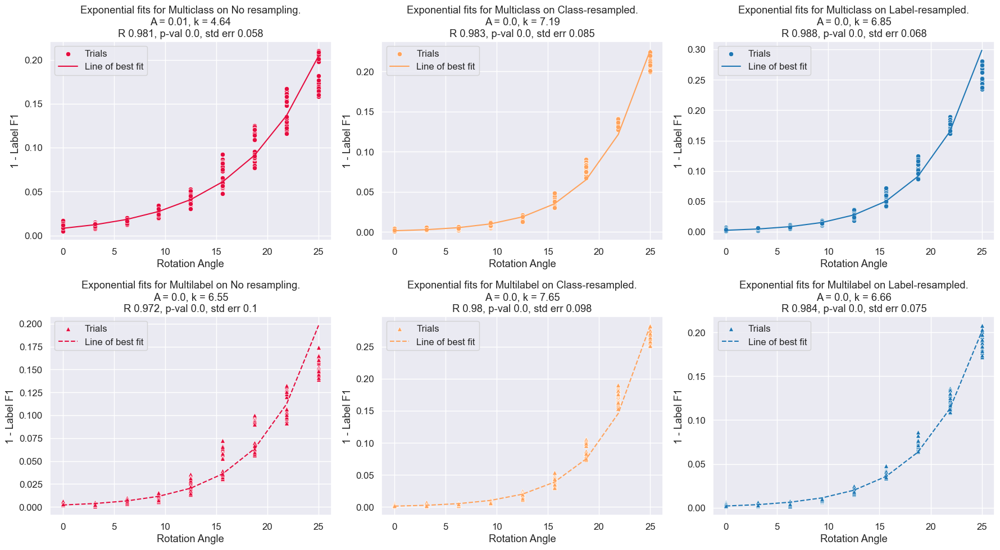

In [ ]:
x_measure = 'Absolute Rotation'
x_range = per_rotation_all_trials[x_measure].unique()
model_scatters = {
    MC: 'o',
    ML: '^'
}
scaler = MinMaxScaler()
x_scaled = scaler.fit_transform(x_range.reshape(-1, 1)).reshape(-1)      
            
            
for met, metric in enumerate(article_metrics):
    fig, axes = plt.subplots(2, 3, figsize=(18,10))
    for mod, model in enumerate(model_style.keys()):
        for res, resample in enumerate(resamplings):
            all_data = per_rotation_all_trials[
                (per_rotation_all_trials.Training == resample)
                & (per_rotation_all_trials.Model == model)
            ]
            all_data.loc[all_data[metric] == 0.0, metric] = EPS
            ax = axes[mod, res]

            all_y = all_data[metric]
            all_y_ln = all_y.apply(np.log2)
            all_x = all_data[x_measure]
            all_x_scaled = scaler.transform(all_x.to_numpy().reshape(-1, 1)).reshape(-1)

            b, a, r, p, e = stats.linregress(all_x_scaled, all_y_ln)
            all_y_estim = a + b * x_scaled

            sns.scatterplot(x=all_x, y=all_y, marker=model_scatters[model], color=CPAL[res], label='Trials', ax=ax)
            sns.lineplot(x=x_range, y=np.power(2, all_y_estim), linestyle=model_style[model], color=CPAL[res], label='Line of best fit', ax=ax)
            ax.set_xlabel('Rotation Angle')
            ax.set_ylabel(metric)
            ax.set_title(f"Exponential fits for {model} on {resample}.\nA = {round(np.power(2, a), 2)}, k = {round(b, 2)}\nR {round(r, 3)}, p-val {round(p, 3)}, std err {round(e, 3)}")
    plt.tight_layout()
    plt.show()

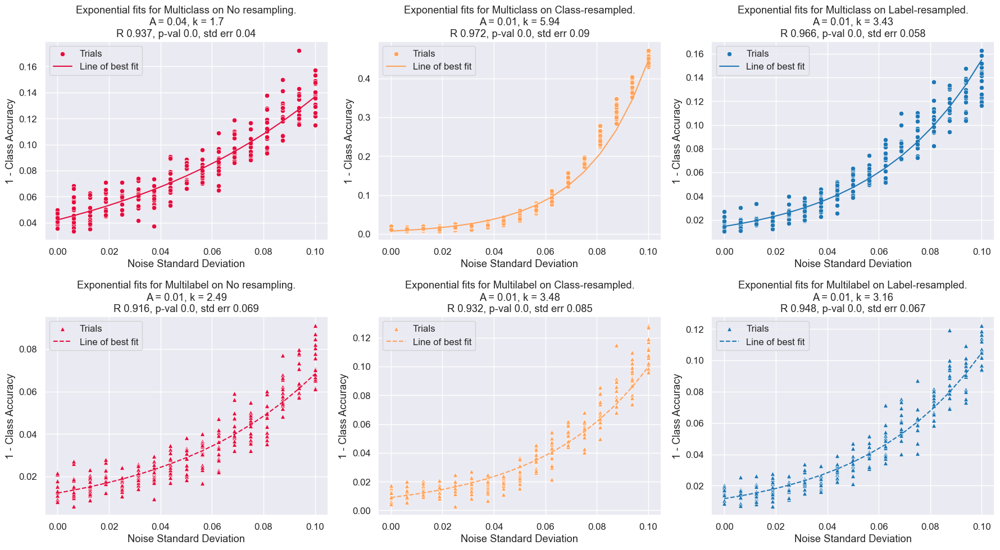

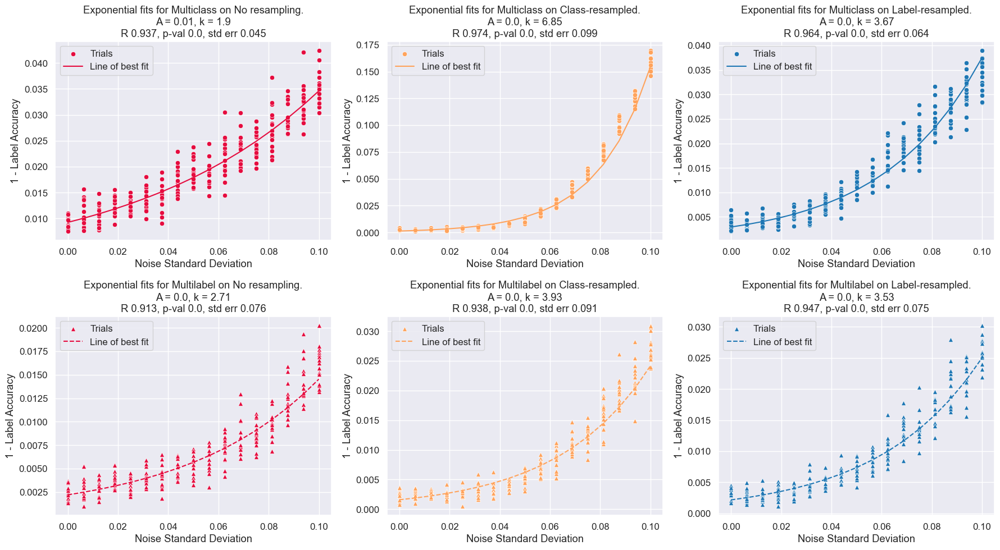

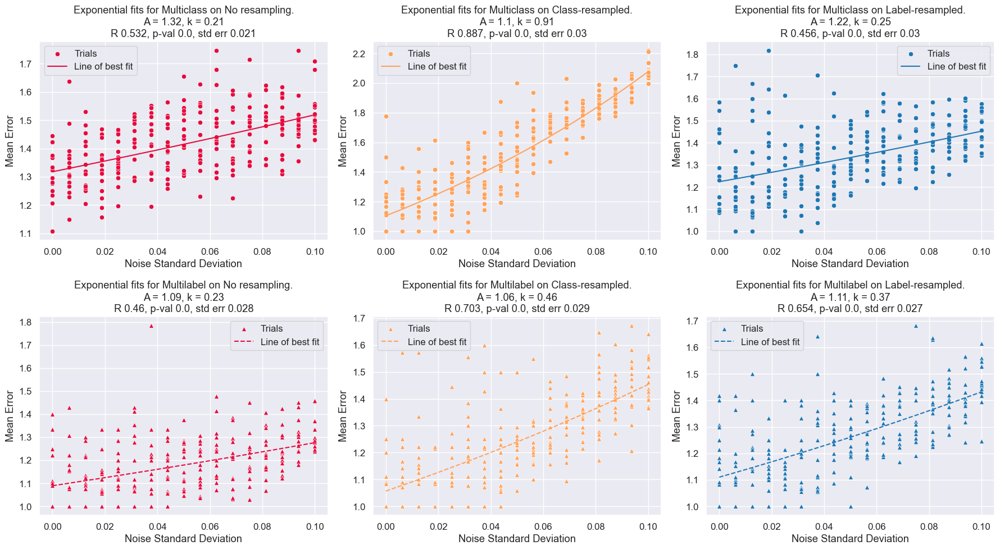

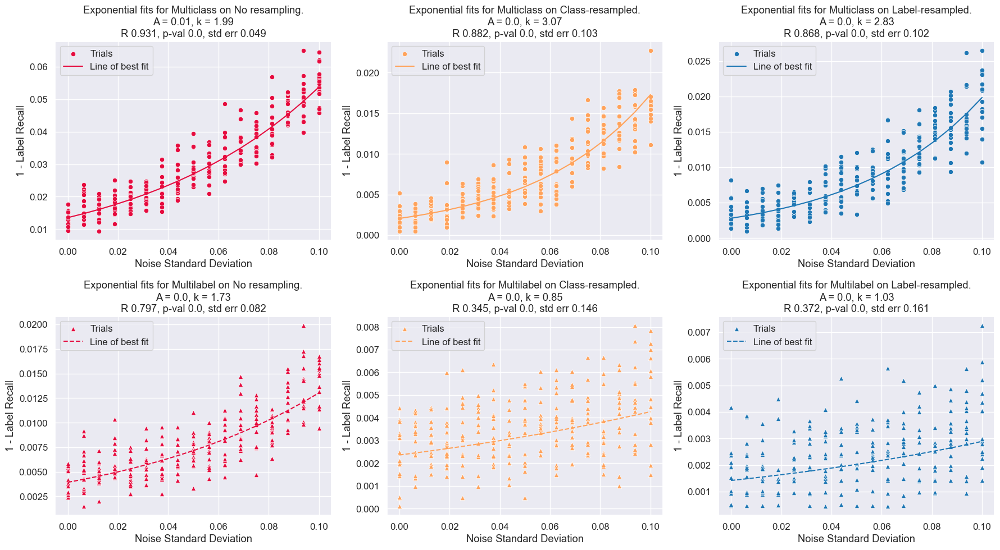

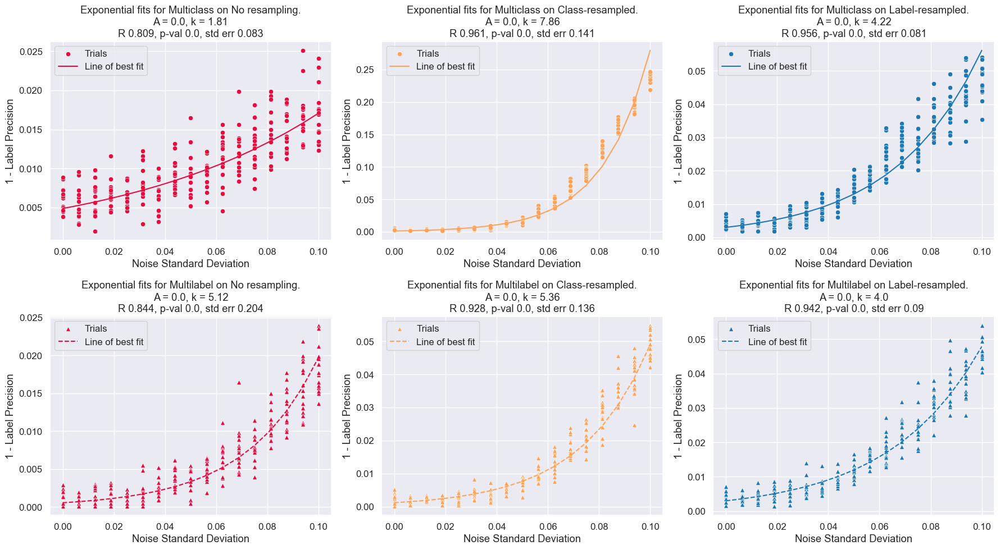

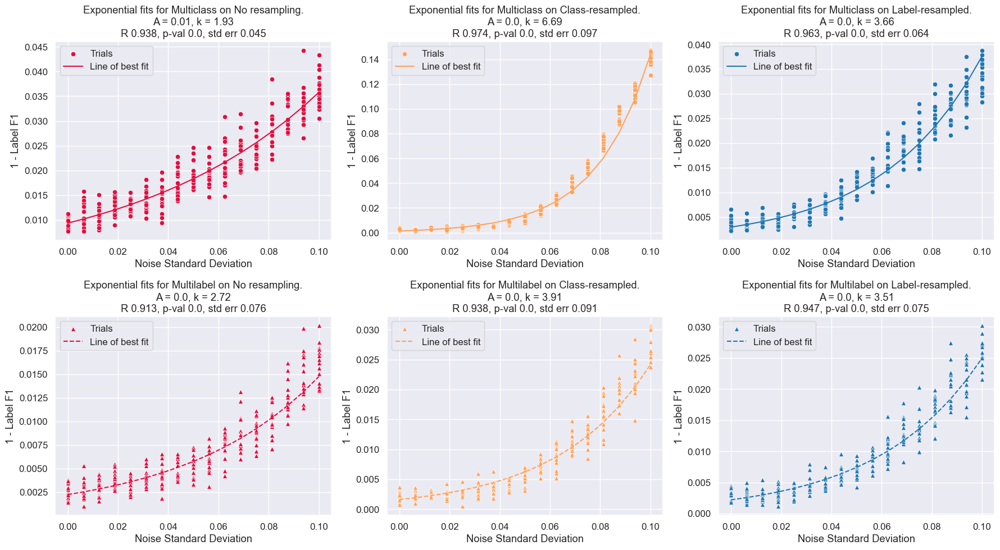

In [ ]:

x_measure = 'Noise'
x_range = per_noise_all_trials[x_measure].unique()
model_scatters = {
    MC: 'o',
    ML: '^'
}
scaler = MinMaxScaler()
x_scaled = scaler.fit_transform(x_range.reshape(-1, 1)).reshape(-1)      
            
            
for met, metric in enumerate(article_metrics):
    fig, axes = plt.subplots(2, 3, figsize=(18,10))
    for mod, model in enumerate(model_style.keys()):
        for res, resample in enumerate(resamplings):
            all_data = per_noise_all_trials[
                (per_noise_all_trials.Training == resample)
                & (per_noise_all_trials.Model == model)
            ]
            all_data.loc[all_data[metric] == 0.0, metric] = EPS
            ax = axes[mod, res]

            all_y = all_data[metric]
            all_y_ln = all_y.apply(np.log2)
            all_x = all_data[x_measure]
            all_x_scaled = scaler.transform(all_x.to_numpy().reshape(-1, 1)).reshape(-1)

            b, a, r, p, e = stats.linregress(all_x_scaled, all_y_ln)
            all_y_estim = a + b * x_scaled

            sns.scatterplot(x=all_x, y=all_y, marker=model_scatters[model], color=CPAL[res], label='Trials', ax=ax)
            sns.lineplot(x=x_range, y=np.power(2, all_y_estim), linestyle=model_style[model], color=CPAL[res], label='Line of best fit', ax=ax)
            ax.set_xlabel('Noise Standard Deviation')
            ax.set_ylabel(metric)
            ax.set_title(f"Exponential fits for {model} on {resample}.\nA = {round(np.power(2, a), 2)}, k = {round(b, 2)}\nR {round(r, 3)}, p-val {round(p, 3)}, std err {round(e, 3)}")
    plt.tight_layout()
    plt.show()

In [ ]:
per_brightness_metrics

,Resampling Scenario,Model,Brightness,Class Accuracy,Label Accuracy,Label Recall,Label Precision,Label F1,Mean Hamming Distance,Mean Error,Evaluation,1 - Class Accuracy,1 - Label Accuracy,1 - Label Recall,1 - Label Precision,1 - Label F1
0,No Resampling,Multiclass,1.00,0.955516,0.990016,0.984478,0.995315,0.989864,0.059904,1.344247,Brightness Augmented,0.044484,0.009984,0.015522,0.004685,0.010136
1,No Resampling,Multiclass,1.02,0.953489,0.989901,0.984789,0.994815,0.989775,0.060594,1.306874,Brightness Augmented,0.046511,0.010099,0.015211,0.005185,0.010225
2,No Resampling,Multiclass,1.04,0.957274,0.990387,0.986074,0.994302,0.990167,0.057676,1.345633,Brightness Augmented,0.042726,0.009613,0.013926,0.005698,0.009833
3,No Resampling,Multiclass,1.06,0.957148,0.990229,0.985175,0.994992,0.990056,0.058627,1.371129,Brightness Augmented,0.042852,0.009771,0.014825,0.005008,0.009944
4,No Resampling,Multiclass,1.08,0.957332,0.990697,0.985953,0.995117,0.990511,0.055817,1.309038,Brightness Augmented,0.042668,0.009303,0.014047,0.004883,0.009489
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
91,Label Resampled,Multilabel,1.22,0.985679,0.997296,0.998345,0.996210,0.997276,0.016224,1.142325,Brightness Augmented,0.014321,0.002704,0.001655,0.003790,0.002724
92,Label Resampled,Multilabel,1.24,0.983366,0.996741,0.998239,0.995162,0.996698,0.019552,1.180113,Brightness Augmented,0.016634,0.003259,0.001761,0.004838,0.003302
93,Label Resampled,Multilabel,1.26,0.982952,0.996608,0.998001,0.995151,0.996574,0.020354,1.190100,Brightness Augmented,0.017048,0.003392,0.001999,0.004849,0.003426
94,Label Resampled,Multilabel,1.28,0.981493,0.996283,0.997841,0.994624,0.996229,0.022303,1.200133,Brightness Augmented,0.018507,0.003717,0.002159,0.005376,0.003771


#### Metric Visuals

In [408]:
model_markers

{'Multiclass': 'o', 'Multilabel': 'X'}

##### Relative Performances

In [409]:
exp_ev = exp_evals[0]

df = all_experiments_results[
    (all_experiments_results[EVAL_COL] == exp_ev)
    # & (all_experiments_results[MET_COL] != errDist)
    ]
# df_ed = all_experiments_results[
#     (all_experiments_results[EVAL_COL] == exp_ev)
#     # & (all_experiments_results[MET_COL] == errDist)
#     ]

df2 = all_experiments_sterrs[
    (all_experiments_sterrs[EVAL_COL] == exp_ev)
    # & (all_experiments_sterrs[MET_COL] != errDist)
    ]
# df2_ed = all_experiments_sterrs[
#     (all_experiments_sterrs[EVAL_COL] == exp_ev)
#     # & (all_experiments_sterrs[MET_COL] == errDist)
#     ]
df.loc[df[MET_COL] == errDist, VAL_COL] = df[df[MET_COL] == errDist][VAL_COL] / 6

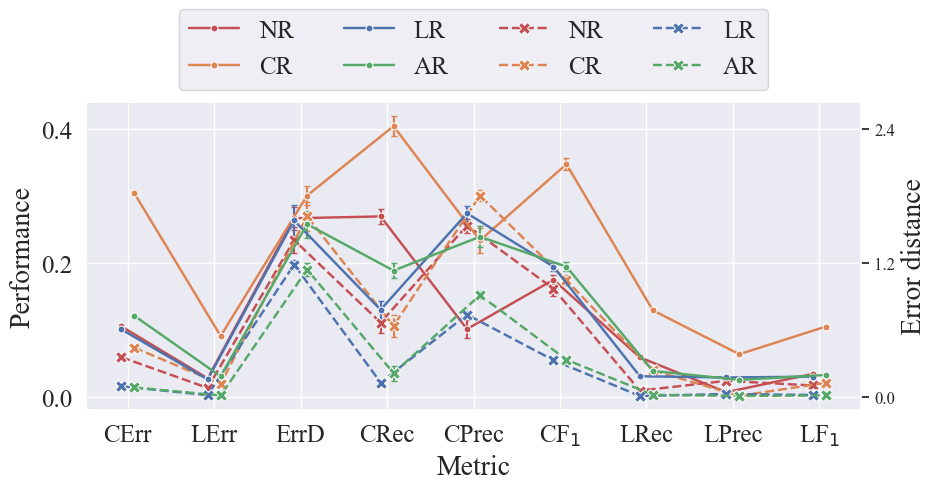

In [ ]:
xs = article_metric_names
xs_t = list(range(len(xs)))


fig, ax = plt.subplots(1, 1, figsize=(10,4))

for rs, resam in enumerate(resamplings):
    x_off = 0.075 if rs % 2 != 0 else -0.075
    for m, mod in enumerate(model_names):
        df_sub = df[
            (df[TRAIN_COL] == resam) &
            (df[MODEL_COL] == mod)].reset_index().sort_values([MET_COL], key=lambda m: m.map(metric_order))
        df_sub.loc[df_sub[MET_COL] == errDist, VAL_COL] = df_sub[df_sub[MET_COL] == errDist][VAL_COL] / 6
        df2_sub = df2[
            (df2[TRAIN_COL] == resam) &
            (df2[MODEL_COL] == mod)].reset_index().sort_values([MET_COL], key=lambda m: m.map(metric_order))
        errors = ax.errorbar(
                    x=[x+x_off for x in xs_t], y=df_sub[VAL_COL],
                    yerr=df2_sub[VAL_COL], xerr=None,
                    ecolor=CPAL[rs], elinewidth=1.5,
                    color=GREY, linewidth=0.,
                    capsize=2, capthick=1, zorder=1)
        
        for cap in errors[-1]:
            cap.set_linestyle(model_style[mod])
            
        
        lines = sns.lineplot(data=df_sub,
                    x=[x+x_off for x in xs_t], y=VAL_COL,
                    hue=TRAIN_COL, hue_order=training_color,
                    linestyle=model_style[mod],
                    linewidth=1.75,
                    marker=model_markers[mod],
                    markersize=marker_size[mod] // 12,
                    palette=CPAL, zorder=3,
                    ax=ax, legend=rs==0
                    )

handles, labels = ax.get_legend_handles_labels()
legend = ax.legend(handles=handles, loc='lower center', bbox_to_anchor=(0.5, 1.), ncols=4, fontsize=TICK_SIZE)

bold_labels = [MODEL_COL, MET_COL, TRAIN_COL]
for text in legend.get_texts():
    t = text.get_text()
    if t in bold_labels:
        text.set_fontweight('bold')
        text.set_fontsize(TICK_SIZE)
    if t in abbreviations:
        text.set_text(abbreviations[t])
        
labels = []
ticks = []
for t, label in enumerate(xs):
    tx_1 = abbreviations[label]
    labels.append(mtext.Text(t, 0, tx_1))
    ticks.append(t)

yl = ax.get_ylim()
ax2 = ax.twinx()
ax2.grid(False)
ax2.set_ylim(yl[0] * 6, yl[1] * 6)
ax2.set_ylabel(errDist, fontsize=LBL_SIZE)
ax.yaxis.set_major_locator(ticker.MultipleLocator(0.2))
ax2.yaxis.set_major_locator(ticker.MultipleLocator(1.2))

ax.set_ylabel(f"Performance", fontsize=LBL_SIZE)
# ax.set_ylim(0.5, ax.get_ylim()[1])
ax.set_xlabel(MET_COL, fontsize=LBL_SIZE)
ax.set_xticks(ticks=ticks, labels=labels,
            #   rotation=40, ha='right', rotation_mode="anchor"
            )
ax.tick_params(axis='both', left=False, labelsize=TICK_SIZE)

In [202]:
model_hatches

{'Multiclass': '', 'Multilabel': '\\\\//'}

In [410]:
exp_ev = exp_evals[0]

def normalised_performance(group, maxp):
    met = group[MET_COL].iloc[0]
    group[VAL_COL] = group[VAL_COL] / maxp.loc[met].iloc[0]
    return group
idx = [EVAL_COL, TRAIN_COL, MODEL_COL, MG_COL]
df = all_experiments_results[
    (all_experiments_results[EVAL_COL] == exp_ev)
    ].set_index(idx)
max_perf = df.groupby(MET_COL).agg('max')
norm_vals = df.groupby(MET_COL).apply(normalised_performance, maxp=max_perf)[VAL_COL].reset_index().set_index(idx + [MET_COL])
df = df.reset_index().set_index(idx + [MET_COL])
df["Normalised"] = norm_vals
df.reset_index(inplace=True)
df.head(10)
# max_perf

C:\Users\User\AppData\Local\Temp\ipykernel_27620\1142656962.py:12: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  norm_vals = df.groupby(MET_COL).apply(normalised_performance, maxp=max_perf)[VAL_COL].reset_index().set_index(idx + [MET_COL])


,Evaluation,Resampling Scenario,Model,Metric Type,Metric,Value,Normalised
0,Brightness Augmented,No Resampling,Multiclass,error,Class error,0.105759,0.347802
1,Brightness Augmented,No Resampling,Multilabel,error,Class error,0.059842,0.196800
2,Brightness Augmented,Class Resampled,Multiclass,error,Class error,0.304078,1.000000
3,Brightness Augmented,Class Resampled,Multilabel,error,Class error,0.074029,0.243454
4,Brightness Augmented,Label Resampled,Multiclass,error,Class error,0.101243,0.332950
5,Brightness Augmented,Label Resampled,Multilabel,error,Class error,0.016534,0.054373
6,Brightness Augmented,Adaptive Resampled,Multiclass,error,Class error,0.121516,0.399620
7,Brightness Augmented,Adaptive Resampled,Multilabel,error,Class error,0.014647,0.048169
8,Brightness Augmented,No Resampling,Multiclass,error,Label error,0.028181,0.308649
9,Brightness Augmented,No Resampling,Multilabel,error,Label error,0.014007,0.153413


In [411]:

def normalised_performance(group, maxp):
    met = tuple(group[[EVAL_COL, MET_COL]].iloc[0].to_list())
    group[VAL_COL] = group[VAL_COL] / maxp.loc[met].iloc[0]
    return group

idx = [TRAIN_COL, MODEL_COL, MG_COL]
gb = [EVAL_COL, MET_COL]
df = all_experiments_results.set_index(idx)

max_perf = df.groupby(gb).agg('max')
norm_vals = df.groupby(gb).apply(normalised_performance, maxp=max_perf)[VAL_COL].reset_index().set_index(idx + gb)
df = df.reset_index().set_index(idx + gb)
df["Normalised"] = norm_vals
df.reset_index(inplace=True)
df.head(10)
# max_perf

C:\Users\User\AppData\Local\Temp\ipykernel_27620\3856719308.py:10: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  max_perf = df.groupby(gb).agg('max')
C:\Users\User\AppData\Local\Temp\ipykernel_27620\3856719308.py:11: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  norm_vals = df.groupby(gb).apply(normalised_performance, maxp=max_perf)[VAL_COL].reset_index().set_index(idx + gb)
C:\Users\User\AppData\Local\Temp\ipykernel_27620\3856719308.py:11: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be ex

,Resampling Scenario,Model,Metric Type,Evaluation,Metric,Value,Normalised
0,No Resampling,Multiclass,error,Brightness Augmented,Class error,0.105759,0.347802
1,No Resampling,Multilabel,error,Brightness Augmented,Class error,0.059842,0.196800
2,Class Resampled,Multiclass,error,Brightness Augmented,Class error,0.304078,1.000000
3,Class Resampled,Multilabel,error,Brightness Augmented,Class error,0.074029,0.243454
4,Label Resampled,Multiclass,error,Brightness Augmented,Class error,0.101243,0.332950
5,Label Resampled,Multilabel,error,Brightness Augmented,Class error,0.016534,0.054373
6,Adaptive Resampled,Multiclass,error,Brightness Augmented,Class error,0.121516,0.399620
7,Adaptive Resampled,Multilabel,error,Brightness Augmented,Class error,0.014647,0.048169
8,No Resampling,Multiclass,error,Noise Augmented,Class error,0.081708,0.666410
9,No Resampling,Multilabel,error,Noise Augmented,Class error,0.033955,0.276936


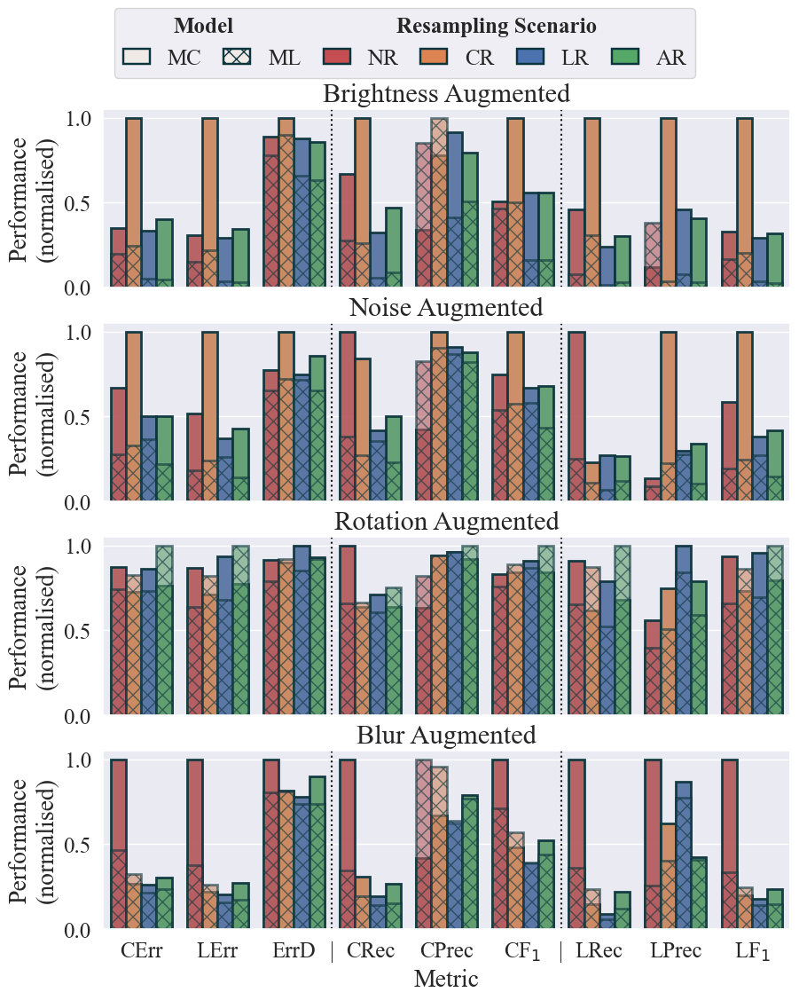

In [412]:
fig, axes = plt.subplots(4, 1, figsize=(10,12),
                         sharex=True)
for e, exp in enumerate(exp_evals):
    ax = axes[e]
    df_sub = df[df[EVAL_COL] == exp]
    ml_bars = sns.barplot(data=df_sub[df_sub[MODEL_COL] == ML],
                        x=MET_COL, y="Normalised",
                width=0.8,# gap=0.5,
                hue=TRAIN_COL, hue_order=training_color,
                alpha=0.6,
                zorder=2,
                linewidth=2.,
                edgecolor=DARK,
                legend=False,
                palette=CPAL,
                ax=ax)

    for bar in ml_bars.patches:
        bar.set_hatch(model_hatches[ML])
        
    mc_bars = sns.barplot(data=df_sub[df_sub[MODEL_COL] == MC], 
                        x=MET_COL, y="Normalised",
                width=0.8,
                hue=TRAIN_COL, hue_order=training_color,
                alpha=0.95,
                zorder=1,
                linewidth=2.,
                edgecolor=DARK,
                legend=False,
                palette=CPAL,
                ax=ax)
    ax.tick_params(axis='both', left=False, labelsize=TICK_SIZE)
    ax.set_title(exp, fontsize=LBL_LARGE)
    ax.set_ylabel(f"Performance\n(normalised)", fontsize=LBL_SIZE)
    ax.yaxis.set_major_locator(ticker.MultipleLocator(0.5))

    yl = ax.get_ylim()
    ax.set_ylim(yl)
    ax.axvline(x=2.5, ymin=0, ymax=yl[1], color=BLACK, alpha=0.9,
                 linestyle=':', linewidth=1.5)
    ax.axvline(x=5.5, ymin=0, ymax=yl[1], color=BLACK, alpha=0.9,
                 linestyle=':', linewidth=1.5)
# Build up legend:
lg1 = axes[0].legend(handles=[
    Line2D([0], [0], color='none', label=MODEL_COL),
    Line2D([0], [0], color='none', label=TRAIN_COL)
    ],
        loc='lower left', bbox_to_anchor=(0., 1.11),
        handlelength=1.5, columnspacing=5.,
        fontsize=TICK_SIZE, ncols=2,
        )
handles = [
    Patch(edgecolor=DARK, facecolor=LIGHT,
        linestyle='-', lw=1.75, hatch=model_hatches[mod],
        label=f"{abbreviations[mod]}") for m, mod in enumerate(model_names)
    ] + [
        Patch(edgecolor=DARK, facecolor=CPAL[rs],
                linestyle='-', lw=1.75,
                label=f"{abbreviations[resam]}") for rs, resam in enumerate(resamplings)
    ]
lg2 = mlegend.Legend(axes[0],
                    handles=handles,
                    labels=[h.get_label() for h in handles],
                    fontsize=TICK_SIZE, 
                    handlelength=1.2, columnspacing=1.,
                    loc='upper left', bbox_to_anchor=(1., 0.9), ncol=6, frameon=False)


# Manually combine the legends
for child in lg2._legend_box._children:
    lg1._legend_box._children.append(child)
lg1._legend_box.align = "left"

# Make only the desired labels bold
bold_labels = [MODEL_COL, MET_COL, TRAIN_COL]
for text in (
    lg1.get_texts() + lg2.get_texts()
):
    t = text.get_text()
    if t in bold_labels:
        text.set_fontweight('bold')
        text.set_fontsize(TICK_SIZE)
    if t in abbreviations:
        text.set_text(abbreviations[t])
        
labels = []
ticks = []
for t, label in enumerate(article_metric_names):
    tx_1 = abbreviations[label]
    labels.append(mtext.Text(t, 0, tx_1))
    ticks.append(t)

ticks = ticks + [2.5, 5.5]
labels = labels + ["|", "|"]

axes[3].set_xticks(ticks=ticks, labels=labels)
axes[3].set_xlabel(MET_COL, fontsize=LBL_SIZE)
# plt.tight_layout()
plt.savefig(os.path.join(PLOT_EVALS, 'experiment_performance_all.pdf'), bbox_inches='tight')

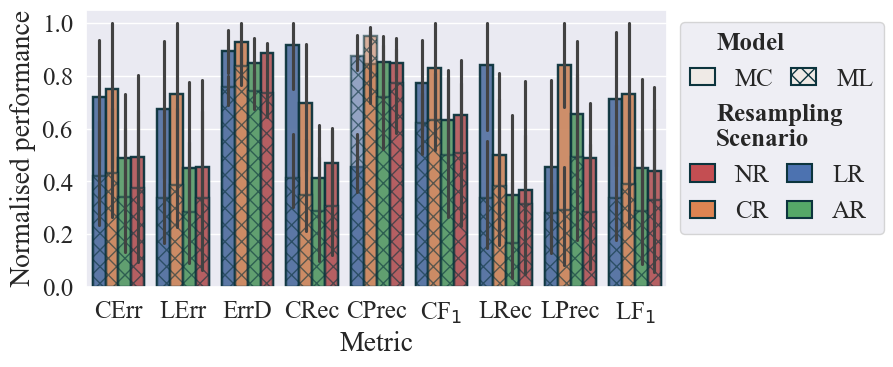

In [ ]:

fig, ax = plt.subplots(1, 1, figsize=(7.5,3.6))

ml_bars = sns.barplot(data=df[df[MODEL_COL] == ML],
                      x=MET_COL, y="Normalised",
            width=0.8,
            hue=TRAIN_COL,
            alpha=0.6,
            zorder=2,
            linewidth=1.75,
            ax=ax)

for bar in ml_bars.patches:
    bar.set_hatch(model_hatches[ML])
    
mc_bars = sns.barplot(data=df[df[MODEL_COL] == MC], 
                      x=MET_COL, y="Normalised",
            width=0.8,
            hue=TRAIN_COL,
            alpha=0.95,
            zorder=1,
            linewidth=1.75,
            ax=ax)

for bar in mc_bars.patches:
    bar.set_edgecolor(DARK)
    # bar.set_linewidth(1.75)

# Build up legend:
lg1 = ax.legend(handles=[Line2D([0], [0], color='none', label=MODEL_COL)],
          loc='upper left', bbox_to_anchor=(1., 1.),
          handlelength=.25,
          fontsize=TICK_SIZE, ncols=1,
        #   frameon=False
        )
lg2 = mlegend.Legend(ax,
                     handles=[Patch(edgecolor=DARK, facecolor=LIGHT,
                          linestyle='-', lw=1.5, hatch=model_hatches[mod],
                          label=f"{abbreviations[mod]}") for m, mod in enumerate(model_names)],
                     labels=[f"{abbreviations[mod]}" for mod in model_names],
                     fontsize=TICK_SIZE, 
                     handlelength=1., columnspacing=0.7,
                     loc='upper left', bbox_to_anchor=(1., 0.9), ncol=2, frameon=False)
lg3 = mlegend.Legend(ax,
                     handles=[Line2D([0], [0], color='none', label=TRAIN_COL.replace(' ', '\n'))],
                     labels=[TRAIN_COL.replace(' ', '\n')],
                     fontsize=TICK_SIZE, handlelength=.25,
                     loc='upper left', bbox_to_anchor=(1., 0.9), ncol=1, frameon=False)
handles = [
    Patch(edgecolor=DARK, facecolor=CPAL[rs],
                linestyle='-', lw=1.5,
                label=f"{abbreviations[resam]}") for rs, resam in enumerate(resamplings)
]

lg4 = mlegend.Legend(ax,
                     handles=handles, labels=[h.get_label() for h in handles],
                     loc='upper left', bbox_to_anchor=(1., 0.5),
                     handlelength=1., columnspacing=0.7,
                     fontsize=TICK_SIZE, ncol=2, frameon=False)

# Manually combine the legends
for child in lg2._legend_box._children:
    lg1._legend_box._children.append(child)
for child in lg3._legend_box._children:
    lg1._legend_box._children.append(child)
for child in lg4._legend_box._children:
    lg1._legend_box._children.append(child)
lg1._legend_box.align = "left"

# Make only the desired labels bold
bold_labels = [MODEL_COL, MET_COL, TRAIN_COL.replace(' ', '\n')]
for text in (
    lg1.get_texts() + lg2.get_texts() + lg3.get_texts() + lg4.get_texts()
):
    t = text.get_text()
    if t in bold_labels:
        text.set_fontweight('bold')
        text.set_fontsize(TICK_SIZE)
    if t in abbreviations:
        text.set_text(abbreviations[t])
        
labels = []
ticks = []
for t, label in enumerate(article_metric_names):
    tx_1 = abbreviations[label]
    labels.append(mtext.Text(t, 0, tx_1))
    ticks.append(t)

ax.set_ylabel(f"Normalised performance", fontsize=LBL_SIZE)
ax.set_xlabel(MET_COL, fontsize=LBL_SIZE)
ax.set_xticks(ticks=ticks, labels=labels)
ax.tick_params(axis='both', left=False, labelsize=TICK_SIZE)

ax.yaxis.set_major_locator(ticker.MultipleLocator(0.2))


##### Generalisation

In [218]:
EPS = 1e-4
EPS

0.0001

In [219]:
per_brightness_table = per_brightness_table.reset_index()


In [220]:
all_experiments_results[
        (all_experiments_results[EVAL_COL] == BRIGHT)
        & (all_experiments_results[MET_COL] == cErr)
    ]

,Evaluation,Resampling Scenario,Model,Metric,Value,Metric Type
0,Brightness Augmented,No Resampling,Multiclass,Class error,0.105759,error
1,Brightness Augmented,No Resampling,Multilabel,Class error,0.059842,error
2,Brightness Augmented,Class Resampled,Multiclass,Class error,0.304078,error
3,Brightness Augmented,Class Resampled,Multilabel,Class error,0.074029,error
4,Brightness Augmented,Label Resampled,Multiclass,Class error,0.101243,error
5,Brightness Augmented,Label Resampled,Multilabel,Class error,0.016534,error
6,Brightness Augmented,Adaptive Resampled,Multiclass,Class error,0.121516,error
7,Brightness Augmented,Adaptive Resampled,Multilabel,Class error,0.014647,error


In [413]:
locators = {
    cErr: (0.5, 0), 
    lErr: (0.2, 0),
    errDist: (0.6, 1.),
    cRec: (0.5, 0),
    cPrec: (0.3, 0),
    cF1: (0.5, 0),
    lRec: (0.3, 0),
    lPrec: (0.1, 0),
    lF1: (0.3, 0),
}
size = (9.5, 12)

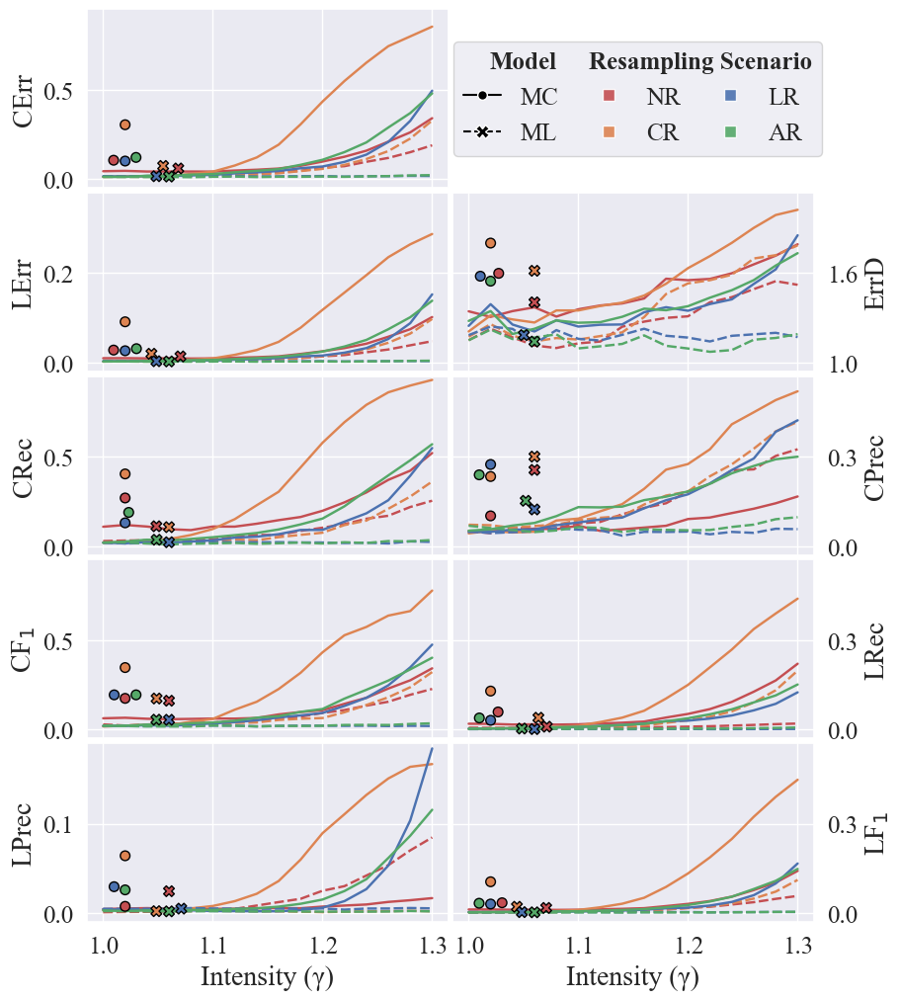

In [414]:
fig, axes = plt.subplots(5, 2, figsize=size,
                         sharex=True)
axes[0,1].axis('off')

for i, (metric, name) in enumerate(zip(article_metric_names, article_metric_names)):
    r = (i + 1) // 2
    c = 0 if i == 0 else (i + 1) % 2
    ax = axes[r, c]
    if c == 1:
        ax.yaxis.set_label_position("right")
        ax.yaxis.tick_right()
    overall_avg = all_experiments_results[
        (all_experiments_results[EVAL_COL] == BRIGHT)
        & (all_experiments_results[MET_COL] == metric)
    ]
    x1 = brt_lo[1]
    step = brt_lo[2] - x1
    x2 = brt_lo[2] + step
    swarm = sns.swarmplot(
        data=overall_avg,
        x=[x1, x2]*4,
        y=VAL_COL,
        hue=TRAIN_COL,
        size=7,
        linewidth=1.,
        edgecolor=BLACK,
        legend=False,
        palette=CPAL,
        native_scale=True,
        zorder=3, alpha=1.,
        ax=ax,
    )
    swarm.collections[1].set_paths([ml_mk])
    swarm.collections[1].set_sizes([60])
    
    sns.lineplot(data=per_brightness_metrics, x='Brightness', y=metric,
                 hue=TRAIN_COL, style=MODEL_COL, palette=CPAL,
                 linewidth=1.75,
                 zorder=2, ax=ax, legend=False)
    
    ax.set_ylabel(abbreviations[name], fontsize=LBL_SIZE)
    ax.tick_params('both', right=False, labelsize=TICK_SIZE)
    loc = locators[name]
    ax.yaxis.set_major_locator(ticker.MultipleLocator(loc[0], loc[1]))
    edge = loc[0] / 10
    top = loc[1] + 2 * loc[0]
    ax.set_ylim(loc[1] - edge, top - edge)
    
    if i == 0:
        hl = 1.5
        cg = 0.6
        # Build up legend:
        lg1 = ax.legend(handles=[
            Line2D([0], [0], color='none', label=MODEL_COL),
            Line2D([0], [0], color='none', label=TRAIN_COL)
            ],
                loc='center left', bbox_to_anchor=(0.98, 0.5),
                handlelength=.25, columnspacing=0.25,
                fontsize=TICK_SIZE, ncols=2,
                )
        handles = [
            Line2D([0], [0], color=BLACK,
                marker=model_markers[mod], markersize=marker_size[mod] // 10,
                markeredgecolor=WHITE,
                linestyle=model_style[mod], lw=1.5,
                alpha=1.,
                label=f"{abbreviations[mod]}"
            ) for m, mod in enumerate(model_names)
        ] + [
            Line2D([0], [0], color='none',
                marker='s', markersize=8,
                markeredgecolor=WHITE,
                markerfacecolor=CPAL[r],
                alpha=0.9,
                #   linestyle='-', lw=1.5,
                label=f"{abbreviations[res]}"
            ) for r, res in enumerate(resamplings)
        ]
        lg2 = mlegend.Legend(ax,
                            handles=handles,
                            labels=[h.get_label() for h in handles],
                            fontsize=TICK_SIZE, 
                            handlelength=1.5, columnspacing=1.25,
                            loc='upper left', bbox_to_anchor=(1., 0.9), ncol=3, frameon=False)


        # Manually combine the legends
        for child in lg2._legend_box._children:
            lg1._legend_box._children.append(child)
        lg1._legend_box.align = "left"

        # Make only the desired labels bold
        bold_labels = [MODEL_COL, MET_COL, TRAIN_COL]
        for text in (
            lg1.get_texts() + lg2.get_texts()
        ):
            t = text.get_text()
            if t in bold_labels:
                text.set_fontweight('bold')
                text.set_fontsize(TICK_SIZE)
            if t in abbreviations:
                text.set_text(abbreviations[t])
                
axes[-1,0].set_xlabel('Intensity (\u03B3)', fontsize=LBL_SIZE)
axes[-1,1].set_xlabel('Intensity (\u03B3)', fontsize=LBL_SIZE)
plt.subplots_adjust(hspace=0.025, wspace=0.01)
plt.savefig(os.path.join(PLOT_EVALS, 'experiment_performance_brightness.pdf'), bbox_inches='tight')

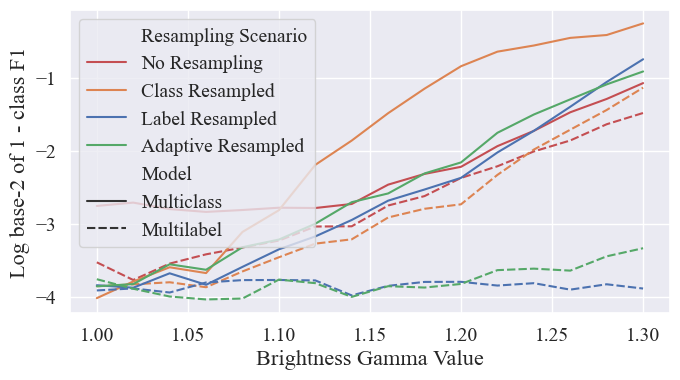

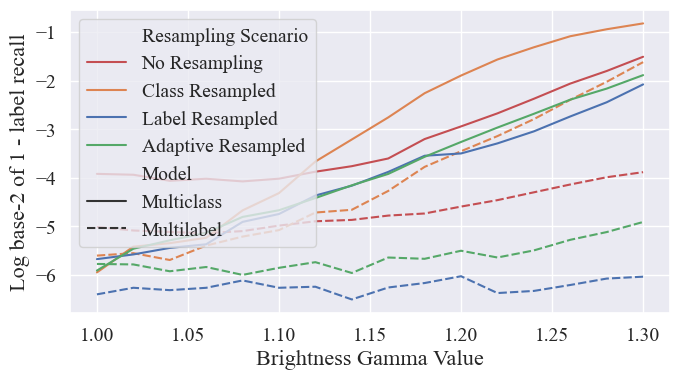

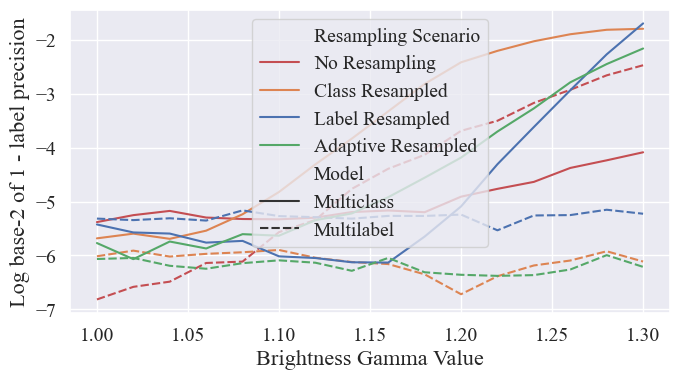

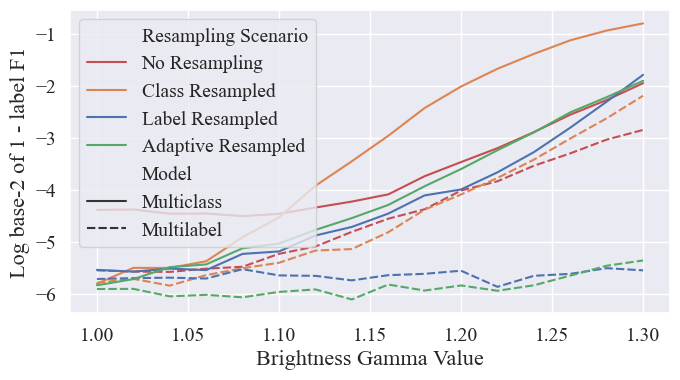

In [ ]:
# fig, axes = plt.subplots(2, 3, figsize=(20,10))
for i, metric in enumerate(article_metric_names):
    if i < 5:
        continue
    plt.figure(figsize=(7,4))
    ax = plt.gca()
    overall_avg = all_experiments_results[
        (all_experiments_results[EVAL_COL] == BRIGHT)
        & (all_experiments_results[MET_COL] == metric)
    ]
    swarm = sns.swarmplot(
        data=overall_avg,
        x=[brt_lo[1], brt_lo[2]]*4,
        y=VAL_COL,
        hue=TRAIN_COL,
        size=7,
        linewidth=1.,
        edgecolor=BLACK,
        legend=False,
        palette=CPAL,
        native_scale=True,
        zorder=3, alpha=1.,
    )
    swarm.collections[1].set_paths([ml_mk])
    swarm.collections[1].set_sizes([60])
    sns.lineplot(data=per_brightness_metrics.set_index([TRAIN_COL, MODEL_COL] + ['Brightness'])[article_metric_names].apply(np.log).reset_index(),
                 x='Brightness', y=metric, hue=TRAIN_COL, style=MODEL_COL, palette=CPAL)
    plt.xlabel('Brightness Gamma Value', fontsize=LBL_SIZE)
    plt.ylabel(f"Log base-2 of {metric}", fontsize=LBL_SIZE)
    ax.tick_params('both', labelsize=TICK_SIZE)
    
    hl = 1.25
    cg = 0.6
    lg1 = ax.legend(handles=[Line2D([0], [0], color='none', label=TRAIN_COL.replace(' ', '\n'))],
            loc='upper left', bbox_to_anchor=(1., 1.),
            handlelength=.25,
            fontsize=TICK_SIZE, ncols=1,
            #   frameon=False
            )
    lg2 = mlegend.Legend(ax,
                        handles=[Line2D([0], [0], color='none',
                            marker='s', markersize=8,
                            markeredgecolor=WHITE,
                            markerfacecolor=CPAL[r],
                            alpha=0.9,
                            #   linestyle='-', lw=1.5,
                            label=f"{abbreviations[res]}") for r, res in enumerate(resamplings)],
                        labels=[f"{abbreviations[res]}" for res in resamplings],
                        fontsize=TICK_SIZE, handlelength=hl, columnspacing=cg,
                        loc='upper left', bbox_to_anchor=(1., 0.9), ncol=2, frameon=False)
    lg3 = mlegend.Legend(ax,
                        handles=[Line2D([0], [0], color='none', label=MODEL_COL)],
                        labels=[MODEL_COL],
                        loc='upper left', bbox_to_anchor=(1., 0.5),
                        handlelength=.25,
                        fontsize=TICK_SIZE, ncol=1, frameon=False)

    handles = [
        Line2D([0], [0], color=BLACK,
        marker=model_markers[mod], markersize=marker_size[mod] // 10,
        markeredgecolor=WHITE,
        linestyle=model_style[mod], lw=1.5,
        alpha=1.,
        label=f"{abbreviations[mod]}") for m, mod in enumerate(model_names)
    ]

    lg4 = mlegend.Legend(ax,
                        handles=handles, labels=[h.get_label() for h in handles],
                        loc='upper left', bbox_to_anchor=(1., 0.5),
                        handlelength=hl, columnspacing=cg,
                        fontsize=TICK_SIZE, ncol=2, frameon=False)

    # Manually combine the legends
    for child in lg2._legend_box._children:
        lg1._legend_box._children.append(child)
    for child in lg3._legend_box._children:
        lg1._legend_box._children.append(child)
    for child in lg4._legend_box._children:
        lg1._legend_box._children.append(child)
    lg1._legend_box.align = "left"

    # Make only the desired labels bold
    bold_labels = [MODEL_COL, MET_COL, TRAIN_COL.replace(' ', '\n')]
    for text in (
        lg1.get_texts() + lg2.get_texts() + lg3.get_texts() + lg4.get_texts()
    ):
        t = text.get_text()
        if t in bold_labels:
            text.set_fontweight('bold')
            text.set_fontsize(TICK_SIZE)
        if t in abbreviations:
            text.set_text(abbreviations[t])
    # plt.savefig(os.path.join(PLOTS, 'article', f'per_brightness_{metrics[i].lower().replace(' ', '_')}.png'), bbox_inches='tight')

In [415]:
locators = {
    cErr: (0.3, 0), 
    lErr: (0.1, 0),
    errDist: (0.6, 1.),
    cRec: (0.3, 0),
    cPrec: (0.2, 0),
    cF1: (0.25, 0),
    lRec: (0.05, 0),
    lPrec: (0.15, 0),
    lF1: (0.1, 0),
}

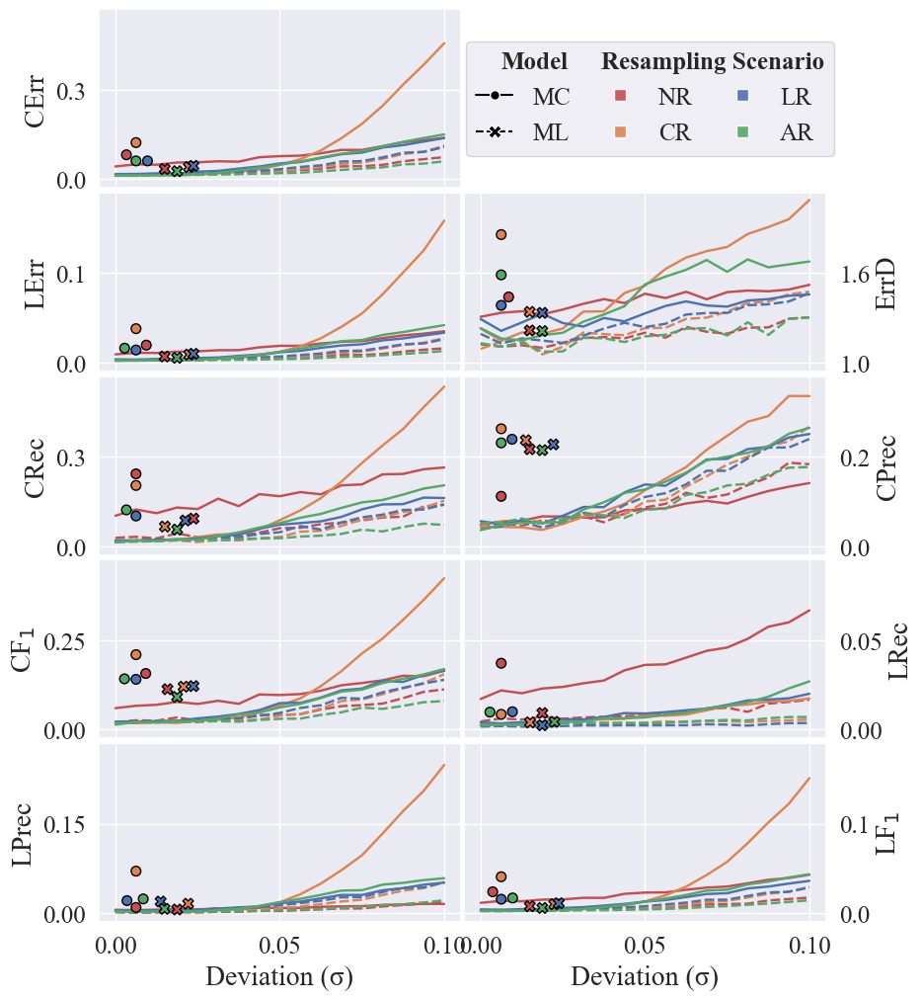

In [416]:
fig, axes = plt.subplots(5, 2, figsize=size,
                         sharex=True)
axes[0,1].axis('off')

for i, (metric, name) in enumerate(zip(article_metric_names, article_metric_names)):
    r = (i + 1) // 2
    c = 0 if i == 0 else (i + 1) % 2
    ax = axes[r, c]
    if c == 1:
        ax.yaxis.set_label_position("right")
        ax.yaxis.tick_right()
    overall_avg = all_experiments_results[
        (all_experiments_results[EVAL_COL] == NOISE)
        & (all_experiments_results[MET_COL] == metric)
    ]
    x1 = nse_lo[1]
    step = nse_lo[2] - x1
    x2 = nse_lo[2] + step
    swarm = sns.swarmplot(
        data=overall_avg,
        x=[x1, x2]*4,
        y=VAL_COL,
        hue=TRAIN_COL,
        size=7,
        linewidth=1.,
        edgecolor=BLACK,
        legend=False,
        palette=CPAL,
        native_scale=True,
        zorder=3, alpha=1.,
        ax=ax,
    )
    swarm.collections[1].set_paths([ml_mk])
    swarm.collections[1].set_sizes([60])
    
    sns.lineplot(data=per_noise_metrics,
                 x='Noise', y=metric, hue=TRAIN_COL, style=MODEL_COL, palette=CPAL,
                 linewidth=1.75,
                 zorder=2, ax=ax, legend=False)
    ax.set_ylabel(abbreviations[name], fontsize=LBL_SIZE)
    ax.tick_params('both', right=False, labelsize=TICK_SIZE)
    loc = locators[name]
    ax.yaxis.set_major_locator(ticker.MultipleLocator(loc[0], loc[1]))
    edge = loc[0] / 10
    top = loc[1] + 2 * loc[0]
    ax.set_ylim(loc[1] - edge, top - edge)
    
    if i == 0:
        hl = 1.5
        cg = 0.6
        lg1 = ax.legend(handles=[
            Line2D([0], [0], color='none', label=MODEL_COL),
            Line2D([0], [0], color='none', label=TRAIN_COL)
            ],
                loc='center left', bbox_to_anchor=(0.98, 0.5),
                handlelength=.25, columnspacing=0.25,
                fontsize=TICK_SIZE, ncols=2,
                )
        handles = [
            Line2D([0], [0], color=BLACK,
                marker=model_markers[mod], markersize=marker_size[mod] // 10,
                markeredgecolor=WHITE,
                linestyle=model_style[mod], lw=1.5,
                alpha=1.,
                label=f"{abbreviations[mod]}"
            ) for m, mod in enumerate(model_names)
        ] + [
            Line2D([0], [0], color='none',
                marker='s', markersize=8,
                markeredgecolor=WHITE,
                markerfacecolor=CPAL[r],
                alpha=0.9,
                #   linestyle='-', lw=1.5,
                label=f"{abbreviations[res]}"
            ) for r, res in enumerate(resamplings)
        ]
        lg2 = mlegend.Legend(ax,
                            handles=handles,
                            labels=[h.get_label() for h in handles],
                            fontsize=TICK_SIZE, 
                            handlelength=1.5, columnspacing=1.25,
                            loc='upper left', bbox_to_anchor=(1., 0.9), ncol=3, frameon=False)


        # Manually combine the legends
        for child in lg2._legend_box._children:
            lg1._legend_box._children.append(child)
        lg1._legend_box.align = "left"

        # Make only the desired labels bold
        bold_labels = [MODEL_COL, MET_COL, TRAIN_COL]
        for text in (
            lg1.get_texts() + lg2.get_texts()
        ):
            t = text.get_text()
            if t in bold_labels:
                text.set_fontweight('bold')
                text.set_fontsize(TICK_SIZE)
            if t in abbreviations:
                text.set_text(abbreviations[t])
                
axes[-1,0].set_xlabel('Deviation (\u03C3)', fontsize=LBL_SIZE)
axes[-1,1].set_xlabel('Deviation (\u03C3)', fontsize=LBL_SIZE)
plt.subplots_adjust(hspace=0.025, wspace=0.01)
plt.savefig(os.path.join(PLOT_EVALS, 'experiment_performance_noise.pdf'), bbox_inches='tight')

In [417]:
locators = {
    cErr: (0.5, 0), 
    lErr: (0.15, 0),
    errDist: (0.6, 1.),
    cRec: (0.5, 0),
    cPrec: (0.5, 0),
    cF1: (0.5, 0),
    lRec: (0.3, 0),
    lPrec: (0.15, 0),
    lF1: (0.2, 0),
}

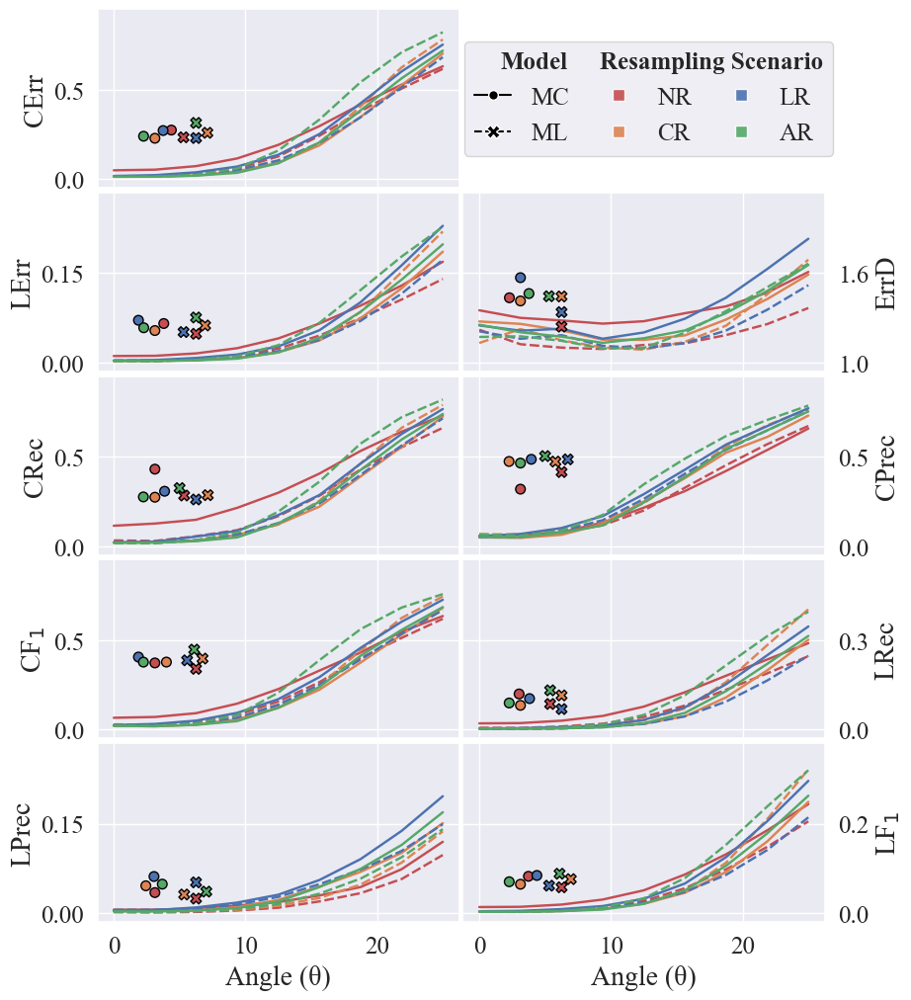

In [418]:
fig, axes = plt.subplots(5, 2, figsize=size,
                         sharex=True)
axes[0,1].axis('off')

for i, (metric, name) in enumerate(zip(article_metric_names, article_metric_names)):
    r = (i + 1) // 2
    c = 0 if i == 0 else (i + 1) % 2
    ax = axes[r, c]
    if c == 1:
        ax.yaxis.set_label_position("right")
        ax.yaxis.tick_right()
    overall_avg = all_experiments_results[
        (all_experiments_results[EVAL_COL] == ROT)
        & (all_experiments_results[MET_COL] == metric)
    ]
    x1 = rot_lo[1]
    step = rot_lo[2] - x1
    x2 = rot_lo[2]
    swarm = sns.swarmplot(
        data=overall_avg,
        x=[x1, x2]*4,
        y=VAL_COL,
        hue=TRAIN_COL,
        size=7,
        linewidth=1.,
        edgecolor=BLACK,
        legend=False,
        palette=CPAL,
        native_scale=True,
        zorder=3, alpha=1.,
        ax=ax,
    )
    swarm.collections[1].set_paths([ml_mk])
    swarm.collections[1].set_sizes([60])

    sns.lineplot(data=per_abs_rotation_metrics, x='Absolute Rotation', y=metric, hue=TRAIN_COL, style=MODEL_COL,
                 palette=CPAL,
                 linewidth=1.75,
                 zorder=2, ax=ax, legend=False)
    ax.set_ylabel(abbreviations[name], fontsize=LBL_SIZE)
    ax.tick_params('both', right=False, labelsize=TICK_SIZE)
    loc = locators[name]
    ax.yaxis.set_major_locator(ticker.MultipleLocator(loc[0], loc[1]))
    edge = loc[0] / 10
    top = loc[1] + 2 * loc[0]
    ax.set_ylim(loc[1] - edge, top - edge)
    
    if i == 0:
        hl = 1.5
        cg = 0.6
        # Build up legend:
        lg1 = ax.legend(handles=[
            Line2D([0], [0], color='none', label=MODEL_COL),
            Line2D([0], [0], color='none', label=TRAIN_COL)
            ],
                loc='center left', bbox_to_anchor=(0.98, 0.5),
                handlelength=.25, columnspacing=0.25,
                fontsize=TICK_SIZE, ncols=2,
                )
        handles = [
            Line2D([0], [0], color=BLACK,
                marker=model_markers[mod], markersize=marker_size[mod] // 10,
                markeredgecolor=WHITE,
                linestyle=model_style[mod], lw=1.5,
                alpha=1.,
                label=f"{abbreviations[mod]}"
            ) for m, mod in enumerate(model_names)
        ] + [
            Line2D([0], [0], color='none',
                marker='s', markersize=8,
                markeredgecolor=WHITE,
                markerfacecolor=CPAL[r],
                alpha=0.9,
                #   linestyle='-', lw=1.5,
                label=f"{abbreviations[res]}"
            ) for r, res in enumerate(resamplings)
        ]
        lg2 = mlegend.Legend(ax,
                            handles=handles,
                            labels=[h.get_label() for h in handles],
                            fontsize=TICK_SIZE, 
                            handlelength=1.5, columnspacing=1.25,
                            loc='upper left', bbox_to_anchor=(1., 0.9), ncol=3, frameon=False)


        # Manually combine the legends
        for child in lg2._legend_box._children:
            lg1._legend_box._children.append(child)
        lg1._legend_box.align = "left"

        # Make only the desired labels bold
        bold_labels = [MODEL_COL, MET_COL, TRAIN_COL]
        for text in (
            lg1.get_texts() + lg2.get_texts()
        ):
            t = text.get_text()
            if t in bold_labels:
                text.set_fontweight('bold')
                text.set_fontsize(TICK_SIZE)
            if t in abbreviations:
                text.set_text(abbreviations[t])
            
axes[-1,0].set_xlabel('Angle (\u03B8)', fontsize=LBL_SIZE)
axes[-1,1].set_xlabel('Angle (\u03B8)', fontsize=LBL_SIZE)
plt.subplots_adjust(hspace=0.025, wspace=0.01)
plt.savefig(os.path.join(PLOT_EVALS, 'experiment_performance_rotation.pdf'), bbox_inches='tight')

In [38]:
per_abs_rotation_metrics[
    head_cols + ['Absolute Rotation'] + article_metrics
].head()

,Evaluation,Resampling Scenario,Model,Absolute Rotation,1 - Class Accuracy,1 - Label Accuracy,1 - Label Recall,1 - Label Precision,1 - Label F1,Mean Error
54,Rotation Augmented,No Resampling,Multiclass,0.000,0.049510,0.011144,0.021165,0.005774,0.013674,1.351048
55,Rotation Augmented,No Resampling,Multiclass,3.125,0.053099,0.011512,0.022072,0.005900,0.014237,1.300402
56,Rotation Augmented,No Resampling,Multiclass,6.250,0.072812,0.015554,0.030125,0.007470,0.019230,1.282851
57,Rotation Augmented,No Resampling,Multiclass,9.375,0.115690,0.024267,0.046010,0.012762,0.030470,1.261719
58,Rotation Augmented,No Resampling,Multiclass,12.500,0.191484,0.040623,0.077325,0.018624,0.051102,1.277775


In [42]:
normalised_by_class_error = per_abs_rotation_metrics[
    head_cols + ['Absolute Rotation'] + article_metrics
]
for met in article_metrics:
    # if met == '1 - Class Accuracy':
    #     continue
    normalised_by_class_error[met] = per_abs_rotation_metrics[met] / per_abs_rotation_metrics['1 - Class Accuracy']
normalised_by_class_error.head()

,Evaluation,Resampling Scenario,Model,Absolute Rotation,1 - Class Accuracy,1 - Label Accuracy,1 - Label Recall,1 - Label Precision,1 - Label F1,Mean Error
54,Rotation Augmented,No Resampling,Multiclass,0.000,1.0,0.225088,0.427494,0.116619,0.276179,27.288164
55,Rotation Augmented,No Resampling,Multiclass,3.125,1.0,0.216799,0.415678,0.111108,0.268122,24.490303
56,Rotation Augmented,No Resampling,Multiclass,6.250,1.0,0.213614,0.413732,0.102589,0.264108,17.618634
57,Rotation Augmented,No Resampling,Multiclass,9.375,1.0,0.209757,0.397703,0.110315,0.263372,10.905987
58,Rotation Augmented,No Resampling,Multiclass,12.500,1.0,0.212150,0.403821,0.097264,0.266875,6.673009


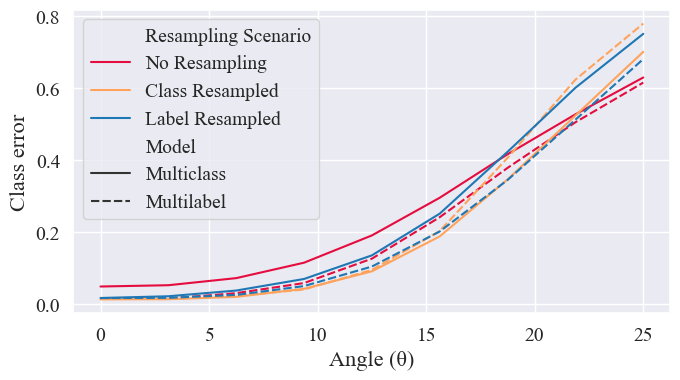

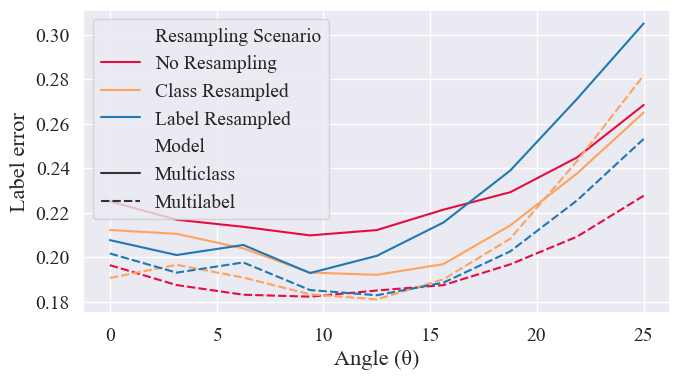

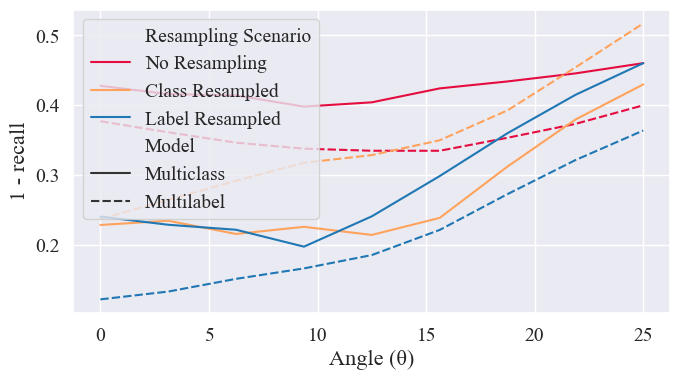

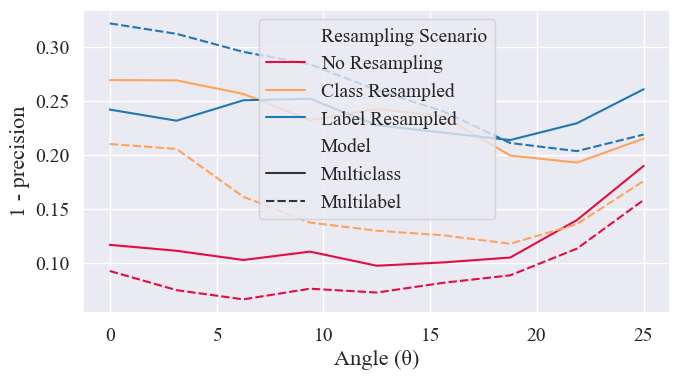

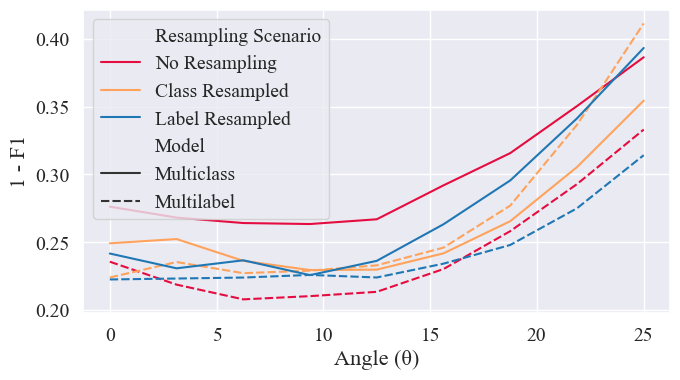

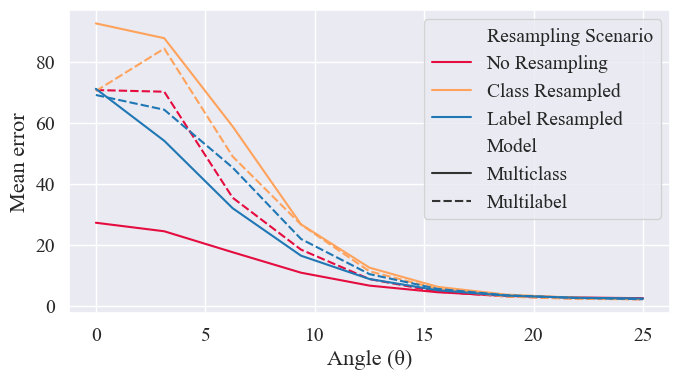

In [ ]:
# fig, axes = plt.subplots(2, 3, figsize=(20,10))
for i, (metric, name) in enumerate(zip(article_metric_names, article_metric_names)):
    # if i != 2:
    #     continue
    plt.figure(figsize=(7,4))
    sns.lineplot(data=normalised_by_class_error, x='Absolute Rotation', y=metric, hue=TRAIN_COL, style=MODEL_COL, palette=CPAL)
    plt.xlabel('Angle (\u03B8)', fontsize=LBL_SIZE)
    plt.ylabel(name, fontsize=LBL_SIZE)
    plt.gca().tick_params('both', labelsize=TICK_SIZE)
    plt.legend(fontsize=TICK_SIZE)
    plt.tight_layout()
    # plt.savefig(os.path.join(PLOTS, 'article', f'per_abs_rotation_{metrics[i].lower().replace(' ', '_')}.png'), bbox_inches='tight')

In [419]:
locators = {
    cErr: (0.3, 0), 
    lErr: (0.07, 0),
    errDist: (0.6, 1.),
    cRec: (0.3, 0),
    cPrec: (0.25, 0),
    cF1: (0.25, 0),
    lRec: (0.15, 0),
    lPrec: (0.01, 0),
    lF1: (0.1, 0),
}

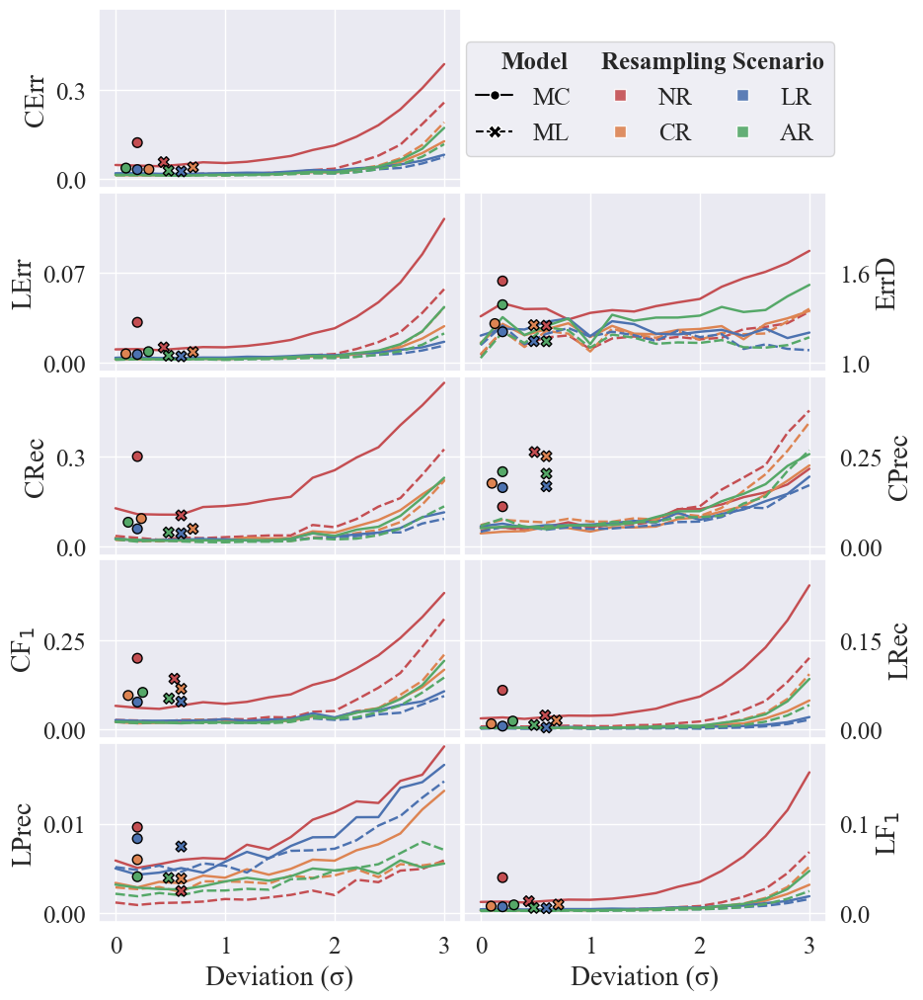

In [420]:
fig, axes = plt.subplots(5, 2, figsize=size,
                         sharex=True)
axes[0,1].axis('off')

for i, (metric, name) in enumerate(zip(article_metric_names, article_metric_names)):
    r = (i + 1) // 2
    c = 0 if i == 0 else (i + 1) % 2
    ax = axes[r, c]
    if c == 1:
        ax.yaxis.set_label_position("right")
        ax.yaxis.tick_right()
    overall_avg = all_experiments_results[
        (all_experiments_results[EVAL_COL] == BLUR)
        & (all_experiments_results[MET_COL] == metric)
    ]
    x1 = blr_lo[1]
    step = blr_lo[2] - x1
    x2 = blr_lo[2] + step
    swarm = sns.swarmplot(
        data=overall_avg,
        x=[x1, x2]*4,
        y=VAL_COL,
        hue=TRAIN_COL,
        size=7,
        linewidth=1.,
        edgecolor=BLACK,
        legend=False,
        palette=CPAL,
        native_scale=True,
        zorder=3, alpha=1.,
        ax=ax,
    )
    swarm.collections[1].set_paths([ml_mk])
    swarm.collections[1].set_sizes([60])

    sns.lineplot(data=per_blur_metrics,
                 x='Blur', y=metric, hue=TRAIN_COL, style=MODEL_COL, palette=CPAL,
                 linewidth=1.75,
                 zorder=2, ax=ax, legend=False)
    
    ax.set_ylabel(abbreviations[name], fontsize=LBL_SIZE)
    ax.tick_params('both', right=False, labelsize=TICK_SIZE)
    loc = locators[name]
    ax.yaxis.set_major_locator(ticker.MultipleLocator(loc[0], loc[1]))
    edge = loc[0] / 10
    top = loc[1] + 2 * loc[0]
    ax.set_ylim(loc[1] - edge, top - edge)
    
    if i == 0:
        hl = 1.5
        cg = 0.6
        
        # Build up legend:
        lg1 = ax.legend(handles=[
            Line2D([0], [0], color='none', label=MODEL_COL),
            Line2D([0], [0], color='none', label=TRAIN_COL)
            ],
                loc='center left', bbox_to_anchor=(0.98, 0.5),
                handlelength=.25, columnspacing=0.25,
                fontsize=TICK_SIZE, ncols=2,
                )
        handles = [
            Line2D([0], [0], color=BLACK,
                marker=model_markers[mod], markersize=marker_size[mod] // 10,
                markeredgecolor=WHITE,
                linestyle=model_style[mod], lw=1.5,
                alpha=1.,
                label=f"{abbreviations[mod]}"
            ) for m, mod in enumerate(model_names)
        ] + [
            Line2D([0], [0], color='none',
                marker='s', markersize=8,
                markeredgecolor=WHITE,
                markerfacecolor=CPAL[r],
                alpha=0.9,
                #   linestyle='-', lw=1.5,
                label=f"{abbreviations[res]}"
            ) for r, res in enumerate(resamplings)
        ]
        lg2 = mlegend.Legend(ax,
                            handles=handles,
                            labels=[h.get_label() for h in handles],
                            fontsize=TICK_SIZE, 
                            handlelength=1.5, columnspacing=1.25,
                            loc='upper left', bbox_to_anchor=(1., 0.9), ncol=3, frameon=False)


        # Manually combine the legends
        for child in lg2._legend_box._children:
            lg1._legend_box._children.append(child)
        lg1._legend_box.align = "left"

        # Make only the desired labels bold
        bold_labels = [MODEL_COL, MET_COL, TRAIN_COL]
        for text in (
            lg1.get_texts() + lg2.get_texts()
        ):
            t = text.get_text()
            if t in bold_labels:
                text.set_fontweight('bold')
                text.set_fontsize(TICK_SIZE)
            if t in abbreviations:
                text.set_text(abbreviations[t])
            
axes[-1,0].set_xlabel('Deviation (\u03C3)', fontsize=LBL_SIZE)
axes[-1,1].set_xlabel('Deviation (\u03C3)', fontsize=LBL_SIZE)
plt.subplots_adjust(hspace=0.025, wspace=0.01)
plt.savefig(os.path.join(PLOT_EVALS, 'experiment_performance_blur.pdf'), bbox_inches='tight')

In [421]:
brt_loc = {
    cErr: (0.5, 0), 
    lErr: (0.2, 0),
    errDist: (0.6, 1.),
    cRec: (0.5, 0),
    cPrec: (0.3, 0),
    cF1: (0.5, 0),
    lRec: (0.3, 0),
    lPrec: (0.1, 0),
    lF1: (0.3, 0),
}

nse_loc = {
    cErr: (0.3, 0), 
    lErr: (0.1, 0),
    errDist: (0.6, 1.),
    cRec: (0.3, 0),
    cPrec: (0.2, 0),
    cF1: (0.25, 0),
    lRec: (0.05, 0),
    lPrec: (0.15, 0),
    lF1: (0.1, 0),
}

rot_loc = {
    cErr: (0.5, 0), 
    lErr: (0.15, 0),
    errDist: (0.6, 1.),
    cRec: (0.5, 0),
    cPrec: (0.5, 0),
    cF1: (0.5, 0),
    lRec: (0.3, 0),
    lPrec: (0.15, 0),
    lF1: (0.2, 0),
}

blr_loc = {
    cErr: (0.3, 0), 
    lErr: (0.07, 0),
    errDist: (0.6, 1.),
    cRec: (0.3, 0),
    cPrec: (0.25, 0),
    cF1: (0.25, 0),
    lRec: (0.15, 0),
    lPrec: (0.01, 0),
    lF1: (0.1, 0),
}

# all_locators = {
#     cErr: (1.1, 0, 1.96), 
#     lErr: (1.3, 0., 2.7),
#     errDist: (0.2, 0, 0),
#     cRec: (1.2, 0, 1.99),
#     cPrec: (0.8, 0, 1.46),
#     cF1: (1.1, 0, 1.86),
#     lRec: (1.5, 0., 2.85),
#     lPrec: (1.5, 0, 3.14),
#     lF1: (1.4, 0., 2.68),
# }
all_locators = {
    cErr: (1, 0, 1.96, 2.3), 
    lErr: (1, 0., 2.7, 2.6),
    errDist: (0.2, 0, 0, 0.39),
    cRec: (1, 0, 1.99, 2.5),
    cPrec: (1, 0, 1.46, 1.6),
    cF1: (1, 0, 1.86, 1.95),
    lRec: (1, 0., 2.85, 2.9),
    lPrec: (1, 0, 3.14, 2.9),
    lF1: (1, 0., 2.68, 2.7),
}

xlims = {
    
    BRIGHT: (0.2, 1),
    NOISE: (0.07, 0),
    ROT: (15, 0),
    BLUR: (2, 0),
}

In [422]:
exp_los = [brt_lo, nse_lo, rot_lo, blr_lo]
exp_his = [brt_hi, nse_hi, rot_hi, blr_hi]
exp_locs = [brt_loc, nse_loc, rot_loc, blr_loc]
exp_labels = [
    'Intensity (\u03B3)',
    'Deviation (\u03C3)',
    'Angle (\u03B8)',
    'Deviation (\u03C3)'    
]
per_exp_metrics = {
    BRIGHT: per_brightness_metrics,
    NOISE: per_noise_metrics,
    ROT: per_abs_rotation_metrics,
    BLUR: per_blur_metrics,
}

In [423]:
import warnings
warnings.filterwarnings('ignore', category=UserWarning)

C:\Users\User\AppData\Local\Temp\ipykernel_27620\3477836963.py:20: UserWarning: The palette list has more values (6) than needed (4), which may not be intended.
  swarm = sns.swarmplot(
C:\Users\User\AppData\Local\Temp\ipykernel_27620\3477836963.py:37: UserWarning: The palette list has more values (6) than needed (4), which may not be intended.
  sns.lineplot(data=per_exp_metrics[ex_eval], x="Absolute " + ex_name if ex == 2 else ex_name, y=metric,
C:\Users\User\AppData\Local\Temp\ipykernel_27620\3477836963.py:20: UserWarning: The palette list has more values (6) than needed (4), which may not be intended.
  swarm = sns.swarmplot(
c:\Users\User\OneDrive\Uni\Braille Research\Braille ML\venv\Lib\site-packages\seaborn\categorical.py:3399: UserWarning: 50.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
c:\Users\User\OneDrive\Uni\Braille Research\Braille ML\venv\Lib\site-packages\seaborn\categorical.py:33

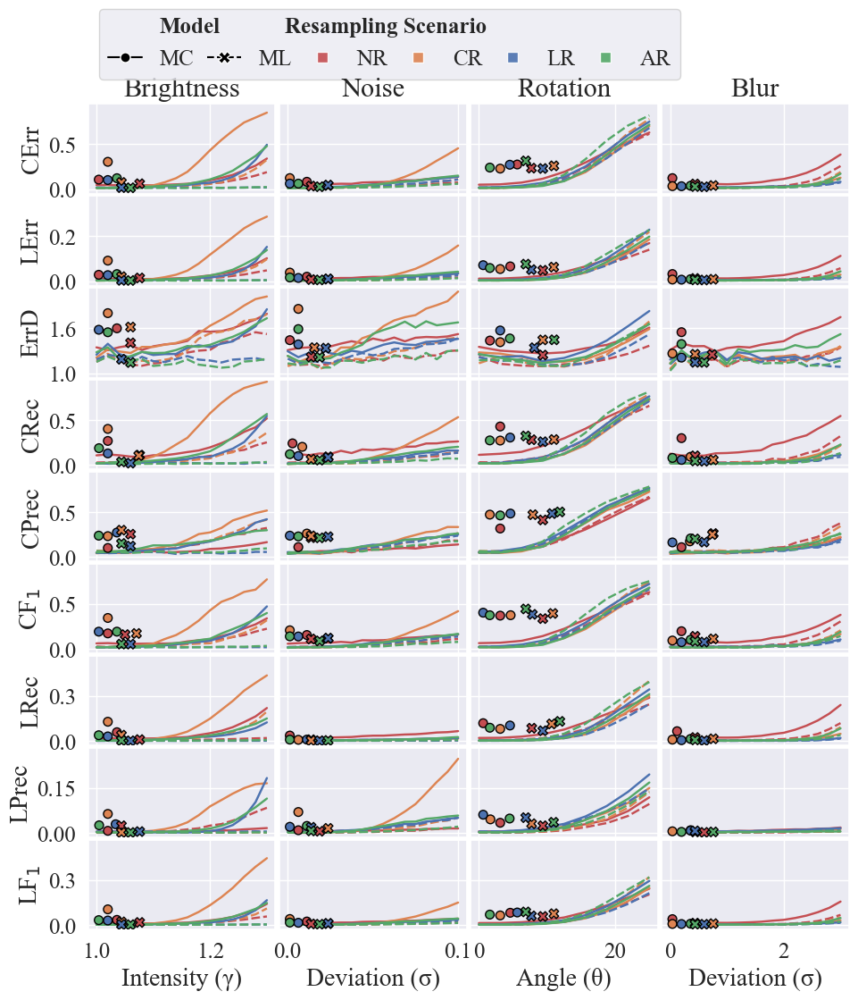

In [238]:
fig, axes = plt.subplots(9, 4, figsize=(11, 12),
                         sharex='col', sharey='row')
# axes[0,1].axis('off')

for ex, (ex_eval, ex_lo, ex_hi, ex_loc, ex_lbl) in enumerate(
    zip(exp_evals, exp_los, exp_his, exp_locs, exp_labels)):
    ex_name = ex_eval.split(" ")[0]
    for i, (metric, name) in enumerate(zip(article_metric_names, article_metric_names)):
        ax = axes[i, ex]
        # if c == 1:
        #     ax.yaxis.set_label_position("right")
        #     ax.yaxis.tick_right()
        overall_avg = all_experiments_results[
            (all_experiments_results[EVAL_COL] == ex_eval)
            & (all_experiments_results[MET_COL] == metric)
        ]
        x1 = ex_lo[1]
        step = ex_lo[2] - x1
        x2 = ex_lo[2] + step
        swarm = sns.swarmplot(
            data=overall_avg,
            x=[x1, x2]*4,
            y=VAL_COL,
            hue=TRAIN_COL,
            size=7,
            linewidth=1.,
            edgecolor=BLACK,
            legend=False,
            palette=CPAL,
            native_scale=True,
            zorder=3, alpha=1.,
            ax=ax,
        )
        swarm.collections[1].set_paths([ml_mk])
        swarm.collections[1].set_sizes([60])
        
        sns.lineplot(data=per_exp_metrics[ex_eval], x="Absolute " + ex_name if ex == 2 else ex_name, y=metric,
                    hue=TRAIN_COL, style=MODEL_COL, palette=CPAL,
                    linewidth=1.75,
                    zorder=2, ax=ax, legend=False)
        
        ax.tick_params('both', right=False, labelsize=TICK_SIZE)
        if ex == 0:
            ax.set_ylabel(abbreviations[name], fontsize=LBL_SIZE)
            loc = all_locators[name]
            ax.yaxis.set_major_locator(ticker.MultipleLocator(loc[0], loc[1]))
            edge = loc[0] / 10
            top = loc[1] + 2 * loc[0]
            ax.set_ylim(loc[1] - edge, top - edge)
        
        if i == 0:
            ax.set_title(ex_name, fontsize=LBL_LARGE)
    axes[-1,ex].set_xlabel(ex_lbl, fontsize=LBL_SIZE)
    
hl = 1.5
cg = 0.6
ax = axes[0,0]
# Build up legend:
if True:
    lg1 = ax.legend(handles=[
        Line2D([0], [0], color='none', label=MODEL_COL),
        Line2D([0], [0], color='none', label=TRAIN_COL)        
        ],
        loc='lower left', bbox_to_anchor=(0., 1.15),
        handlelength=hl, columnspacing=cg,
        fontsize=TICK_SIZE, ncols=len(handles),
    )
    
    handles = [
    #     Line2D([0], [0], color='none', label=MODEL_COL)
    # ] + [
        Line2D([0], [0], color=BLACK,
            marker=model_markers[mod], markersize=marker_size_small[mod],
            markeredgecolor=WHITE,
            linestyle=model_style[mod], lw=1.5,
            alpha=1.,
            label=f"{abbreviations[mod]}"
        ) for m, mod in enumerate(model_names)
    ] + [
    #     Line2D([0], [0], color='none', label=TRAIN_COL)
    # ] + [
        Line2D([0], [0], color='none',
            marker='s', markersize=8,
            markeredgecolor=WHITE,
            markerfacecolor=CPAL[r],
            alpha=0.9,
            label=f"{abbreviations[res]}"
        ) for r, res in enumerate(resamplings)
    ]

    lg2 = mlegend.Legend(ax,
                handles=handles,
                labels=[h.get_label() for h in handles],
                handlelength=hl, columnspacing=cg,
                fontsize=TICK_SIZE, ncols=len(handles),
            )
    for child in lg2._legend_box._children:
        lg1._legend_box._children.append(child)
    lg1._legend_box.align = "left"

    # Make only the desired labels bold
    bold_labels = [MODEL_COL, MET_COL, TRAIN_COL]
    for text in lg1.get_texts():
        t = text.get_text()
        if t in bold_labels:
            text.set_fontweight('bold')
            text.set_fontsize(TICK_SIZE)
        
plt.subplots_adjust(hspace=0.025, wspace=0.02)

In [260]:

for i, (metric, name) in enumerate(zip(article_metric_names, article_metric_names)):
    for ex, ex_eval in enumerate(exp_evals):
        df = per_exp_metrics[ex_eval].copy()
        met_log = f"{metric} Log10"
        df[met_log] = df[metric].apply(lambda x: np.log10(x))
        print(f"{ex_eval} - {name}. Min value {df[met_log].min()}, Max value {df[met_log].max()}.")
    print('-'*100)

Brightness Augmented - Class error. Min value -1.9502929894470171, Max value -0.06952188177953267.
Noise Augmented - Class error. Min value -1.943751081732287, Max value -0.3417475013298943.
Rotation Augmented - Class error. Min value -1.8692735398633937, Max value -0.08575891188458613.
Blur Augmented - Class error. Min value -1.9396134307621975, Max value -0.41387179630451093.
----------------------------------------------------------------------------------------------------
Brightness Augmented - Label error. Min value -2.6536278684358874, Max value -0.5413233042834181.
Noise Augmented - Label error. Min value -2.6604735823711, Max value -0.7996650992695378.
Rotation Augmented - Label error. Min value -2.567785557218746, Max value -0.6395522874779426.
Blur Augmented - Label error. Min value -2.6585676173233566, Max value -0.9490969380531135.
----------------------------------------------------------------------------------------------------
Brightness Augmented - Error distance. Min

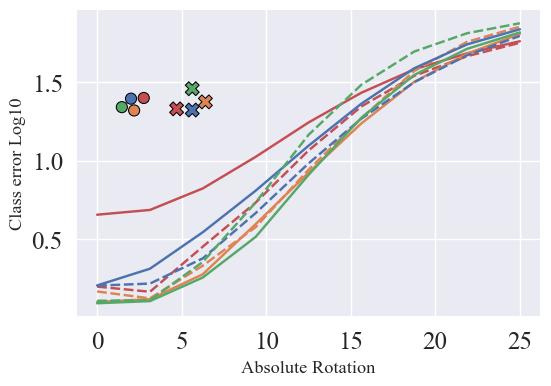

In [282]:
fig, ax = plt.subplots(1,1, figsize=(6,4))
loc = all_locators[cErr]

overall_avg = all_experiments_results[
    (all_experiments_results[EVAL_COL] == ROT)
    & (all_experiments_results[MET_COL] == cErr)
].copy()
x1 = rot_lo[1]
step = rot_lo[2] - x1
x2 = rot_lo[2] + step

ax1 = ax.twiny()
ax1.grid(False)
ax1.set_xlim(0,8)
ax1.set_xticks([],[])

val_log = f"{VAL_COL} Log10"
overall_avg[val_log] = overall_avg[VAL_COL].apply(lambda x: np.log10(x) + loc[2])
swarm = sns.swarmplot(
    data=overall_avg[overall_avg[MODEL_COL] == MC],
    x=[1]*4, y=val_log, size=8, linewidth=0.75, marker='o',
    hue=TRAIN_COL, edgecolor=BLACK, palette=CPAL,
    legend=False, native_scale=True,
    zorder=3, alpha=1., ax=ax1,
)
swarm = sns.swarmplot(
    data=overall_avg[overall_avg[MODEL_COL] == ML],
    x=[2]*4, y=val_log, size=10, linewidth=0.75, marker='X',
    hue=TRAIN_COL, edgecolor=BLACK, palette=CPAL,
    legend=False, native_scale=True,
    zorder=3, alpha=1., ax=ax1,
)

df = per_exp_metrics[ROT].copy()
met_log = f"{cErr} Log10"
df[met_log] = df[cErr].apply(lambda x: np.log10(x) + loc[2])

sns.lineplot(data=df, x="Absolute Rotation", y=met_log,
            hue=TRAIN_COL, style=MODEL_COL, palette=CPAL,
            linewidth=1.75,
            zorder=2, ax=ax, legend=False)
ax.tick_params('both', right=False, bottom=False, labelsize=TICK_SIZE)

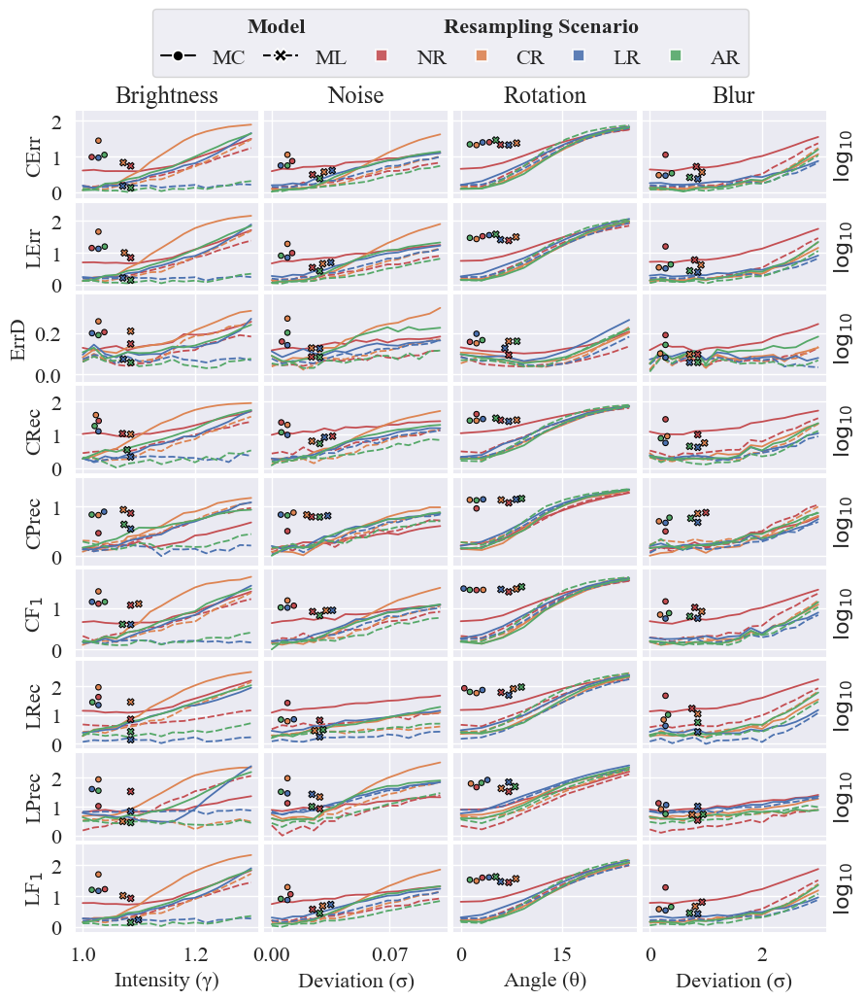

In [424]:
fig, axes = plt.subplots(9, 4, figsize=(10, 11),
                         sharex='col', sharey='row')
# axes[0,1].axis('off')

tick_size = TICK_SIZE - 2
lbl_size = LBL_SIZE - 2
for ex, (ex_eval, ex_lo, ex_hi, ex_loc, ex_lbl) in enumerate(
    zip(exp_evals, exp_los, exp_his, exp_locs, exp_labels)):
    ex_name = ex_eval.split(" ")[0]
    df = per_exp_metrics[ex_eval].copy()
    for i, (metric, name) in enumerate(zip(article_metric_names, article_metric_names)):
        ax = axes[i, ex]
        loc = all_locators[name]

        ax1 = ax.twiny()
        ax1.grid(False)
        ax1.set_xlim(0.25,6)
        ax1.set_xticks([],[])
        
        overall_avg = all_experiments_results[
            (all_experiments_results[EVAL_COL] == ex_eval)
            & (all_experiments_results[MET_COL] == metric)
        ].copy()
        
        val_log = f"{VAL_COL} Log10"
        overall_avg[val_log] = overall_avg[VAL_COL].apply(lambda x: np.log10(x) + loc[2])
        swarm = sns.swarmplot(
            data=overall_avg[overall_avg[MODEL_COL] == MC],
            x=[1]*4, y=val_log, size=4, linewidth=0.75, marker='o',
            hue=TRAIN_COL, edgecolor=BLACK, palette=CPAL,
            legend=False, native_scale=True,
            zorder=3, alpha=1., ax=ax1,
        )
        swarm = sns.swarmplot(
            data=overall_avg[overall_avg[MODEL_COL] == ML],
            x=[2]*4, y=val_log, size=5, linewidth=0.75, marker='X',
            hue=TRAIN_COL, edgecolor=BLACK, palette=CPAL,
            legend=False, native_scale=True,
            zorder=3, alpha=1., ax=ax1,
        )
        
        met_log = f"{metric} Log10"
        df[met_log] = df[metric].apply(lambda x: np.log10(x) + loc[2])
        
        sns.lineplot(data=df, x="Absolute " + ex_name if ex == 2 else ex_name, y=met_log,
                    hue=TRAIN_COL, style=MODEL_COL, palette=CPAL,
                    linewidth=1.3,
                    zorder=2, ax=ax, legend=False)
        
        ax.tick_params('both', right=False, bottom=False, labelsize=tick_size)
        if ex == 0:
            ax.set_ylabel(f"{abbreviations[name]}", fontsize=tick_size)
            ax.yaxis.set_major_locator(ticker.MultipleLocator(loc[0], loc[1]))
            edge = loc[0] / 5
            top = loc[3]
            ax.set_ylim(loc[1] - edge, top)
            # edge = 1 if i != 2 else 0.2
            # ax.yaxis.set_major_locator(ticker.MultipleLocator(edge, 0))
            # ax.set_ylim(-edge / 5, top)
        if ex == 3:
            ax2 = ax.twinx()
            ax2.tick_params(axis='y', which='both', right=False, left=False, labelright=False, labelleft=False)
            ax.tick_params(axis='y', which='both', right=False, left=False, labelright=False, labelleft=False)
            ax2.set_ylabel("$\log_{10}$", fontsize=tick_size)
            ax2.grid(False)
        
        if i == 0:
            ax.set_title(ex_name, fontsize=lbl_size)
        # break
    ax = axes[-1, ex]
    ax.set_xlabel(ex_lbl, fontsize=tick_size)
    ax.xaxis.set_major_locator(ticker.MultipleLocator(xlims[ex_eval][0], xlims[ex_eval][1]))
    # break
    
hl = 1.6
cg = 0.8
ax = axes[0,1]
# Build up legend:
if True:
    lg1 = ax.legend(handles=[
        Line2D([0], [0], color='none', label=MODEL_COL),
        Line2D([0], [0], color='none', label=TRAIN_COL)        
        ],
        loc='lower center', bbox_to_anchor=(1.01, 1.25),
        handlelength=hl*2, columnspacing=cg*3,
        fontsize=tick_size, ncols=len(handles),
    )
    
    handles = [
    #     Line2D([0], [0], color='none', label=MODEL_COL)
    # ] + [
        Line2D([0], [0], color=BLACK,
            marker=model_markers[mod], markersize=marker_size_small[mod],
            markeredgecolor=WHITE,
            markeredgewidth=1.25,
            linestyle=model_style[mod], lw=1.5,
            alpha=1.,
            label=f"{abbreviations[mod]}"
        ) for m, mod in enumerate(model_names)
    ] + [
    #     Line2D([0], [0], color='none', label=TRAIN_COL)
    # ] + [
        Line2D([0], [0], color='none',
            marker='s', markersize=8,
            markeredgecolor=WHITE,
            markeredgewidth=1.25,
            markerfacecolor=CPAL[r],
            alpha=0.9,
            label=f"{abbreviations[res]}"
        ) for r, res in enumerate(resamplings)
    ]

    lg2 = mlegend.Legend(ax,
                handles=handles,
                labels=[h.get_label() for h in handles],
                handlelength=hl, columnspacing=cg,
                fontsize=tick_size, ncols=len(handles),
            )
    for child in lg2._legend_box._children:
        lg1._legend_box._children.append(child)
    lg1._legend_box.align = "left"

    # Make only the desired labels bold
    bold_labels = [MODEL_COL, MET_COL, TRAIN_COL]
    for text in lg1.get_texts():
        t = text.get_text()
        if t in bold_labels:
            text.set_fontweight('bold')
            text.set_fontsize(tick_size)

plt.subplots_adjust(hspace=0.025, wspace=0.02)
plt.savefig(os.path.join(PLOT_EVALS, 'experiment_performance_per_augment.pdf'), bbox_inches='tight')

In [293]:
blr_lo, blr_hi

([0.0, 0.2, 0.4], [2.6, 2.8, 3.0])

In [305]:
display(df[df["Blur"].isin(blr_lo)].groupby([TRAIN_COL, MODEL_COL])["1 - label F1 Log10"].mean().to_frame())
display(df[df["Blur"].isin(blr_hi)].groupby([TRAIN_COL, MODEL_COL])["1 - label F1 Log10"].mean().to_frame())

C:\Users\User\AppData\Local\Temp\ipykernel_27620\3941387514.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  display(df[df["Blur"].isin(blr_lo)].groupby([TRAIN_COL, MODEL_COL])["1 - label F1 Log10"].mean().to_frame())


1 - label F1 Log10
Resampling Scenario Model                         
No Resampling       Multiclass            0.776203
                    Multilabel            0.202833
Class Resampled     Multiclass            0.159260
                    Multilabel            0.158124
Label Resampled     Multiclass            0.316982
                    Multilabel            0.219308
Adaptive Resampled  Multiclass            0.165651
                    Multilabel            0.079662

C:\Users\User\AppData\Local\Temp\ipykernel_27620\3941387514.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  display(df[df["Blur"].isin(blr_hi)].groupby([TRAIN_COL, MODEL_COL])["1 - label F1 Log10"].mean().to_frame())


1 - label F1 Log10
Resampling Scenario Model                         
No Resampling       Multiclass            1.746153
                    Multilabel            1.315478
Class Resampled     Multiclass            1.002823
                    Multilabel            1.153600
Label Resampled     Multiclass            0.842090
                    Multilabel            0.738556
Adaptive Resampled  Multiclass            1.119038
                    Multilabel            0.878622

In [302]:
all_experiments[(all_experiments[EVAL_COL] == BLUR) & (all_experiments[MET_COL] == lF1)]

,Resampling Scenario,Model,Metric,Value,Metric Type,Evaluation,Value Log
208,No Resampling,Multiclass,1 - label F1,9.575838,label,Blur Augmented,0.981177
209,No Resampling,Multilabel,1 - label F1,14.021717,label,Blur Augmented,1.146801
210,Class Resampled,Multiclass,1 - label F1,7.422612,label,Blur Augmented,0.870557
211,Class Resampled,Multilabel,1 - label F1,10.855272,label,Blur Augmented,1.035641
212,Label Resampled,Multiclass,1 - label F1,3.353916,label,Blur Augmented,0.525552
213,Label Resampled,Multilabel,1 - label F1,3.404715,label,Blur Augmented,0.532081
214,Adaptive Resampled,Multiclass,1 - label F1,9.811087,label,Blur Augmented,0.991717
215,Adaptive Resampled,Multilabel,1 - label F1,6.749990,label,Blur Augmented,0.829303


In [249]:
overall_avg

,Evaluation,Resampling Scenario,Model,Metric,Value,Metric Type
0,Brightness Augmented,No Resampling,Multiclass,Class error,0.105759,error
1,Brightness Augmented,No Resampling,Multilabel,Class error,0.059842,error
2,Brightness Augmented,Class Resampled,Multiclass,Class error,0.304078,error
3,Brightness Augmented,Class Resampled,Multilabel,Class error,0.074029,error
4,Brightness Augmented,Label Resampled,Multiclass,Class error,0.101243,error
5,Brightness Augmented,Label Resampled,Multilabel,Class error,0.016534,error
6,Brightness Augmented,Adaptive Resampled,Multiclass,Class error,0.121516,error
7,Brightness Augmented,Adaptive Resampled,Multilabel,Class error,0.014647,error
Value Log10,NaN,NaN,NaN,NaN,NaN,NaN
